# Boundaries

This code is built to check the boundaries between the ON/OFF observations and highlight any large differences. If there are, it flags them.
In this way it is able to make the most of the ON/OFF strategy while completely bypassing turboseti/seticore 

# Load Packages and Define Functions

In [2]:
# Load required packages
import math
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import pandas as pd
import glob
import statistics as stats
import blimpy
from blimpy import Waterfall
from blimpy import utils
from blimpy import plotting

import turbo_seti.find_doppler.seti_event as turbo
import turbo_seti.find_event as find_event
from turbo_seti.find_doppler.find_doppler import FindDoppler
from turbo_seti.find_event.find_event_pipeline import find_event_pipeline
from turbo_seti.find_event.plot_event_pipeline import plot_event_pipeline
import pandas as pd
import pickle
from scipy import signal
import scipy

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

from datetime import datetime
import h5py
from scipy.stats import pearsonr   
from tqdm import tqdm


%matplotlib inline

print("All packages imported!")

All packages imported!


In [3]:
# Define Necessary Functions


def get_last_time_row(file):
    hf = h5py.File(file, 'r')
    data = hf.get('data')
    last_time_row = data[-1]
    return last_time_row[0]

def get_freq_slices(last_time_row,f_start,f_end):
    freq_block = last_time_row[f_start:f_end]
    return freq_block

def get_snr(sliced,sigma_multiplier):
    snr = False
    # divide by max to make numbers smaller
    sliced = sliced/np.max(sliced)

    lower_quantile = np.quantile(sliced,.85)
    lower_slice = sliced[sliced < lower_quantile]
    median = np.median(lower_slice)
    sigma = np.std(lower_slice)

    # print('sigma',sigma)
    # print('median',median)
    # print('sigma_multiplier',sigma_multiplier)
    threshold = median+sigma_multiplier*sigma

    if threshold <= 1:
        snr = True
        # plt.axhline(y=threshold)
        # plt.plot(slice)
        # plt.show()

    return snr, threshold

def get_first_round_snr(sliced,first_round_multiplier):
    snr = False
    # divide by max to make numbers smaller
    sliced = sliced/np.max(sliced)

    median = np.median(sliced)
    sigma = np.std(sliced)

    # print('sigma',sigma)
    # print('median',median)
    # print('sigma_multiplier',sigma_multiplier)
    threshold = median+first_round_multiplier*sigma

    if threshold <= 1:
        snr = True
        # plt.axhline(y=threshold)
        # plt.plot(slice)
        # plt.show()

    return snr, threshold


def find_hotspots(row):
    first_round = []
    hotspots = []
    first_round_multiplier = 5
    # iterate
    hotspot_size = 2000

    for i in tqdm(range(0,number)):
        slice_ON = row[i*block_size:(i+1)*block_size:]
        snr,threshold = get_first_round_snr(slice_ON,first_round_multiplier)
        if snr:
            first_round.append(i)

    for i in tqdm(first_round):
        slice_ON = row[i*block_size:(i+1)*block_size:]
        snr,threshold = get_snr(slice_ON,SIGNIFICANCE_LEVEL)
        if snr:
            hotspots.append(i)

    
    return hotspots

def get_file_properties(f):
    tstart=f['data'].attrs['tstart']
    fch1=f['data'].attrs['fch1']
    foff=f['data'].attrs['foff']
    nchans=f['data'].attrs['nchans']
    ra=f['data'].attrs['src_raj']
    decl=f['data'].attrs['src_dej']
    target=f['data'].attrs['source_name']
    print("tstart %0.6f fch1 %0.10f foff %0.30f nchans %d cfreq %0.10f src_raj %0.10f src_raj_degs %0.10f src_dej %0.10f target %s" % (tstart,fch1,foff,nchans,(fch1+((foff*nchans)/2.0)),ra,ra*15.0,decl,target))

    return fch1, foff

def get_correct_index(freq,fch1,foff):
    distance = fch1 - freq
    number = int(np.round(-distance/foff))
    bound = 250
    return number+bound, number-bound

def filter_hotspots(hotspots):
    '''
    Take out hotspots that are falling in especially heavy RFI
    '''

    ## first convert hotspots ids to frequency channels
    hotspots_frequencies = np.array([int((fch1+foff*(i*500))) for i in hotspots])
    all_indexes = []
    for i in bad_regions:

        bottom = int(i[0])
        top = int(i[1])
        indexes = np.where(np.logical_and(bottom<hotspots_frequencies, hotspots_frequencies<top))
        indexes = indexes[0]
        indexes = [int(i) for i in indexes]
        for i in indexes:
            all_indexes.append(i)


    return all_indexes

def plot_boundary(hf,on,lower,upper):
    '''
    Returns the boundary slices, the OFF 30 frames larger on each side (accounting for an initial max drift rate of 1 Hz/s)
    '''

    a = 1
    if on:
        a=-1
        test2 = np.squeeze(hf['data'][:,:,lower:upper],axis=1)
    else:
        a = 1
        test2 = np.squeeze(hf['data'][:,:,lower-EDGE:upper+EDGE],axis=1)

    
    # normalize
    test2 = test2/np.max(test2)

    plt.rcParams["figure.figsize"] = (5,1)   
    plt.imshow(test2,aspect='auto')
    plt.show()

    plt.plot(test2[a])
    plt.show()
    return test2[a]

def plot_candidates(hf1,hf2,hf3,hf4,hf5,hf6,lower,upper,file_ON,foff,fch1):
    obs1 = np.squeeze(hf1['data'][:,:,lower:upper],axis=1)
    obs2 = np.squeeze(hf2['data'][:,:,lower:upper],axis=1)
    obs3 = np.squeeze(hf3['data'][:,:,lower:upper],axis=1)
    obs4 = np.squeeze(hf4['data'][:,:,lower:upper],axis=1)
    obs5 = np.squeeze(hf5['data'][:,:,lower:upper],axis=1)
    obs6 = np.squeeze(hf6['data'][:,:,lower:upper],axis=1)
    obs1 = obs1/np.max(obs1)
    obs2 = obs2/np.max(obs2)
    obs3 = obs3/np.max(obs3)
    obs4 = obs4/np.max(obs4)
    obs5 = obs5/np.max(obs5)
    obs6 = obs6/np.max(obs6)

    full_cadence = np.squeeze([np.concatenate((obs1,obs2,obs3,obs4,obs5,obs6))])

    fig, axs = plt.subplots(6,figsize=(5, 6))
    axs[0].imshow(obs1,aspect='auto')
    axs[1].imshow(obs2,aspect='auto')
    axs[2].imshow(obs3,aspect='auto')
    axs[3].imshow(obs4,aspect='auto')
    axs[4].imshow(obs5,aspect='auto')
    axs[5].imshow(obs6,aspect='auto')
    plt.subplots_adjust(hspace=0)



    # plt.rcParams["figure.figsize"] = (5,10)   

    # plt.imshow(full_cadence)

    name = file_ON.split('/')[-1]
    plt.suptitle(name,fontsize=5)
    center_freq = fch1+foff*(lower)
    plt.xlabel(f"# of {np.round(foff*10**6,3)} Hz bins off from {center_freq}")
    plt.ylabel("Time (bins of 16s)")
    plt.show()


    
    # broadband
    obs1_int_freq = obs1.sum(axis=1)
    obs1_int_freq = obs1_int_freq/np.max(obs1_int_freq)
    plt.plot(obs1_int_freq)
    snr, threshold_freq = get_snr(obs1_int_freq,SIGNIFICANCE_LEVEL)
    print("broadband",snr)
    plt.axhline(y=threshold_freq)
    plt.show()


    # different rows of first ON
    snr, threshold2 = get_snr(obs1[-2],SIGNIFICANCE_LEVEL)
    plt.axhline(y=threshold2)
    plt.plot(obs1[-2]/np.max(obs1[-2]))
    plt.show()
    plt.plot(obs1[-1]/np.max(obs1[-1]))
    snr, threshold = get_snr(obs1[-1],SIGNIFICANCE_LEVEL)
    plt.axhline(y=threshold)
    plt.show()
    plt.plot(obs2[0]/np.max(obs2[0]))
    plt.show()

    obs1_int = obs1.sum(axis=0)


    obs2_int = obs2.sum(axis=0)
    obs3_int = obs3.sum(axis=0)

    obs4_int = obs4.sum(axis=0)

    obs5_int = obs5.sum(axis=0)

    obs6_int = obs6.sum(axis=0)


    entire_cadence = obs1_int+obs2_int+obs3_int+obs4_int+obs5_int+obs6_int
    # print("obs1",obs1_int)
    # print("entire",entire_cadence)
    entire_cadence = entire_cadence/ np.max(entire_cadence)
    snr, threshold = get_snr(entire_cadence,SIGNIFICANCE_LEVEL)
    plt.axhline(y=threshold)

    plt.plot(entire_cadence)                
    number_above = (entire_cadence > threshold).sum()
    print('#:',number_above)

    plt.show()

    
    drift_index_checker(entire_cadence, obs1[-1])


    obsoff = np.squeeze(hf2['data'][:,:,lower-EDGE:upper+EDGE],axis=1)

    
    # obs2 = np.squeeze(hf2['data'][:,:,lower:upper],axis=1)

    print(len(obsoff),len(obs1))
    print(obs2)
    print(EDGE)
    print(obsoff)
    max_corr,current_shift = pearson_slider(obs1[-1],obsoff[0])
    print("max corr",max_corr)


    snr_obs3_0, threshold_3_0 = get_snr(obs3[0],SIGNIFICANCE_LEVEL)
    snr_obs3_16, threshold_3_16 = get_snr(obs3[-1],SIGNIFICANCE_LEVEL)
    snr_obs5_0, threshold_5_0 = get_snr(obs5[0],SIGNIFICANCE_LEVEL)
    snr_obs5_16, threshold_5_16 = get_snr(obs5[-1],SIGNIFICANCE_LEVEL)

    print(snr_obs3_0,snr_obs3_16,snr_obs5_0,snr_obs5_16)

    plt.title("obs3")
    plt.plot(obs3[0]/np.max(obs3[0]))
    plt.axhline(y=threshold_3_0)
    plt.show()

    plt.plot(obs3[-1]/np.max(obs3[-1]))
    plt.axhline(y=threshold_3_16)
    plt.show()
    plt.title("obs5")

    plt.plot(obs5[0]/np.max(obs5[0]))
    plt.axhline(y=threshold_5_0)
    plt.show()
    plt.plot(obs5[-1]/np.max(obs5[-1]))
    plt.axhline(y=threshold_5_16)
    plt.show()
    

def plot_csv_candidate(number):
    files = eval(candidates["All Files"][number])
    freq = float(candidates["Frequency"][number])
    

#     files = ['/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/MESSIER031/blc73_guppi_58832_16209_MESSIER031_0057.gpuspec.0000.h5',
#  '/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/MESSIER031/blc73_guppi_58832_16530_HIP2792_0058.gpuspec.0000.h5',
#  '/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/MESSIER031/blc73_guppi_58832_16851_MESSIER031_0059.gpuspec.0000.h5',
#  '/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/MESSIER031/blc73_guppi_58832_17168_HIP3077_0060.gpuspec.0000.h5',
#  '/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/MESSIER031/blc73_guppi_58832_17485_MESSIER031_0061.gpuspec.0000.h5',
#  '/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/MESSIER031/blc73_guppi_58832_17801_HIP3223_0062.gpuspec.0000.h5']
    
    # freq= 1598.484902

    obs1 = files[0]
    obs2= files[1]
    obs3 = files[2]
    obs4 = files[3]
    obs5 = files[4]
    obs6 = files[5]

    print('freq',freq)


    hf_ON = h5py.File(obs1, 'r')
    hf_OFF = h5py.File(obs2, 'r')
    hf_ON2 = h5py.File(obs3, 'r')
    hf_OFF2 = h5py.File(obs4, 'r')
    hf_ON3 = h5py.File(obs5, 'r')
    hf_OFF3 = h5py.File(obs6, 'r')

    print('hf',hf_OFF)

    fch1,foff = get_file_properties(hf_ON)
    block = (freq-fch1)/(500*foff)
    lower = int(block * 500)
    upper = int((block+1) * 500)
    print(lower,upper)

    plot_candidates(hf_ON,hf_OFF,hf_ON2,hf_OFF2,hf_ON3,hf_OFF3,lower,upper,obs1,foff,fch1)


def show_check_hotspots(hf_obs1,hf_obs2,hf_obs3,hf_obs4,hf_obs5,hf_obs6,filtered_hotspots):
    low_correlations = []
    threshold = .5

    # we iterate through all of the hotspots
    for i in tqdm(filtered_hotspots):

        # define the block region we are looking at
        lower = i * 500
        upper = (i+1) * 500 

        # load the observations for off and ON. Last time bin for first obs, first time bin for seond obs
        # also check other boundaries


        # boundary 1/5
        row_ON, row_OFF = get_boundary_data(hf_obs1,hf_obs2,lower,upper)
        max_corr, current_shift = pearson_slider(row_ON,row_OFF)

        
        # if it passes the initial pearson threshold check, perform secondary filters
        if max_corr < PEARSON_THRESHOLD:

            # load entire observation and see if time-summing the signal produces different result
            Obs1 = np.squeeze(hf_obs1['data'][:,:,lower:upper],axis=1)
            Obs2 = np.squeeze(hf_obs2['data'][:,:,lower-EDGE:upper+EDGE],axis=1)
            # will catch weak signals
            fails_sum,integrated_pearson_score = second_filter(Obs1,Obs2)


            # then do a check that there is still a strong signal somewhere higher up in the observation --> so not just a little point right at the boundary
            # time sum whole observation, and see if signal stands out
            not_blip,threshold_blips = blip_checker(Obs1,row_ON)

            # also check if there was just a dim signal in the first OFF, maybe it gets stronger in second bin
            second_row_corr,current_shift = pearson_slider(row_ON,Obs2[2])

            # if it passes these tests, check if it zero drift rate. Compare first time from first ON observation to last time from last OFF.
            # if it has high correlation at drift rate = 0, then probably not good 

            # check if same number of strong signals --> sometimes if its a very sharp signal correlation doesnt assign high score
            
            
            if fails_sum and not_blip and second_row_corr < PEARSON_THRESHOLD:

                print("Checking Drift Rate")

                # sum whole observation and see if zero drift rate, if necessary
                obs1_int = Obs1.sum(axis=0)

                # load last OFF observation
                Obs6 = np.squeeze(hf_obs6['data'][:,:,lower-EDGE:upper+EDGE],axis=1)
                obs6_int = Obs6.sum(axis=0)

                first_last_corr,current_shift = pearson_slider(obs1_int, obs6_int)
                
                plt.plot(obs6_int)
                plt.show()
                plt.plot(obs1_int)
                plt.show()
                print("Corr:",first_last_corr)

                if current_shift != 0 and abs(current_shift) != 1:

                    # Final check will be to see if all the on signals are in the same place in all the off signals
                    # time intensive bc we are loading all the data, so this is the very last check
                    
                    Obs2 = np.squeeze(hf_obs2['data'][:,:,lower:upper],axis=1)
                    obs2_int = Obs2.sum(axis=0)

                    Obs3 = np.squeeze(hf_obs3['data'][:,:,lower:upper],axis=1)
                    obs3_int = Obs3.sum(axis=0)

                    Obs4 = np.squeeze(hf_obs4['data'][:,:,lower:upper],axis=1)
                    obs4_int = Obs4.sum(axis=0)

                    Obs5 = np.squeeze(hf_obs5['data'][:,:,lower:upper],axis=1)
                    obs5_int = Obs5.sum(axis=0)

                    Obs6 = np.squeeze(hf_obs6['data'][:,:,lower:upper],axis=1)
                    obs6_int = Obs6.sum(axis=0)


                    
                    on_sum = obs1_int+obs3_int+obs5_int
                    off_sum = obs2_int+obs4_int+obs6_int

                    on_sum = on_sum/np.max(on_sum)
                    off_sum = off_sum/np.max(off_sum)

                    plt.plot(on_sum)
                    plt.title("all on vs off")
                    plt.show()
                    plt.plot(off_sum)
                    plt.show()

                    zero_drift = drift_index_checker(on_sum, off_sum)

                    if zero_drift == False:
                        # check other boundaries
                        # boundary 2/5
                        row_ON2, row_OFF2 = get_boundary_data(hf_obs2,hf_obs3,lower,upper)
                        max_corr2, current_shift2 = pearson_slider(row_ON2,row_OFF2)
                        # boundary 3/5
                        row_ON3, row_OFF3 = get_boundary_data(hf_obs3,hf_obs4,lower,upper)
                        max_corr3, current_shift3 = pearson_slider(row_ON3,row_OFF3)
                        # boundary 4/5
                        row_ON4, row_OFF4 = get_boundary_data(hf_obs4,hf_obs5,lower,upper)
                        max_corr4, current_shift4 = pearson_slider(row_ON4,row_OFF4)
                        # boundary 5/5
                        row_ON5, row_OFF5 = get_boundary_data(hf_obs5,hf_obs6,lower,upper)
                        max_corr5, current_shift5 = pearson_slider(row_ON5,row_OFF5)
                        # count how many had low pearson values
                        score = 0
                        for corr in [max_corr,max_corr2,max_corr3,max_corr4,max_corr5]:
                            if corr < PEARSON_THRESHOLD:
                                score +=1 


                        print('score:',score)
                        print(f"max correlation was {max_corr}")
                        print(f"integrated correlation was {integrated_pearson_score}")
                        print('current shift:',current_shift)
                        print('firstlastcorr:',first_last_corr)

                        low_correlations.append(i)


    return low_correlations



In [4]:

'''
Event Detection algorithms
Nice and short :)

 '''

def get_boundary_data(hf_ON,hf_OFF,lower,upper):

    row_ON = np.squeeze(hf_ON['data'][-1:,:,lower:upper],axis=1)[0]
    # print(row_ON)
    row_OFF = np.squeeze(hf_OFF['data'][:1,:,lower-EDGE:upper+EDGE],axis=1)[0]

    return row_ON,row_OFF


def check_hotspots(hf_obs1,hf_obs2,hf_obs3,hf_obs4,hf_obs5,hf_obs6,filtered_hotspots):
    low_correlations = []
    threshold = .5
    scores = []

    # we iterate through all of the hotspots
    for i in tqdm(filtered_hotspots):

        # define the block region we are looking at
        lower = i * 500
        upper = (i+1) * 500 

        # load the observations for off and ON. Last time bin for first obs, first time bin for seond obs
        # also check other boundaries


        # boundary 1/5
        row_ON, row_OFF = get_boundary_data(hf_obs1,hf_obs2,lower,upper)
        same_signal_number = check_same_signal_number(row_ON,row_OFF)

        

        # first just check if there are same number of signals
        if same_signal_number==False:
            Obs1 = np.squeeze(hf_obs1['data'][:,:,lower:upper],axis=1)
            # print(Obs1.shape)
            print("checking blips")
            not_constant_signal,threshold_blips = blip_checker(Obs1)                

            if not_constant_signal ==False :
                # if it passes the initial check, perform pearson correlation

                print("Checking correlation")
                max_corr, current_shift = pearson_slider(row_ON,row_OFF)

                if max_corr < PEARSON_THRESHOLD:
                    # Obs1 = np.squeeze(hf_obs1['data'][:,:,lower:upper],axis=1)
                    # check if it is broadband RFI:
                    print("checking broadband")
                    is_broadband = check_broadband(Obs1)
                    if is_broadband == False:
                        
                        # load entire observation and see if time-summing the signal produces different result
                        Obs2 = np.squeeze(hf_obs2['data'][:,:,lower-EDGE:upper+EDGE],axis=1)
                        # will catch weak signals
                        fails_sum,integrated_pearson_score = second_filter(Obs1,Obs2)
            
                        # then do a check that there is still a strong signal somewhere higher up in the observation --> so not just a little point right at the boundary
                        # time sum whole observation, and see if signal stands out
            
                        # also check if there was just a dim signal in the first OFF, maybe it gets stronger in second bin
                        second_row_corr,current_shift = pearson_slider(row_ON,Obs2[8])
                        # can also check if same # of signals in middle of next row
                        check_same_signal_number_middle = check_same_signal_number(row_ON,Obs2[8])
                        # plt.plot(row_ON)
                        # plt.show()
                        # plt.plot(Obs2[8])
                        # plt.show()

                        print("fails sum:",fails_sum)
                        print("not_constant_signal:",not_constant_signal)
                        print("second_row_corr",second_row_corr)
        
                        # if it passes these tests, check if it zero drift rate. Compare first time from first ON observation to last time from last OFF.
                        # if it has high correlation at drift rate = 0, then probably not good 
                        if fails_sum and second_row_corr < PEARSON_THRESHOLD and check_same_signal_number_middle == False:
            
                            print("Checking Drift Rate")
            
                            # sum whole observation and see if zero drift rate, if necessary
                            obs1_int = Obs1.sum(axis=0)
            
                            # load last OFF observation
                            Obs6 = np.squeeze(hf_obs6['data'][:,:,lower-EDGE:upper+EDGE],axis=1)
                            obs6_int = Obs6.sum(axis=0)
            
                            first_last_corr,current_shift = pearson_slider(obs1_int, obs6_int)
            
                            if current_shift != 0 and abs(current_shift) != 1:


                                # make sure at least 3 of the ON boundaries have strong signal
                                # oftentimes the signal peters out over time
                            
                                
            
                                # Final check will be to see if all the on signals are in the same place in all the off signals
                                # time intensive bc we are loading all the data, so this is the very last check
                                print("Second drift check")
                                Obs2 = np.squeeze(hf_obs2['data'][:,:,lower:upper],axis=1)
                                obs2_int = Obs2.sum(axis=0)
            
                                Obs3 = np.squeeze(hf_obs3['data'][:,:,lower:upper],axis=1)
                                obs3_int = Obs3.sum(axis=0)
            
                                Obs4 = np.squeeze(hf_obs4['data'][:,:,lower:upper],axis=1)
                                obs4_int = Obs4.sum(axis=0)
            
                                Obs5 = np.squeeze(hf_obs5['data'][:,:,lower:upper],axis=1)
                                obs5_int = Obs5.sum(axis=0)
            
                                Obs6 = np.squeeze(hf_obs6['data'][:,:,lower:upper],axis=1)
                                obs6_int = Obs6.sum(axis=0)
                                
                                on_sum = obs1_int+obs3_int+obs5_int
                                off_sum = obs2_int+obs4_int+obs6_int

                                whole_sum = obs1_int+obs3_int+obs5_int+obs2_int+obs4_int+obs6_int
            
                                on_sum = on_sum/np.max(on_sum)
                                off_sum = off_sum/np.max(off_sum)
                                whole_sum = whole_sum/np.max(whole_sum)
            
                                zero_drift = drift_index_checker(whole_sum, row_ON)

                                
                                signal_stays_strong = True
                                snr_obs3_0, threshold30 = get_snr(Obs3[0],SIGNIFICANCE_LEVEL)
                                snr_obs3_16, threshold316 = get_snr(Obs3[-1],SIGNIFICANCE_LEVEL)
                                snr_obs5_0, threshold50 = get_snr(Obs5[0],SIGNIFICANCE_LEVEL)
                                snr_obs5_16, threshold516 = get_snr(Obs5[-1],SIGNIFICANCE_LEVEL)


                                # plt.plot(Obs3[0]/np.max(Obs3[0]))
                                # plt.axhline(y=threshold30)
                                # plt.show()
                                # plt.plot(Obs3[0]/np.max(Obs3[0]))
                                # plt.axhline(y=threshold316)
                                # plt.show()
                                # plt.plot(Obs3[0]/np.max(Obs3[0]))
                                # plt.axhline(y=threshold50)
                                # plt.show()
                                # plt.plot(Obs3[0]/np.max(Obs3[0]))
                                # plt.axhline(y=threshold516)
                                # plt.show()

                                number_strong_boundaries = 0
                                print("checking if signal peters out")
                                for snr in [snr_obs3_0,snr_obs3_16,snr_obs5_0,snr_obs5_16]:
                                    print(snr)
                                    if snr == True:
                                        number_strong_boundaries += 1

                                print(number_strong_boundaries)
                                if number_strong_boundaries <=1:
                                    signal_stays_strong = False

                                if zero_drift == False and signal_stays_strong == True:
                                    # check other boundaries
                                    # boundary 2/5
                                    row_ON2, row_OFF2 = get_boundary_data(hf_obs2,hf_obs3,lower,upper)

                                    

                                    max_corr2, current_shift2 = pearson_slider(row_ON2,row_OFF2)
                                    # boundary 3/5
                                    row_ON3, row_OFF3 = get_boundary_data(hf_obs3,hf_obs4,lower,upper)
                                    max_corr3, current_shift3 = pearson_slider(row_ON3,row_OFF3)
                                    # boundary 4/5
                                    row_ON4, row_OFF4 = get_boundary_data(hf_obs4,hf_obs5,lower,upper)
                                    max_corr4, current_shift4 = pearson_slider(row_ON4,row_OFF4)
                                    # boundary 5/5
                                    row_ON5, row_OFF5 = get_boundary_data(hf_obs5,hf_obs6,lower,upper)
                                    max_corr5, current_shift5 = pearson_slider(row_ON5,row_OFF5)
                                    # count how many had low pearson values
                                    score = 0


                                    # plt.plot(row_ON2)
                                    # plt.show()
                                    # plt.plot(row_OFF2)
                                    # plt.show()
                                    # plt.plot(row_ON3)
                                    # plt.show()
                                    # plt.plot(row_OFF3)
                                    # plt.show()
                                    # plt.plot(row_ON4)
                                    # plt.show()
                                    # plt.plot(row_OFF4)
                                    # plt.show()
                                    # plt.plot(row_ON5)
                                    # plt.show()
                                    # plt.plot(row_OFF5)
                                    # plt.show()
                                    for corr in [max_corr,max_corr2,max_corr3,max_corr4,max_corr5]:
                                        print('co:',corr)
                                        if corr < PEARSON_THRESHOLD:
                                            score +=1 

                                            
                                    print("XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX")
                                    print("XXXXXXXXXXXXXX SIGNAL FOUND XXXXXXXXXXXXXX")
                                    print("XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX")
                                    print('score:',score)
                                    print(f"max correlation was {max_corr}")
                                    print(f"integrated correlation was {integrated_pearson_score}")
                                    print('current shift:',current_shift)
                                    print('firstlastcorr:',first_last_corr)

                                    # only return ones with low correlation on all boundaries
                                    if score == 5:
                                        low_correlations.append(i)
                                        scores.append(i)
        

    return low_correlations

def check_broadband(obs1):
    obs1_freq_integrated = obs1.sum(axis=1,dtype='float')
    obs1_time_integrated = obs1.sum(axis=0,dtype='float')

    blip_or_broadband = False

    # broadband will have a very high snr, can use ~100
    broadband_threshold = 10
    freq_snr, threshold_freq = get_snr(obs1_freq_integrated,broadband_threshold)

    # also check it isnt a blip
    time_snr,threshold_time = get_snr(obs1_time_integrated,5)

    if freq_snr == True or time_snr==False:
    # if freq_snr == True:
        blip_or_broadband = True

    return blip_or_broadband
    


def check_same_signal_number(row_ON,row_OFF):
    
    row_ON = row_ON/np.max(row_ON)
    row_OFF = row_OFF/np.max(row_OFF)
    same_signal_number = False

    snr1, threshold1 = get_snr(row_ON,SIGNIFICANCE_LEVEL)
    snr6, threshold6 = get_snr(row_OFF,SIGNIFICANCE_LEVEL)

    indicesON = np.where(np.array(row_ON) > threshold1)[0].tolist()
    indicesOFF = np.where(np.array(row_OFF) > threshold6)[0].tolist()

    if len(indicesON) == len(indicesOFF):
        print("same number of strong signals")
        same_signal_number = True


    

    return same_signal_number


def drift_index_checker(whole_sum, row_ON):
    print("Checking Drift")

    # row_ON = row_ON/np.max(row_ON)
    # obs1_int = obs1_int/np.max(obs1_int)
    # obs6_int = obs6_int/np.max(obs6_int)
    zero_drift = False

    
    # # check if both the ons and offs have signal peaks in all the same places
    # snr1, threshold1 = get_snr(obs1_int,SIGNIFICANCE_LEVEL)
    # snr6, threshold6 = get_snr(obs1_int,SIGNIFICANCE_LEVEL)
    # plt.plot(obs1_int)
    # plt.axhline(y=threshold1)
    # plt.show()
    # plt.plot(obs6_int)
    # plt.axhline(y=threshold6)

    # plt.show()


    # indices1 = np.where(np.array(obs1_int) > threshold1)[0].tolist()
    # indices6 = np.where(np.array(obs6_int) > threshold6)[0].tolist()

    # # we need to avg the two that are close together
    # print(indices1,indices6)

    # if len(indices1) != 0 and len(indices6) != 0:

    #     filtered_indices1 = [indices1[0]]
    #     for i in indices1[1:]:
    #         if abs(filtered_indices1[-1] - i) <2:
    #             filtered_indices1.pop()
    #             filtered_indices1.append(i-.5)
    #         else:
    #             filtered_indices1.append(i)


    #     filtered_indices6 = [indices6[0]]
    #     for i in indices6[1:]:
    #         if abs(filtered_indices6[-1] - i) <2:
    #             filtered_indices6.pop()
    #             filtered_indices6.append(i-.5)
    #         else:
    #             filtered_indices6.append(i)

    #     if abs(np.mean(filtered_indices1)-np.mean(filtered_indices6)) < 2:
    #         print("ZDRIFT",zero_drift)
    #         zero_drift = True

    # we can also check if when we sum the entire observation, we pick up the signal that set off the hotspot. 
    # Will only do this if there are same number of peaks in on ROw and summed, in case there was a genuine signal in the ON row

    hotspot_snr, hotspot_threshold = get_snr(row_ON,SIGNIFICANCE_LEVEL)
    summed_snr, summed_threshold = get_snr(whole_sum,SIGNIFICANCE_LEVEL)

    hotspot_indices = np.where(np.array(row_ON) > hotspot_threshold)[0].tolist()
    summed_indices = np.where(np.array(whole_sum) > summed_threshold)[0].tolist()

    # do same filtering as above
    if len(hotspot_indices) != 0 and len(summed_indices) != 0:

        filtered_hotspot_indices = [hotspot_indices[0]]
        for i in hotspot_indices[1:]:
            if abs(filtered_hotspot_indices[-1] - i) <2:
                filtered_hotspot_indices.pop()
                filtered_hotspot_indices.append(i-.5)
            else:
                filtered_hotspot_indices.append(i)


        filtered_summed_indices = [summed_indices[0]]
        for i in summed_indices[1:]:
            if abs(filtered_summed_indices[-1] - i) <2:
                filtered_summed_indices.pop()
                filtered_summed_indices.append(i-.5)
            else:
                filtered_summed_indices.append(i)

        # check if all hotspots picked up in ON row are in the summed
        print(filtered_summed_indices, filtered_hotspot_indices)
        all = 0
        for i in filtered_hotspot_indices:
            for j in filtered_summed_indices:
                if abs(i-j) < 2:
                    all +=1 
        if all == len(filtered_hotspot_indices):
            print("ZERO DRIFT")
            zero_drift = True

    return zero_drift


def blip_checker(obs1):
    # for moment we can just check rows above:
    # both should have some sort of signal

    # other_row_2 = Obs1[-2]
    # other_row_sig_2,threshold2 = get_snr(other_row_2,SIGNIFICANCE_LEVEL)


    # other_row_3 = Obs1[-3]
    # other_row_sig_3,threshold3 = get_snr(other_row_3,SIGNIFICANCE_LEVEL)

    # other_row_8 = Obs1[-8]
    # other_row_sig_8,threshold4 = get_snr(other_row_8,SIGNIFICANCE_LEVEL)

    # # check if this row even has a signal
    # other_row_sig = False
    # if other_row_sig_2 and other_row_sig_3 and other_row_sig_8:
    #     other_row_sig = True

    # obs1_time_integrated = Obs1.sum(axis=0,dtype='float')

    # we can be a bit more low on the threshold
    blip_threshold = 5

    not_constant_signal = False
    # make sure there is a signal and not just blips
    for i in [0,2,4,6,8,10,12,14]:
        int_snr,threshold2 = get_snr(obs1[i],blip_threshold)
        # plt.plot(obs1[i]/np.max(obs1[i]))
        # plt.axhline(y=threshold2)
        # plt.title(i)
        # plt.show()
        if int_snr == False:
            not_constant_signal = True

    return not_constant_signal, (threshold2)

def pearson_slider(boundary_ON,boundary_OFF):
    max_corr = 0
    max_pearson = 0
    current_shift = 0

    x = boundary_ON

    for i in possible_drifts:
        current_shift = i
        if i != EDGE:
            y = boundary_OFF[(EDGE+i):-(EDGE-i)]
        else: 
            y = boundary_OFF[(EDGE+i):]

        # print(len(x),len(y))

        x= x / np.max(x)
        y = y / np.max(y)
        pearson = pearsonr(x,y)

        pearson  = pearson[0]
        if pearson > max_pearson:
            max_pearson = pearson
            if pearson > PEARSON_THRESHOLD:
                # print("ran iterations:",i)
                break

    return max_pearson, current_shift

# this performs a similar step as pearson but will check time sum and i
def second_filter(obs1,obs2):

    still_good = False
    # first try summing and checking correlation again --> possible the signal was too weak the first time
    obs1_time_integrated = obs1.sum(axis=0,dtype='float')
    obs2_time_integrated = obs2.sum(axis=0,dtype='float')
    integrated_pearson_score, current_shift = pearson_slider(obs1_time_integrated,obs2_time_integrated)
    
    if integrated_pearson_score < PEARSON_THRESHOLD:
        still_good = True

    return still_good, integrated_pearson_score


In [5]:
'''Defining Parameters we will be conducting the search with
'''

# define the start and end frequencies, will be shifting later
f_start = 0
f_end = 500
block_size = 500

# define the edges you want to account for due to drift rate
EDGE = 50
SIGNIFICANCE_LEVEL = 10
PEARSON_THRESHOLD = .3

possible_drifts = [0]
for i in range(1,EDGE):
    possible_drifts.append(i)
    possible_drifts.append(-i)

#,[2180,2200],[4000,4200],[10800,11000]]


In [6]:
candidates = pd.read_csv('/datax/scratch/calebp/seticore_testing/sband/second_updated_candidate_events_sigma_10_pearsonthreshold_3_blocksize_500_edge_50.csv')
all_file_names = candidates["All Files"]
all_file_names = [eval(i) for i in all_file_names]
all_frequencies = candidates["Frequency"]

In [7]:
candidates

,Primary File,Frequency,All Files,Score
0,/datax/scratch/calebp/seticore_testing/cband/8...,4702.061187,('/datax/scratch/calebp/seticore_testing/cband...,5
1,/datax/scratch/calebp/seticore_testing/cband/8...,7635.465948,('/datax/scratch/calebp/seticore_testing/cband...,5
2,/datax/scratch/calebp/seticore_testing/cband/8...,7635.115305,('/datax/scratch/calebp/seticore_testing/cband...,5
3,/datax/scratch/calebp/seticore_testing/cband/8...,7634.844291,('/datax/scratch/calebp/seticore_testing/cband...,5
4,/datax/scratch/calebp/seticore_testing/cband/8...,7634.718562,('/datax/scratch/calebp/seticore_testing/cband...,5
5,/datax/scratch/calebp/seticore_testing/cband/8...,7634.518793,('/datax/scratch/calebp/seticore_testing/cband...,5
6,/datax/scratch/calebp/seticore_testing/cband/8...,7634.305055,('/datax/scratch/calebp/seticore_testing/cband...,5
7,/datax/scratch/calebp/seticore_testing/cband/8...,7634.175135,('/datax/scratch/calebp/seticore_testing/cband...,5
8,/datax/scratch/calebp/seticore_testing/cband/8...,7634.159768,('/datax/scratch/calebp/seticore_testing/cband...,5
9,/datax/scratch/calebp/seticore_testing/cband/8...,7619.406222,('/datax/scratch/calebp/seticore_testing/cband...,5


30


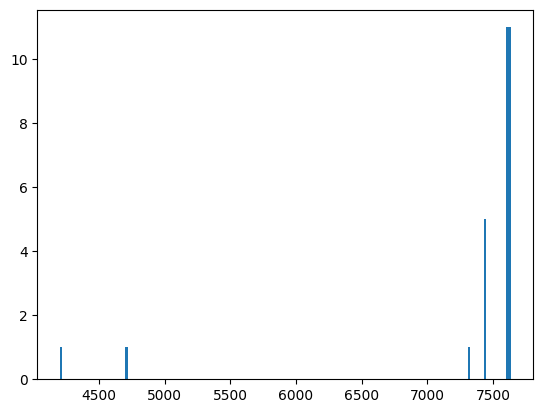

In [8]:
plt.hist(all_frequencies,bins=200)
print(len(all_frequencies))
plt.rcParams["figure.figsize"] = (20,5)   

# plt.axvline(x=4670)
# plt.axvline(x=4800)
# plt.xlim(4000,5000)

In [46]:
'''Load the Data '''

# # peter's signal1:
# file_ON = '/datag/pipeline/AGBT16A_999_182/holding/spliced_blc0001020304050607_guppi_57517_08789_HIP54677_0009.gpuspec.0000.h5'
# file_OFF = '/datag/pipeline/AGBT16A_999_182/holding/spliced_blc0001020304050607_guppi_57517_09209_HIP53759_0010.gpuspec.0000.h5'
# file3 = '/datag/pipeline/AGBT16A_999_182/holding/spliced_blc0001020304050607_guppi_57517_09628_HIP54677_0011.gpuspec.0000.h5'
# file4 = '/datag/pipeline/AGBT16A_999_182/holding/spliced_blc0001020304050607_guppi_57517_10032_HIP53820_0012.gpuspec.0000.h5'
# file5 = '/datag/pipeline/AGBT16A_999_182/holding/spliced_blc0001020304050607_guppi_57517_10436_HIP54677_0013.gpuspec.0000.h5'
# file6 = '/datag/pipeline/AGBT16A_999_182/holding/spliced_blc0001020304050607_guppi_57517_10836_HIP53839_0014.gpuspec.0000.h5'

# peter signal 2:
# file_ON = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_08647_HIP62207_0033.gpuspec.0000.h5'
# file_OFF = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_09023_HIP61072_0034.gpuspec.0000.h5'
# file3 = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_09397_HIP62207_0035.gpuspec.0000.h5'
# file4 = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_09782_HIP61074_0036.gpuspec.0000.h5'
# file5 = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_10165_HIP62207_0037.gpuspec.0000.h5'
# file6 = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_10527_HIP61114_0038.gpuspec.0000.h5'

# peter signal 3:
# file_ON = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_08647_HIP62207_0033.gpuspec.0000.h5'
# file_OFF = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_09023_HIP61072_0034.gpuspec.0000.h5'
# file3 = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_09397_HIP62207_0035.gpuspec.0000.h5'
# file4 = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_09782_HIP61074_0036.gpuspec.0000.h5'
# file5 = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_10165_HIP62207_0037.gpuspec.0000.h5'
# file6 = '/datag/pipeline/AGBT16A_999_213/holding/spliced_blc0001020304050607_guppi_57543_10527_HIP61114_0038.gpuspec.0000.h5'

with open("/datax/scratch/calebp/seticore_testing/all_file_names.np", "rb") as fp:   #Pickling
    all_names = pickle.load(fp)

loc = 1276

# all_file_names = [('/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/AND_XI/blc36_guppi_59860_25089_And_XI_0034.rawspec.0000.h5', '/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/AND_XI/blc36_guppi_59860_25403_HIP3473_0035.rawspec.0000.h5', '/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/AND_XI/blc36_guppi_59860_25717_And_XI_0036.rawspec.0000.h5', '/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/AND_XI/blc36_guppi_59860_26039_HIP3062_0037.rawspec.0000.h5', '/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/AND_XI/blc36_guppi_59860_26361_And_XI_0038.rawspec.0000.h5', '/datax/scratch/calebp/seticore_testing/snr_testing/8off10on/AND_XI/blc36_guppi_59860_26676_HIP3438_0039.rawspec.0000.h5')]


file_ON = all_file_names[loc][0]
file_OFF = all_file_names[loc][1]
file3 = all_file_names[loc][2]
file4 = all_file_names[loc][3]
file5 = all_file_names[loc][4]
file6 = all_file_names[loc][5]

hf_ON = h5py.File(file_ON, 'r')
hf_OFF = h5py.File(file_OFF, 'r')
hf_ON2 = h5py.File(file3, 'r')
hf_OFF2 = h5py.File(file4, 'r')
hf_ON3 = h5py.File(file5, 'r')
hf_OFF3 = h5py.File(file6, 'r')

# get last time row
last_time_row_ON = get_last_time_row(file_ON)
print(len(last_time_row_ON))
print(file_ON)
# calculate frequency properties of file
fch1,foff = get_file_properties(hf_ON)

67108864
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC584/blc31_guppi_59419_24827_NGC584_0118.rawspec.0000.h5
tstart 59419.287350 fch1 4876.4648437500 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 4782.7148437500 src_raj 1.5224244444 src_raj_degs 22.8363666667 src_dej -5.8097319444 target NGC584


In [33]:
# calculate number of iterations needed and find hotspots
number = int(np.round(len(last_time_row_ON)/block_size))
# record interesting freq chunks
hotspots_ON = find_hotspots(last_time_row_ON)
# hotspots_OFF = find_hotspots(last_time_row_OFF)
print("# of hotspots:",len(hotspots_ON))
# filter the hotspots

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31987/31987 [00:07<00:00, 4030.34it/s]

# of hotspots: 23662


# post filtering 39


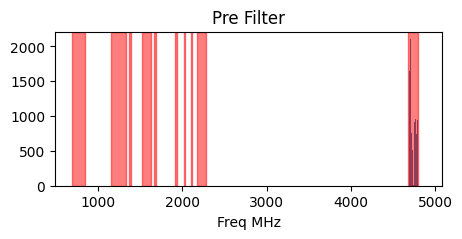

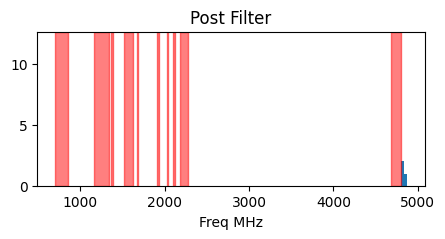

In [80]:
bad_regions = [[700,850],[1370,1390],[1520,1630],[1160,1340],[1670,1690],[2180,2280],[2025,2035],[2100,2120],[4680,4800],[1915,1935]]

filtered_indexes = filter_hotspots(hotspots_ON)
filtered_hotspots = np.delete(hotspots_ON, filtered_indexes)
print("# post filtering",len(filtered_hotspots))

# plotting
# plot hotspots pre and post filtering

hotspot_frequencies = np.array([int((fch1+foff*(i*500))) for i in hotspots_ON])
plt.rcParams["figure.figsize"] = (5,2)   
plt.hist(hotspot_frequencies,bins=50)
# plt.xlim(90000,120000)
for i in bad_regions:
    plt.axvspan(i[0],i[1],color='red',alpha=.5)
plt.xlabel("Freq MHz")
plt.title("Pre Filter")


plt.show()

hotspot_frequencies = np.array([int((fch1+foff*(i*500))) for i in filtered_hotspots])
plt.rcParams["figure.figsize"] = (5,2)   
plt.hist(hotspot_frequencies,bins=20)
# plt.xlim(90000,120000)
for i in bad_regions:
    plt.axvspan(i[0],i[1],color='red',alpha=.5)

plt.xlabel("Freq MHz")
plt.title("Post Filter")
plt.show()


In [78]:
low_correlations = check_hotspots(hf_ON,hf_OFF,hf_ON2,hf_OFF2,hf_ON3,hf_OFF,filtered_hotspots)

  0%|▏                                                                                                                                                                                                                | 28/23662 [00:00<01:25, 277.43it/s]

same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blip

  0%|▍                                                                                                                                                                                                                | 56/23662 [00:00<02:15, 174.24it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


  0%|▋                                                                                                                                                                                                                | 76/23662 [00:00<02:18, 169.84it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


  0%|▊                                                                                                                                                                                                                | 95/23662 [00:00<02:56, 133.27it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


  1%|█▏                                                                                                                                                                                                              | 128/23662 [00:00<03:25, 114.41it/s]

checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


  1%|█▍                                                                                                                                                                                                              | 160/23662 [00:01<03:29, 112.08it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
checking blips


  1%|█▋                                                                                                                                                                                                              | 186/23662 [00:01<03:24, 114.87it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


  1%|█▉                                                                                                                                                                                                              | 218/23662 [00:01<02:54, 134.66it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


  1%|██▏                                                                                                                                                                                                             | 251/23662 [00:01<02:38, 147.76it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


  1%|██▍                                                                                                                                                                                                             | 283/23662 [00:02<02:34, 151.22it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


  1%|██▊                                                                                                                                                                                                             | 315/23662 [00:02<02:55, 133.23it/s]

Checking correlation
checking broadband
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


  1%|██▉                                                                                                                                                                                                             | 330/23662 [00:02<03:21, 115.65it/s]

checking blips
Checking correlation
checking broadband
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


  2%|███▏                                                                                                                                                                                                            | 363/23662 [00:02<02:52, 135.41it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


  2%|███▍                                                                                                                                                                                                            | 396/23662 [00:02<02:38, 147.05it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


  2%|███▊                                                                                                                                                                                                            | 429/23662 [00:03<02:30, 154.06it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


  2%|███▉                                                                                                                                                                                                            | 445/23662 [00:03<02:31, 153.75it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband


  2%|████▏                                                                                                                                                                                                           | 477/23662 [00:03<02:53, 133.37it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


  2%|████▍                                                                                                                                                                                                           | 509/23662 [00:03<02:42, 142.81it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


  2%|████▊                                                                                                                                                                                                           | 541/23662 [00:03<02:38, 145.77it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


  2%|█████                                                                                                                                                                                                           | 573/23662 [00:04<02:33, 150.43it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


  3%|█████▎                                                                                                                                                                                                          | 605/23662 [00:04<02:29, 153.83it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


  3%|█████▌                                                                                                                                                                                                          | 637/23662 [00:04<02:30, 153.11it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


  3%|█████▉                                                                                                                                                                                                          | 669/23662 [00:04<02:28, 154.47it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


  3%|██████▏                                                                                                                                                                                                         | 701/23662 [00:05<02:27, 155.79it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips


  3%|██████▍                                                                                                                                                                                                         | 734/23662 [00:05<02:26, 156.40it/s]

Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


  3%|██████▋                                                                                                                                                                                                         | 766/23662 [00:05<02:27, 154.72it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


  3%|███████                                                                                                                                                                                                         | 798/23662 [00:05<02:28, 153.47it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


  4%|███████▎                                                                                                                                                                                                        | 831/23662 [00:05<02:28, 153.99it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


  4%|███████▌                                                                                                                                                                                                        | 863/23662 [00:06<02:27, 154.85it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


  4%|███████▊                                                                                                                                                                                                        | 895/23662 [00:06<02:26, 155.85it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


  4%|████████▏                                                                                                                                                                                                       | 929/23662 [00:06<02:21, 160.93it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


  4%|████████▍                                                                                                                                                                                                       | 962/23662 [00:06<02:22, 159.28it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


  4%|████████▊                                                                                                                                                                                                       | 996/23662 [00:06<02:20, 160.99it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


  4%|█████████                                                                                                                                                                                                      | 1030/23662 [00:07<02:20, 160.91it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


  4%|█████████▎                                                                                                                                                                                                     | 1064/23662 [00:07<02:22, 158.31it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


  5%|█████████▌                                                                                                                                                                                                     | 1097/23662 [00:07<02:22, 158.57it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


  5%|█████████▋                                                                                                                                                                                                     | 1113/23662 [00:07<02:23, 156.69it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


  5%|█████████▉                                                                                                                                                                                                     | 1129/23662 [00:07<02:29, 150.60it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


  5%|██████████                                                                                                                                                                                                      | 1145/23662 [00:08<04:26, 84.52it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2421643476606852
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


  5%|██████████▎                                                                                                                                                                                                    | 1175/23662 [00:08<03:32, 106.00it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


  5%|██████████▌                                                                                                                                                                                                    | 1206/23662 [00:08<02:59, 124.93it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


  5%|██████████▊                                                                                                                                                                                                    | 1237/23662 [00:08<02:43, 137.24it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


  5%|███████████                                                                                                                                                                                                    | 1270/23662 [00:08<02:31, 147.95it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


  6%|███████████▍                                                                                                                                                                                                   | 1302/23662 [00:09<02:28, 151.07it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


  6%|███████████▋                                                                                                                                                                                                   | 1335/23662 [00:09<02:22, 156.20it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


  6%|███████████▊                                                                                                                                                                                                   | 1351/23662 [00:09<02:24, 154.23it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


  6%|████████████                                                                                                                                                                                                   | 1383/23662 [00:09<02:47, 132.64it/s]

checking broadband
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


  6%|████████████▍                                                                                                                                                                                                  | 1416/23662 [00:09<02:31, 146.62it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


  6%|████████████▋                                                                                                                                                                                                  | 1448/23662 [00:10<02:26, 152.14it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
same number of strong signals


  6%|████████████▉                                                                                                                                                                                                  | 1482/23662 [00:10<02:23, 154.48it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


  6%|█████████████▏                                                                                                                                                                                                 | 1514/23662 [00:10<02:24, 152.93it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


  6%|█████████████▍                                                                                                                                                                                                 | 1530/23662 [00:10<02:26, 150.91it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.33151183587570954
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


  7%|█████████████▋                                                                                                                                                                                                 | 1561/23662 [00:11<02:54, 126.95it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


  7%|█████████████▉                                                                                                                                                                                                 | 1593/23662 [00:11<02:37, 140.54it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


  7%|██████████████▏                                                                                                                                                                                                | 1624/23662 [00:11<02:31, 145.13it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


  7%|██████████████▍                                                                                                                                                                                                | 1657/23662 [00:11<02:23, 153.58it/s]

Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


  7%|██████████████▊                                                                                                                                                                                                | 1689/23662 [00:11<02:23, 153.12it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


  7%|███████████████                                                                                                                                                                                                | 1721/23662 [00:12<02:21, 155.08it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


  7%|███████████████▎                                                                                                                                                                                               | 1753/23662 [00:12<02:20, 155.66it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


  8%|███████████████▌                                                                                                                                                                                               | 1786/23662 [00:12<02:20, 155.30it/s]

Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


  8%|███████████████▊                                                                                                                                                                                               | 1802/23662 [00:12<02:20, 155.43it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation


  8%|████████████████                                                                                                                                                                                               | 1834/23662 [00:12<02:44, 132.43it/s]

checking broadband
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


  8%|████████████████▎                                                                                                                                                                                              | 1867/23662 [00:13<02:28, 146.56it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


  8%|████████████████▍                                                                                                                                                                                              | 1883/23662 [00:13<02:25, 150.17it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
checking blips


  8%|████████████████▊                                                                                                                                                                                              | 1915/23662 [00:13<02:43, 132.65it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation


  8%|█████████████████                                                                                                                                                                                              | 1947/23662 [00:13<02:30, 144.28it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


  8%|█████████████████▎                                                                                                                                                                                             | 1979/23662 [00:13<02:24, 150.52it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


  9%|█████████████████▌                                                                                                                                                                                             | 2012/23662 [00:14<02:18, 156.44it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


  9%|█████████████████▉                                                                                                                                                                                             | 2044/23662 [00:14<02:18, 156.62it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


  9%|██████████████████▏                                                                                                                                                                                            | 2076/23662 [00:14<02:26, 147.57it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


  9%|██████████████████▍                                                                                                                                                                                            | 2106/23662 [00:14<02:32, 141.25it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


  9%|██████████████████▋                                                                                                                                                                                            | 2136/23662 [00:14<02:33, 140.62it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


  9%|██████████████████▊                                                                                                                                                                                            | 2151/23662 [00:15<02:34, 138.94it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


  9%|███████████████████                                                                                                                                                                                             | 2165/23662 [00:15<04:05, 87.41it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.2717800969167516
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


  9%|███████████████████▏                                                                                                                                                                                            | 2177/23662 [00:15<05:01, 71.15it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.17535356794736526
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation


  9%|███████████████████▍                                                                                                                                                                                            | 2208/23662 [00:15<03:37, 98.84it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


  9%|███████████████████▌                                                                                                                                                                                            | 2221/23662 [00:16<04:38, 76.90it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.24576273208763044
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 10%|███████████████████▊                                                                                                                                                                                            | 2252/23662 [00:16<04:18, 82.96it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2813175807220393
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 10%|███████████████████▉                                                                                                                                                                                           | 2283/23662 [00:16<03:17, 108.46it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 10%|████████████████████▏                                                                                                                                                                                          | 2313/23662 [00:16<02:51, 124.44it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 10%|████████████████████▌                                                                                                                                                                                          | 2345/23662 [00:17<02:34, 137.54it/s]

Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 10%|████████████████████▊                                                                                                                                                                                          | 2375/23662 [00:17<02:29, 142.63it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


 10%|█████████████████████                                                                                                                                                                                          | 2407/23662 [00:17<02:22, 149.04it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 10%|█████████████████████▎                                                                                                                                                                                         | 2439/23662 [00:17<02:42, 130.74it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 10%|█████████████████████▌                                                                                                                                                                                         | 2470/23662 [00:17<02:30, 140.63it/s]

Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 11%|█████████████████████▉                                                                                                                                                                                         | 2501/23662 [00:18<02:24, 146.61it/s]

Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 11%|██████████████████████▏                                                                                                                                                                                        | 2531/23662 [00:18<02:28, 142.28it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


 11%|██████████████████████▎                                                                                                                                                                                        | 2548/23662 [00:18<02:22, 147.93it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 11%|██████████████████████▌                                                                                                                                                                                        | 2582/23662 [00:18<02:17, 153.78it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 11%|██████████████████████▊                                                                                                                                                                                        | 2613/23662 [00:18<02:27, 142.59it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


 11%|███████████████████████                                                                                                                                                                                        | 2643/23662 [00:19<02:32, 137.85it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 11%|███████████████████████▍                                                                                                                                                                                       | 2673/23662 [00:19<02:25, 143.94it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 11%|███████████████████████▋                                                                                                                                                                                        | 2688/23662 [00:19<03:35, 97.49it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.2665573765829964
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 11%|███████████████████████▊                                                                                                                                                                                       | 2720/23662 [00:19<02:54, 120.05it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 12%|████████████████████████                                                                                                                                                                                       | 2752/23662 [00:20<02:31, 137.65it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 12%|████████████████████████▎                                                                                                                                                                                      | 2782/23662 [00:20<02:27, 141.21it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 12%|████████████████████████▌                                                                                                                                                                                      | 2813/23662 [00:20<02:23, 145.02it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 12%|████████████████████████▋                                                                                                                                                                                      | 2828/23662 [00:20<02:29, 139.24it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation


 12%|████████████████████████▊                                                                                                                                                                                      | 2843/23662 [00:20<02:32, 136.95it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 12%|█████████████████████████                                                                                                                                                                                      | 2872/23662 [00:21<03:25, 101.20it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.23171340587357445
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 12%|█████████████████████████▍                                                                                                                                                                                     | 2904/23662 [00:21<02:47, 123.65it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation


 12%|█████████████████████████▋                                                                                                                                                                                     | 2935/23662 [00:21<02:31, 136.89it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 12%|█████████████████████████▊                                                                                                                                                                                     | 2950/23662 [00:21<02:57, 116.64it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 13%|██████████████████████████                                                                                                                                                                                     | 2979/23662 [00:21<02:58, 115.58it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 13%|██████████████████████████▎                                                                                                                                                                                    | 3012/23662 [00:22<02:33, 134.59it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 13%|██████████████████████████▋                                                                                                                                                                                    | 3044/23662 [00:22<02:21, 145.39it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 13%|██████████████████████████▉                                                                                                                                                                                    | 3077/23662 [00:22<02:14, 152.77it/s]

Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 13%|███████████████████████████▏                                                                                                                                                                                   | 3110/23662 [00:22<02:12, 155.50it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


 13%|███████████████████████████▎                                                                                                                                                                                   | 3126/23662 [00:22<02:11, 155.60it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 13%|███████████████████████████▌                                                                                                                                                                                   | 3156/23662 [00:23<03:10, 107.60it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.3086038963118911
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.43471377119080745
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 13%|███████████████████████████▊                                                                                                                                                                                   | 3186/23662 [00:23<02:44, 124.12it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 14%|████████████████████████████▏                                                                                                                                                                                  | 3218/23662 [00:23<02:27, 138.84it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


 14%|████████████████████████████▎                                                                                                                                                                                  | 3233/23662 [00:23<02:58, 114.37it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.34782291549925476
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 14%|████████████████████████████▌                                                                                                                                                                                  | 3264/23662 [00:24<02:36, 130.34it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 14%|████████████████████████████▊                                                                                                                                                                                  | 3296/23662 [00:24<02:23, 142.02it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


 14%|█████████████████████████████                                                                                                                                                                                   | 3311/23662 [00:24<03:31, 96.09it/s]

Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.21637107202223502
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 14%|█████████████████████████████▏                                                                                                                                                                                 | 3341/23662 [00:24<02:56, 114.96it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 14%|█████████████████████████████▌                                                                                                                                                                                 | 3373/23662 [00:24<02:32, 133.11it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 14%|█████████████████████████████▊                                                                                                                                                                                 | 3404/23662 [00:25<02:23, 141.14it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 15%|██████████████████████████████                                                                                                                                                                                 | 3434/23662 [00:25<02:22, 142.25it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 15%|██████████████████████████████▏                                                                                                                                                                                | 3449/23662 [00:25<02:53, 116.50it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 15%|██████████████████████████████▎                                                                                                                                                                                | 3463/23662 [00:25<02:45, 121.73it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 15%|██████████████████████████████▍                                                                                                                                                                                | 3476/23662 [00:25<03:21, 100.10it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 15%|██████████████████████████████▊                                                                                                                                                                                 | 3504/23662 [00:26<03:22, 99.55it/s]

checking broadband
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 15%|██████████████████████████████▉                                                                                                                                                                                | 3533/23662 [00:26<02:51, 117.66it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 15%|███████████████████████████████▎                                                                                                                                                                                | 3562/23662 [00:26<03:23, 98.65it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2733045134564251
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 15%|███████████████████████████████▍                                                                                                                                                                               | 3596/23662 [00:26<02:39, 125.60it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 15%|███████████████████████████████▋                                                                                                                                                                               | 3629/23662 [00:27<02:23, 139.90it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 15%|████████████████████████████████                                                                                                                                                                               | 3661/23662 [00:27<02:14, 148.36it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation


 16%|████████████████████████████████▏                                                                                                                                                                              | 3677/23662 [00:27<02:12, 151.02it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 16%|████████████████████████████████▍                                                                                                                                                                              | 3708/23662 [00:27<02:47, 119.20it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.33911766301717794
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 16%|████████████████████████████████▋                                                                                                                                                                              | 3740/23662 [00:27<02:28, 134.16it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 16%|████████████████████████████████▉                                                                                                                                                                              | 3772/23662 [00:28<02:17, 144.33it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 16%|█████████████████████████████████▎                                                                                                                                                                             | 3804/23662 [00:28<02:12, 149.95it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 16%|█████████████████████████████████▍                                                                                                                                                                             | 3820/23662 [00:28<02:15, 146.83it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 16%|█████████████████████████████████▋                                                                                                                                                                             | 3852/23662 [00:28<02:13, 148.22it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 16%|█████████████████████████████████▉                                                                                                                                                                             | 3882/23662 [00:28<02:35, 127.03it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 17%|██████████████████████████████████▏                                                                                                                                                                            | 3912/23662 [00:29<02:25, 136.18it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 17%|██████████████████████████████████▍                                                                                                                                                                            | 3942/23662 [00:29<02:18, 142.35it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 17%|██████████████████████████████████▋                                                                                                                                                                            | 3972/23662 [00:29<02:42, 121.12it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 17%|███████████████████████████████████                                                                                                                                                                            | 4004/23662 [00:29<02:23, 137.18it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 17%|███████████████████████████████████▎                                                                                                                                                                           | 4036/23662 [00:30<02:14, 146.03it/s]

Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 17%|███████████████████████████████████▌                                                                                                                                                                           | 4069/23662 [00:30<02:09, 151.06it/s]

checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 17%|███████████████████████████████████▋                                                                                                                                                                           | 4085/23662 [00:30<02:09, 150.92it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 17%|████████████████████████████████████                                                                                                                                                                           | 4117/23662 [00:30<02:08, 152.26it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 18%|████████████████████████████████████▎                                                                                                                                                                          | 4149/23662 [00:30<02:06, 153.98it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 18%|████████████████████████████████████▌                                                                                                                                                                          | 4181/23662 [00:31<02:08, 151.59it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 18%|████████████████████████████████████▋                                                                                                                                                                          | 4197/23662 [00:31<02:10, 149.19it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.3524440794218534
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 18%|████████████████████████████████████▉                                                                                                                                                                          | 4225/23662 [00:31<03:03, 105.81it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband
same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.4645042640659772
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 18%|█████████████████████████████████████▏                                                                                                                                                                         | 4257/23662 [00:31<02:33, 126.72it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 18%|█████████████████████████████████████▎                                                                                                                                                                         | 4271/23662 [00:31<02:31, 127.79it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.35966290585945393
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 18%|█████████████████████████████████████▋                                                                                                                                                                         | 4301/23662 [00:32<02:41, 120.16it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 18%|█████████████████████████████████████▉                                                                                                                                                                         | 4333/23662 [00:32<02:22, 135.85it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 18%|██████████████████████████████████████▏                                                                                                                                                                        | 4364/23662 [00:32<02:55, 109.79it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.29149643030126127
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 19%|██████████████████████████████████████▍                                                                                                                                                                        | 4399/23662 [00:32<02:23, 133.85it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 19%|██████████████████████████████████████▌                                                                                                                                                                        | 4415/23662 [00:33<02:45, 116.06it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 19%|██████████████████████████████████████▉                                                                                                                                                                        | 4447/23662 [00:33<02:24, 133.15it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 19%|███████████████████████████████████████▏                                                                                                                                                                       | 4479/23662 [00:33<02:12, 144.56it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 19%|███████████████████████████████████████▍                                                                                                                                                                       | 4511/23662 [00:33<02:10, 147.23it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 19%|███████████████████████████████████████▋                                                                                                                                                                       | 4543/23662 [00:33<02:07, 150.40it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 19%|███████████████████████████████████████▉                                                                                                                                                                       | 4559/23662 [00:34<02:35, 123.13it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 19%|████████████████████████████████████████▏                                                                                                                                                                      | 4591/23662 [00:34<02:18, 138.06it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 19%|████████████████████████████████████████▎                                                                                                                                                                      | 4607/23662 [00:34<02:14, 141.75it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 20%|████████████████████████████████████████▌                                                                                                                                                                      | 4635/23662 [00:34<03:01, 104.60it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 20%|████████████████████████████████████████▊                                                                                                                                                                      | 4667/23662 [00:34<02:30, 125.80it/s]

checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checkin

 20%|█████████████████████████████████████████                                                                                                                                                                      | 4698/23662 [00:35<02:57, 106.67it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2955926768941226
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 20%|█████████████████████████████████████████▎                                                                                                                                                                     | 4727/23662 [00:35<02:51, 110.37it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.3372022673276115
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation


 20%|█████████████████████████████████████████▌                                                                                                                                                                     | 4758/23662 [00:35<02:27, 128.41it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 20%|█████████████████████████████████████████▉                                                                                                                                                                     | 4790/23662 [00:36<02:14, 140.74it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 20%|██████████████████████████████████████████▏                                                                                                                                                                    | 4821/23662 [00:36<02:09, 145.29it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 20%|██████████████████████████████████████████▌                                                                                                                                                                     | 4836/23662 [00:36<03:08, 99.66it/s]

checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.2959165495235049
checking blips
Checking correlation
checking blips
checking blips
checking blips


 21%|██████████████████████████████████████████▌                                                                                                                                                                    | 4867/23662 [00:36<02:35, 121.00it/s]

Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 21%|██████████████████████████████████████████▋                                                                                                                                                                    | 4883/23662 [00:36<02:23, 130.45it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 21%|███████████████████████████████████████████                                                                                                                                                                    | 4916/23662 [00:36<02:12, 141.94it/s]

Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 21%|███████████████████████████████████████████▏                                                                                                                                                                   | 4932/23662 [00:37<02:09, 144.53it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 21%|███████████████████████████████████████████▍                                                                                                                                                                   | 4963/23662 [00:37<02:47, 111.84it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.27762532424374886
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 21%|███████████████████████████████████████████▋                                                                                                                                                                   | 4995/23662 [00:37<02:23, 130.17it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 21%|███████████████████████████████████████████▉                                                                                                                                                                   | 5029/23662 [00:37<02:07, 146.07it/s]

Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 21%|████████████████████████████████████████████▏                                                                                                                                                                  | 5045/23662 [00:37<02:05, 147.88it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 21%|████████████████████████████████████████████▍                                                                                                                                                                  | 5078/23662 [00:38<02:38, 116.97it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.24938384227699545
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 22%|████████████████████████████████████████████▋                                                                                                                                                                  | 5110/23662 [00:38<02:17, 134.85it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation


 22%|████████████████████████████████████████████▉                                                                                                                                                                  | 5143/23662 [00:38<02:06, 146.00it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 22%|█████████████████████████████████████████████▎                                                                                                                                                                 | 5176/23662 [00:38<01:59, 154.14it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 22%|█████████████████████████████████████████████▌                                                                                                                                                                 | 5208/23662 [00:39<02:01, 152.12it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 22%|█████████████████████████████████████████████▊                                                                                                                                                                 | 5240/23662 [00:39<02:00, 153.32it/s]

Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 22%|█████████████████████████████████████████████▉                                                                                                                                                                 | 5256/23662 [00:39<02:00, 152.56it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 22%|██████████████████████████████████████████████▎                                                                                                                                                                | 5288/23662 [00:39<02:00, 152.61it/s]

Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 22%|██████████████████████████████████████████████▌                                                                                                                                                                | 5320/23662 [00:39<01:58, 155.35it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 23%|██████████████████████████████████████████████▊                                                                                                                                                                | 5352/23662 [00:40<01:57, 155.97it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 23%|███████████████████████████████████████████████                                                                                                                                                                | 5384/23662 [00:40<01:58, 154.72it/s]

Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


 23%|███████████████████████████████████████████████▍                                                                                                                                                               | 5416/23662 [00:40<02:00, 151.55it/s]

Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 23%|███████████████████████████████████████████████▋                                                                                                                                                               | 5448/23662 [00:40<01:59, 152.34it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 23%|███████████████████████████████████████████████▉                                                                                                                                                               | 5481/23662 [00:40<01:56, 155.96it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


 23%|████████████████████████████████████████████████▏                                                                                                                                                              | 5513/23662 [00:41<01:56, 155.42it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 23%|████████████████████████████████████████████████▌                                                                                                                                                              | 5545/23662 [00:41<01:56, 155.27it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 24%|████████████████████████████████████████████████▊                                                                                                                                                              | 5577/23662 [00:41<01:56, 154.85it/s]

Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 24%|█████████████████████████████████████████████████                                                                                                                                                              | 5609/23662 [00:41<01:55, 155.87it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 24%|█████████████████████████████████████████████████▎                                                                                                                                                             | 5641/23662 [00:41<01:56, 154.90it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 24%|█████████████████████████████████████████████████▋                                                                                                                                                             | 5674/23662 [00:42<01:54, 156.77it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 24%|█████████████████████████████████████████████████▉                                                                                                                                                             | 5707/23662 [00:42<01:54, 157.25it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 24%|██████████████████████████████████████████████████▏                                                                                                                                                            | 5739/23662 [00:42<01:55, 154.59it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 24%|██████████████████████████████████████████████████▎                                                                                                                                                            | 5755/23662 [00:42<01:56, 153.12it/s]

Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 24%|██████████████████████████████████████████████████▋                                                                                                                                                            | 5787/23662 [00:43<02:34, 115.72it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.14958894581989804
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 25%|██████████████████████████████████████████████████▉                                                                                                                                                            | 5818/23662 [00:43<02:15, 131.89it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 25%|███████████████████████████████████████████████████▏                                                                                                                                                           | 5851/23662 [00:43<02:02, 145.27it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 25%|███████████████████████████████████████████████████▍                                                                                                                                                           | 5885/23662 [00:43<01:53, 156.54it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 25%|███████████████████████████████████████████████████▊                                                                                                                                                           | 5918/23662 [00:44<02:31, 117.06it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.22671473797734604
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 25%|████████████████████████████████████████████████████                                                                                                                                                           | 5949/23662 [00:44<02:14, 131.75it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


 25%|████████████████████████████████████████████████████▏                                                                                                                                                          | 5965/23662 [00:44<02:08, 138.10it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 25%|████████████████████████████████████████████████████▍                                                                                                                                                          | 5996/23662 [00:44<02:40, 109.99it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.25511527142800833
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


 25%|████████████████████████████████████████████████████▌                                                                                                                                                          | 6012/23662 [00:44<02:26, 120.76it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 26%|████████████████████████████████████████████████████▊                                                                                                                                                          | 6042/23662 [00:45<02:51, 102.89it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2172506230615955
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 26%|█████████████████████████████████████████████████████                                                                                                                                                          | 6070/23662 [00:45<02:47, 104.94it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.3172991335818759
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 26%|█████████████████████████████████████████████████████▎                                                                                                                                                         | 6101/23662 [00:45<02:21, 124.52it/s]

Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


 26%|█████████████████████████████████████████████████████▋                                                                                                                                                         | 6133/23662 [00:45<02:06, 138.98it/s]

Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 26%|█████████████████████████████████████████████████████▉                                                                                                                                                         | 6165/23662 [00:46<01:57, 148.35it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 26%|██████████████████████████████████████████████████████▏                                                                                                                                                        | 6199/23662 [00:46<01:50, 158.30it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlatio

 26%|██████████████████████████████████████████████████████▌                                                                                                                                                        | 6232/23662 [00:46<02:30, 115.88it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.3112027866725102
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 26%|██████████████████████████████████████████████████████▊                                                                                                                                                        | 6263/23662 [00:46<02:13, 130.40it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 27%|███████████████████████████████████████████████████████                                                                                                                                                        | 6295/23662 [00:47<02:03, 140.42it/s]

Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 27%|███████████████████████████████████████████████████████▎                                                                                                                                                       | 6327/23662 [00:47<01:58, 146.63it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 27%|███████████████████████████████████████████████████████▋                                                                                                                                                       | 6359/23662 [00:47<01:55, 150.04it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 27%|███████████████████████████████████████████████████████▉                                                                                                                                                       | 6391/23662 [00:47<01:54, 151.09it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 27%|████████████████████████████████████████████████████████▏                                                                                                                                                      | 6423/23662 [00:47<01:54, 150.20it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 27%|████████████████████████████████████████████████████████▍                                                                                                                                                      | 6456/23662 [00:48<01:51, 154.64it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 27%|████████████████████████████████████████████████████████▊                                                                                                                                                      | 6489/23662 [00:48<01:49, 156.88it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 28%|█████████████████████████████████████████████████████████                                                                                                                                                      | 6521/23662 [00:48<01:50, 154.51it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 28%|█████████████████████████████████████████████████████████▎                                                                                                                                                     | 6553/23662 [00:48<01:53, 150.90it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 28%|█████████████████████████████████████████████████████████▌                                                                                                                                                     | 6585/23662 [00:49<01:50, 154.14it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 28%|█████████████████████████████████████████████████████████▉                                                                                                                                                     | 6617/23662 [00:49<01:49, 155.88it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 28%|██████████████████████████████████████████████████████████▏                                                                                                                                                    | 6649/23662 [00:49<01:49, 155.30it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 28%|██████████████████████████████████████████████████████████▎                                                                                                                                                    | 6665/23662 [00:49<01:49, 155.59it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 28%|██████████████████████████████████████████████████████████▌                                                                                                                                                    | 6697/23662 [00:49<02:12, 128.42it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.3053092905834962
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 28%|██████████████████████████████████████████████████████████▊                                                                                                                                                    | 6728/23662 [00:50<02:01, 139.09it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 29%|███████████████████████████████████████████████████████████                                                                                                                                                    | 6758/23662 [00:50<01:59, 140.87it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 29%|███████████████████████████████████████████████████████████▍                                                                                                                                                   | 6791/23662 [00:50<01:52, 149.64it/s]

checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 29%|███████████████████████████████████████████████████████████▋                                                                                                                                                   | 6822/23662 [00:50<01:54, 146.81it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


 29%|███████████████████████████████████████████████████████████▉                                                                                                                                                   | 6852/23662 [00:50<01:54, 146.31it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 29%|████████████████████████████████████████████████████████████                                                                                                                                                   | 6868/23662 [00:51<01:53, 147.80it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 29%|████████████████████████████████████████████████████████████▏                                                                                                                                                  | 6883/23662 [00:51<01:56, 144.24it/s]

Checking correlation
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.2758412563190408
checking blips
Checking correlation
checking blips
checking blips


 29%|████████████████████████████████████████████████████████████▍                                                                                                                                                  | 6913/23662 [00:51<02:33, 109.23it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 29%|████████████████████████████████████████████████████████████▌                                                                                                                                                  | 6928/23662 [00:51<02:21, 118.50it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 29%|█████████████████████████████████████████████████████████████                                                                                                                                                   | 6942/23662 [00:51<03:09, 88.32it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.294334321881763
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 29%|█████████████████████████████████████████████████████████████▎                                                                                                                                                  | 6972/23662 [00:52<03:06, 89.42it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.27650296421473164
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 30%|█████████████████████████████████████████████████████████████▎                                                                                                                                                 | 7004/23662 [00:52<02:25, 114.66it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 30%|█████████████████████████████████████████████████████████████▌                                                                                                                                                 | 7036/23662 [00:52<02:06, 131.81it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 30%|█████████████████████████████████████████████████████████████▋                                                                                                                                                 | 7052/23662 [00:52<02:00, 137.65it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.24914794677540458


 30%|█████████████████████████████████████████████████████████████▉                                                                                                                                                 | 7082/23662 [00:53<02:32, 108.93it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 30%|██████████████████████████████████████████████████████████████▏                                                                                                                                                | 7114/23662 [00:53<02:07, 129.30it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 30%|██████████████████████████████████████████████████████████████▌                                                                                                                                                | 7146/23662 [00:53<02:32, 108.54it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2926247208715222
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 30%|██████████████████████████████████████████████████████████████▋                                                                                                                                                | 7162/23662 [00:53<02:17, 119.66it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 30%|██████████████████████████████████████████████████████████████▉                                                                                                                                                | 7192/23662 [00:54<02:41, 101.79it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.28412811097360524
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 30%|███████████████████████████████████████████████████████████████                                                                                                                                                | 7208/23662 [00:54<02:25, 113.17it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.15477604560893288
checking blips
checking blips
checking blips
Checking correlation


 31%|███████████████████████████████████████████████████████████████▍                                                                                                                                                | 7222/23662 [00:54<03:07, 87.53it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.34996276337115634
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips


 31%|███████████████████████████████████████████████████████████████▍                                                                                                                                               | 7250/23662 [00:54<02:43, 100.51it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 31%|███████████████████████████████████████████████████████████████▋                                                                                                                                               | 7282/23662 [00:54<02:13, 122.57it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 31%|███████████████████████████████████████████████████████████████▉                                                                                                                                               | 7313/23662 [00:55<01:59, 136.75it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 31%|████████████████████████████████████████████████████████████████▎                                                                                                                                              | 7345/23662 [00:55<01:52, 145.49it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 31%|████████████████████████████████████████████████████████████████▌                                                                                                                                              | 7375/23662 [00:55<01:55, 140.41it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 31%|████████████████████████████████████████████████████████████████▊                                                                                                                                              | 7407/23662 [00:55<01:51, 145.55it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 31%|█████████████████████████████████████████████████████████████████                                                                                                                                              | 7437/23662 [00:56<01:50, 146.78it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 32%|█████████████████████████████████████████████████████████████████▎                                                                                                                                             | 7467/23662 [00:56<01:55, 139.98it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 32%|█████████████████████████████████████████████████████████████████▌                                                                                                                                             | 7498/23662 [00:56<02:31, 106.53it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.21085414255468282
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips


 32%|█████████████████████████████████████████████████████████████████▊                                                                                                                                             | 7526/23662 [00:56<02:15, 119.40it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 32%|██████████████████████████████████████████████████████████████████                                                                                                                                             | 7556/23662 [00:57<02:02, 131.31it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation


 32%|██████████████████████████████████████████████████████████████████▏                                                                                                                                            | 7571/23662 [00:57<01:59, 134.46it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 32%|██████████████████████████████████████████████████████████████████▍                                                                                                                                            | 7601/23662 [00:57<01:55, 138.47it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 32%|██████████████████████████████████████████████████████████████████▊                                                                                                                                            | 7631/23662 [00:57<01:55, 139.38it/s]

Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 32%|███████████████████████████████████████████████████████████████████▏                                                                                                                                            | 7646/23662 [00:57<02:51, 93.29it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.2644875453722653
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 32%|███████████████████████████████████████████████████████████████████▏                                                                                                                                           | 7676/23662 [00:58<02:21, 113.09it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 33%|███████████████████████████████████████████████████████████████████▍                                                                                                                                           | 7704/23662 [00:58<02:08, 124.37it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 33%|███████████████████████████████████████████████████████████████████▋                                                                                                                                           | 7734/23662 [00:58<01:58, 134.34it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 33%|███████████████████████████████████████████████████████████████████▉                                                                                                                                           | 7764/23662 [00:58<01:53, 140.65it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 33%|████████████████████████████████████████████████████████████████████▏                                                                                                                                          | 7795/23662 [00:58<01:49, 144.62it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 33%|████████████████████████████████████████████████████████████████████▍                                                                                                                                          | 7827/23662 [00:59<01:45, 149.58it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 33%|████████████████████████████████████████████████████████████████████▊                                                                                                                                          | 7859/23662 [00:59<01:44, 151.03it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation


 33%|█████████████████████████████████████████████████████████████████████                                                                                                                                          | 7892/23662 [00:59<01:42, 154.32it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 33%|█████████████████████████████████████████████████████████████████████▎                                                                                                                                         | 7924/23662 [00:59<01:42, 153.80it/s]

Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 34%|█████████████████████████████████████████████████████████████████████▌                                                                                                                                         | 7956/23662 [00:59<01:42, 153.51it/s]

Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation


 34%|█████████████████████████████████████████████████████████████████████▋                                                                                                                                         | 7972/23662 [01:00<01:44, 150.61it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 34%|██████████████████████████████████████████████████████████████████████                                                                                                                                         | 8003/23662 [01:00<01:46, 147.11it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 34%|██████████████████████████████████████████████████████████████████████▎                                                                                                                                        | 8033/23662 [01:00<01:47, 145.54it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 34%|██████████████████████████████████████████████████████████████████████▌                                                                                                                                        | 8063/23662 [01:00<01:45, 147.30it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 34%|██████████████████████████████████████████████████████████████████████▊                                                                                                                                        | 8095/23662 [01:00<01:43, 151.10it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 34%|███████████████████████████████████████████████████████████████████████                                                                                                                                        | 8127/23662 [01:01<01:41, 153.62it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 34%|███████████████████████████████████████████████████████████████████████▍                                                                                                                                       | 8159/23662 [01:01<01:40, 154.37it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 35%|███████████████████████████████████████████████████████████████████████▋                                                                                                                                       | 8191/23662 [01:01<01:41, 152.92it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips


 35%|███████████████████████████████████████████████████████████████████████▉                                                                                                                                       | 8223/23662 [01:01<01:40, 153.52it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 35%|████████████████████████████████████████████████████████████████████████▏                                                                                                                                      | 8255/23662 [01:01<01:40, 152.67it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 35%|████████████████████████████████████████████████████████████████████████▍                                                                                                                                      | 8287/23662 [01:02<01:41, 151.29it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 35%|████████████████████████████████████████████████████████████████████████▊                                                                                                                                      | 8319/23662 [01:02<01:40, 152.35it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 35%|█████████████████████████████████████████████████████████████████████████                                                                                                                                      | 8351/23662 [01:02<01:43, 148.11it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


 35%|█████████████████████████████████████████████████████████████████████████▎                                                                                                                                     | 8383/23662 [01:02<01:40, 152.49it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 36%|█████████████████████████████████████████████████████████████████████████▌                                                                                                                                     | 8415/23662 [01:02<01:39, 152.83it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 36%|█████████████████████████████████████████████████████████████████████████▉                                                                                                                                     | 8447/23662 [01:03<01:39, 152.33it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals


 36%|██████████████████████████████████████████████████████████████████████████▏                                                                                                                                    | 8479/23662 [01:03<01:41, 150.32it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 36%|██████████████████████████████████████████████████████████████████████████▍                                                                                                                                    | 8512/23662 [01:03<01:37, 155.33it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 36%|██████████████████████████████████████████████████████████████████████████▌                                                                                                                                    | 8529/23662 [01:03<01:36, 157.13it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 36%|██████████████████████████████████████████████████████████████████████████▉                                                                                                                                    | 8561/23662 [01:04<02:09, 116.51it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2317617881128858
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 36%|███████████████████████████████████████████████████████████████████████████▏                                                                                                                                   | 8593/23662 [01:04<01:52, 133.76it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 36%|███████████████████████████████████████████████████████████████████████████▍                                                                                                                                   | 8626/23662 [01:04<01:43, 145.59it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 37%|███████████████████████████████████████████████████████████████████████████▊                                                                                                                                   | 8659/23662 [01:04<01:38, 151.92it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correla

 37%|████████████████████████████████████████████████████████████████████████████                                                                                                                                   | 8691/23662 [01:05<02:12, 113.19it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.13884858335144995
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 37%|████████████████████████████████████████████████████████████████████████████▎                                                                                                                                  | 8722/23662 [01:05<01:55, 129.15it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_

 37%|████████████████████████████████████████████████████████████████████████████▌                                                                                                                                  | 8753/23662 [01:05<02:18, 107.27it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 37%|████████████████████████████████████████████████████████████████████████████▊                                                                                                                                  | 8785/23662 [01:05<01:56, 127.69it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 37%|█████████████████████████████████████████████████████████████████████████████▏                                                                                                                                 | 8817/23662 [01:06<01:45, 140.74it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


 37%|█████████████████████████████████████████████████████████████████████████████▍                                                                                                                                 | 8849/23662 [01:06<01:40, 147.71it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 38%|█████████████████████████████████████████████████████████████████████████████▋                                                                                                                                 | 8881/23662 [01:06<01:37, 150.93it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 38%|█████████████████████████████████████████████████████████████████████████████▉                                                                                                                                 | 8914/23662 [01:06<01:35, 154.40it/s]

same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 38%|██████████████████████████████████████████████████████████████████████████████▎                                                                                                                                | 8947/23662 [01:06<01:34, 155.55it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 38%|██████████████████████████████████████████████████████████████████████████████▌                                                                                                                                | 8979/23662 [01:07<01:35, 154.10it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 38%|██████████████████████████████████████████████████████████████████████████████▊                                                                                                                                | 9011/23662 [01:07<01:34, 155.12it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 38%|███████████████████████████████████████████████████████████████████████████████                                                                                                                                | 9043/23662 [01:07<01:34, 155.39it/s]

Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 38%|███████████████████████████████████████████████████████████████████████████████▍                                                                                                                               | 9075/23662 [01:07<01:34, 153.98it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 38%|███████████████████████████████████████████████████████████████████████████████▋                                                                                                                               | 9107/23662 [01:07<01:34, 153.44it/s]

Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 39%|███████████████████████████████████████████████████████████████████████████████▉                                                                                                                               | 9139/23662 [01:08<01:36, 151.08it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 39%|████████████████████████████████████████████████████████████████████████████████▏                                                                                                                              | 9171/23662 [01:08<01:35, 152.02it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 39%|████████████████████████████████████████████████████████████████████████████████▌                                                                                                                              | 9203/23662 [01:08<01:33, 154.10it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 39%|████████████████████████████████████████████████████████████████████████████████▊                                                                                                                              | 9236/23662 [01:08<01:32, 155.83it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 39%|█████████████████████████████████████████████████████████████████████████████████                                                                                                                              | 9268/23662 [01:09<02:03, 116.21it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.1343817321074362
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 39%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                                                              | 9282/23662 [01:09<02:39, 90.01it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.1314174598621444
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 39%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                                                             | 9314/23662 [01:09<02:03, 116.08it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 40%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                                                             | 9347/23662 [01:09<01:45, 135.51it/s]

Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 40%|██████████████████████████████████████████████████████████████████████████████████                                                                                                                             | 9379/23662 [01:10<01:38, 145.03it/s]

Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


 40%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                                                            | 9395/23662 [01:10<01:59, 119.55it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.30679603129504224
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 40%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                                                            | 9426/23662 [01:10<01:46, 134.06it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 40%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                                                            | 9458/23662 [01:10<01:38, 143.94it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 40%|███████████████████████████████████████████████████████████████████████████████████                                                                                                                            | 9489/23662 [01:10<01:36, 146.67it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 40%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                                           | 9521/23662 [01:11<01:34, 149.75it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 40%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                                                           | 9553/23662 [01:11<01:32, 152.75it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 41%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                                                           | 9586/23662 [01:11<01:30, 154.99it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 41%|████████████████████████████████████████████████████████████████████████████████████                                                                                                                           | 9602/23662 [01:11<01:31, 154.36it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 41%|████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                          | 9618/23662 [01:11<02:12, 105.99it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.23220503519250088
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 41%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                           | 9647/23662 [01:12<02:24, 97.21it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.24368706751291222
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 41%|████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                          | 9679/23662 [01:12<01:55, 120.66it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 41%|████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                          | 9716/23662 [01:12<01:35, 146.62it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 41%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                         | 9749/23662 [01:12<01:31, 152.01it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 41%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                         | 9781/23662 [01:13<01:31, 152.44it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 41%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                         | 9814/23662 [01:13<01:30, 152.55it/s]

checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 42%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                        | 9847/23662 [01:13<01:29, 154.72it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips


 42%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                        | 9879/23662 [01:13<01:28, 155.17it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 42%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                        | 9911/23662 [01:13<01:29, 153.16it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 42%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                        | 9944/23662 [01:14<01:29, 152.89it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


 42%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                       | 9976/23662 [01:14<01:28, 154.24it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking b

 42%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                      | 10008/23662 [01:14<01:58, 115.50it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2826477581614655
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 42%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                      | 10040/23662 [01:14<01:42, 133.18it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 43%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                      | 10072/23662 [01:15<01:35, 142.17it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 43%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                      | 10103/23662 [01:15<01:33, 145.38it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 43%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                     | 10135/23662 [01:15<01:30, 149.39it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 43%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                     | 10167/23662 [01:15<01:29, 150.93it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 43%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                     | 10199/23662 [01:15<01:27, 153.63it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 43%|█████████████████████████████████████████████████████████████████████████████████████████                                                                                                                     | 10231/23662 [01:16<01:28, 151.90it/s]

Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation


 43%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                    | 10263/23662 [01:16<01:28, 151.57it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 44%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                    | 10296/23662 [01:16<01:26, 155.40it/s]

Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips


 44%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                    | 10329/23662 [01:16<01:24, 157.84it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips


 44%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                   | 10361/23662 [01:16<01:25, 155.77it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 44%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                   | 10393/23662 [01:17<01:27, 151.22it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 44%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                   | 10409/23662 [01:17<01:28, 149.43it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 44%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                   | 10441/23662 [01:17<01:27, 151.86it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 44%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                  | 10474/23662 [01:17<01:25, 154.97it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 44%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                  | 10506/23662 [01:18<01:52, 116.53it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.258147277796497
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 45%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                  | 10537/23662 [01:18<01:39, 131.92it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 45%|████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                  | 10569/23662 [01:18<01:32, 141.96it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 45%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                                 | 10601/23662 [01:18<01:27, 149.45it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 45%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                 | 10633/23662 [01:18<01:24, 153.98it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 45%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                                 | 10665/23662 [01:19<01:24, 153.12it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 45%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                | 10697/23662 [01:19<01:25, 152.47it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 45%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                                | 10729/23662 [01:19<01:25, 151.08it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 45%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                                | 10761/23662 [01:19<01:24, 152.78it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 46%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                                | 10793/23662 [01:19<01:23, 153.76it/s]

Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


 46%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                               | 10825/23662 [01:20<01:23, 153.15it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 46%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                               | 10842/23662 [01:20<01:22, 155.13it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 46%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                               | 10874/23662 [01:20<01:22, 154.20it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 46%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                               | 10906/23662 [01:20<01:23, 153.07it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 46%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                              | 10939/23662 [01:20<01:21, 155.53it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 46%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                              | 10955/23662 [01:20<01:21, 155.28it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 46%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                              | 10971/23662 [01:21<02:01, 104.47it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.24271237236640272
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 46%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                              | 11000/23662 [01:21<02:10, 97.05it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.22987417290005266
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips


 47%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                              | 11029/23662 [01:21<02:01, 104.12it/s]

checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.31873355213392335
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 47%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                             | 11047/23662 [01:21<01:45, 120.03it/s]

checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 47%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                             | 11079/23662 [01:22<01:33, 134.44it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 47%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                             | 11111/23662 [01:22<01:27, 143.22it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 47%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                             | 11143/23662 [01:22<01:24, 147.59it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 47%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                            | 11175/23662 [01:22<01:23, 150.11it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


 47%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                            | 11208/23662 [01:23<01:20, 154.12it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 47%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                            | 11225/23662 [01:23<01:19, 157.24it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 48%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                            | 11257/23662 [01:23<01:45, 117.08it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.23746236185328906
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 48%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                           | 11290/23662 [01:23<01:31, 135.47it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 48%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                           | 11322/23662 [01:23<01:25, 143.81it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


 48%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                           | 11354/23662 [01:24<01:22, 148.48it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 48%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                          | 11386/23662 [01:24<01:20, 152.24it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 48%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                          | 11418/23662 [01:24<01:19, 153.18it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 48%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                          | 11450/23662 [01:24<01:18, 155.23it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation


 49%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                          | 11482/23662 [01:24<01:19, 153.17it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 49%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                         | 11514/23662 [01:25<01:19, 153.16it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
C

 49%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                         | 11546/23662 [01:25<01:46, 113.92it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.25340175343230337
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 49%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                         | 11579/23662 [01:25<01:29, 134.79it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 49%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                         | 11610/23662 [01:25<01:23, 143.93it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 49%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                        | 11643/23662 [01:26<01:19, 150.65it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips


 49%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                        | 11675/23662 [01:26<01:19, 151.44it/s]

Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 49%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                        | 11707/23662 [01:26<01:19, 151.26it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                       | 11739/23662 [01:26<01:30, 131.33it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.33077910345007916
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                       | 11773/23662 [01:27<01:21, 145.66it/s]

checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips


 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                       | 11805/23662 [01:27<01:19, 149.78it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 50%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                       | 11837/23662 [01:27<01:19, 148.66it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 50%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                      | 11869/23662 [01:27<01:17, 152.47it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals


 50%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                      | 11885/23662 [01:27<01:36, 121.47it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.3372277659046223
checking blips
Checking correlation
checking blips
checking blips


 50%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                      | 11917/23662 [01:28<01:26, 136.52it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 50%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                      | 11949/23662 [01:28<01:20, 145.66it/s]

Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 51%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                     | 11964/23662 [01:28<01:19, 146.27it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 51%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                     | 11996/23662 [01:28<01:28, 131.21it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.30515537854994773
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 51%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                     | 12014/23662 [01:28<01:21, 142.10it/s]

checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.30216570542925714
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 51%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                     | 12030/23662 [01:29<01:45, 109.78it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 51%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                     | 12043/23662 [01:29<02:15, 86.06it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.24621475369282397
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 51%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                     | 12071/23662 [01:29<02:10, 88.49it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.21043099318683645
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips


 51%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                    | 12106/23662 [01:29<01:36, 120.26it/s]

checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 51%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                    | 12138/23662 [01:30<01:25, 134.49it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 51%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                    | 12168/23662 [01:30<01:22, 139.85it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 52%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                   | 12198/23662 [01:30<01:19, 143.83it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 52%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                   | 12229/23662 [01:30<01:18, 146.55it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 52%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                   | 12260/23662 [01:30<01:16, 148.98it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 52%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                   | 12294/23662 [01:31<01:12, 156.81it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 52%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                  | 12327/23662 [01:31<01:28, 127.97it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
checking blips


 52%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                  | 12344/23662 [01:31<01:22, 137.09it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 52%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                  | 12394/23662 [01:31<01:13, 152.49it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 53%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                 | 12428/23662 [01:31<01:10, 158.84it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 53%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                                 | 12462/23662 [01:32<01:08, 162.34it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 53%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                                 | 12479/23662 [01:32<01:08, 162.74it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 53%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                                 | 12513/23662 [01:32<01:08, 163.32it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                | 12547/23662 [01:32<01:08, 162.87it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                | 12581/23662 [01:32<01:24, 131.70it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 53%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                                | 12615/23662 [01:33<01:15, 147.11it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 53%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                | 12649/23662 [01:33<01:10, 155.99it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 54%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                               | 12683/23662 [01:33<01:08, 160.42it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 54%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                               | 12700/23662 [01:33<01:08, 161.15it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                               | 12717/23662 [01:34<02:15, 80.77it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10882115095109815
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                               | 12751/23662 [01:34<01:40, 108.97it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 12766/23662 [01:34<01:47, 101.58it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 54%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                              | 12800/23662 [01:34<01:25, 126.75it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.16886719080424475
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
Checking correlation
checking broadband


 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                               | 12815/23662 [01:35<03:40, 49.13it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.1139761793723256
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                              | 12850/23662 [01:35<02:17, 78.38it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                              | 12867/23662 [01:35<01:56, 93.05it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 54%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                              | 12882/23662 [01:36<02:49, 63.42it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10724347145350735
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 55%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                              | 12914/23662 [01:36<01:59, 89.99it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 55%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                             | 12943/23662 [01:36<01:38, 108.81it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 55%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                             | 12975/23662 [01:36<01:23, 127.34it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.08060892274347113
Checking Drift Rate
Second drift check
Checking Drift
[297] [498.5]
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
Checking correlation
checking broadband


 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                             | 13007/23662 [01:37<02:27, 72.43it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                            | 13041/23662 [01:37<01:42, 103.43it/s]

same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                            | 13075/23662 [01:38<01:22, 127.97it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                           | 13109/23662 [01:38<01:12, 145.58it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 56%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                           | 13143/23662 [01:38<01:07, 154.72it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 56%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                           | 13160/23662 [01:38<01:06, 156.76it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                           | 13177/23662 [01:39<02:10, 80.08it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11814600331352583
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                           | 13207/23662 [01:39<02:11, 79.78it/s]

same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.1055973808310688
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                          | 13242/23662 [01:39<01:33, 111.05it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                          | 13259/23662 [01:39<01:24, 122.79it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                          | 13275/23662 [01:40<02:24, 72.03it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11543263985217443
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
True
False
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 56%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                          | 13310/23662 [01:40<01:40, 102.96it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 56%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                         | 13344/23662 [01:40<01:21, 127.24it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 57%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                         | 13380/23662 [01:40<01:09, 147.95it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 57%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                         | 13415/23662 [01:41<01:34, 108.07it/s]

same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.10699981597394657
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                         | 13449/23662 [01:41<01:18, 130.48it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                        | 13484/23662 [01:41<01:08, 147.85it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                        | 13519/23662 [01:41<01:03, 159.35it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 57%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                        | 13553/23662 [01:42<01:02, 161.54it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 57%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                       | 13587/23662 [01:42<01:01, 164.14it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 58%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                       | 13624/23662 [01:42<00:59, 170.03it/s]

checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips


 58%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                       | 13642/23662 [01:42<00:59, 168.40it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips


 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                       | 13678/23662 [01:42<00:58, 170.16it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                      | 13713/23662 [01:43<00:59, 167.36it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                      | 13747/23662 [01:43<00:59, 166.55it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 58%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                      | 13781/23662 [01:43<00:59, 165.60it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 58%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                     | 13816/23662 [01:43<00:58, 167.00it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                     | 13851/23662 [01:43<00:58, 166.59it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips


 59%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                     | 13886/23662 [01:44<00:58, 167.59it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips


 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                    | 13924/23662 [01:44<00:54, 177.98it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips


 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                    | 13962/23662 [01:44<00:52, 183.53it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 59%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                    | 14000/23662 [01:44<00:52, 183.34it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips


 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 14038/23662 [01:44<00:52, 182.73it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 59%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 14057/23662 [01:45<00:55, 173.24it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.12369731205050508
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
Checking correlation
checking broadband


 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 14092/23662 [01:45<01:46, 89.62it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 14126/23662 [01:45<01:21, 116.56it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals


 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 14163/23662 [01:46<01:06, 143.37it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 14197/23662 [01:46<01:01, 153.70it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 60%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 14232/23662 [01:46<00:58, 160.54it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 14249/23662 [01:46<01:52, 83.67it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10459330669711925
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 14267/23662 [01:47<01:34, 99.56it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.12695000569704884
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 60%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 14282/23662 [01:47<03:20, 46.81it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.19043050709365894
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                  | 14293/23662 [01:48<03:53, 40.13it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.12094567355133692
Checking Drift Rate
Second drift check
Checking Drift
[222.5, 364] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 14329/23662 [01:48<02:13, 69.90it/s]

checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                 | 14363/23662 [01:48<01:32, 100.52it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 61%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                | 14398/23662 [01:48<01:12, 127.54it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.09196302055066687
Checking Drift Rate
Second drift check
Checking Drift
[333, 456] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                 | 14414/23662 [01:49<03:00, 51.36it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.14152991400739076
Checking Drift Rate
Second drift check
Checking Drift
[484] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 14426/23662 [01:50<03:36, 42.57it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11269712349266695
Checking Drift Rate
Second drift check
Checking Drift
[246.5] [498.5]
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                | 14438/23662 [01:50<03:10, 48.36it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.12143315807536488
Checking Drift Rate


 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                | 14465/23662 [01:50<02:47, 54.83it/s]

Second drift check
Checking Drift
[272, 472] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                                | 14475/23662 [01:51<03:35, 42.67it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.09031327041836992
Checking Drift Rate
Second drift check
Checking Drift
[111] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                                | 14501/23662 [01:51<02:45, 55.20it/s]

same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.09673483588995196
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 61%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                                | 14511/23662 [01:51<03:35, 42.54it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10593731367503129
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 61%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 14547/23662 [01:52<01:56, 78.46it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 14563/23662 [01:52<02:20, 64.95it/s]

same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.15748677975344472
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 14574/23662 [01:52<03:06, 48.82it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.13243148982404615
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 14593/23662 [01:53<02:16, 66.54it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 62%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 14605/23662 [01:53<03:00, 50.28it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.1210459196077349
Checking Drift Rate
Second drift check
Checking Drift
[438] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                               | 14643/23662 [01:53<01:44, 85.95it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.11254103935879076
Checking Drift Rate


 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 14658/23662 [01:54<02:28, 60.79it/s]

Second drift check
Checking Drift
[273, 353] [498.5]
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 14669/23662 [01:54<03:10, 47.20it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10441100635132157
Checking Drift Rate
Second drift check
Checking Drift
[58] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 14687/23662 [01:54<02:22, 62.89it/s]

checking blips
checking blips
Checking correlation
checking broadband


 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 14698/23662 [01:55<03:10, 47.01it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.13717641402952568
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 62%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 14709/23662 [01:55<03:43, 40.12it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.0944250480903699
Checking Drift Rate
Second drift check
Checking Drift
[16] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                              | 14747/23662 [01:55<01:58, 75.38it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.15026231521138295
Checking Drift Rate


 62%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 14780/23662 [01:56<02:04, 71.26it/s]

Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 63%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 14814/23662 [01:56<01:27, 100.64it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 14847/23662 [01:56<01:11, 124.09it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips


 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 14885/23662 [01:56<00:58, 150.66it/s]

checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 63%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 14903/23662 [01:56<00:55, 157.55it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 14921/23662 [01:57<01:47, 81.35it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.07998628260837592
Checking Drift Rate
Second drift check
Checking Drift
[178] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                            | 14941/23662 [01:57<01:26, 100.58it/s]

checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 63%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 14957/23662 [01:57<02:06, 68.79it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.13445326964739607
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 14992/23662 [01:58<02:01, 71.11it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.14433826923425663
Checking Drift Rate
Second drift check
Checking Drift
[372] [498.5]
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 63%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 15011/23662 [01:58<02:26, 59.15it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.12360606107534429
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.11029469031935221
Checking Drift Rate


 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 15043/23662 [01:59<02:15, 63.59it/s]

Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 15063/23662 [01:59<01:45, 81.78it/s]

same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 15077/23662 [01:59<02:23, 59.81it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10267100834760631
Checking Drift Rate
Second drift check
Checking Drift
[262] [498.5]
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.09357886550111191
Checking Drift Rate


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 15105/23662 [02:00<02:19, 61.34it/s]

Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.0825033075724933
Checking Drift Rate


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 15136/23662 [02:00<02:10, 65.34it/s]

Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.11203708736822414
Checking Drift Rate


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 15147/23662 [02:01<02:54, 48.82it/s]

Second drift check
Checking Drift
[49, 370] [498.5]
checking if signal peters out
True
False
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.15288794329968008
Checking Drift Rate


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 15176/23662 [02:01<02:35, 54.44it/s]

Second drift check
Checking Drift
[426] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.14965706282639327
Checking Drift Rate


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 15186/23662 [02:02<03:19, 42.52it/s]

Second drift check
Checking Drift
[201] [498.5]
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 15194/23662 [02:02<04:02, 34.93it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.1351790272928686
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 15212/23662 [02:02<02:44, 51.41it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 15223/23662 [02:03<03:22, 41.66it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.14738473061408466
Checking Drift Rate
Second drift check
Checking Drift
[238] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 15258/23662 [02:03<01:51, 75.16it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 15275/23662 [02:03<01:32, 90.84it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 15306/23662 [02:04<01:49, 76.07it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.15514687131615076
Checking Drift Rate
Second drift check
Checking Drift
[123, 362, 380] [498.5]
checking if signal peters out
True
False
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                         | 15324/23662 [02:04<01:29, 93.18it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 15359/23662 [02:04<01:08, 121.38it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 15394/23662 [02:04<00:58, 141.28it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 15429/23662 [02:04<00:53, 154.01it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 15446/23662 [02:04<00:52, 156.89it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 15463/23662 [02:05<01:43, 79.49it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10352564456959071
Checking Drift Rate
Second drift check
Checking Drift
[43] [498.5]
checking if signal peters out
True
False
False
False
1
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.07703103333439051
Checking Drift Rate
Second drift check
Checking Drift
[421] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
Checking correlation
checking broadband


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 15476/23662 [02:06<03:16, 41.68it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.09044808056682498
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 15494/23662 [02:06<03:14, 41.93it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10450905169956191
Checking Drift Rate
Second drift check
Checking Drift
[140] [498.5]
checking if signal peters out
True
False
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.13831760788584332
Checking Drift Rate


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 15521/23662 [02:07<02:42, 50.25it/s]

Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 15538/23662 [02:07<02:05, 64.93it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 15550/23662 [02:07<02:41, 50.31it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.1238781845547546
Checking Drift Rate
Second drift check
Checking Drift
[56] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 15568/23662 [02:07<02:01, 66.66it/s]

checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.10944337407028223
Checking Drift Rate


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 15601/23662 [02:08<01:58, 68.14it/s]

Second drift check
Checking Drift
[128, 408] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 15636/23662 [02:08<01:20, 99.68it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 15674/23662 [02:08<01:00, 132.32it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 15710/23662 [02:08<00:52, 150.33it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 15745/23662 [02:09<00:49, 160.81it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 15780/23662 [02:09<00:47, 164.33it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.10289775962329205
Checking Drift Rate


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 15797/23662 [02:09<01:33, 84.38it/s]

Second drift check
Checking Drift
[166, 377] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 15832/23662 [02:09<01:08, 113.79it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 15868/23662 [02:10<00:56, 138.04it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 15904/23662 [02:10<00:49, 155.93it/s]

checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 15921/23662 [02:10<01:33, 83.16it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.12175440334860271
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 15956/23662 [02:10<01:08, 112.56it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 15991/23662 [02:11<00:55, 137.22it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 16028/23662 [02:11<00:48, 156.92it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 16064/23662 [02:11<00:46, 164.24it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 16082/23662 [02:11<01:28, 85.75it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11559539068077399
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 16117/23662 [02:12<01:05, 114.48it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips


 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 16155/23662 [02:12<00:52, 142.10it/s]

checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 16172/23662 [02:12<01:33, 80.43it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.09377576600016387
Checking Drift Rate
Second drift check
Checking Drift
[408] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 16206/23662 [02:13<01:08, 108.59it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 16240/23662 [02:13<00:56, 132.43it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 16274/23662 [02:13<00:50, 147.54it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 16308/23662 [02:13<00:47, 156.04it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 16342/23662 [02:13<00:45, 162.16it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 16377/23662 [02:14<00:43, 167.05it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 16411/23662 [02:14<00:43, 166.06it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 16445/23662 [02:14<00:43, 166.19it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 16481/23662 [02:14<00:42, 168.96it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 16517/23662 [02:14<00:42, 168.29it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 16552/23662 [02:15<00:42, 168.12it/s]

checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 16588/23662 [02:15<00:41, 170.03it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 16624/23662 [02:15<00:41, 170.73it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 16659/23662 [02:15<00:41, 168.42it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 16694/23662 [02:15<00:41, 168.21it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 16728/23662 [02:16<00:41, 167.00it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 16746/23662 [02:16<00:41, 168.28it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 16780/23662 [02:16<00:41, 164.64it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 16817/23662 [02:16<00:40, 171.08it/s]

checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 16853/23662 [02:16<00:39, 172.29it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 16888/23662 [02:17<00:40, 167.70it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips


 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 16923/23662 [02:17<00:40, 166.07it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 16957/23662 [02:17<00:40, 166.44it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 16991/23662 [02:17<00:40, 165.86it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 17025/23662 [02:17<00:39, 166.09it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 17059/23662 [02:18<00:39, 165.96it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 17093/23662 [02:18<00:39, 166.38it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 17127/23662 [02:18<00:40, 162.88it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 17162/23662 [02:18<00:39, 166.49it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 17196/23662 [02:18<00:39, 165.09it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 17231/23662 [02:19<00:38, 166.62it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 17265/23662 [02:19<00:38, 166.20it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 17300/23662 [02:19<00:38, 167.22it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 17335/23662 [02:19<00:38, 165.76it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 17369/23662 [02:20<00:37, 166.07it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 17404/23662 [02:20<00:37, 166.43it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.10241551749451058
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 17421/23662 [02:20<00:54, 113.81it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 17458/23662 [02:20<00:52, 119.08it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.22892677701395367
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 17479/23662 [02:20<00:44, 138.20it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 17496/23662 [02:21<00:55, 110.21it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.17114340811170292
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 17531/23662 [02:21<00:54, 113.03it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2583497324292951
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking bli

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 17554/23662 [02:21<00:52, 116.49it/s]

checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.6587297304784222
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 17573/23662 [02:21<00:46, 131.10it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 17604/23662 [02:22<00:54, 111.92it/s]

same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.2653113520645364
checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation


 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 17618/23662 [02:22<01:06, 91.47it/s]

checking broadband
same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.2449078830625545
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips


 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 17637/23662 [02:22<00:54, 110.24it/s]

Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 17673/23662 [02:22<00:52, 113.67it/s]

same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.15662799137902952
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 17687/23662 [02:23<01:03, 94.46it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.23625982721954417
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 17699/23662 [02:23<01:15, 79.33it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.19988936885708705
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 17739/23662 [02:23<00:49, 119.92it/s]

Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 17754/23662 [02:23<01:01, 96.66it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.13084216475115615
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation


 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 17787/23662 [02:23<00:51, 114.55it/s]

checking broadband
same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.35537138638220367
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checkin

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 17806/23662 [02:24<00:45, 129.89it/s]

same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 17821/23662 [02:24<00:57, 101.36it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.29045618342032414
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 17864/23662 [02:24<00:48, 119.49it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.25099515023208624
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 17904/23662 [02:24<00:38, 149.28it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
same number of s

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 17923/23662 [02:24<00:36, 159.14it/s]

Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 17941/23662 [02:25<00:57, 99.51it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2922949167373012
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.7774125175409042
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation


 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 17968/23662 [02:25<00:59, 95.61it/s]

checking broadband
same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.3672203628225688
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.39910322585773544
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips


 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 18008/23662 [02:25<00:42, 134.48it/s]

Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checkin

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 18049/23662 [02:26<00:34, 164.25it/s]

checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of s

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 18086/23662 [02:26<00:41, 132.97it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2618175423403762
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 18130/23662 [02:26<00:32, 167.95it/s]

checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.14537062546428822
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.41378878767426847
checking blips
Checking correlation
checkin

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 18170/23662 [02:27<00:49, 111.15it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
c

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 18209/23662 [02:27<00:38, 140.58it/s]

checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking b

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 18246/23662 [02:27<00:34, 154.78it/s]

checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 18269/23662 [02:27<00:31, 173.43it/s]

Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 18289/23662 [02:27<00:43, 122.71it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.17506896916179504
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation


 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 18325/23662 [02:28<00:41, 128.54it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.3347268738930081
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 18341/23662 [02:28<00:52, 101.76it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.08596222230783979
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 18359/23662 [02:28<00:45, 116.65it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.36274544194900804
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 18374/23662 [02:28<00:49, 107.74it/s]

same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 18404/23662 [02:29<00:50, 103.79it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.2724034884880863
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation


 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 18437/23662 [02:29<00:44, 117.30it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.3262471912869717
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong sign

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 18453/23662 [02:29<00:55, 94.35it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.21181712686785764
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.35209982403762813


 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 18485/23662 [02:29<00:45, 112.98it/s]

checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 18519/23662 [02:30<00:37, 135.43it/s]

checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips


 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 18537/23662 [02:30<00:49, 104.20it/s]

Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.16653310822091177
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 18567/23662 [02:30<00:58, 86.90it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.29882558266117937
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.4561793840569656
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips


 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 18586/23662 [02:30<00:47, 105.93it/s]

Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.28095541316598505
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.2779804784934138
checking blips
checking blips


 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 18609/23662 [02:31<01:14, 67.80it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.5071963714603583
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals


 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 18626/23662 [02:31<00:59, 85.21it/s]

checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.40174361083682164
checking blips
Checking correlation
checking blips
Checking correlation


 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 18638/23662 [02:31<01:10, 71.26it/s]

checking broadband
same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.3744825958496063
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking broadband


 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 18656/23662 [02:32<01:19, 62.74it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.26015973630112793
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.7727295711832618
same number of strong signals
checking blips
checking blips
Checking correlation


 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 18664/23662 [02:32<01:31, 54.46it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.23813040898286106
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals


 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 18699/23662 [02:32<00:52, 95.42it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals


 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 18717/23662 [02:32<00:58, 84.09it/s]

checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.18277211615972433
checking blips
Checking correlation


 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 18738/23662 [02:33<01:01, 79.81it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.5344321311028062
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.24544174244292652
checking blips
Checking correlation
checking blips
Checking correlation
checking blips


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 18767/23662 [02:33<00:53, 91.60it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 18798/23662 [02:33<00:49, 98.60it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.2071785096003486
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips


 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 18820/23662 [02:33<00:39, 123.91it/s]

Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation


 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 18855/23662 [02:34<00:42, 111.87it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.35785168912090476
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.33063530425649307
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips


 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 18895/23662 [02:34<00:32, 144.52it/s]

Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Chec

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 18914/23662 [02:34<00:42, 112.49it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.25757626517260757
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 18928/23662 [02:34<00:58, 80.51it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.17509562028271422
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.32702062295760703
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 18962/23662 [02:35<00:48, 97.66it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.25199176628634884
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 18999/23662 [02:35<00:36, 128.70it/s]

checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
chec

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 19015/23662 [02:35<00:45, 101.60it/s]

same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 19058/23662 [02:35<00:36, 126.57it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.3299769713061074
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking 

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 19099/23662 [02:36<00:29, 156.20it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 19117/23662 [02:36<00:38, 116.64it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.24890374999245934
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
checking blips


 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 19160/23662 [02:36<00:29, 153.50it/s]

checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
C

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 19199/23662 [02:36<00:26, 169.66it/s]

Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation


 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 19218/23662 [02:37<00:31, 139.84it/s]

checking broadband
same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.3162823994036437
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.3503625450676825
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 19234/23662 [02:37<00:49, 90.09it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.5350181166608
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation


 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 19271/23662 [02:37<00:45, 96.49it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.25997291778354026
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals


 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 19286/23662 [02:37<00:45, 95.45it/s]

checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.38907400852147506
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation


 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 19299/23662 [02:38<00:53, 81.26it/s]

checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.16008581001711145
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation


 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 19333/23662 [02:38<00:38, 111.13it/s]

checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checkin

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 19363/23662 [02:38<00:48, 88.55it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.16373098456764326
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.30891700565131164
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 19402/23662 [02:39<00:41, 103.77it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.25416605711814466
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking broadband


 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 19416/23662 [02:39<00:43, 98.57it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.3102054778151897
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.5186472740262852
checking blips
Checking correlation


 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 19448/23662 [02:39<00:40, 104.04it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.38898526377595355
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checkin

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 19461/23662 [02:39<00:49, 84.21it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.1806787052617086
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation


 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 19500/23662 [02:40<00:40, 101.83it/s]

checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.20682558741053927
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
Checking correlation
checking blips
Checking correlation
same number of strong signals
checking blips
same number of strong signals


 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 19521/23662 [02:40<00:34, 121.54it/s]

checking blips
Checking correlation
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
Checking correlation
checking broadband


 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 19554/23662 [02:40<00:35, 114.94it/s]

same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.2606001139257491
checking blips
Checking correlation
checking blips
Checking correlation
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 19589/23662 [02:40<00:29, 137.87it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 19624/23662 [02:41<00:26, 152.90it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 19658/23662 [02:41<00:25, 159.81it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 19693/23662 [02:41<00:23, 165.82it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 19729/23662 [02:41<00:23, 169.76it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 19747/23662 [02:41<00:22, 171.34it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips


 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 19782/23662 [02:42<00:26, 147.40it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 19798/23662 [02:42<00:49, 78.00it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.08783166631152496
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 19833/23662 [02:42<00:35, 107.40it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 19850/23662 [02:42<00:31, 119.60it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.13303418857657737
Checking Drift Rate


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 19882/23662 [02:43<00:43, 86.16it/s]

Second drift check
Checking Drift
[418] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.13187185158391238
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 19918/23662 [02:43<00:45, 82.91it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.1683620672390297
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: False
not_constant_signal: False
second_row_corr 0.2728391854149884
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking blips
checking blips
Checking correlation
checking broadband


 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 19952/23662 [02:44<00:46, 80.35it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.10118518262952791
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 19986/23662 [02:44<00:33, 108.57it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 20019/23662 [02:44<00:27, 130.80it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.1335117123865494
Checking Drift Rate


 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 20052/23662 [02:45<00:40, 89.12it/s]

Second drift check
Checking Drift
[207] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 20066/23662 [02:45<00:40, 87.71it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.12036474218245152
Checking Drift Rate
Second drift check


 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 20097/23662 [02:46<00:47, 75.57it/s]

Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 20131/23662 [02:46<00:33, 105.59it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 20163/23662 [02:46<00:32, 107.81it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
checking blips


 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 20198/23662 [02:46<00:26, 133.04it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips


 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 20233/23662 [02:47<00:22, 149.80it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 20268/23662 [02:47<00:21, 159.90it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 20303/23662 [02:47<00:20, 165.64it/s]

checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips


 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 20323/23662 [02:47<00:19, 175.07it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 20359/23662 [02:47<00:22, 148.14it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips


 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 20395/23662 [02:48<00:20, 159.97it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 20429/23662 [02:48<00:19, 164.01it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 20446/23662 [02:48<00:38, 82.87it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.08487429709176574
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 20497/23662 [02:48<00:25, 123.57it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals


 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 20531/23662 [02:49<00:21, 142.61it/s]

checking blips
checking blips
checking blips
Checking correlation
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.17238593640427952
Checking Drift Rate
Second drift check
Checking Drift
[275.5, 278.5] [498.5]
checking if signal peters out
False
False
True
True
2


 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 20565/23662 [02:50<00:45, 68.08it/s]

co: 0.11724293134677546
co: 0.11165595229283493
co: 0.12447235578703372
co: 0.24921824636286044
co: 0.16867561320009797
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
XXXXXXXXXXXXXX SIGNAL FOUND XXXXXXXXXXXXXX
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX
score: 5
max correlation was 0.11724293134677546
integrated correlation was 0.13123727174612151
current shift: -49
firstlastcorr: 0.13123730493561903
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals


 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 20601/23662 [02:50<00:30, 99.57it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 20637/23662 [02:50<00:23, 128.49it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 20671/23662 [02:50<00:20, 145.33it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 20688/23662 [02:51<00:37, 80.00it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.13852739323513033
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 20722/23662 [02:51<00:27, 108.20it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 20756/23662 [02:51<00:22, 131.00it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 20791/23662 [02:51<00:19, 148.63it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 20825/23662 [02:51<00:17, 157.89it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 20842/23662 [02:52<00:17, 156.81it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 20875/23662 [02:52<00:19, 145.95it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 20890/23662 [02:52<00:41, 67.59it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10911716670264314
Checking Drift Rate
Second drift check
Checking Drift
[488] [498.5]
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 20920/23662 [02:53<00:30, 91.38it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 20951/23662 [02:53<00:23, 113.62it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 20983/23662 [02:53<00:20, 131.73it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking blips


 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 21018/23662 [02:53<00:17, 151.97it/s]

checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 21054/23662 [02:53<00:15, 164.45it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 21073/23662 [02:53<00:15, 170.40it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.10944176042796884
Checking Drift Rate


 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 21091/23662 [02:54<00:32, 79.11it/s]

Second drift check
Checking Drift
[31] [498.5]
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 21105/23662 [02:54<00:44, 57.59it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10243491409792436
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 21122/23662 [02:54<00:35, 71.62it/s]

checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 21135/23662 [02:55<00:48, 52.50it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.07593574614296553
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 21145/23662 [02:55<00:59, 42.31it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.07997007835540941
Checking Drift Rate
Second drift check
Checking Drift
[204] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 21184/23662 [02:56<00:31, 77.91it/s]

checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 21200/23662 [02:56<00:26, 91.47it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.1496152716025223
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
Checking correlation
checking broadband


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 21214/23662 [02:56<00:57, 42.82it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11156978998270818
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 21251/23662 [02:57<00:32, 74.03it/s]

checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 21266/23662 [02:57<00:38, 62.00it/s]

same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.0869187388935347
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 21278/23662 [02:57<00:50, 47.31it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.12015038168396805
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 21317/23662 [02:58<00:28, 83.17it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 21336/23662 [02:58<00:37, 62.35it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10468087859593188
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 21369/23662 [02:58<00:25, 89.45it/s]

checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 21383/23662 [02:59<00:38, 59.62it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10806715826147341
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 21399/23662 [02:59<00:31, 72.98it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 21412/23662 [02:59<00:41, 54.51it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.14126191897708065
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 21431/23662 [02:59<00:30, 72.34it/s]

checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.09551264548451166
Checking Drift Rate
Second drift check
Checking Drift
[270, 408] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.1934627045910145
Checking Drift Rate
Second drift check


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 21464/23662 [03:00<00:41, 53.11it/s]

Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 21502/23662 [03:01<00:25, 85.66it/s]

same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 21542/23662 [03:01<00:17, 123.58it/s]

checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.15885196210151098
Checking Drift Rate
Second drift check
Checking Drift
[489] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.09871391743310357
Checking Drift Rate
Second drift check
Checking Drift

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 21560/23662 [03:02<00:50, 41.48it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.13625448900063764
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 21576/23662 [03:02<00:52, 40.09it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.12178586647545347
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
Checking correlation
checking broadband


 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 21586/23662 [03:03<00:57, 36.00it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.12163819353639836
Checking Drift Rate
Second drift check
Checking Drift
[402] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 21604/23662 [03:03<00:42, 48.97it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 21615/23662 [03:03<00:49, 41.33it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.08535107415186131
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.1394136120440704
Checking Drift Rate


 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 21640/23662 [03:04<00:41, 48.20it/s]

Second drift check
Checking Drift
[135] [498.5]
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 21681/23662 [03:04<00:22, 88.77it/s]

checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 21696/23662 [03:04<00:31, 62.42it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10013675875958712
Checking Drift Rate
Second drift check
Checking Drift
[118] [498.5]
checking if signal peters out
False
False
False
False
0
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 21734/23662 [03:05<00:19, 97.75it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 21777/23662 [03:05<00:13, 138.17it/s]

checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 21795/23662 [03:06<00:32, 56.80it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.08262537060512491
Checking Drift Rate
Second drift check
Checking Drift
[256] [498.5]
checking if signal peters out
True
False
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 21812/23662 [03:06<00:26, 69.26it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 21827/23662 [03:06<00:32, 55.75it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11387702383097982
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 21846/23662 [03:06<00:25, 71.42it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.11851321329925375
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 21860/23662 [03:07<00:44, 40.95it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10783968610696082
Checking Drift Rate
Second drift check
Checking Drift
[153] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 21880/23662 [03:07<00:42, 42.32it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.09925013233870794
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking broadband


 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 21889/23662 [03:08<00:48, 36.30it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.13861219095393496
Checking Drift Rate
Second drift check
Checking Drift
[209] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 21897/23662 [03:08<00:56, 31.26it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.09937586346305595
Checking Drift Rate
Second drift check
Checking Drift
[133, 206] [498.5]
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 21903/23662 [03:09<01:05, 26.85it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11016850570894896
Checking Drift Rate
Second drift check
Checking Drift
[29] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.10753913610048721
Checking Drift Rate
Second drift check


 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 21913/23662 [03:09<01:06, 26.18it/s]

Checking Drift
[217] [498.5]
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 21920/23662 [03:09<01:12, 23.88it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.09271114333716013
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 21956/23662 [03:10<00:30, 55.48it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 21967/23662 [03:10<00:39, 43.25it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.1128711282119854
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 21984/23662 [03:10<00:28, 58.97it/s]

checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 21995/23662 [03:11<00:37, 44.85it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10564434049591229
Checking Drift Rate
Second drift check
Checking Drift
[273] [498.5]
checking if signal peters out
True
False
False
False
1
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 22004/23662 [03:11<00:44, 37.07it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10997165722535336
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 22022/23662 [03:11<00:30, 53.78it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 22037/23662 [03:11<00:34, 46.62it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.14561046112413706
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
True
False
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 22057/23662 [03:12<00:24, 65.33it/s]

checking blips
Checking correlation
checking broadband


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 22069/23662 [03:12<00:31, 50.19it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.12005774605839993
Checking Drift Rate
Second drift check
Checking Drift
[237, 329] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 22078/23662 [03:12<00:39, 39.60it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.17529745488167411
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
True
False
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 22096/23662 [03:13<00:28, 55.58it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 22110/23662 [03:13<00:34, 44.81it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.0844491564146683
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.09831828998805542
Checking Drift Rate
Second drift check


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 22146/23662 [03:13<00:25, 60.13it/s]

Checking Drift
[96] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.13415005408657338
Checking Drift Rate


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 22158/23662 [03:14<00:31, 48.10it/s]

Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 22169/23662 [03:14<00:36, 40.51it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.1375090338240207
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 22213/23662 [03:15<00:17, 81.23it/s]

checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.14973803937168598
Checking Drift Rate


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 22230/23662 [03:15<00:23, 61.00it/s]

Second drift check
Checking Drift
[142] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 22243/23662 [03:15<00:28, 49.61it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.1343200000249027
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
True
False
False
1
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.1686908410647866
Checking Drift Rate


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 22265/23662 [03:16<00:29, 46.64it/s]

Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 22286/23662 [03:16<00:20, 67.60it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 22297/23662 [03:16<00:27, 49.50it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.12115343886770784
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips


 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 22338/23662 [03:17<00:14, 90.73it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips


 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 22373/23662 [03:17<00:11, 113.90it/s]

checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 22405/23662 [03:17<00:09, 131.99it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 22423/23662 [03:17<00:08, 142.01it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation
checking broadband


 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 22439/23662 [03:18<00:15, 79.49it/s]

same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.09873812948762292
checking blips
checking blips
Checking correlation
checking broadband
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 22477/23662 [03:18<00:10, 113.94it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 22512/23662 [03:18<00:08, 136.57it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 22531/23662 [03:18<00:14, 79.94it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.1296833058685899
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips


 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 22550/23662 [03:19<00:11, 96.79it/s]

checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 22565/23662 [03:19<00:16, 67.05it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.08754425837363417
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 22582/23662 [03:19<00:17, 61.00it/s]

same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.10905110441495092
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 22599/23662 [03:20<00:20, 52.62it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.09222620203946816
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.1473384806614319
Checking Drift Rate
Second drift check


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 22609/23662 [03:20<00:24, 43.11it/s]

Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
Checking correlation
checking broadband


 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 22616/23662 [03:21<00:29, 35.21it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.15699262011543896
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
True
False
False
False
1
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.1007595757959109
Checking Drift Rate
Second drift check


 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 22642/23662 [03:21<00:22, 46.09it/s]

Checking Drift
[58, 67, 119] [498.5]
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 22680/23662 [03:22<00:14, 67.06it/s]

same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.09217523391110564
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.12536409642571944
same number of strong signals
checking blips
Checking correlation
checking broadband


 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 22692/23662 [03:22<00:23, 40.57it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10396365822230462
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 22709/23662 [03:22<00:18, 50.24it/s]

checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips


 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 22747/23662 [03:23<00:10, 84.91it/s]

checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation


 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 22761/23662 [03:23<00:13, 68.65it/s]

checking broadband
same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.17111691018016156
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 22803/23662 [03:23<00:07, 111.77it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 22848/23662 [03:23<00:05, 154.46it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals


 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 22888/23662 [03:23<00:04, 172.91it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.09191030279395251
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking bl

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 22908/23662 [03:24<00:09, 76.52it/s]

same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.11361386270890901
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 22924/23662 [03:25<00:12, 59.71it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.15085967855120608
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 22936/23662 [03:25<00:15, 48.09it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.16835963092976217
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 22945/23662 [03:25<00:18, 39.31it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11440368667498899
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
True
False
False
False
1
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 22962/23662 [03:25<00:13, 52.65it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.12227335872758106
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.15289152271714054
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 22972/23662 [03:27<00:26, 25.70it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11376470928791003
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 22985/23662 [03:27<00:25, 26.60it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.12301243094509612
Checking Drift Rate
Second drift check
Checking Drift
[484] [498.5]
checking if signal peters out
False
False
False
False
0
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.10910449607442764
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 22991/23662 [03:28<00:34, 19.23it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10892483821231527
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
True
False
False
False
1
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.09718919380831224
Checking Drift Rate


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 23031/23662 [03:28<00:16, 37.98it/s]

Second drift check
Checking Drift
[38] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
Checking correlation
checking broadband


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 23042/23662 [03:29<00:17, 34.94it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.12063711270644567
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.23234055253450636
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 23050/23662 [03:30<00:25, 24.02it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11750917379070207
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 23070/23662 [03:30<00:15, 37.33it/s]

checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 23080/23662 [03:30<00:17, 33.08it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10481542683296799
Checking Drift Rate
Second drift check
Checking Drift
[274] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
Checking correlation


 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 23088/23662 [03:30<00:18, 31.68it/s]

checking broadband
same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.1146109871952094
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 23100/23662 [03:31<00:18, 30.47it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.16774598460373152
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.11005684260182794
Checking Drift Rate
Second drift check


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 23126/23662 [03:31<00:12, 41.98it/s]

Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 23139/23662 [03:31<00:09, 52.75it/s]

checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 23149/23662 [03:32<00:12, 42.02it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.11487858608313622
Checking Drift Rate
Second drift check
Checking Drift
[463.5] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
Checking correlation
checking broadband
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.10986241852159033
Checking Drift Rate


 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 23174/23662 [03:32<00:10, 46.99it/s]

Second drift check
Checking Drift
checking if signal peters out
False
True
False
False
1
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 23213/23662 [03:33<00:05, 88.35it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 23232/23662 [03:33<00:04, 92.01it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband
same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.3444996356068906
same number of strong signals
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
Checking correlation
checking broadband
fails sum: True
not_constant_signal: False
second_row_corr 0.1278183065666059
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
Checking correlation
checking broadband


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 23246/23662 [03:34<00:09, 44.07it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.10912951877497726
Checking Drift Rate
Second drift check
Checking Drift
[122] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
same number of strong signals
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
same number of strong signals


 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 23286/23662 [03:34<00:04, 76.80it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 23324/23662 [03:34<00:03, 111.43it/s]

checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 23344/23662 [03:34<00:02, 128.13it/s]

same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 23362/23662 [03:34<00:03, 88.67it/s]

same number of strong signals
fails sum: True
not_constant_signal: False
second_row_corr 0.09228977562552503
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 23379/23662 [03:35<00:04, 63.13it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.14797440308759993
Checking Drift Rate
Second drift check
Checking Drift
[160] [498.5]
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 23415/23662 [03:35<00:02, 93.11it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 23433/23662 [03:35<00:02, 107.70it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
Checking correlation
checking broadband


 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 23448/23662 [03:35<00:02, 87.42it/s]

same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.08261895142995673
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 23461/23662 [03:36<00:03, 58.52it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.13829901828742075
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 23480/23662 [03:36<00:02, 75.82it/s]

checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 23492/23662 [03:36<00:03, 54.02it/s]

fails sum: True
not_constant_signal: False
second_row_corr 0.09003056254859078
Checking Drift Rate
Second drift check
Checking Drift
checking if signal peters out
False
False
False
False
0
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips


 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 23510/23662 [03:37<00:02, 70.01it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 23538/23662 [03:37<00:01, 77.80it/s]

same number of strong signals
fails sum: False
not_constant_signal: False
second_row_corr 0.11722434901659883
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 23572/23662 [03:37<00:00, 108.20it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 23605/23662 [03:37<00:00, 130.27it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
Checking correlation
checking broadband


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 23638/23662 [03:38<00:00, 109.88it/s]

fails sum: False
not_constant_signal: False
second_row_corr 0.09704012902565703
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23662/23662 [03:38<00:00, 108.38it/s]

checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
checking blips
same number of strong signals
checking blips


In [81]:
low_correlations
all_hotspot_frequencies = [fch1+foff*(i*500) for i in low_correlations]
print(len(all_hotspot_frequencies))

1


In [57]:
np.where(filtered_hotspots==124843)

(array([20532]),)

In [53]:
low_correlations

[124843]

4702.06118747592


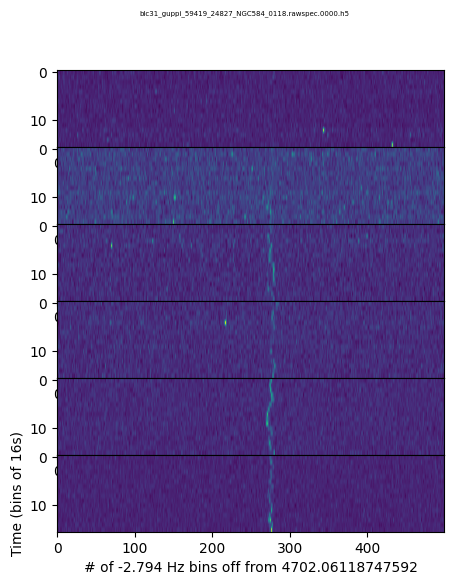

broadband False


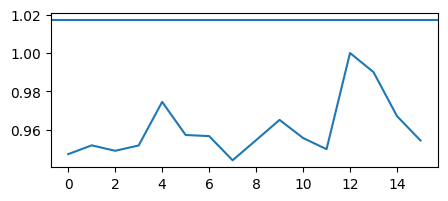

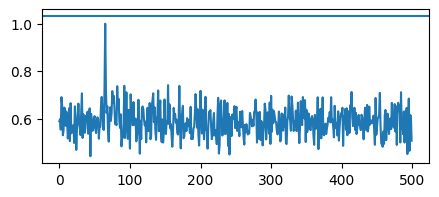

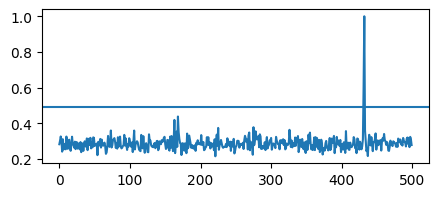

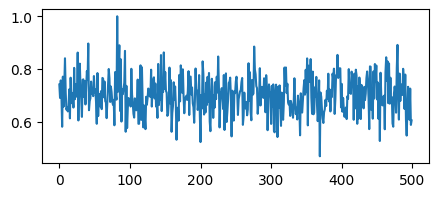

#: 7


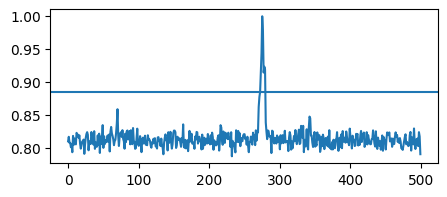

Checking Drift


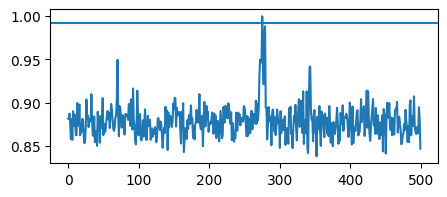

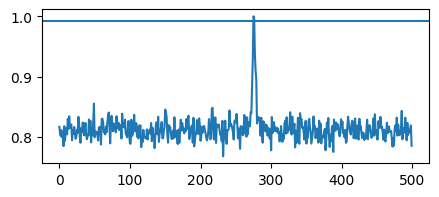

[275] [275, 276]
ZDRIFT False
[278.5] [431.5]
16 16
[[0.42247078 0.3933997  0.43121678 ... 0.4136071  0.33514625 0.34492916]
 [0.43164715 0.3970952  0.40278354 ... 0.36985534 0.41318157 0.41603824]
 [0.46111313 0.42260662 0.35599586 ... 0.45877388 0.3830587  0.4452909 ]
 ...
 [0.39633968 0.39152342 0.3926338  ... 0.31216547 0.3764704  0.3887805 ]
 [0.38752857 0.3783218  0.43193895 ... 0.49235657 0.3408081  0.28601876]
 [0.406639   0.35423523 0.47012487 ... 0.391126   0.41062337 0.35469732]]
50
[[ 8317250.  8728770.  8126960. ... 10641404.  8683500.  9584409.]
 [ 8441887. 10806983. 10238365. ... 10508785.  8605925. 10073868.]
 [ 9321745. 11359458. 10598083. ...  9124134.  9867566. 10667016.]
 ...
 [ 9127447. 10572913.  8840643. ... 10980486. 10873455.  7594058.]
 [11681130. 11972135. 10349463. ... 10521864. 10936061. 10758250.]
 [10297798.  9813616. 11247317. ... 11332997.  9194503.  8438520.]]
max corr 0.11724291628427272
False False True True


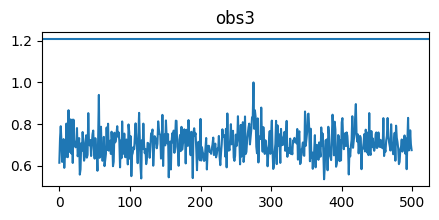

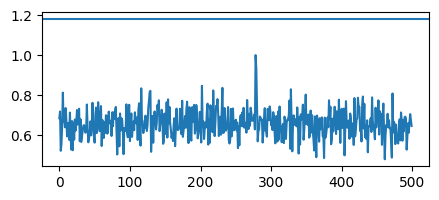

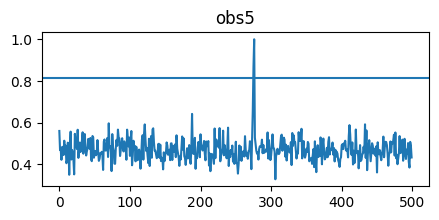

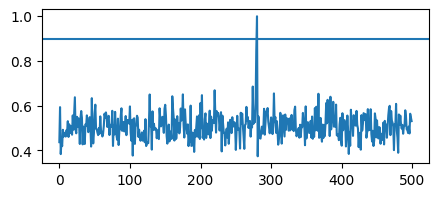

In [69]:
# examine ones that get through
for i in low_correlations:
    try:
        print(fch1+foff*(i*500))
        lower = i * 500
        upper = (i+1) * 500
        boundary_ON = plot_candidates(hf_ON,hf_OFF,hf_ON2,hf_OFF2,hf_ON3,hf_OFF3,lower,upper,file_ON,foff,fch1)
    except:
        print('boundary')

In [66]:
hotspots_ON_frequencies = [fch1+foff*(i*500) for i in hotspots_ON]
print(hotspots_ON_frequencies)

[1926.000158425247, 1925.5663264022237, 1925.5649086505146, 1925.2374080056832, 1925.2345725022649, 1925.2317369988464, 1925.230319247137, 1925.2289014954279, 1925.2274837437187, 1925.166520420222, 1925.1651026685126, 1925.1622671650941, 1925.160849413385, 1925.1565961582573, 1925.0559357869022, 1925.054518035193, 1925.0502647800654, 1925.048847028356, 1925.0474292766469, 1925.0460115249377, 1925.0445937732284, 1925.04175826981, 1925.0247452492993, 1925.0233274975901, 1925.0219097458807, 1925.0204919941716, 1925.0148209873346, 1925.0134032356254, 1925.0119854839163, 1925.0077322287887, 1925.0020612219516, 1925.0006434702425, 1924.9992257185331, 1924.997807966824, 1924.9907192082778, 1924.9893014565687, 1924.9878837048593, 1924.9864659531502, 1924.9836304497317, 1924.9822126980225, 1924.9807949463132, 1924.9765416911855, 1924.9751239394764, 1924.9737061877672, 1924.9722884360579, 1924.9708706843487, 1924.9694529326393, 1924.9680351809302, 1924.966617429221, 1924.9651996775117, 1924.9439

In [9]:
candidates[20:40]

,Primary File,Frequency,All Files,Score
20,/datax/scratch/calebp/seticore_testing/snr_tes...,1160.598367,('/datax/scratch/calebp/seticore_testing/snr_t...,109784
21,/datax/scratch/calebp/seticore_testing/snr_tes...,1150.100032,('/datax/scratch/calebp/seticore_testing/snr_t...,117299
22,/datax/scratch/calebp/seticore_testing/snr_tes...,1500.002202,('/datax/scratch/calebp/seticore_testing/snr_t...,1047
23,/datax/scratch/calebp/seticore_testing/snr_tes...,1424.979977,('/datax/scratch/calebp/seticore_testing/snr_t...,54750
24,/datax/scratch/calebp/seticore_testing/snr_tes...,1366.527379,('/datax/scratch/calebp/seticore_testing/snr_t...,96592
25,/datax/scratch/calebp/seticore_testing/snr_tes...,1483.576465,('/datax/scratch/calebp/seticore_testing/snr_t...,12805
26,/datax/scratch/calebp/seticore_testing/snr_tes...,1483.440958,('/datax/scratch/calebp/seticore_testing/snr_t...,12902
27,/datax/scratch/calebp/seticore_testing/snr_tes...,1483.396254,('/datax/scratch/calebp/seticore_testing/snr_t...,12934
28,/datax/scratch/calebp/seticore_testing/snr_tes...,1458.045188,('/datax/scratch/calebp/seticore_testing/snr_t...,31081
29,/datax/scratch/calebp/seticore_testing/snr_tes...,1124.971468,('/datax/scratch/calebp/seticore_testing/snr_t...,1069


In [12]:
(1876.4648437500-1598.484902)/(500*-0.000002793967723846435546875000)

-198985.7931267059

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC584/blc31_guppi_59419_24827_NGC584_0118.rawspec.0000.h5
freq 4702.06118747592
hf <HDF5 file "blc31_guppi_59419_25142_HIP7276_0119.rawspec.0000.h5" (mode r)>
tstart 59419.287350 fch1 4876.4648437500 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 4782.7148437500 src_raj 1.5224244444 src_raj_degs 22.8363666667 src_dej -5.8097319444 target NGC584
62421500 62422000


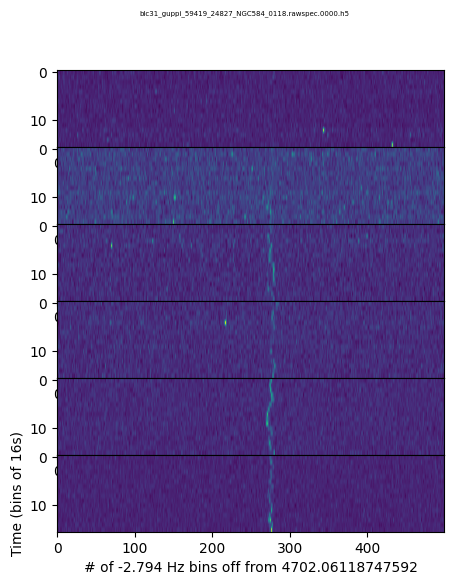

broadband False


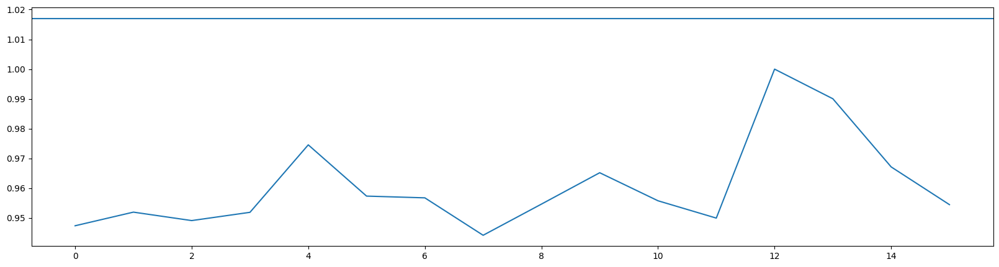

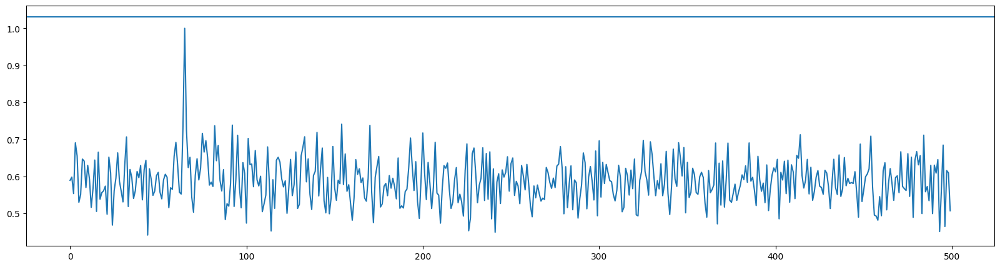

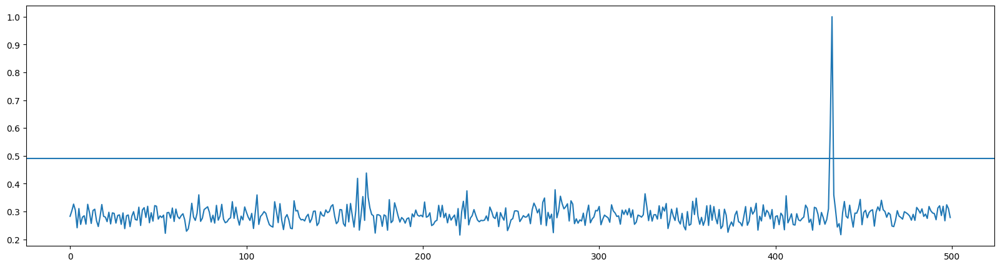

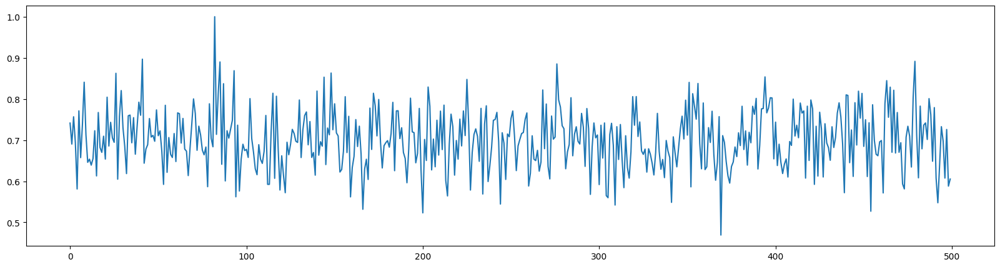

#: 7


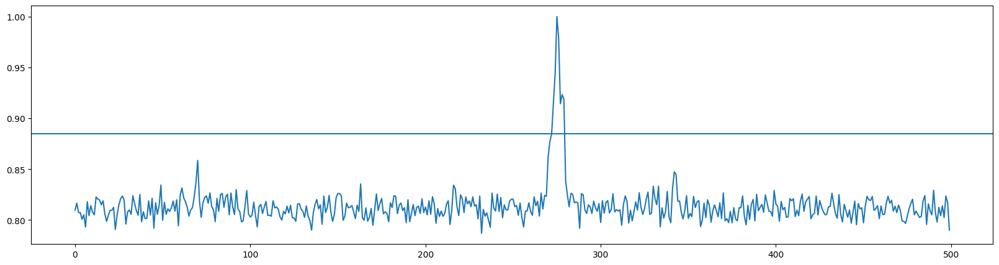

Checking Drift
[278.5] [431.5]
16 16
[[0.42247078 0.3933997  0.43121678 ... 0.4136071  0.33514625 0.34492916]
 [0.43164715 0.3970952  0.40278354 ... 0.36985534 0.41318157 0.41603824]
 [0.46111313 0.42260662 0.35599586 ... 0.45877388 0.3830587  0.4452909 ]
 ...
 [0.39633968 0.39152342 0.3926338  ... 0.31216547 0.3764704  0.3887805 ]
 [0.38752857 0.3783218  0.43193895 ... 0.49235657 0.3408081  0.28601876]
 [0.406639   0.35423523 0.47012487 ... 0.391126   0.41062337 0.35469732]]
50
[[ 8317250.  8728770.  8126960. ... 10641404.  8683500.  9584409.]
 [ 8441887. 10806983. 10238365. ... 10508785.  8605925. 10073868.]
 [ 9321745. 11359458. 10598083. ...  9124134.  9867566. 10667016.]
 ...
 [ 9127447. 10572913.  8840643. ... 10980486. 10873455.  7594058.]
 [11681130. 11972135. 10349463. ... 10521864. 10936061. 10758250.]
 [10297798.  9813616. 11247317. ... 11332997.  9194503.  8438520.]]
max corr 0.11724291628427272
False False True True


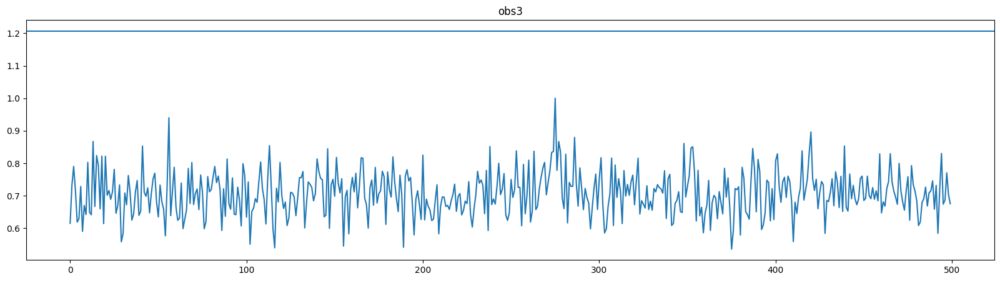

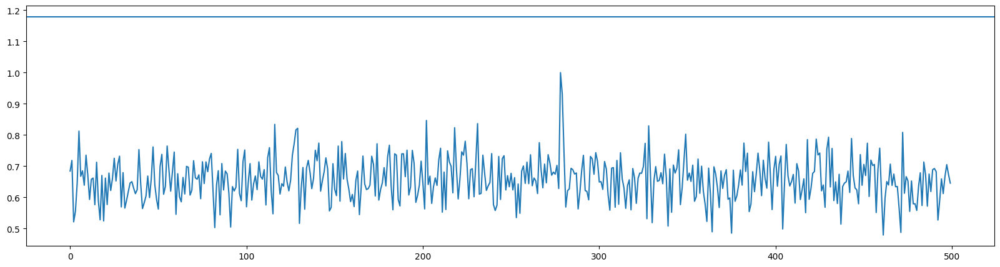

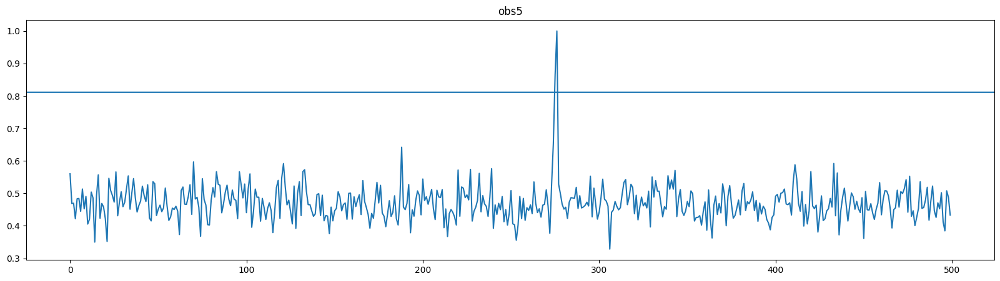

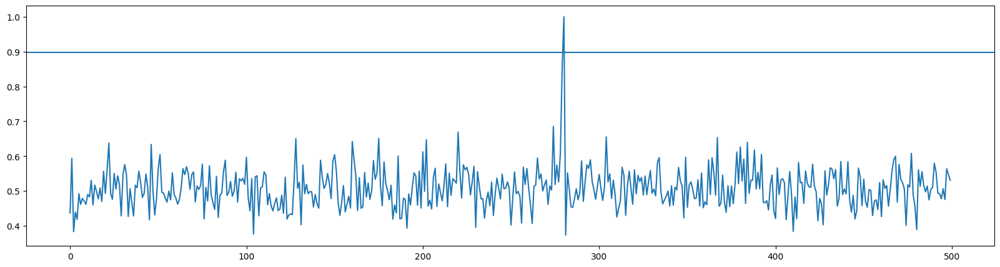

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7635.465948376805
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
19148000 19148500


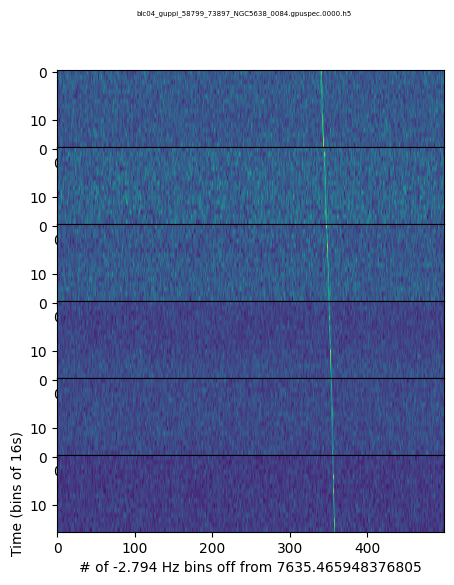

broadband False


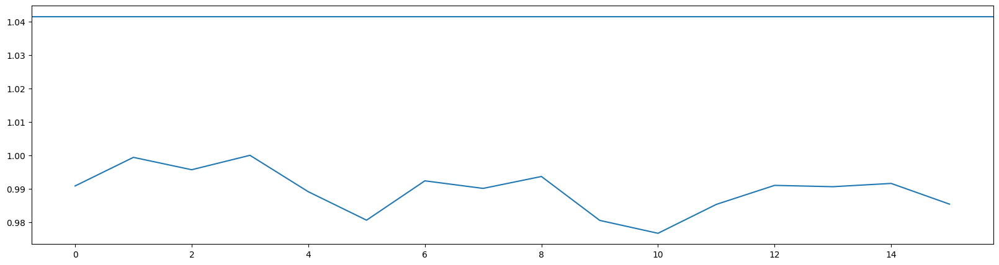

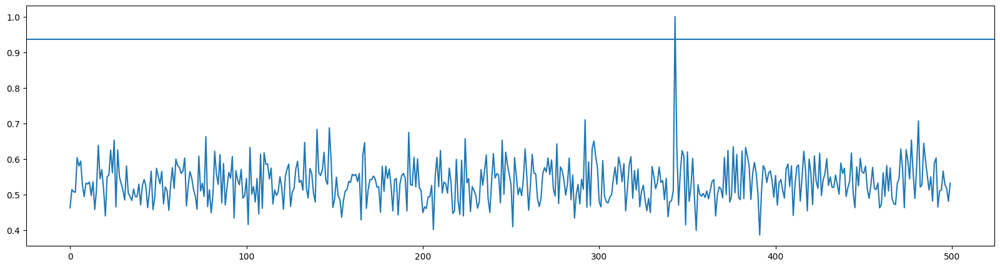

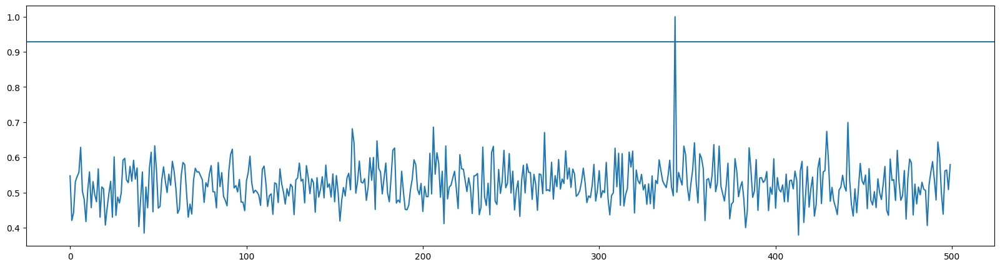

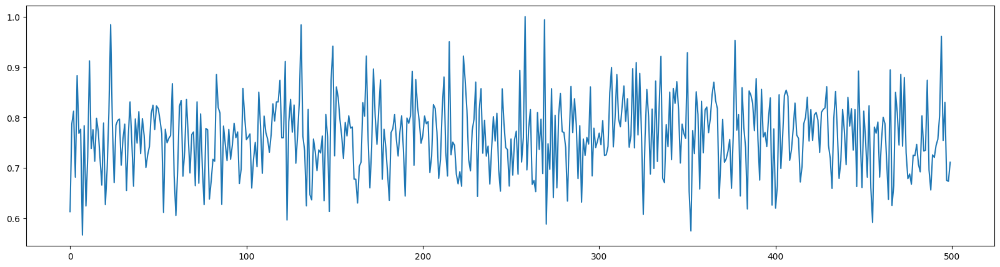

#: 0


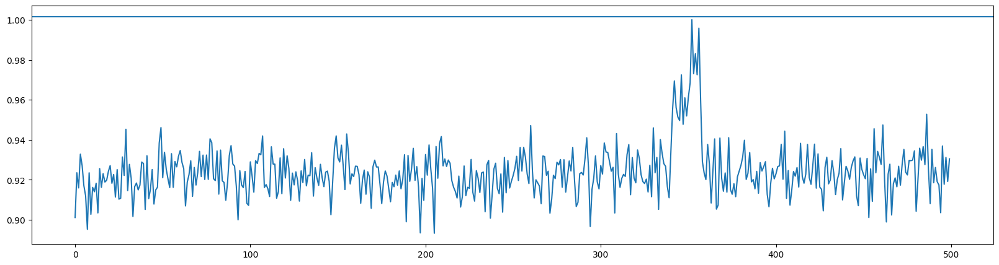

Checking Drift
16 16
[[0.45787993 0.58799255 0.60669065 ... 0.5042216  0.50288546 0.53116983]
 [0.48304486 0.5845109  0.55202687 ... 0.53183556 0.4644147  0.5603399 ]
 [0.50349075 0.5551322  0.6498267  ... 0.6956511  0.58260345 0.5715697 ]
 ...
 [0.506592   0.58469135 0.5471183  ... 0.46526885 0.54783934 0.5188383 ]
 [0.5019243  0.5707177  0.65098995 ... 0.5104019  0.54455817 0.5813307 ]
 [0.6393077  0.57374907 0.53877056 ... 0.6299793  0.4657334  0.5597892 ]]
50
[[7.9735620e+10 7.5191230e+10 7.7940335e+10 ... 7.4069615e+10
  8.3397067e+10 7.7198230e+10]
 [6.8946870e+10 7.3717662e+10 7.8754431e+10 ... 7.6482437e+10
  7.3306964e+10 8.9328591e+10]
 [7.7886972e+10 7.7270901e+10 8.4935533e+10 ... 6.8487037e+10
  8.0359891e+10 7.1136715e+10]
 ...
 [8.5182816e+10 8.0848249e+10 7.3059893e+10 ... 8.2144838e+10
  6.6453770e+10 6.6145018e+10]
 [6.6916610e+10 6.5191404e+10 8.3596157e+10 ... 7.8299365e+10
  8.7135166e+10 7.5073102e+10]
 [8.9813942e+10 7.9755026e+10 8.3292332e+10 ... 6.6376933e+10


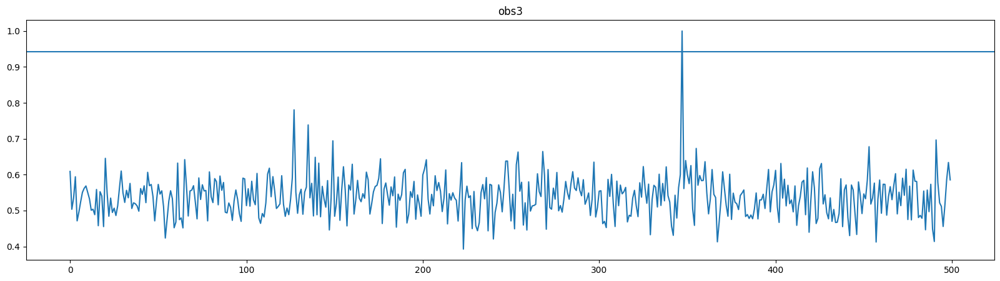

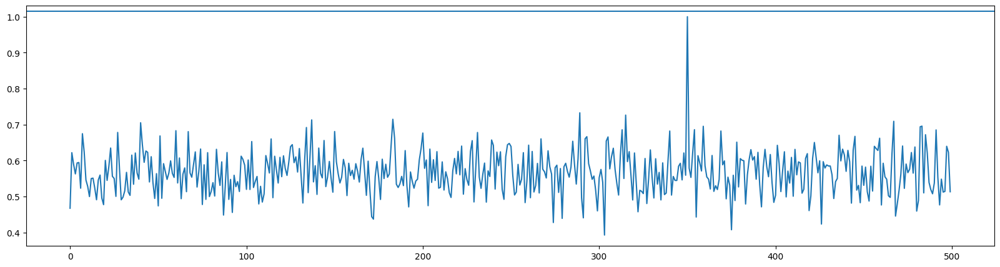

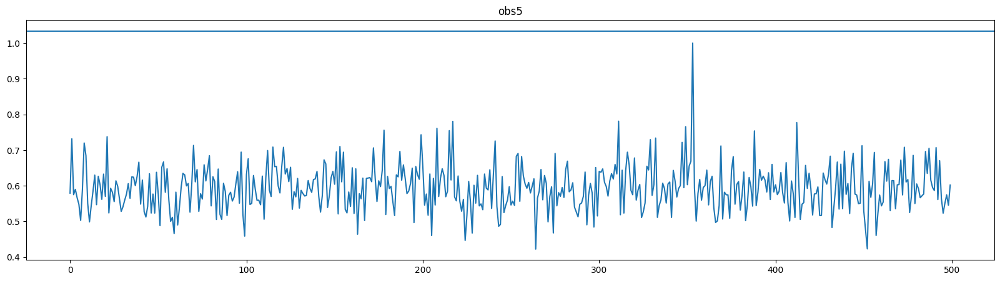

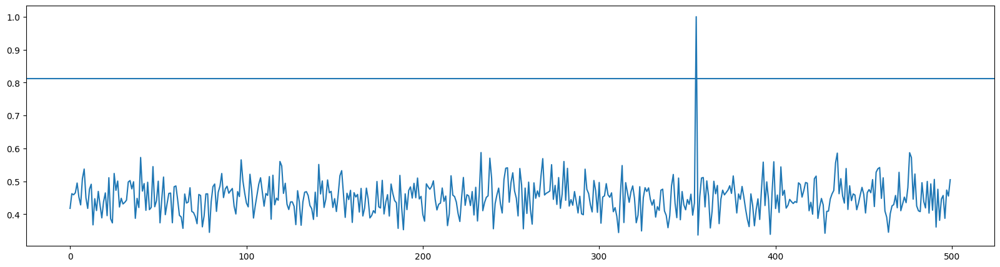

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7635.115305427462
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
19273500 19274000


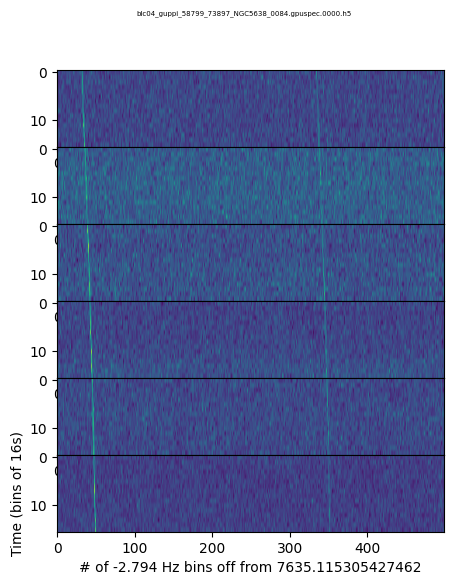

broadband False


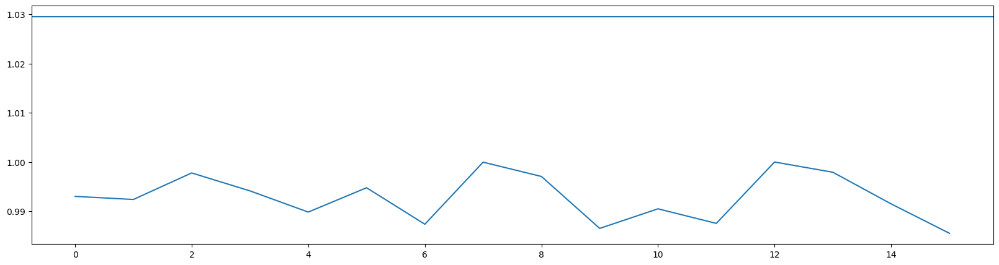

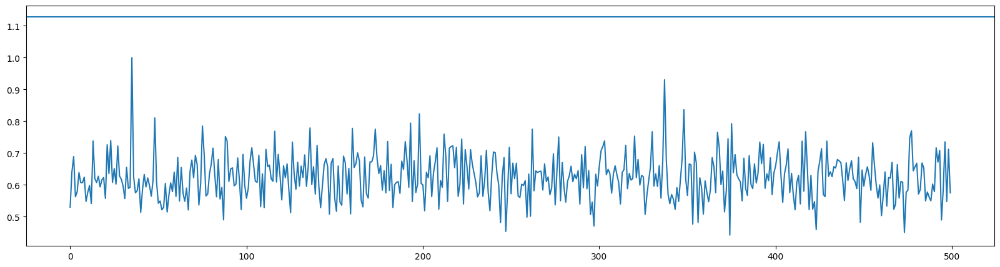

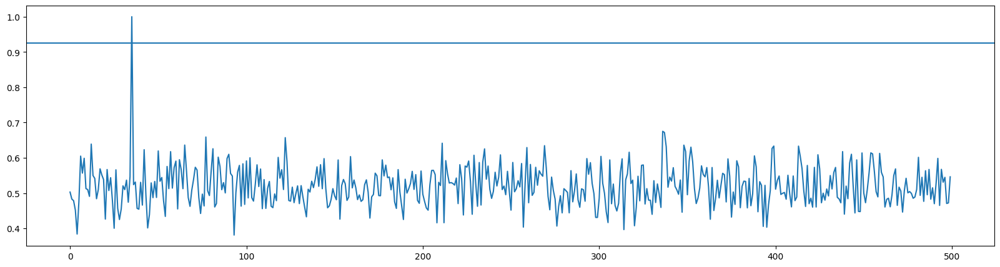

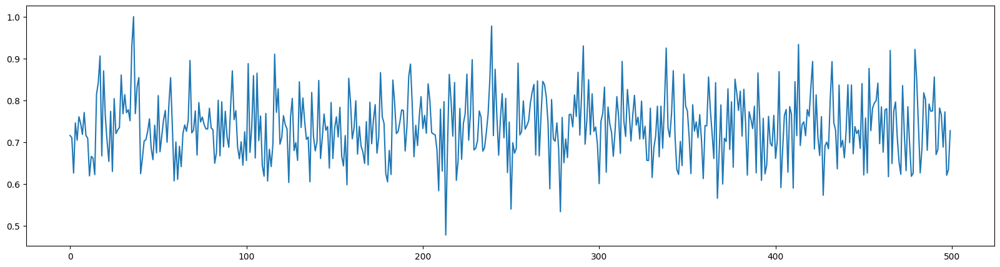

#: 1


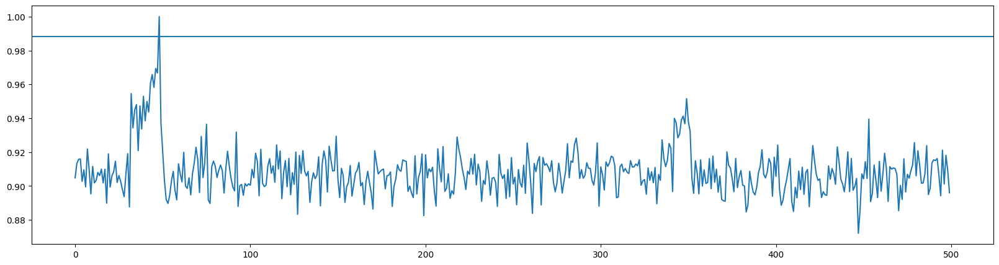

Checking Drift
16 16
[[0.51797944 0.51422536 0.45292267 ... 0.44920588 0.45893133 0.5263606 ]
 [0.51671207 0.4744365  0.63716507 ... 0.5516253  0.58913296 0.49345186]
 [0.5422361  0.50268143 0.6060385  ... 0.588735   0.63480383 0.55058914]
 ...
 [0.54614097 0.6335503  0.5431258  ... 0.5642563  0.5232503  0.5424209 ]
 [0.51210487 0.5282971  0.5968946  ... 0.5392009  0.6560427  0.57995015]
 [0.62188536 0.4725171  0.45599616 ... 0.51527846 0.49611026 0.48201355]]
50
[[7.1194444e+10 8.3266347e+10 7.4344874e+10 ... 7.7774045e+10
  7.7144711e+10 9.5782945e+10]
 [7.6374376e+10 6.9175460e+10 6.8515983e+10 ... 8.2666349e+10
  9.5305974e+10 8.0507322e+10]
 [8.5458346e+10 7.3979527e+10 7.6345590e+10 ... 8.5851677e+10
  6.7106521e+10 8.0075555e+10]
 ...
 [7.6682486e+10 6.7688780e+10 7.2265138e+10 ... 8.0268976e+10
  7.4850222e+10 8.0726745e+10]
 [7.7346742e+10 8.0442212e+10 7.7067567e+10 ... 8.4310450e+10
  6.9076140e+10 8.2496455e+10]
 [9.4113759e+10 7.0770983e+10 6.1632279e+10 ... 6.8327768e+10


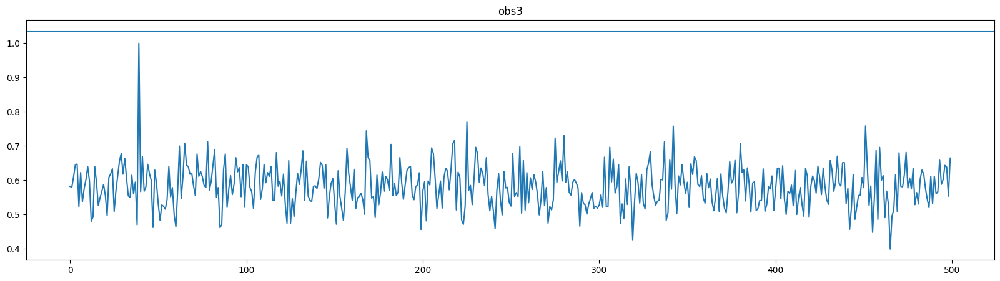

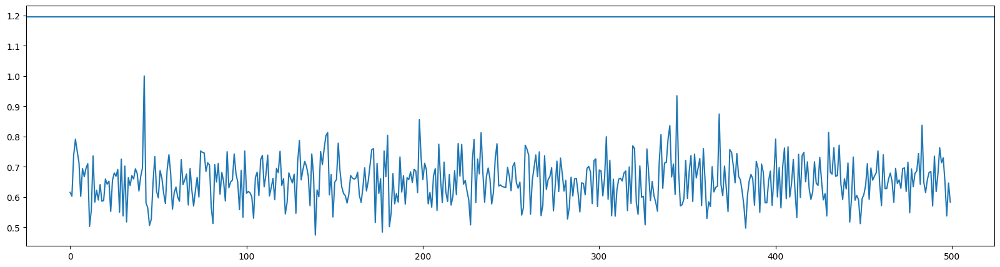

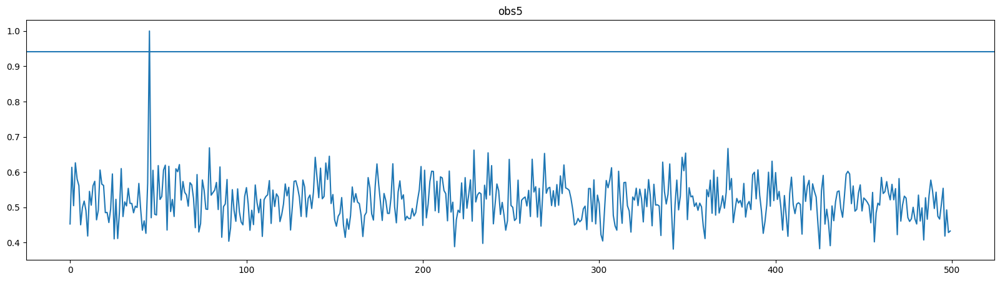

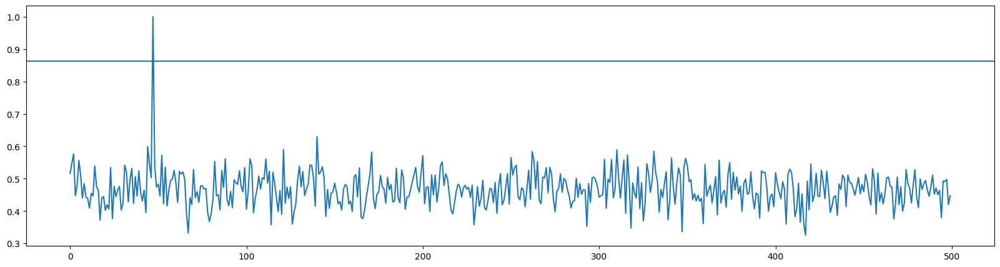

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7634.844290558249
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
19370500 19371000


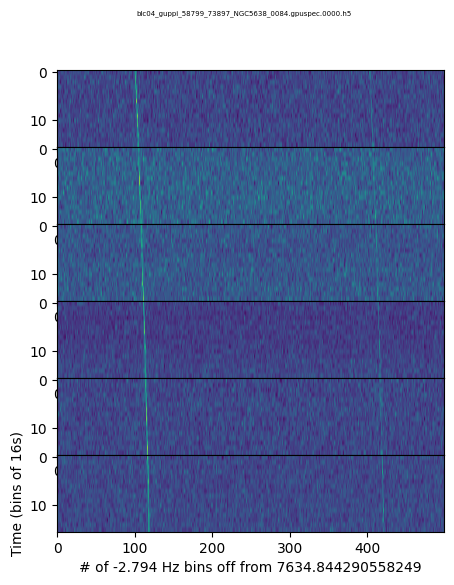

broadband False


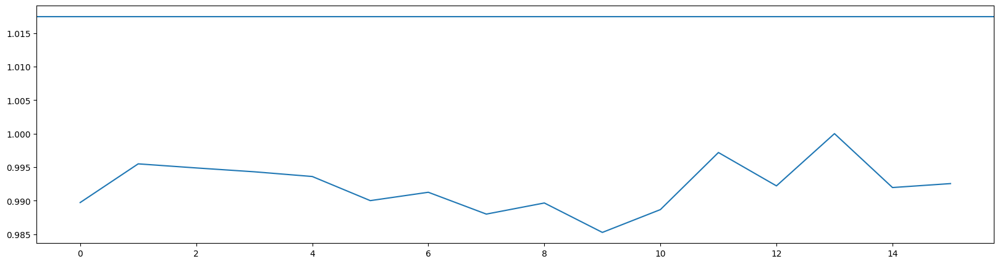

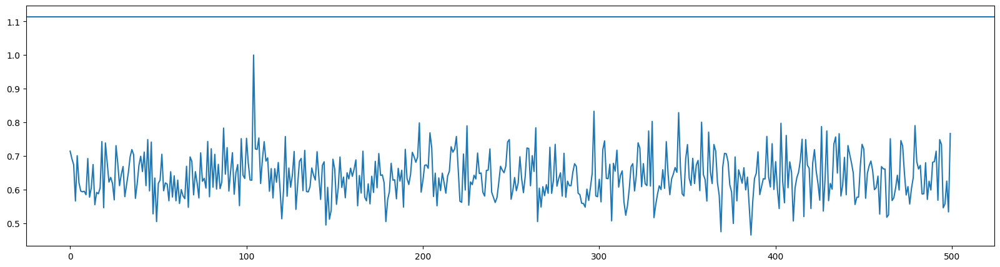

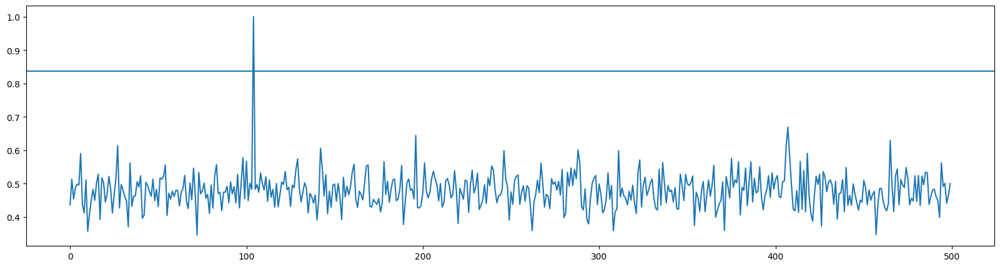

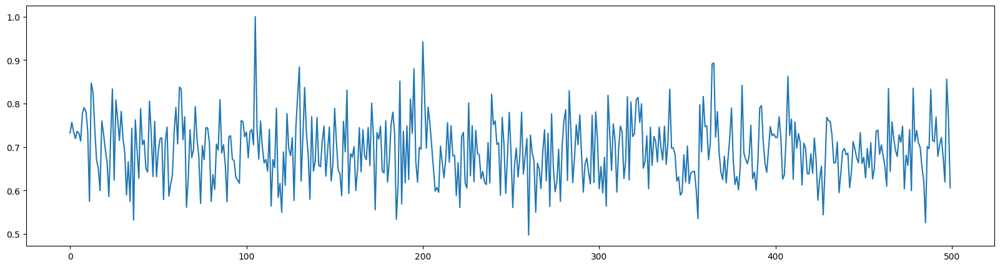

#: 1


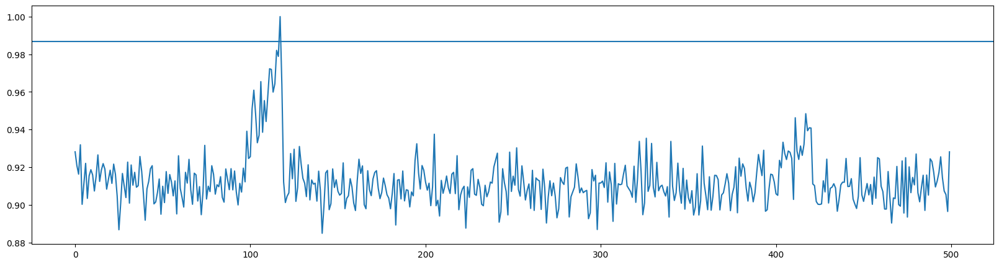

Checking Drift
[117] [104]
16 16
[[0.5841702  0.6038228  0.5866749  ... 0.6830045  0.61227584 0.4833729 ]
 [0.61001694 0.56256646 0.5497516  ... 0.5205977  0.52166164 0.5628939 ]
 [0.5144738  0.5165229  0.5375088  ... 0.46784315 0.5617327  0.49614218]
 ...
 [0.6050987  0.48909432 0.5654748  ... 0.57198983 0.5205167  0.49897286]
 [0.66039675 0.47233242 0.50530344 ... 0.50530887 0.5716522  0.52951586]
 [0.5662089  0.5520497  0.4994811  ... 0.48694158 0.5846087  0.6037951 ]]
50
[[9.0101006e+10 9.0038174e+10 8.5437350e+10 ... 9.7537892e+10
  7.3413640e+10 7.9583797e+10]
 [9.1500241e+10 7.4418774e+10 9.4018822e+10 ... 7.7959160e+10
  5.7954279e+10 7.2003469e+10]
 [7.2810725e+10 8.9450725e+10 7.6091548e+10 ... 7.8939849e+10
  8.4215284e+10 8.4723442e+10]
 ...
 [7.6253151e+10 8.4430365e+10 7.0278988e+10 ... 7.9142404e+10
  9.0958348e+10 7.2689926e+10]
 [8.7981179e+10 8.1020830e+10 7.9909011e+10 ... 6.7905405e+10
  7.4347405e+10 6.5467060e+10]
 [6.9056799e+10 7.6916638e+10 7.7805003e+10 ... 7.

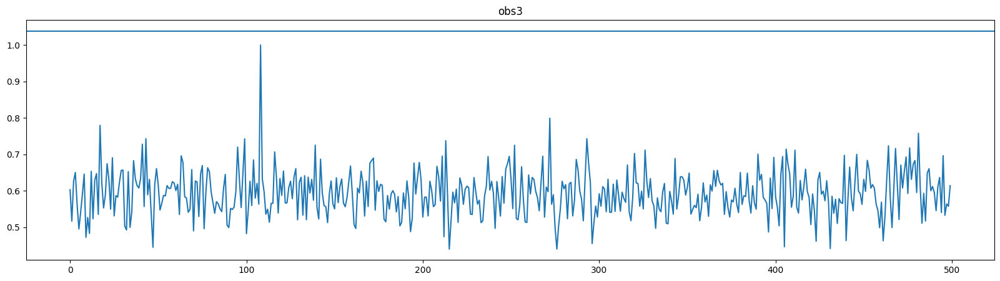

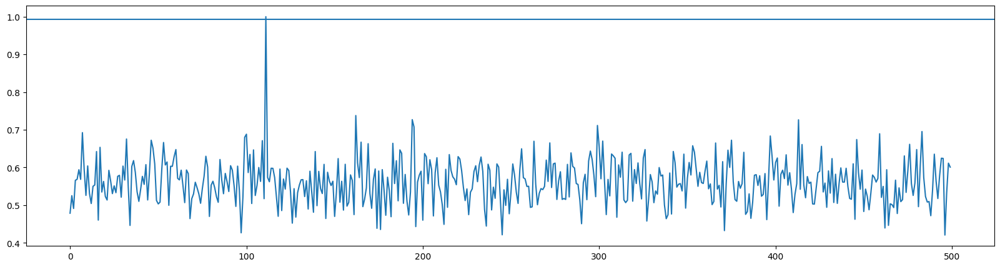

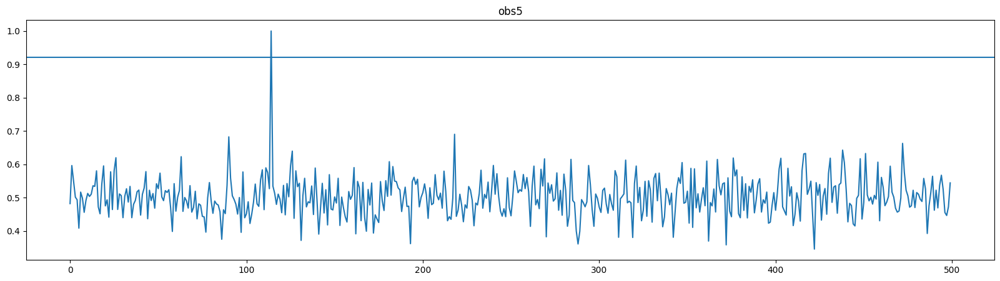

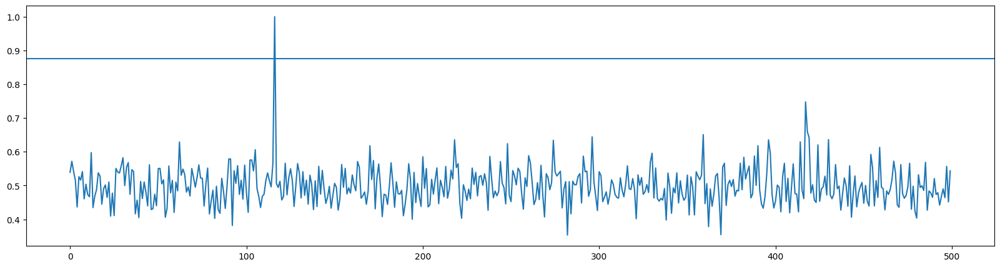

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7634.718562010676
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
19415500 19416000


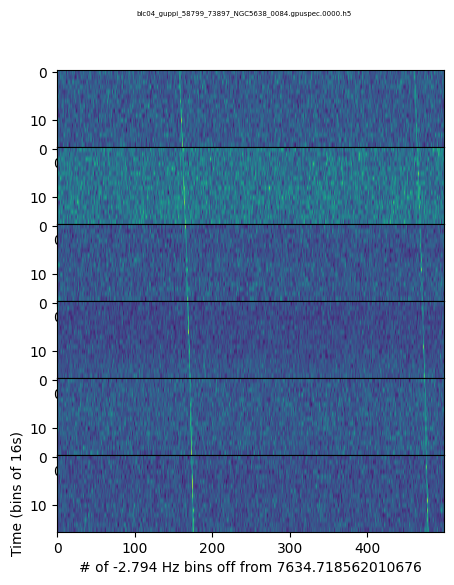

broadband False


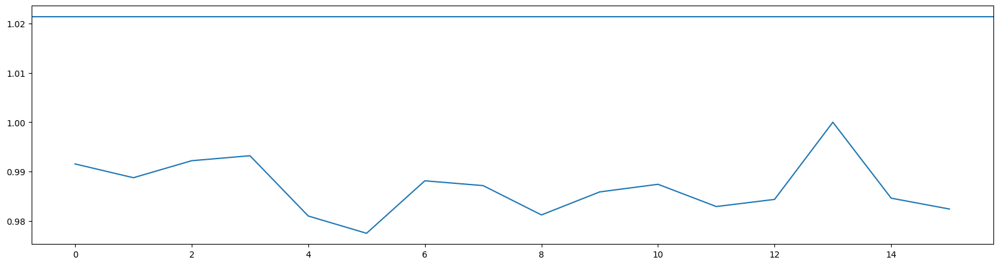

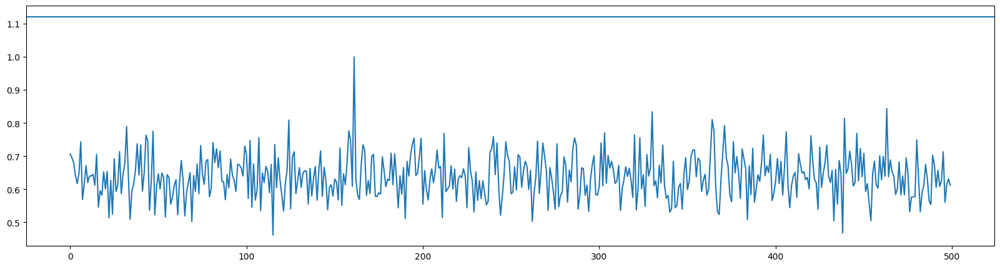

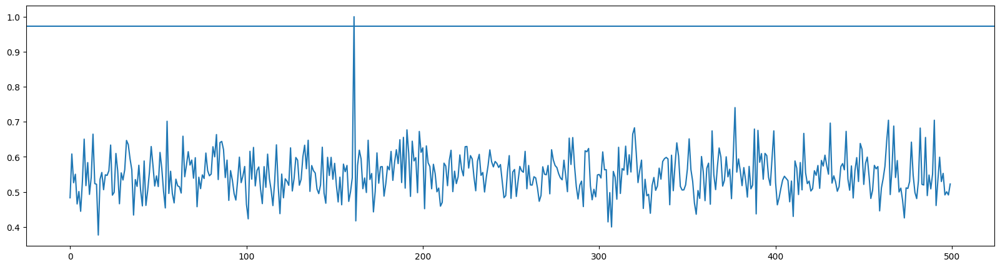

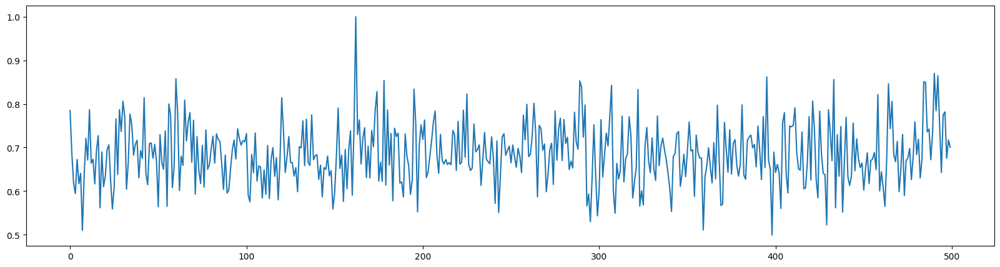

#: 0


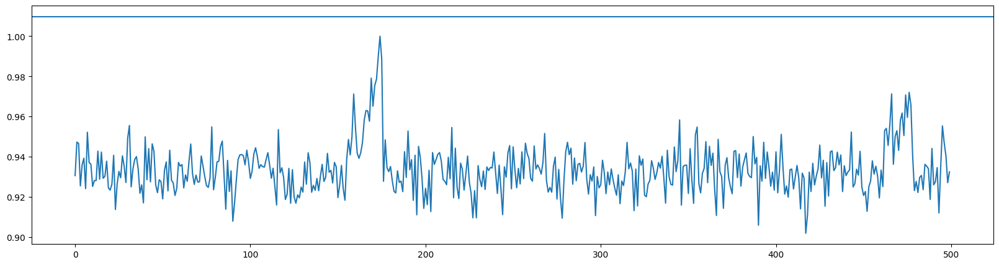

Checking Drift
16 16
[[0.73678267 0.64460534 0.5807665  ... 0.6338835  0.6732977  0.65769666]
 [0.6498944  0.5490675  0.62067246 ... 0.55551267 0.6368718  0.5670901 ]
 [0.6835198  0.6644656  0.7384483  ... 0.79226553 0.6145745  0.5952941 ]
 ...
 [0.65717185 0.5811434  0.7420037  ... 0.58909583 0.6128585  0.6438788 ]
 [0.7574322  0.565693   0.7283187  ... 0.6884312  0.65107185 0.63330823]
 [0.67346454 0.6205764  0.6714989  ... 0.64845747 0.65175015 0.5185353 ]]
50
[[8.3738812e+10 1.0091839e+11 7.6162187e+10 ... 7.4984464e+10
  8.4088734e+10 7.4124132e+10]
 [8.2558796e+10 8.1161765e+10 9.2903719e+10 ... 8.5698281e+10
  8.5348622e+10 8.4646142e+10]
 [8.6233825e+10 7.0018171e+10 8.1497866e+10 ... 9.0512826e+10
  7.7823615e+10 7.3849635e+10]
 ...
 [7.5927216e+10 8.0488579e+10 7.2260747e+10 ... 7.9122178e+10
  9.7652777e+10 9.0311483e+10]
 [6.9250482e+10 7.0999998e+10 6.9717090e+10 ... 7.7689364e+10
  7.0834414e+10 8.7982285e+10]
 [7.5798626e+10 8.6486450e+10 7.9845933e+10 ... 7.9399379e+10


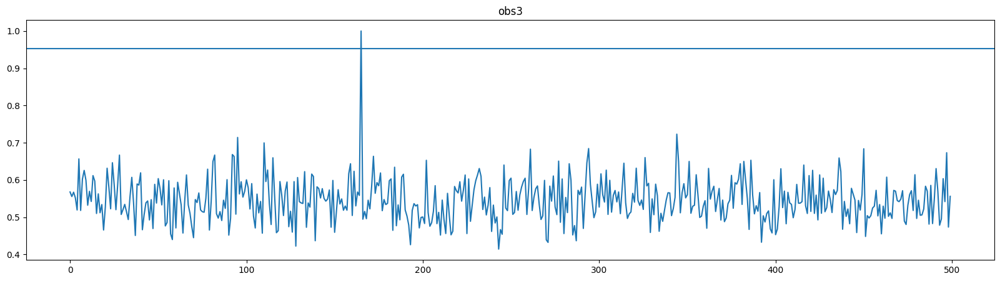

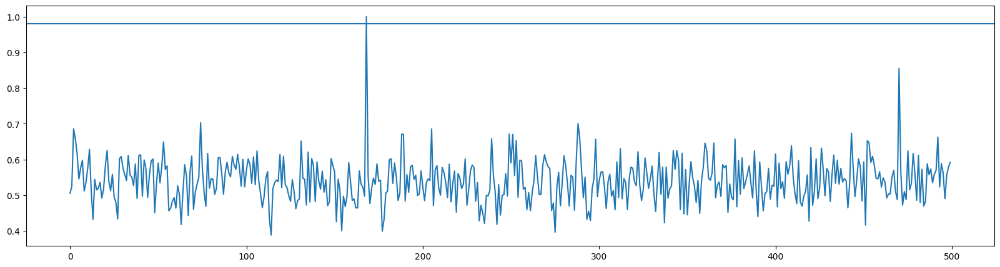

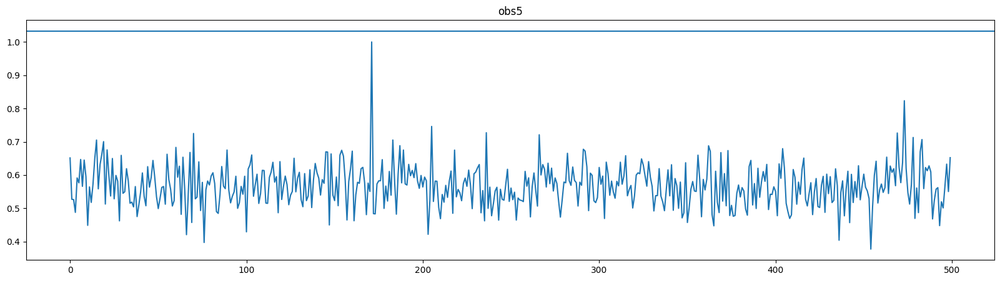

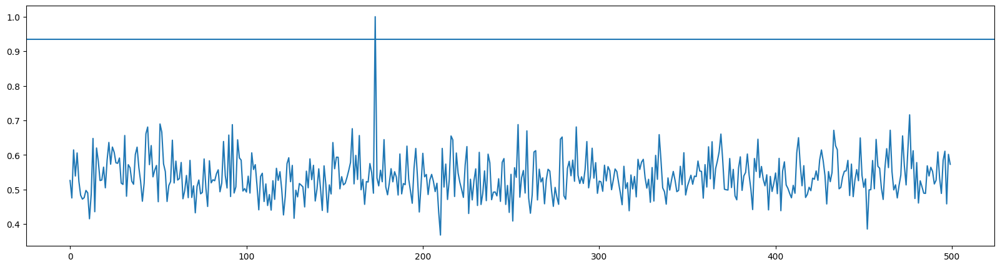

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7634.518793318421
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
19487000 19487500


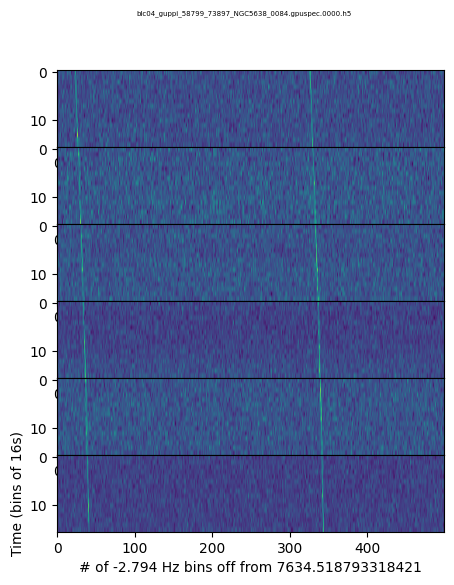

broadband False


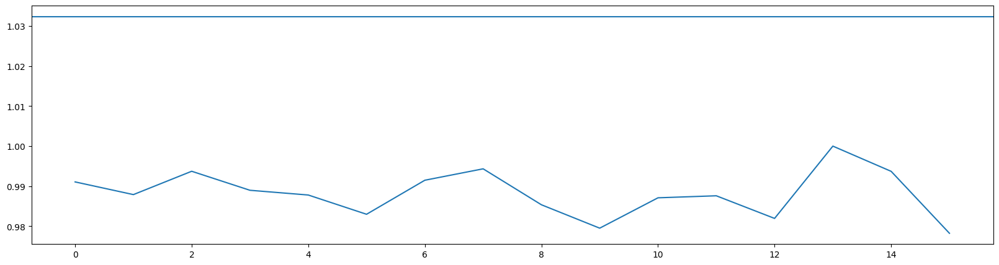

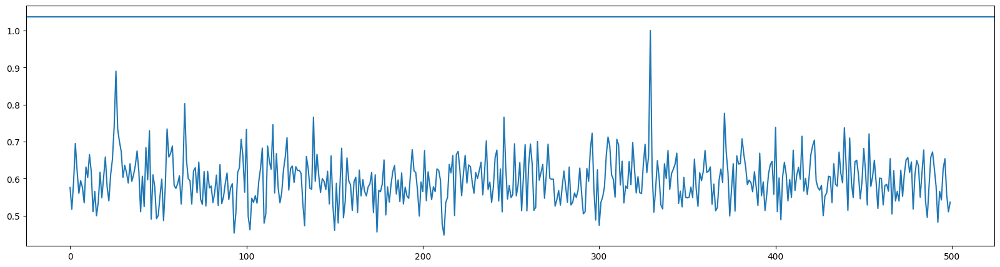

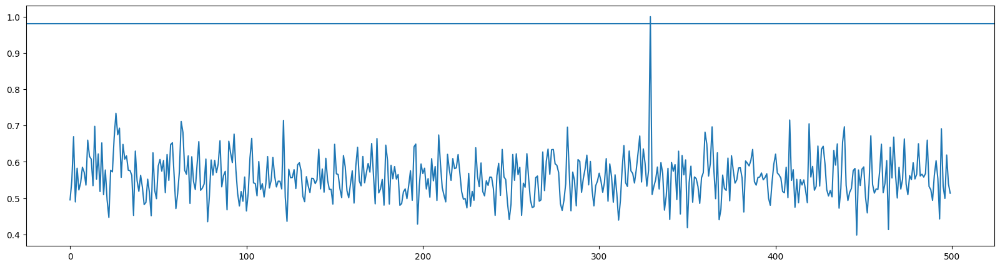

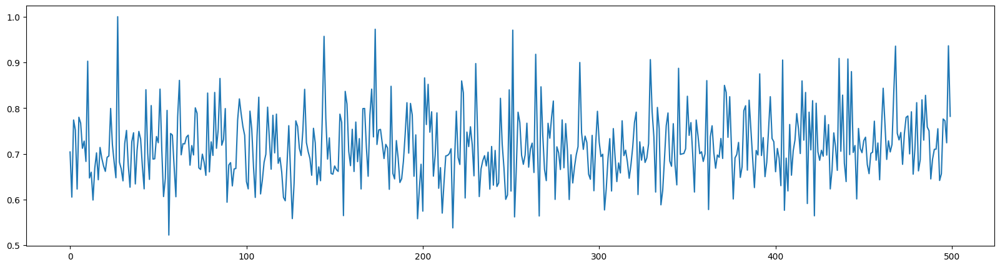

#: 0


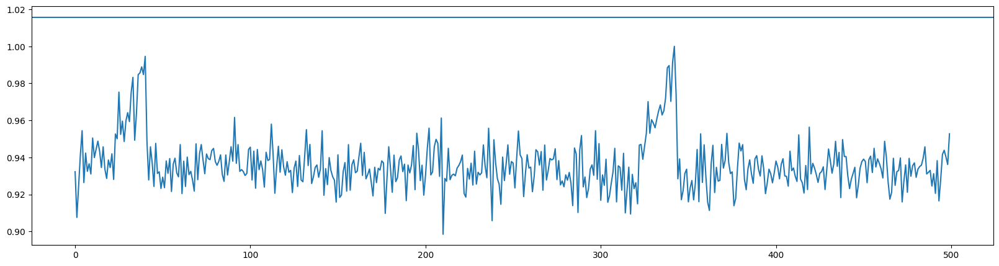

Checking Drift
16 16
[[0.5355089  0.4604051  0.5887343  ... 0.5507915  0.7122233  0.59482515]
 [0.4747017  0.4905058  0.5787028  ... 0.5513822  0.5292156  0.45096824]
 [0.40820444 0.5427144  0.4313026  ... 0.587618   0.5645882  0.4668872 ]
 ...
 [0.4940159  0.45922163 0.57004493 ... 0.6273979  0.6381348  0.5363012 ]
 [0.54625195 0.4583611  0.61172974 ... 0.6285675  0.6056457  0.71159554]
 [0.49919397 0.5015914  0.49411085 ... 0.60429174 0.5342373  0.47888076]]
50
[[6.3551500e+10 7.4368729e+10 6.6650538e+10 ... 8.5024588e+10
  7.6238987e+10 7.6413551e+10]
 [8.8205517e+10 8.5375091e+10 6.3354847e+10 ... 8.3178217e+10
  7.6571779e+10 7.2625709e+10]
 [7.0792929e+10 7.9734391e+10 6.9193122e+10 ... 8.3165536e+10
  8.2440192e+10 8.5760893e+10]
 ...
 [7.9407194e+10 8.5495054e+10 7.8521115e+10 ... 7.6587647e+10
  7.8901453e+10 8.3661136e+10]
 [7.9928369e+10 8.2215059e+10 8.1032847e+10 ... 7.4394739e+10
  8.5308252e+10 8.2304918e+10]
 [8.9883255e+10 7.9083626e+10 8.7031112e+10 ... 7.3271058e+10


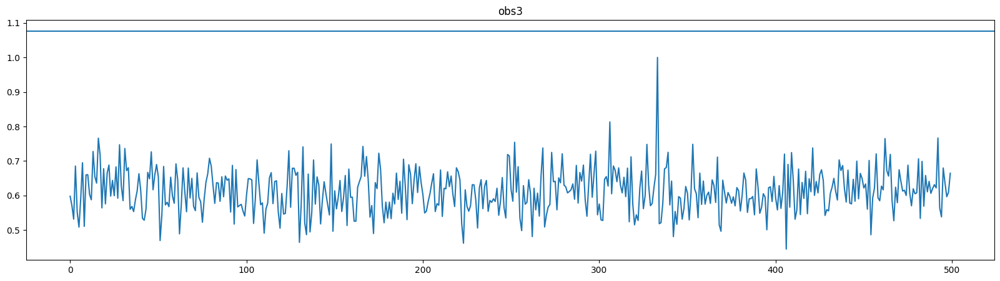

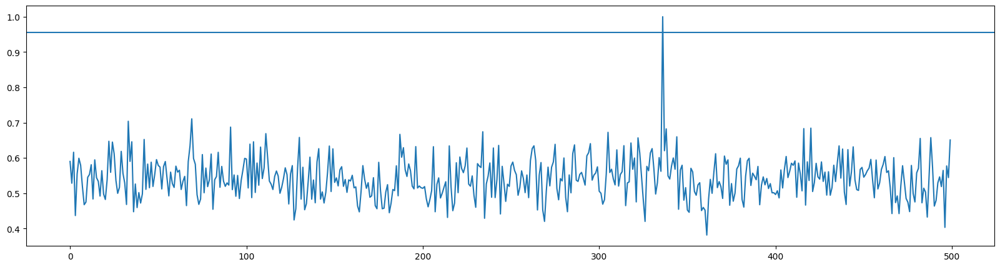

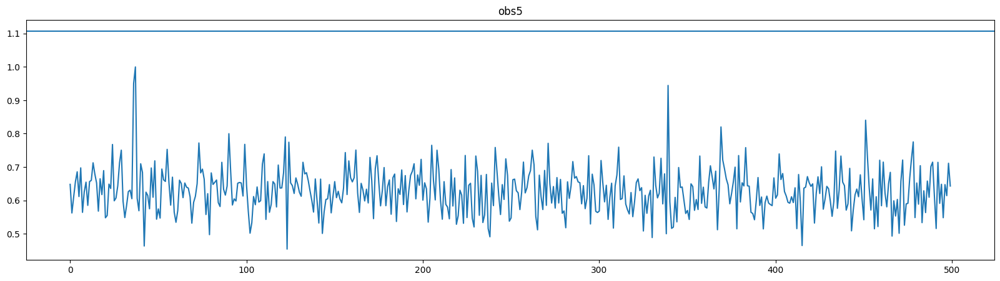

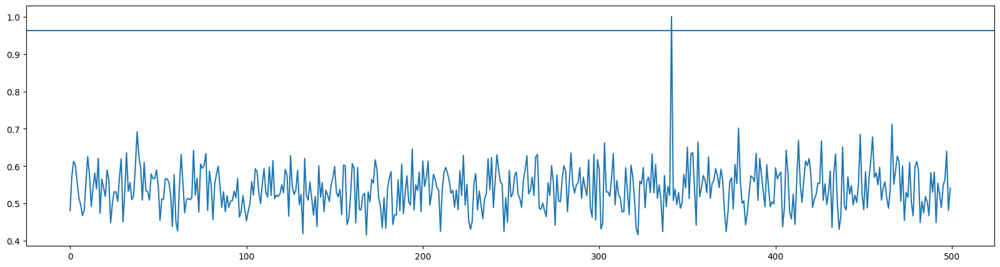

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7634.305054787546
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
19563500 19564000


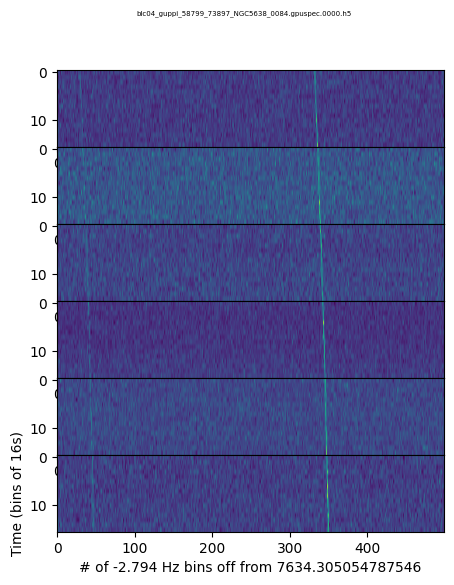

broadband False


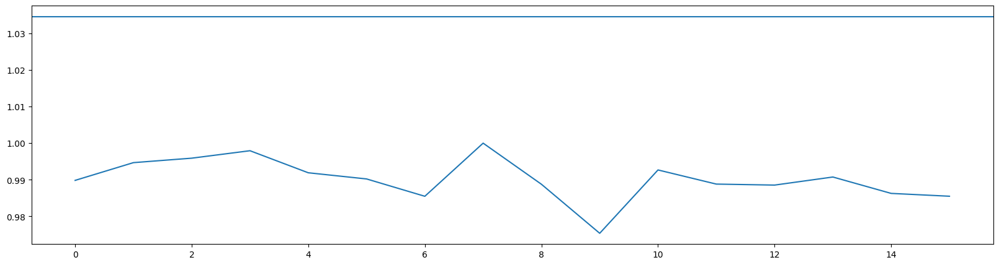

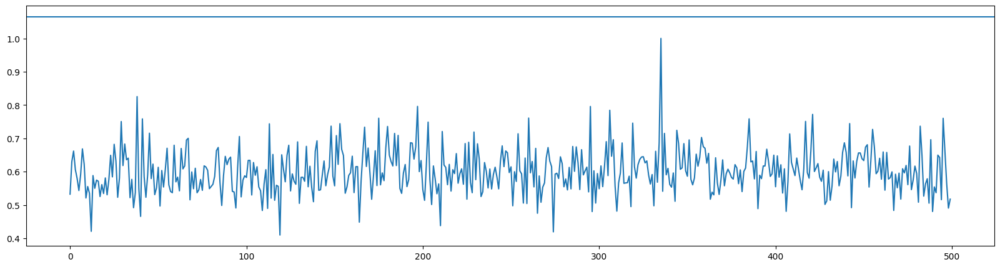

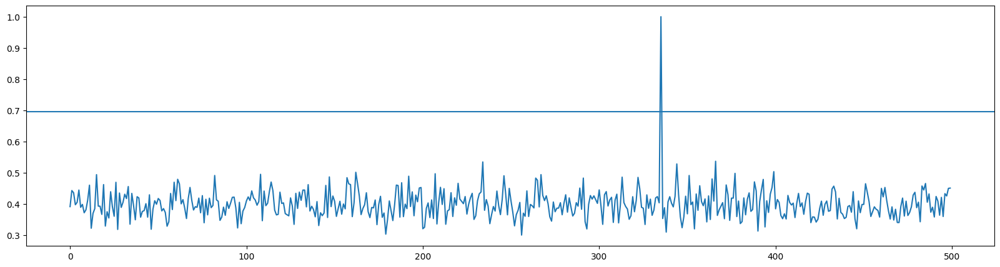

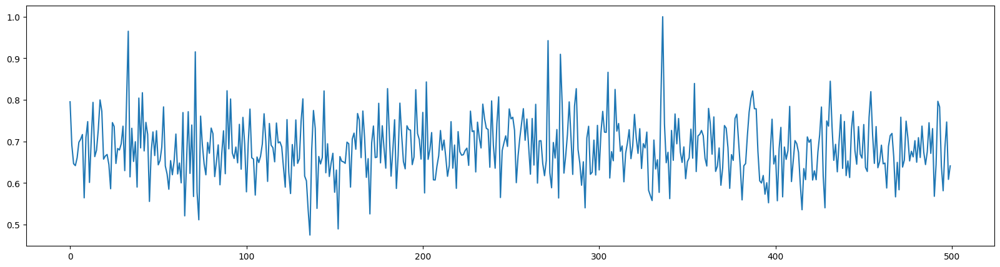

#: 1


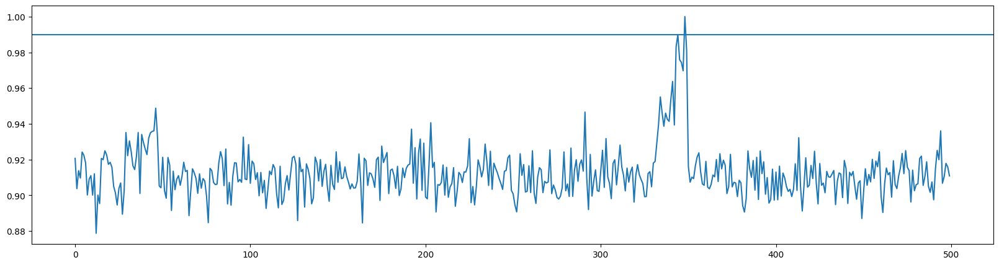

Checking Drift
[348] [335]
16 16
[[0.5757793  0.5003981  0.46801606 ... 0.54060453 0.4407358  0.46424156]
 [0.5731281  0.47097245 0.54694504 ... 0.45068428 0.5151653  0.46232393]
 [0.54377437 0.3922433  0.52712697 ... 0.4958488  0.47226796 0.54815996]
 ...
 [0.4227033  0.5568718  0.58346343 ... 0.5064186  0.5286758  0.45331672]
 [0.47283792 0.46906158 0.5705521  ... 0.5048243  0.47580153 0.47060066]
 [0.6164099  0.58841336 0.46531606 ... 0.55931437 0.44973537 0.50122726]]
50
[[7.3039315e+10 8.6294979e+10 8.3918143e+10 ... 8.2061459e+10
  7.4539622e+10 7.7256966e+10]
 [8.4914569e+10 6.3633072e+10 8.6219661e+10 ... 7.9456395e+10
  6.7861217e+10 7.9233057e+10]
 [7.0657827e+10 8.7206527e+10 7.4527621e+10 ... 8.0734806e+10
  7.7685981e+10 8.0726098e+10]
 ...
 [7.9740002e+10 7.6003541e+10 1.0281941e+11 ... 8.0893420e+10
  8.3224510e+10 6.9963153e+10]
 [7.7936624e+10 7.2344994e+10 8.8234017e+10 ... 6.7242492e+10
  7.6872188e+10 9.5234474e+10]
 [8.2684076e+10 8.4261937e+10 9.0990895e+10 ... 7.

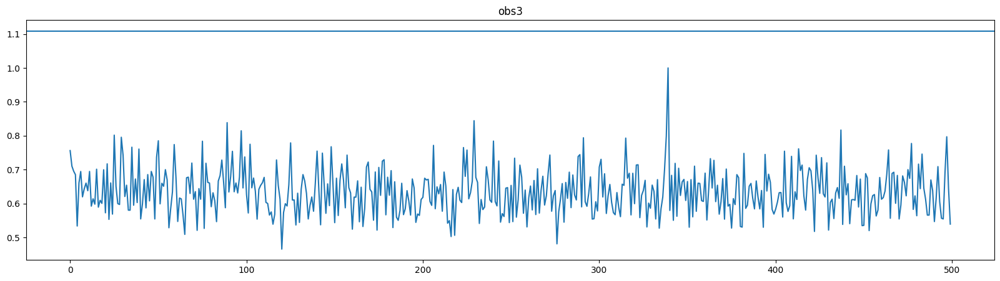

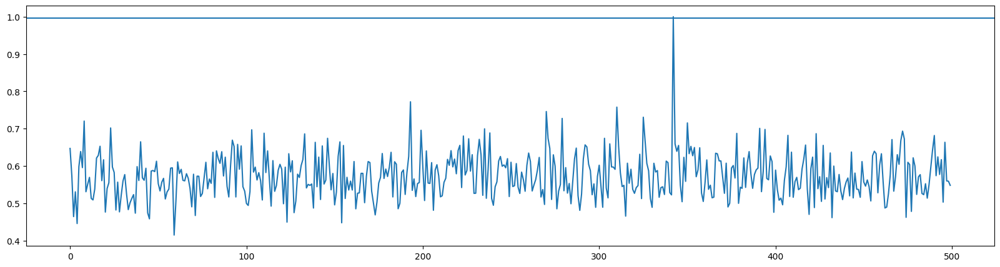

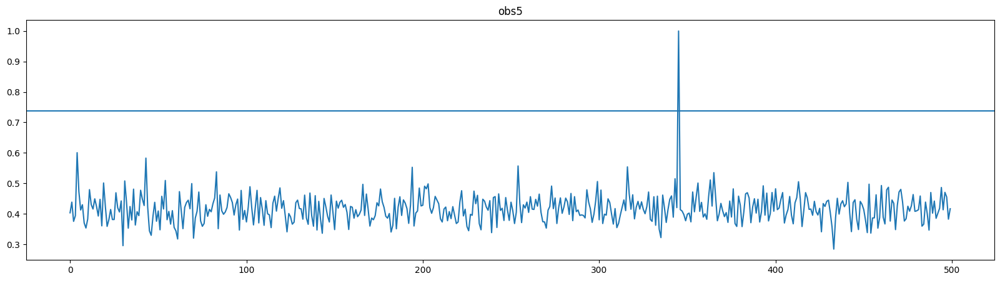

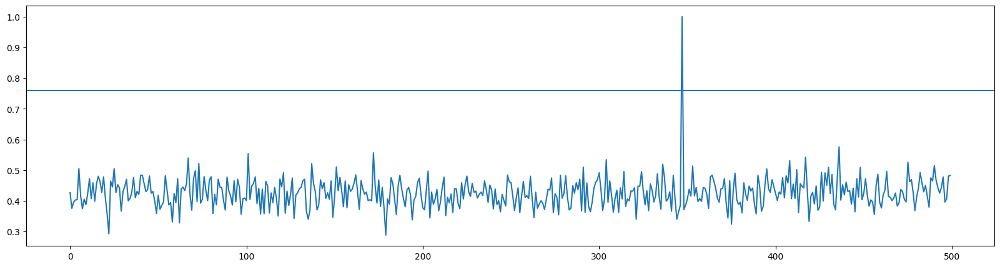

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7634.1751352883875
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
19610000 19610500


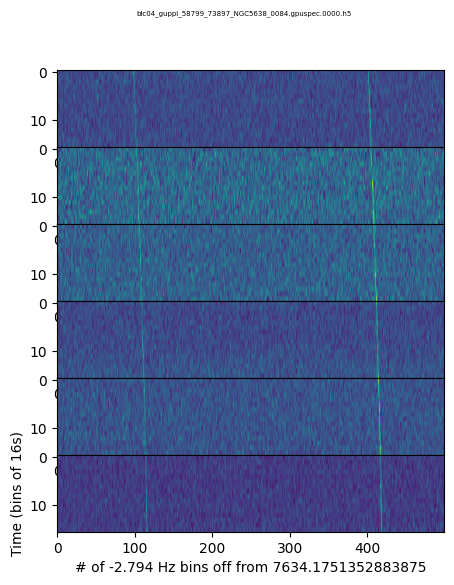

broadband False


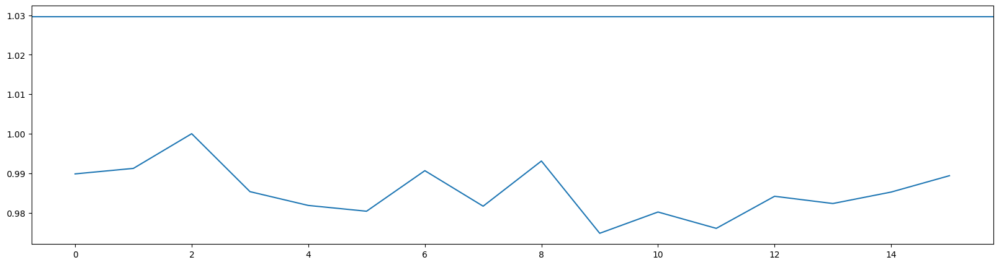

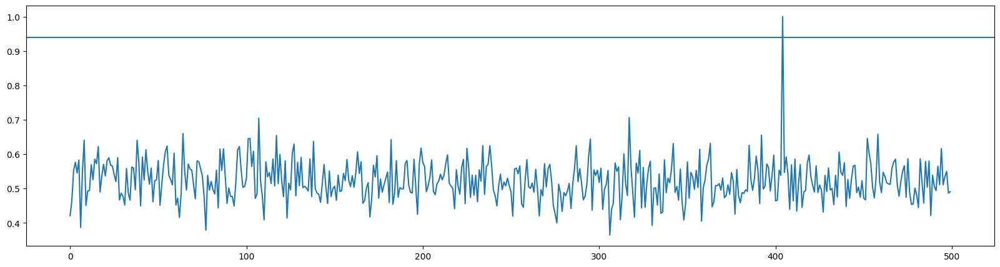

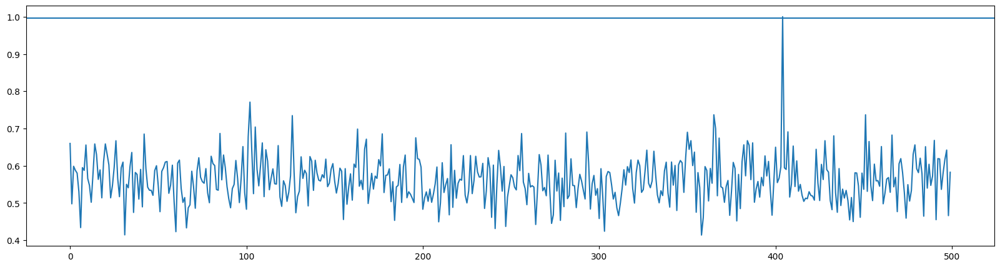

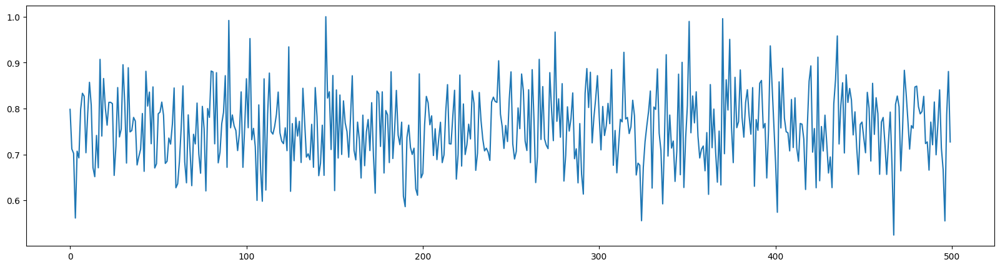

#: 0


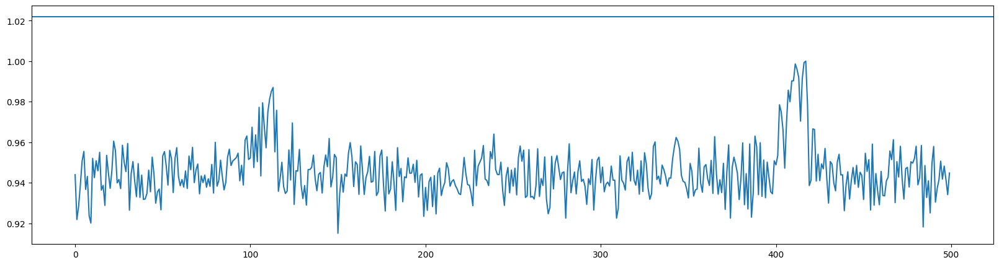

Checking Drift
16 16
[[0.639137   0.57000864 0.56242174 ... 0.6290009  0.70515215 0.5823071 ]
 [0.6058293  0.5263898  0.5139195  ... 0.7157156  0.79077923 0.6235156 ]
 [0.6146819  0.59860444 0.6992665  ... 0.6429817  0.61151284 0.4820739 ]
 ...
 [0.6062293  0.6848021  0.6539417  ... 0.5852269  0.711267   0.5980564 ]
 [0.55741346 0.5036284  0.6025467  ... 0.61242723 0.6533086  0.58984756]
 [0.6377775  0.59820986 0.5364424  ... 0.57083386 0.6115121  0.6681143 ]]
50
[[7.3686540e+10 6.9069332e+10 7.4711966e+10 ... 7.5046109e+10
  8.1935557e+10 6.8387308e+10]
 [8.7326646e+10 7.6932579e+10 8.5995323e+10 ... 7.3598796e+10
  7.8614143e+10 7.3512059e+10]
 [7.6618064e+10 7.7496074e+10 7.9115051e+10 ... 7.5553620e+10
  7.3332171e+10 9.1303297e+10]
 ...
 [7.7065224e+10 6.7557851e+10 9.1208311e+10 ... 7.4356367e+10
  7.1914906e+10 7.7458432e+10]
 [7.6308988e+10 6.7301085e+10 7.6854215e+10 ... 7.5093713e+10
  7.9658328e+10 6.1693702e+10]
 [6.2546506e+10 7.1510376e+10 7.4898145e+10 ... 8.4145414e+10


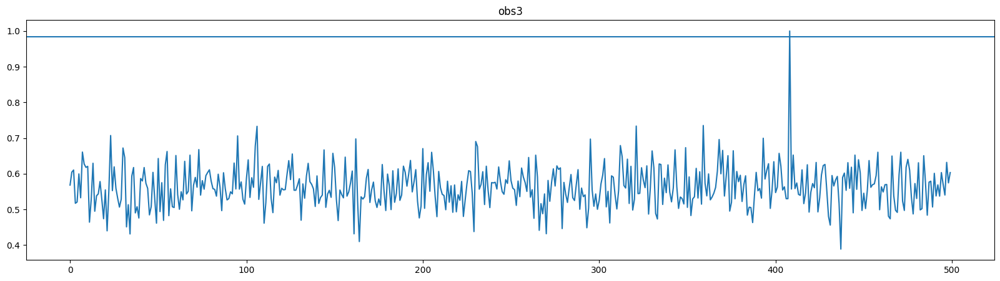

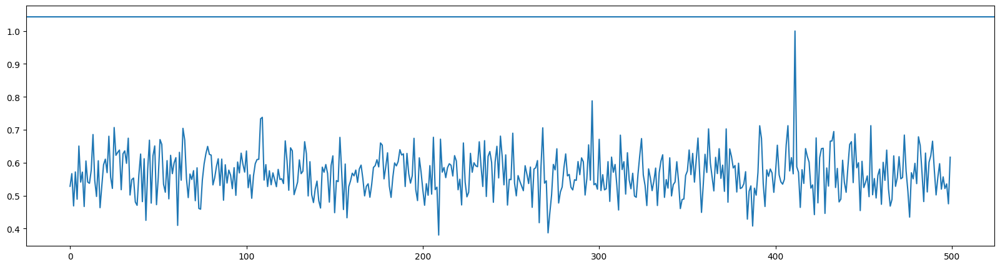

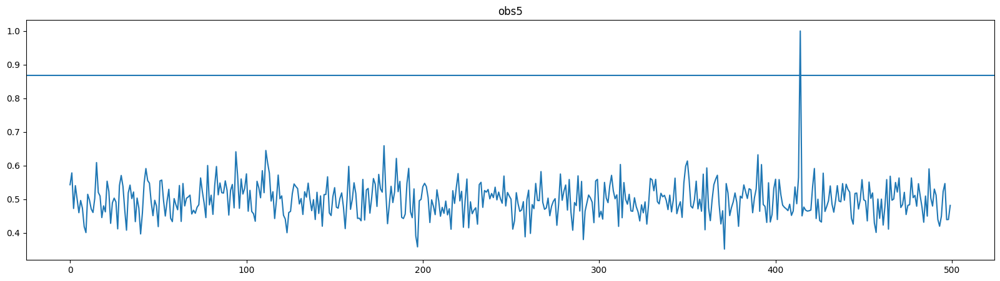

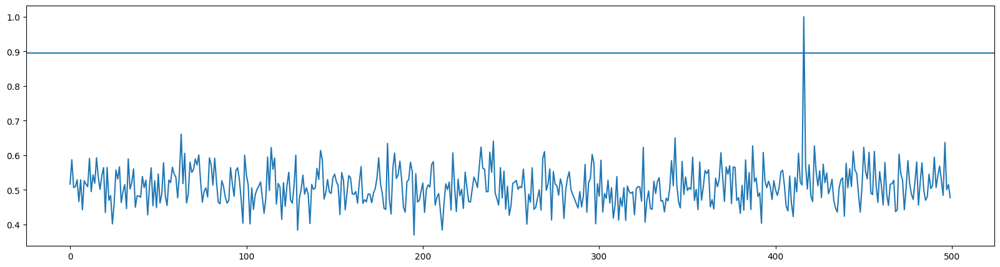

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7634.159768465906
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
19615500 19616000


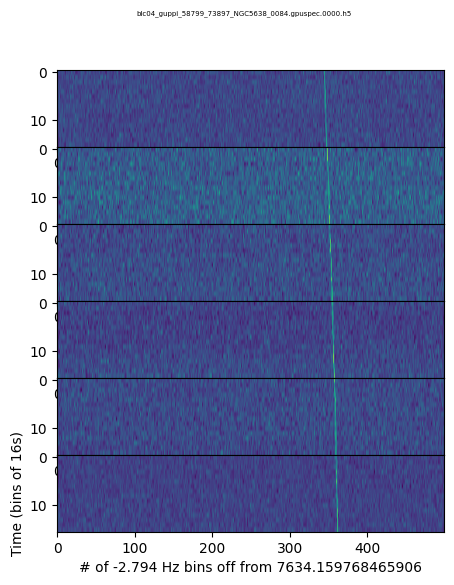

broadband False


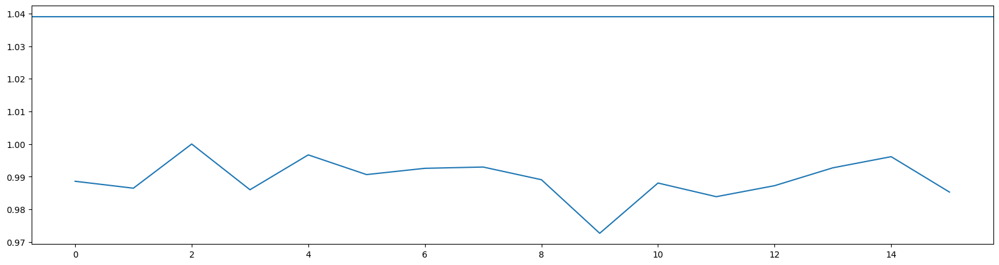

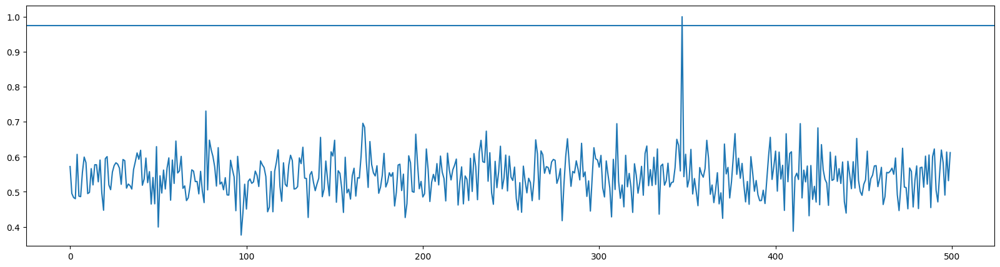

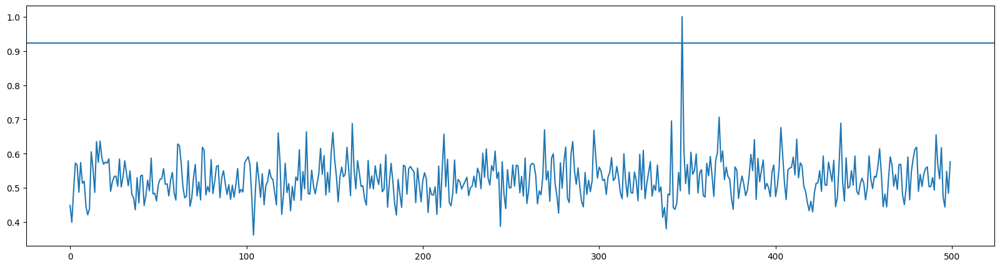

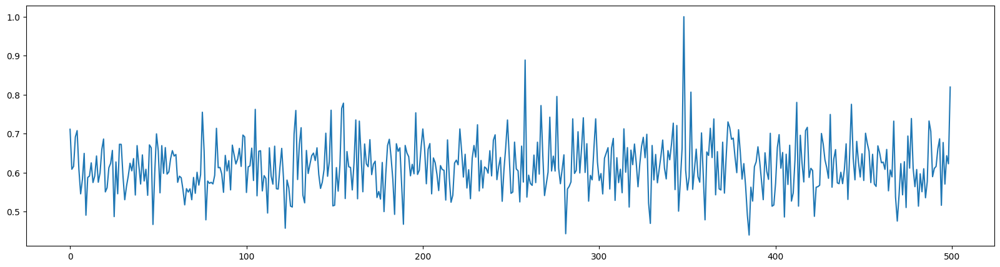

#: 0


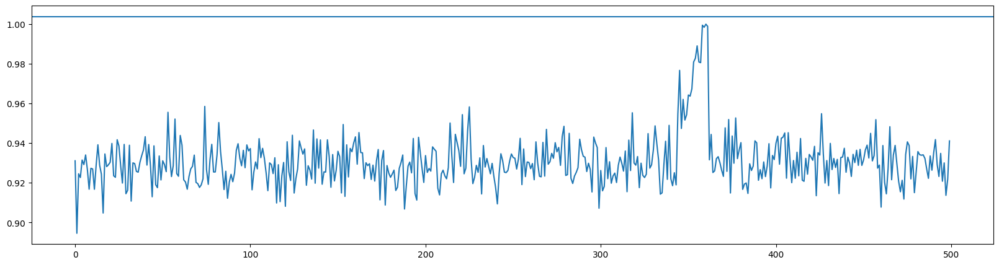

Checking Drift
16 16
[[0.649745   0.5559726  0.5627836  ... 0.5877301  0.56878406 0.74883777]
 [0.5358013  0.6049127  0.5300562  ... 0.53928196 0.554391   0.63223135]
 [0.4865848  0.5294207  0.4827053  ... 0.5356653  0.59331757 0.54172033]
 ...
 [0.5863903  0.5259927  0.5535368  ... 0.5101395  0.5602129  0.5417753 ]
 [0.5909847  0.5442013  0.48442316 ... 0.6232285  0.583836   0.5636084 ]
 [0.6456377  0.52423126 0.61386395 ... 0.61161953 0.5443673  0.515109  ]]
50
[[8.8101462e+10 5.8352726e+10 7.7587481e+10 ... 7.8709654e+10
  7.7526286e+10 7.2774197e+10]
 [8.6309298e+10 9.2917850e+10 8.5470183e+10 ... 7.3359483e+10
  7.7314302e+10 8.5028856e+10]
 [8.5651718e+10 7.7488103e+10 6.7404149e+10 ... 6.6533110e+10
  8.2116289e+10 8.1562558e+10]
 ...
 [8.3276095e+10 9.4313325e+10 8.7308607e+10 ... 7.0074819e+10
  7.4191069e+10 7.9743910e+10]
 [8.1673421e+10 8.4744020e+10 8.0965435e+10 ... 6.6660418e+10
  7.9528845e+10 7.9878865e+10]
 [9.7454793e+10 6.5255043e+10 8.2512937e+10 ... 7.7802029e+10


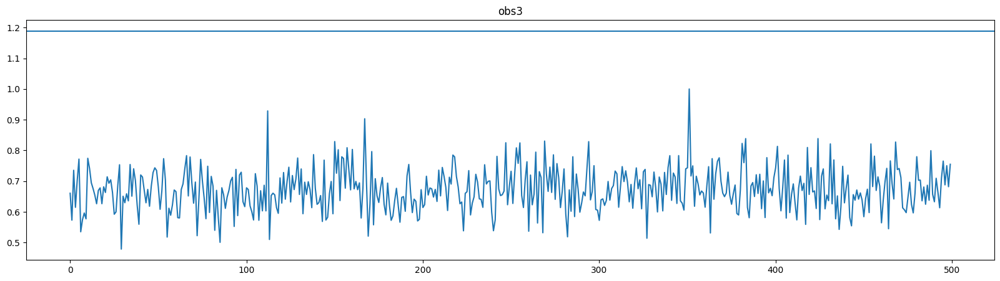

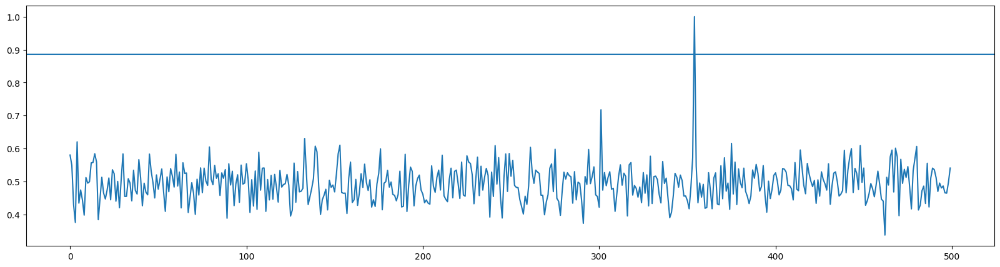

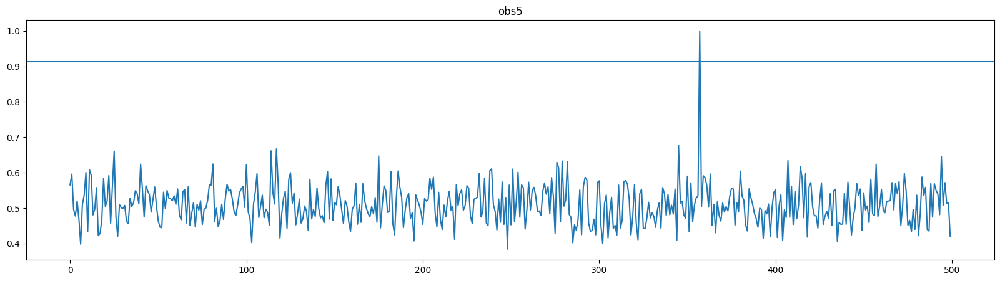

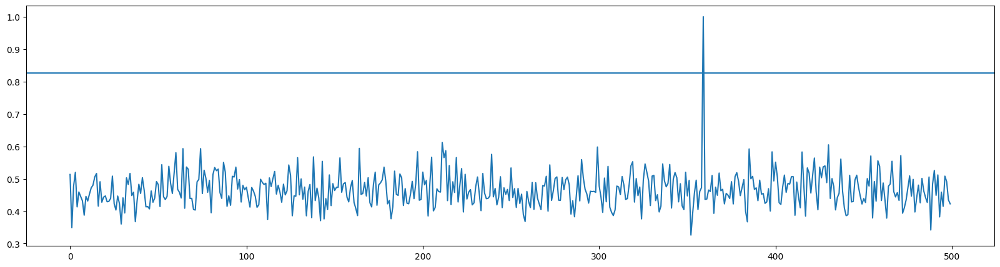

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7619.406221900135
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
24896000 24896500


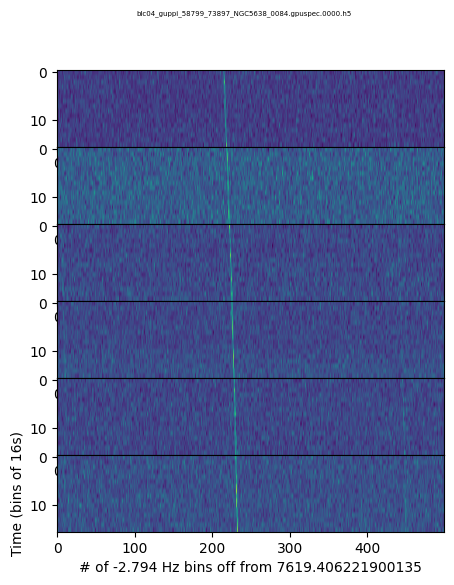

broadband False


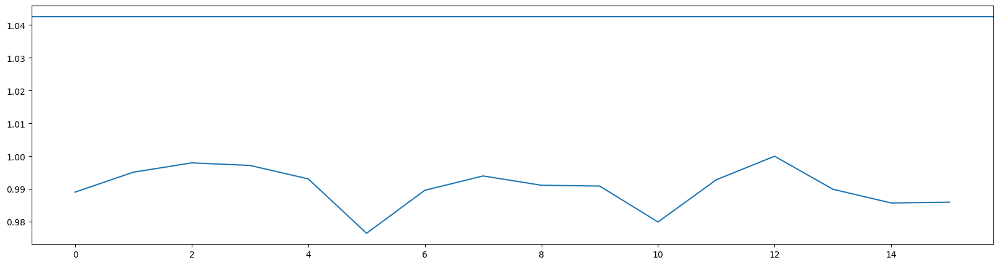

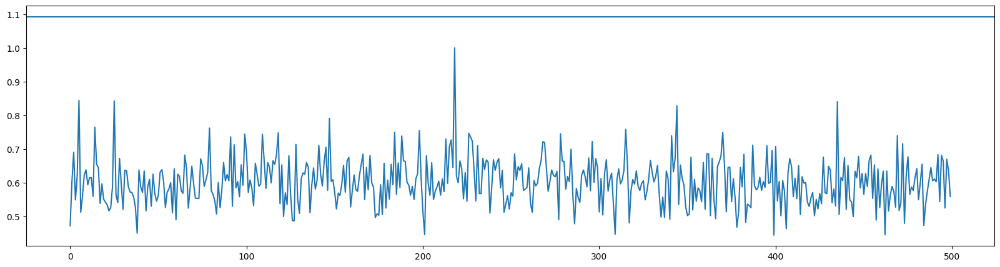

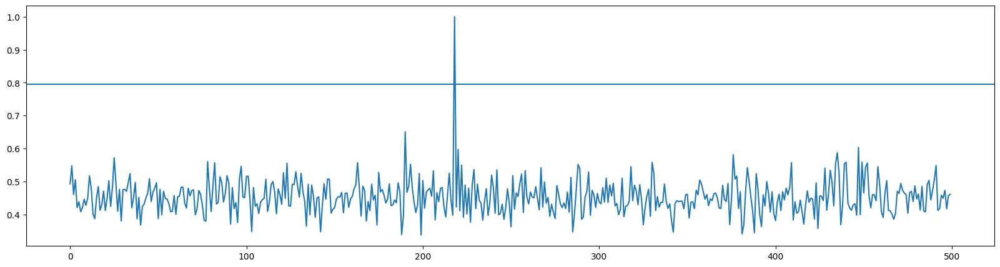

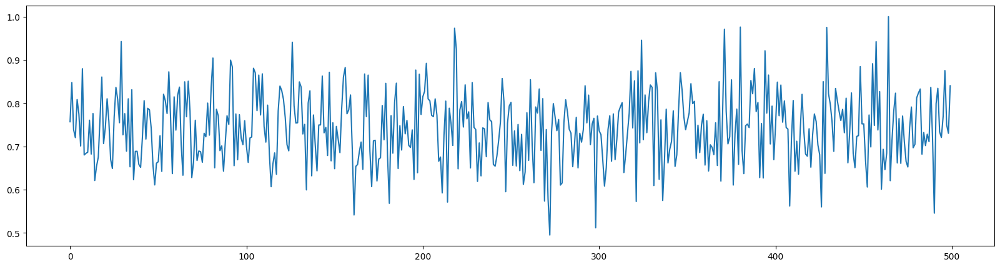

#: 2


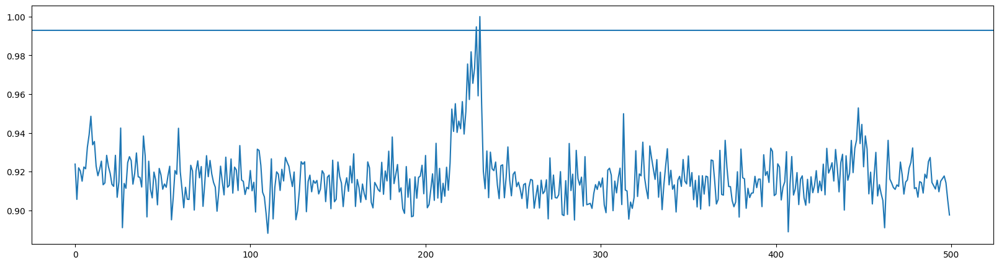

Checking Drift
[229, 231] [218]
16 16
[[0.5515878  0.6176363  0.5382802  ... 0.5460577  0.5321711  0.6122441 ]
 [0.5042261  0.6144042  0.56224364 ... 0.53479475 0.5798049  0.5336043 ]
 [0.52828854 0.48618594 0.40626106 ... 0.44953918 0.50962186 0.5239467 ]
 ...
 [0.6100442  0.57931715 0.52503604 ... 0.5746935  0.5549177  0.51469696]
 [0.56756485 0.42775065 0.55123484 ... 0.50777173 0.51660335 0.55888504]
 [0.6062082  0.52278084 0.64845777 ... 0.5499727  0.556591   0.5764448 ]]
50
[[6.6307428e+10 7.8474002e+10 5.7170579e+10 ... 6.6492682e+10
  6.1992878e+10 7.3220563e+10]
 [7.8534042e+10 8.1537065e+10 6.6692059e+10 ... 6.9615165e+10
  7.6858769e+10 7.3473556e+10]
 [5.8784592e+10 6.3658840e+10 7.2289321e+10 ... 8.4139614e+10
  6.8697190e+10 7.6139594e+10]
 ...
 [8.0382886e+10 7.8022795e+10 6.7560767e+10 ... 6.7385496e+10
  8.2801132e+10 7.8385365e+10]
 [5.9509481e+10 8.6397526e+10 7.1783424e+10 ... 6.8477698e+10
  8.1665221e+10 8.3902366e+10]
 [9.0452386e+10 8.1078747e+10 6.8063551e+10 .

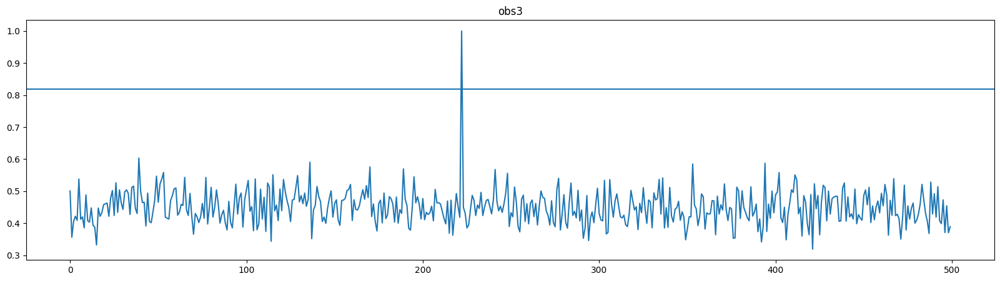

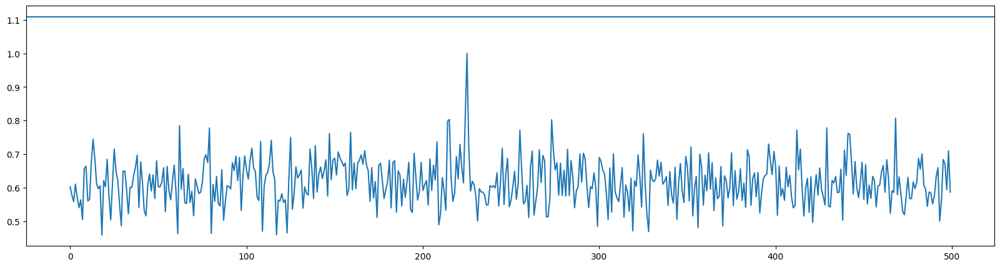

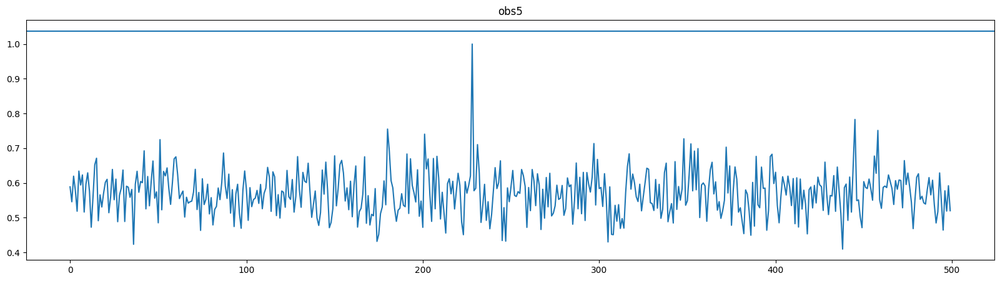

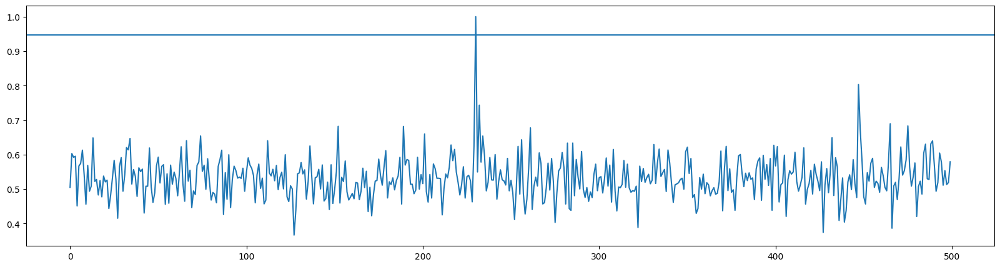

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7618.773388210684
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25122500 25123000


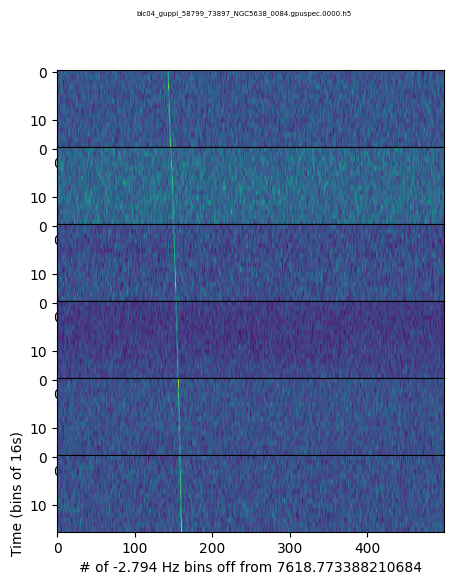

broadband False


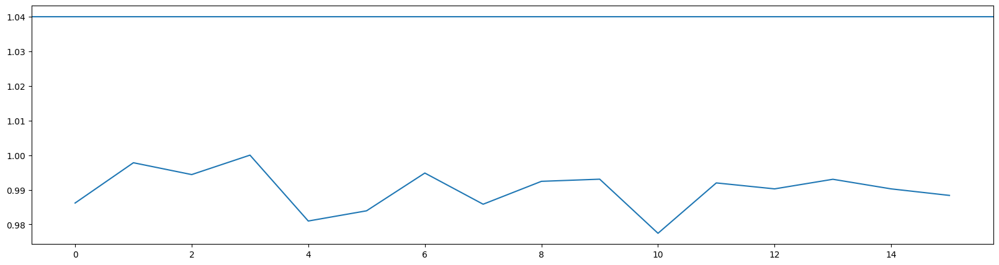

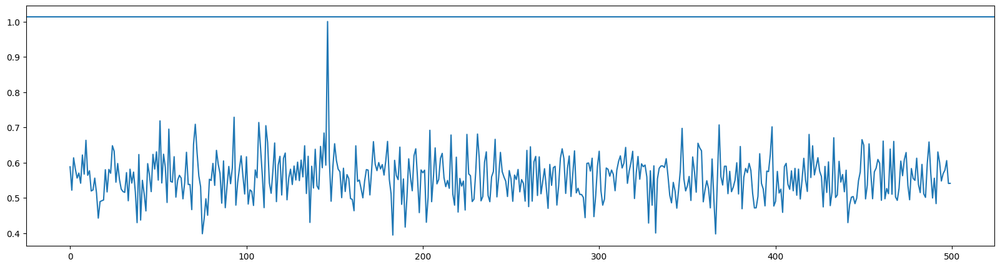

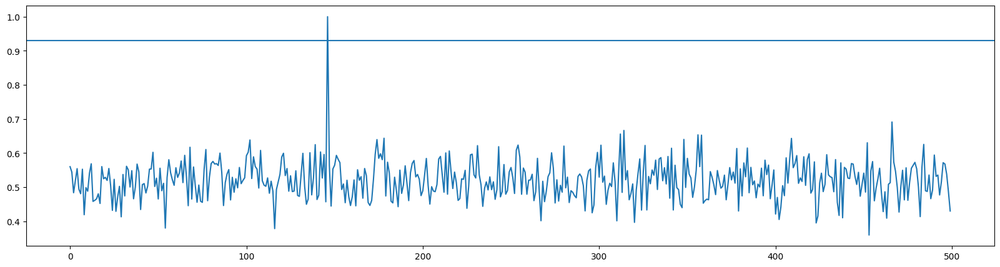

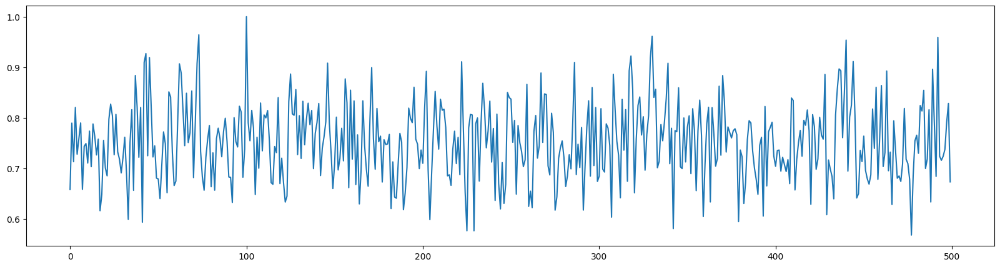

#: 0


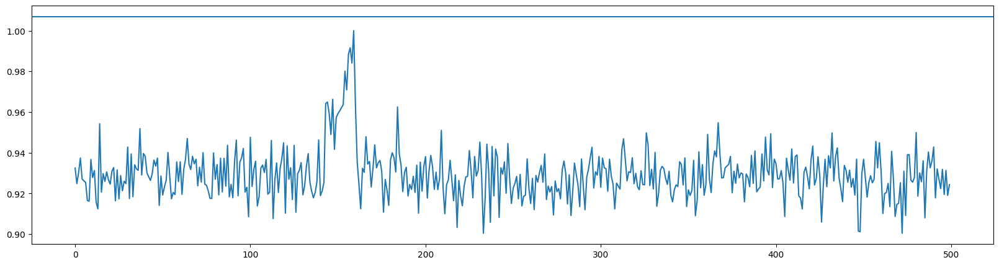

Checking Drift
16 16
[[0.4892041  0.5869361  0.53008366 ... 0.58782417 0.6158884  0.50045455]
 [0.5589149  0.55245423 0.55018467 ... 0.6072872  0.55867964 0.6370074 ]
 [0.5462642  0.5145614  0.59076333 ... 0.5921141  0.51101565 0.6225898 ]
 ...
 [0.5773622  0.46726114 0.39039728 ... 0.5671231  0.51286525 0.61930865]
 [0.5844097  0.5515588  0.3954148  ... 0.55693066 0.5534276  0.6026532 ]
 [0.51578754 0.52029616 0.51835334 ... 0.48632956 0.55240625 0.50244653]]
50
[[3.9984554e+10 4.9504137e+10 4.7441932e+10 ... 4.9525842e+10
  4.7130116e+10 5.1880481e+10]
 [4.7554064e+10 4.9511674e+10 5.1690799e+10 ... 4.7136920e+10
  4.5956637e+10 4.4011684e+10]
 [5.3944656e+10 5.0055795e+10 4.9354064e+10 ... 3.7011001e+10
  4.6410482e+10 4.3153302e+10]
 ...
 [5.1098407e+10 4.4645204e+10 4.8467722e+10 ... 5.5537910e+10
  5.2058804e+10 4.6497006e+10]
 [4.4789002e+10 5.5112524e+10 4.3287785e+10 ... 4.5129118e+10
  4.6496670e+10 4.7482470e+10]
 [3.8858166e+10 4.3392250e+10 4.2598191e+10 ... 5.1050418e+10


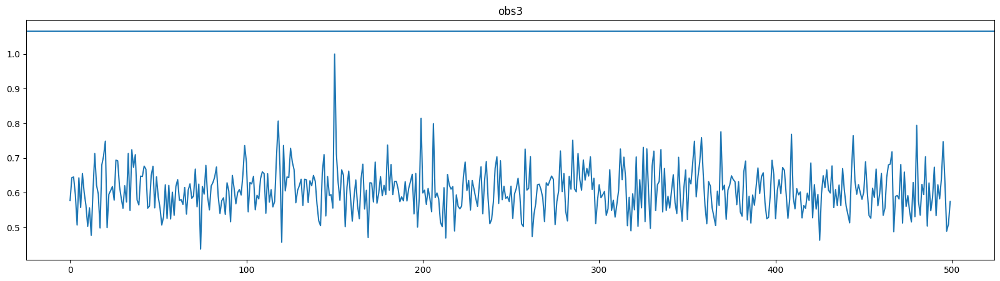

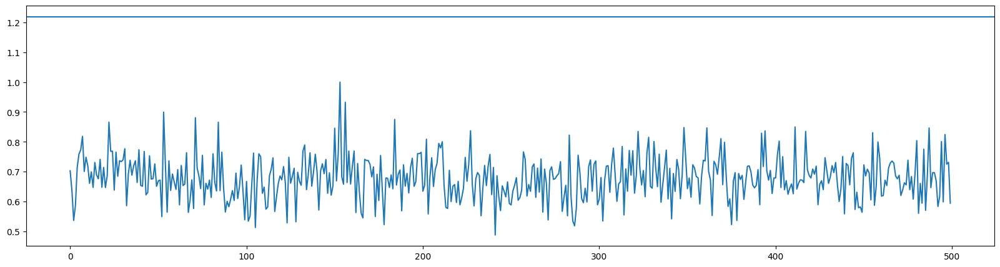

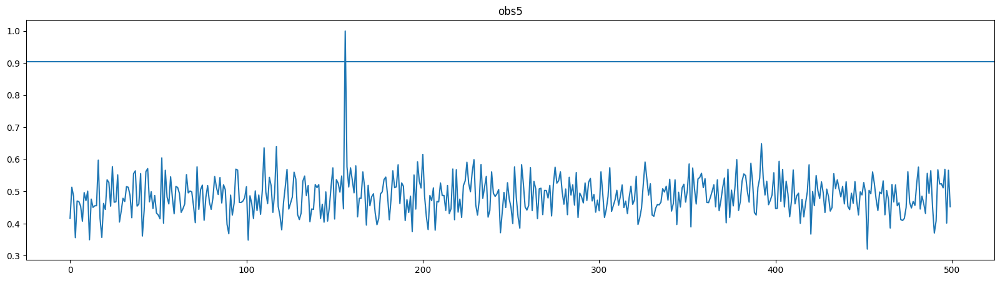

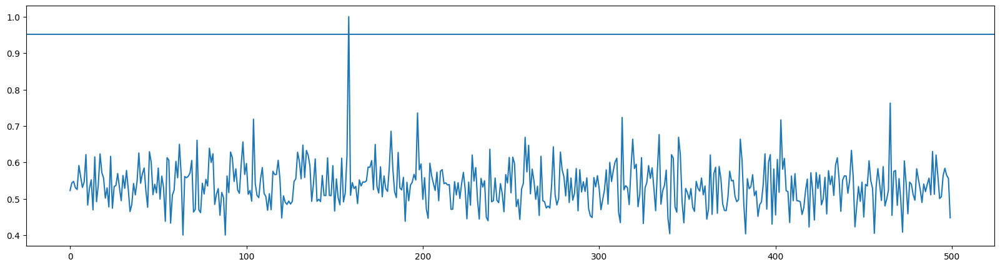

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7618.59597126022
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25186000 25186500


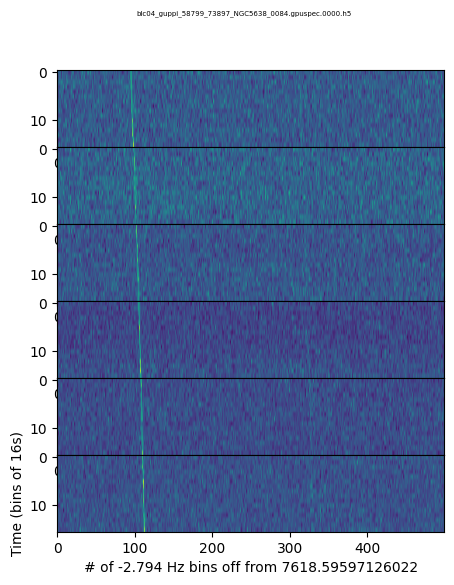

broadband False


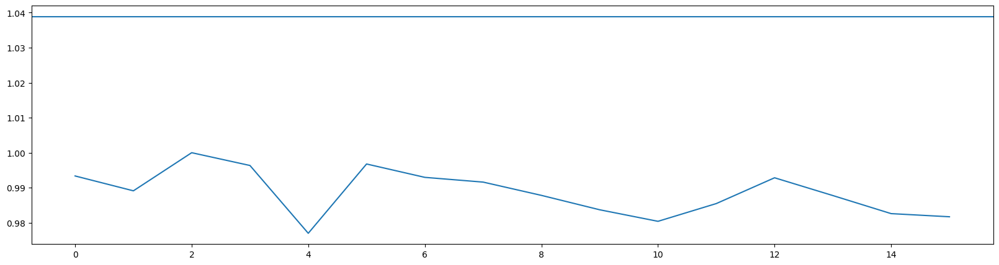

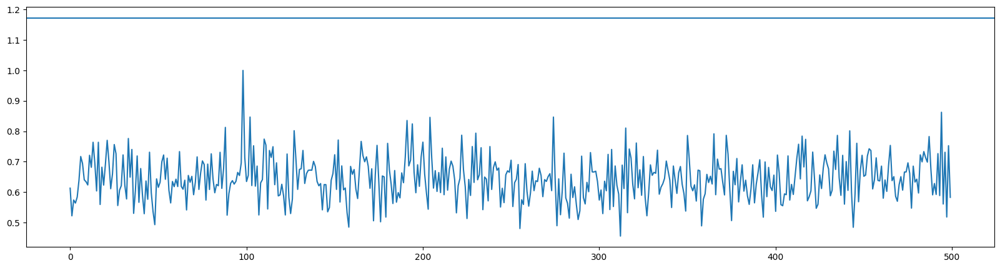

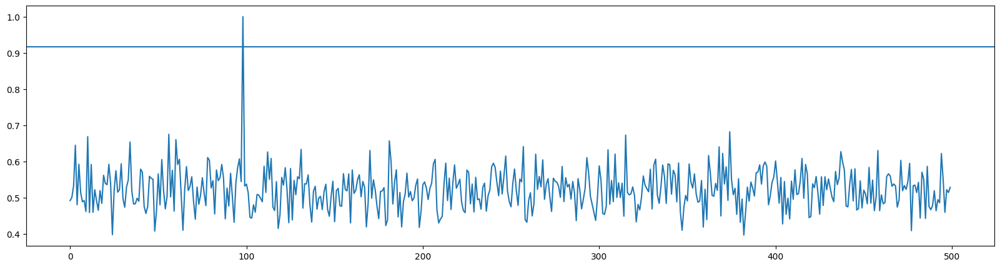

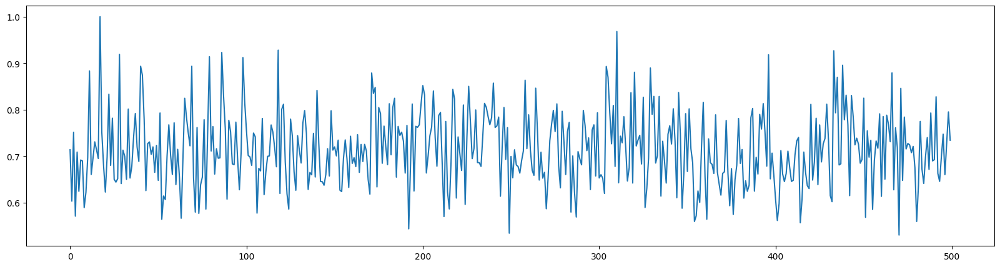

#: 0


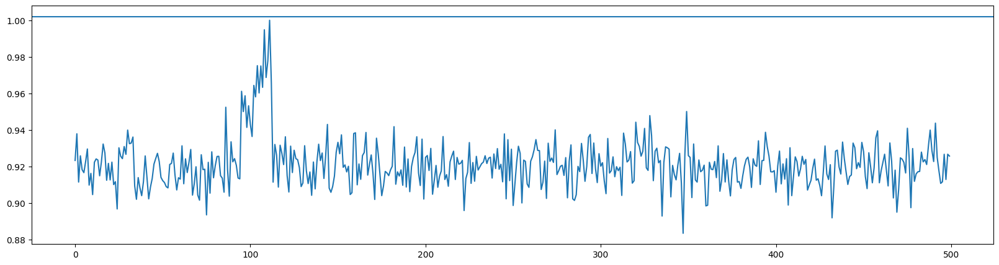

Checking Drift
16 16
[[0.5688475  0.48089924 0.5988605  ... 0.579976   0.6337619  0.5851861 ]
 [0.6226894  0.64616674 0.47861505 ... 0.60641134 0.5585529  0.6049621 ]
 [0.47427347 0.5581779  0.63577735 ... 0.62706256 0.55599904 0.39568165]
 ...
 [0.5733372  0.5344888  0.63158303 ... 0.52432585 0.531754   0.537193  ]
 [0.60050285 0.57523376 0.58988154 ... 0.5185874  0.54556584 0.55811214]
 [0.5095785  0.7687261  0.44281408 ... 0.55778426 0.60049736 0.5275305 ]]
50
[[4.0234914e+10 4.4683272e+10 4.2749731e+10 ... 4.7268962e+10
  3.7417578e+10 4.0165962e+10]
 [4.8448987e+10 3.6338483e+10 4.3507823e+10 ... 4.5908218e+10
  3.9606186e+10 4.6907261e+10]
 [4.3104039e+10 4.7143461e+10 4.8954937e+10 ... 3.9074181e+10
  4.9815572e+10 4.7588332e+10]
 ...
 [4.2868040e+10 4.2782003e+10 3.7223186e+10 ... 3.8347391e+10
  4.2414547e+10 4.3145220e+10]
 [4.5226639e+10 4.3092320e+10 3.3794281e+10 ... 3.5584426e+10
  4.1557656e+10 4.1323135e+10]
 [3.5630469e+10 4.4548133e+10 4.5966569e+10 ... 4.3075391e+10


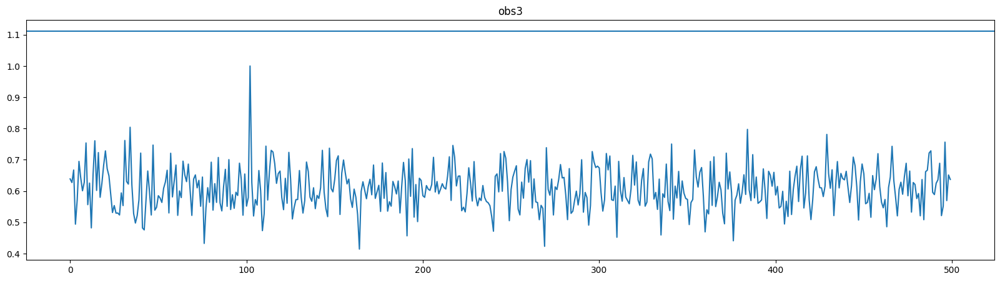

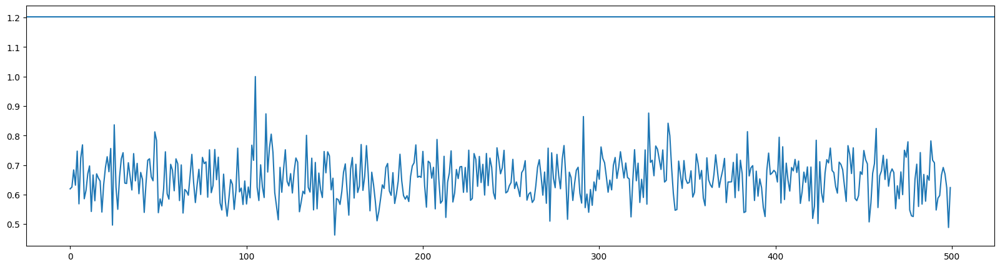

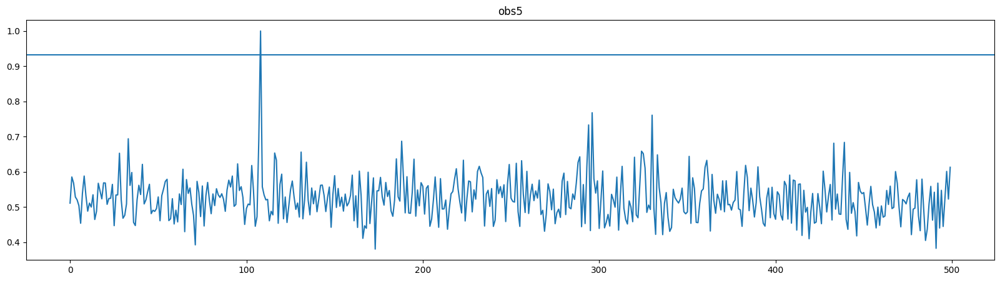

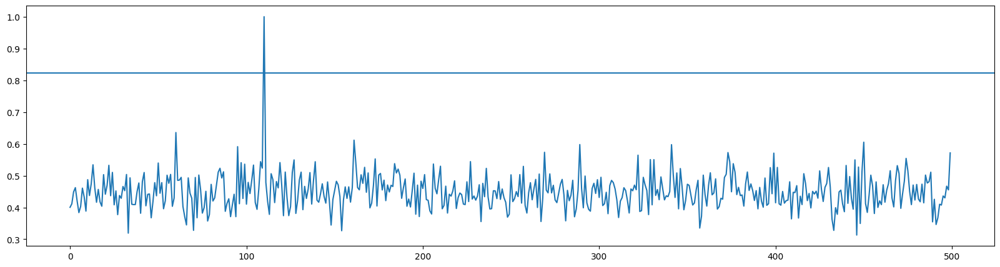

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7618.287237826735
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25296500 25297000


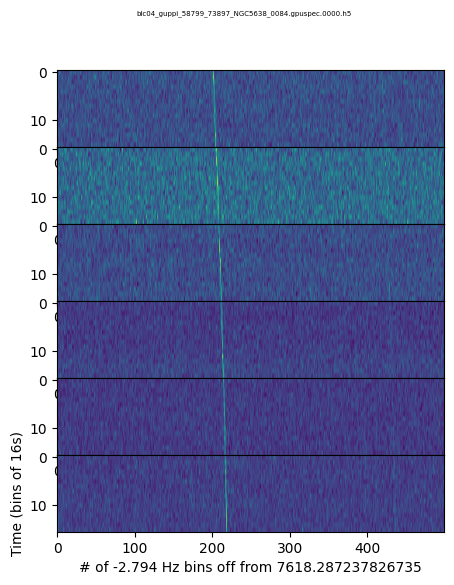

broadband False


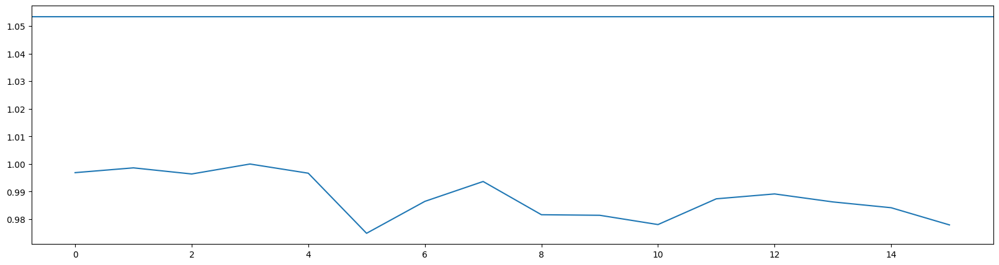

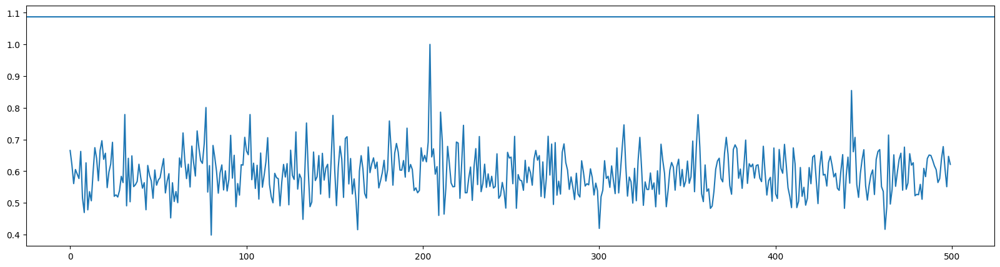

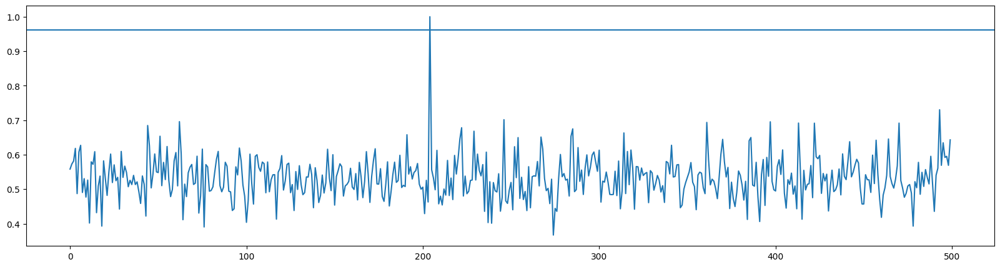

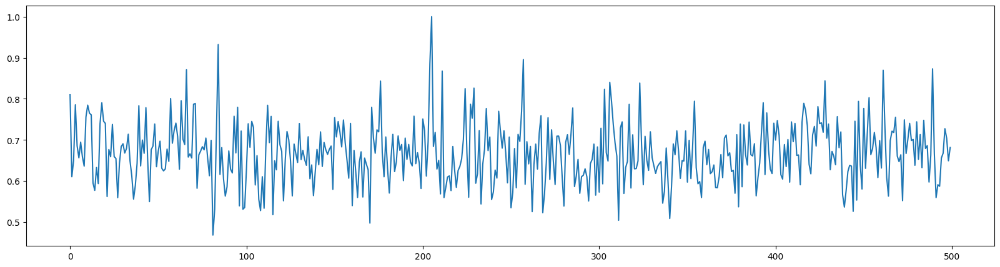

#: 1


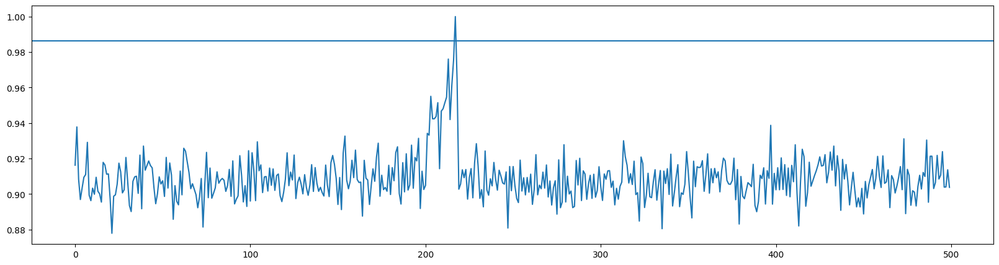

Checking Drift
16 16
[[0.7341174  0.55329484 0.58902144 ... 0.6384606  0.588612   0.6178405 ]
 [0.575049   0.59743375 0.54671574 ... 0.49835446 0.6221892  0.6009741 ]
 [0.61502504 0.6294248  0.5725178  ... 0.546181   0.52847433 0.70589393]
 ...
 [0.62395436 0.63713235 0.67228204 ... 0.5913358  0.5836493  0.45734143]
 [0.5247312  0.7198848  0.5170339  ... 0.597763   0.61244136 0.5993429 ]
 [0.595948   0.6069482  0.5848885  ... 0.60680723 0.62794405 0.59602773]]
50
[[6.62718382e+10 6.46545859e+10 5.45562051e+10 ... 7.24484669e+10
  6.73242644e+10 6.47725711e+10]
 [7.25094318e+10 7.36089211e+10 7.16934840e+10 ... 6.24636764e+10
  7.50566851e+10 6.14824264e+10]
 [1.01088485e+11 7.41570560e+10 7.56871660e+10 ... 7.96322939e+10
  6.96356618e+10 8.86792438e+10]
 ...
 [7.92628838e+10 7.26376038e+10 6.80280433e+10 ... 6.38506639e+10
  6.81530327e+10 8.24849449e+10]
 [7.19781315e+10 6.91270205e+10 6.26878874e+10 ... 6.07799992e+10
  9.48745912e+10 7.62159677e+10]
 [8.52739604e+10 8.02797732e+10 

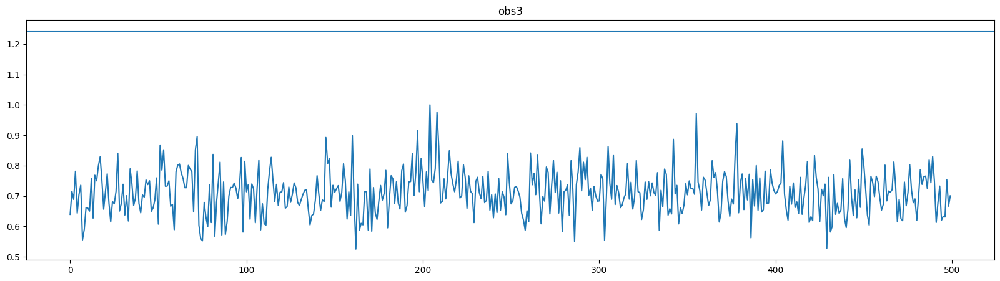

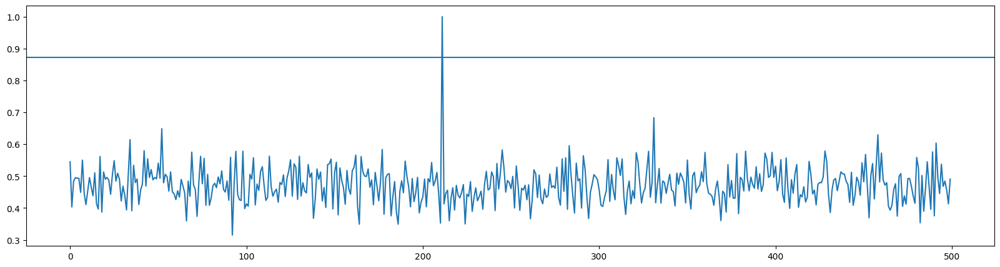

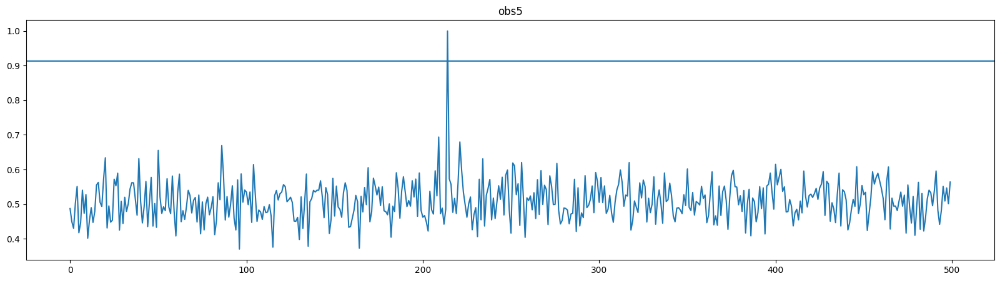

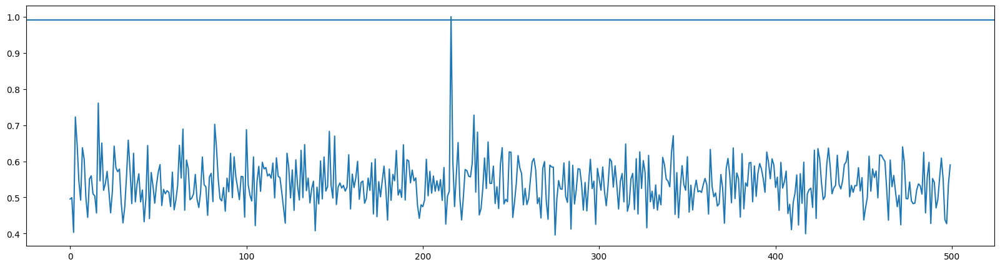

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7617.588745895773
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25546500 25547000


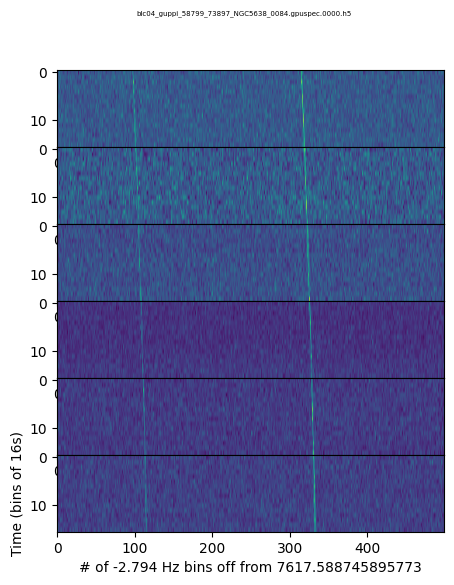

broadband False


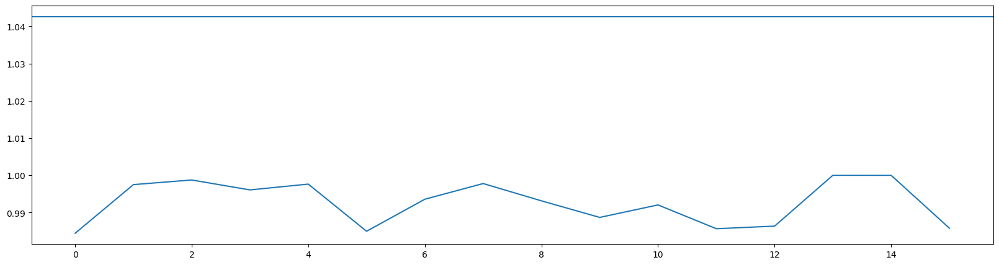

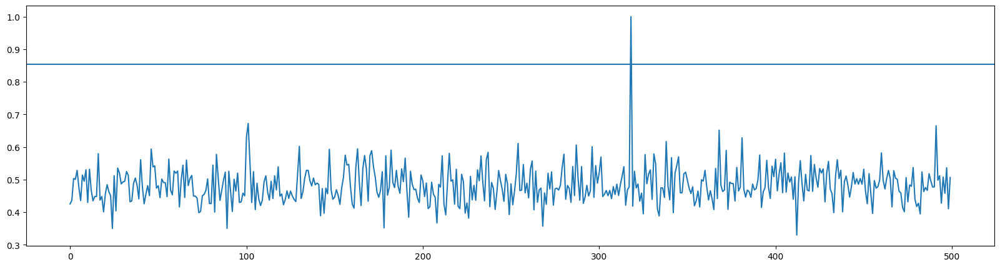

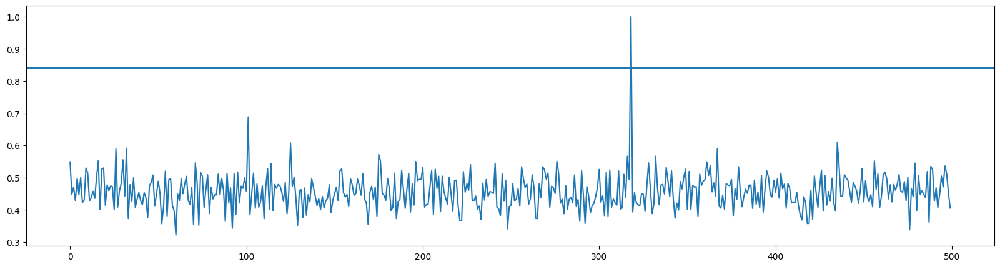

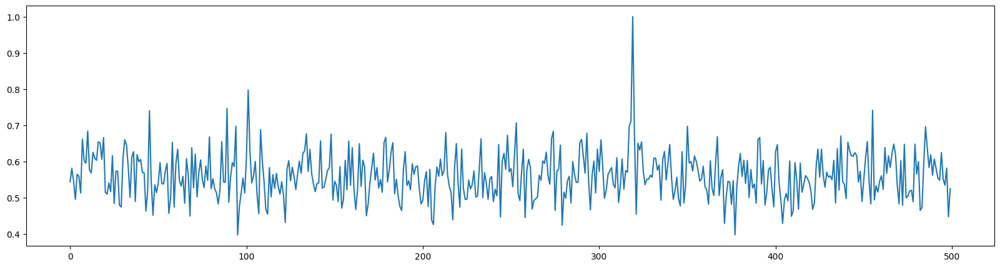

#: 1


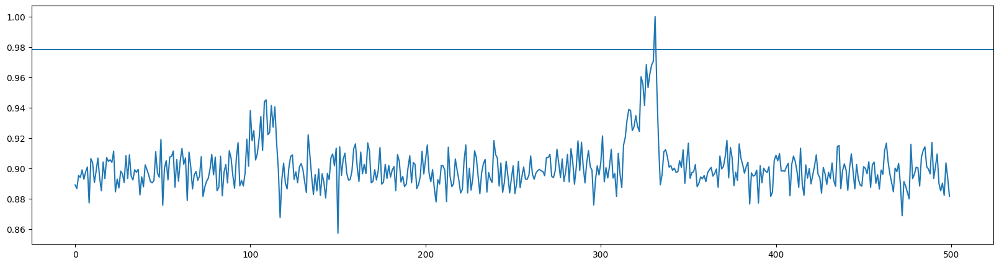

Checking Drift
[331] [318]
16 16
[[0.543483   0.58116084 0.5452421  ... 0.58117664 0.44726044 0.5249349 ]
 [0.55508727 0.550765   0.60273623 ... 0.55801916 0.53203017 0.62163323]
 [0.57142156 0.5714202  0.5443002  ... 0.5492145  0.61368746 0.47323114]
 ...
 [0.56592304 0.5560799  0.55908936 ... 0.58221865 0.5628008  0.5362415 ]
 [0.6214287  0.5001868  0.6617592  ... 0.434919   0.53714865 0.6298236 ]
 [0.57423747 0.6254494  0.57527316 ... 0.6210209  0.59806263 0.5407229 ]]
50
[[8.1101300e+10 7.8407975e+10 8.6465667e+10 ... 7.0956737e+10
  7.5014390e+10 7.7925261e+10]
 [8.6757081e+10 6.7457556e+10 6.1126410e+10 ... 7.3534366e+10
  8.0794681e+10 8.3616014e+10]
 [7.0086541e+10 8.3539460e+10 8.3209798e+10 ... 7.3756131e+10
  8.3263627e+10 8.3785622e+10]
 ...
 [7.6367233e+10 7.9159468e+10 7.7178274e+10 ... 6.8427219e+10
  8.2642158e+10 6.5817616e+10]
 [8.1651991e+10 7.1416496e+10 8.9309258e+10 ... 8.7294558e+10
  7.1556186e+10 9.8126864e+10]
 [7.0982590e+10 7.9326249e+10 7.2740217e+10 ... 7.

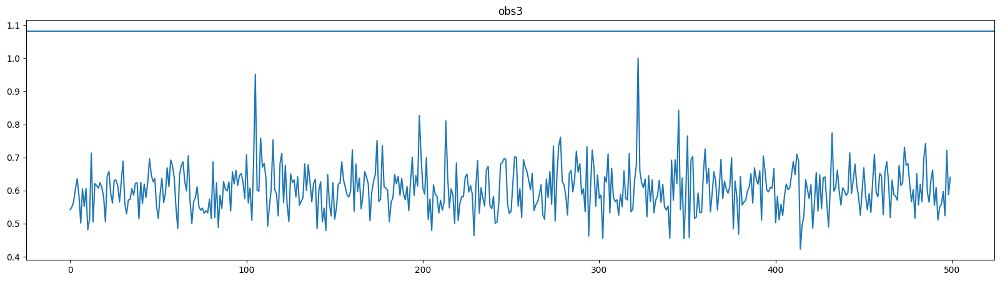

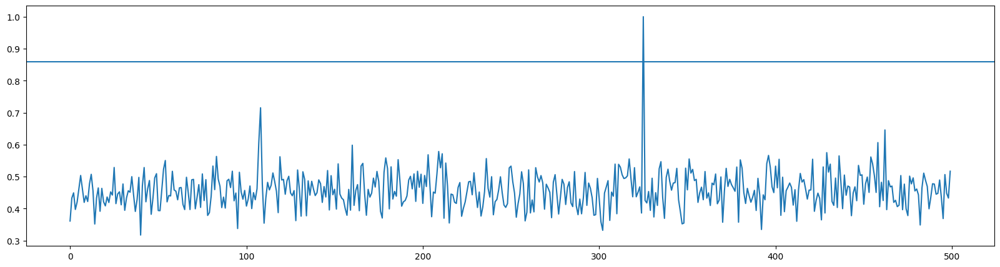

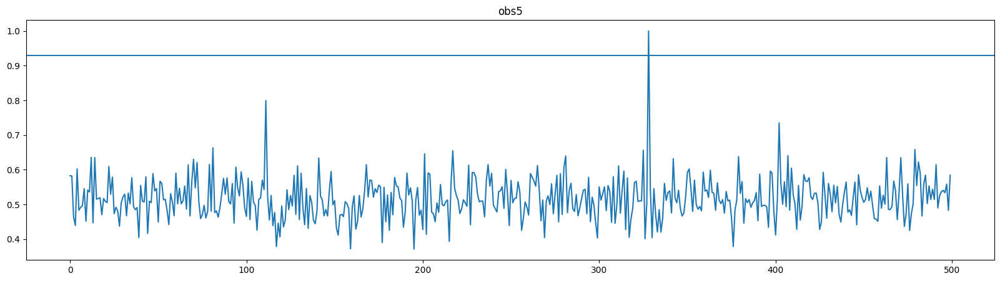

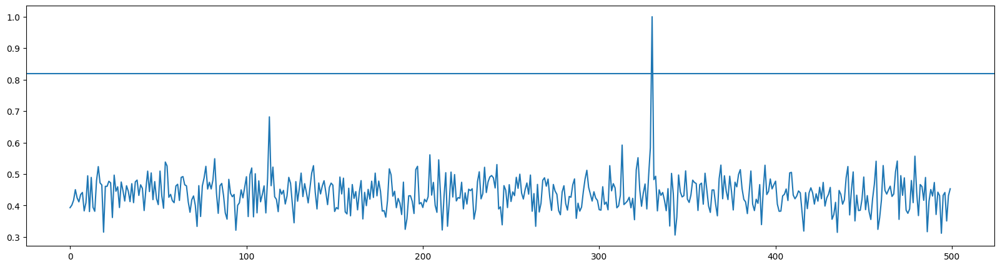

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7617.584554944187
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25548000 25548500


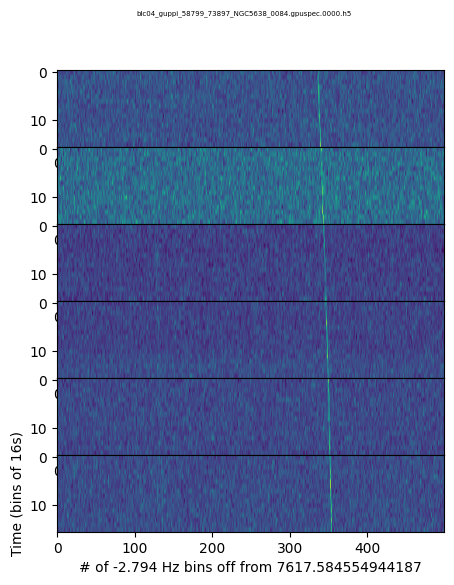

broadband False


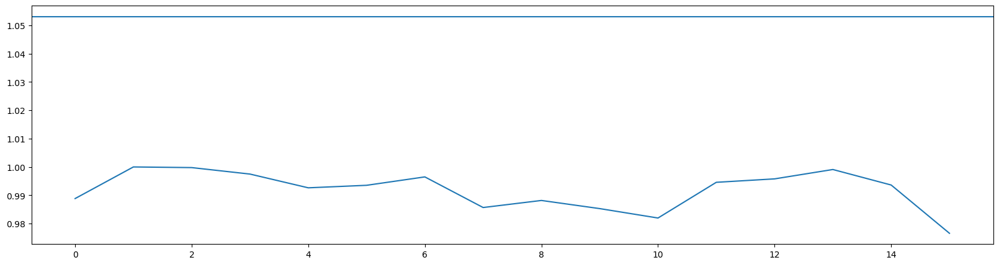

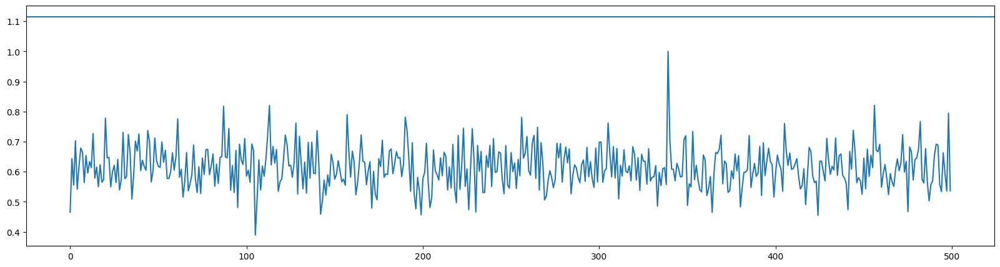

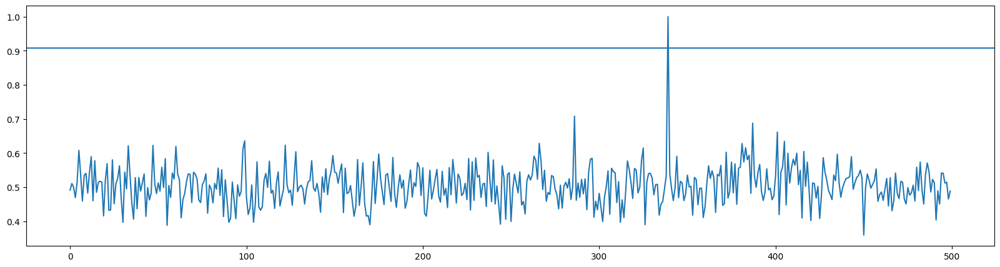

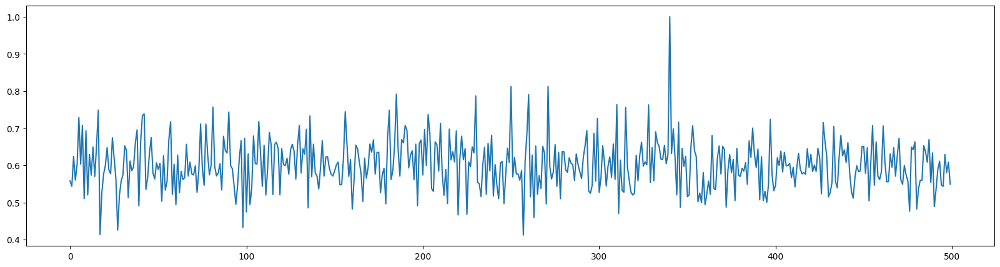

#: 0


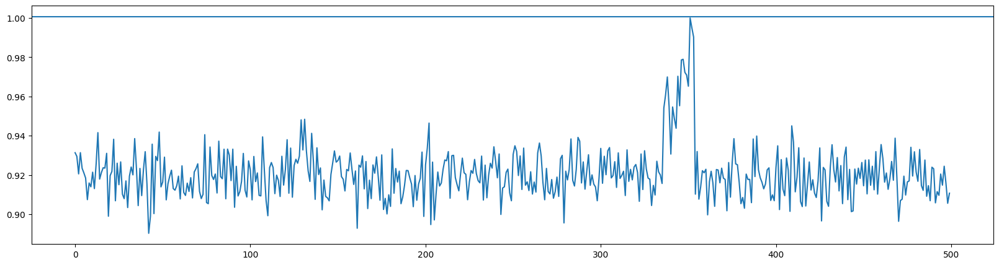

Checking Drift
16 16
[[0.5511157  0.5370752  0.6163638  ... 0.57319677 0.6012885  0.54273295]
 [0.5336048  0.504397   0.57365894 ... 0.67595756 0.65976745 0.648597  ]
 [0.62311995 0.59571993 0.7508894  ... 0.64374584 0.47117254 0.62783605]
 ...
 [0.58383614 0.68041027 0.5210159  ... 0.5609311  0.5969485  0.60849863]
 [0.61713237 0.7210443  0.62420446 ... 0.5397798  0.66600317 0.5149548 ]
 [0.6021496  0.52880454 0.64939016 ... 0.68200415 0.4730141  0.50815964]]
50
[[6.43541238e+10 7.16465193e+10 7.46966221e+10 ... 8.28154348e+10
  7.99763169e+10 6.79837696e+10]
 [7.80066980e+10 7.13937388e+10 7.88451656e+10 ... 6.13424824e+10
  8.72565146e+10 7.71484467e+10]
 [7.09609144e+10 7.00266906e+10 6.86531625e+10 ... 7.68287867e+10
  7.88226949e+10 7.94153943e+10]
 ...
 [8.46662861e+10 1.01635965e+11 7.05680589e+10 ... 6.51141202e+10
  8.87245455e+10 8.74318725e+10]
 [9.38645996e+10 7.68651674e+10 6.19989074e+10 ... 8.54961930e+10
  7.53975378e+10 7.39676733e+10]
 [9.59204147e+10 6.70120550e+10 

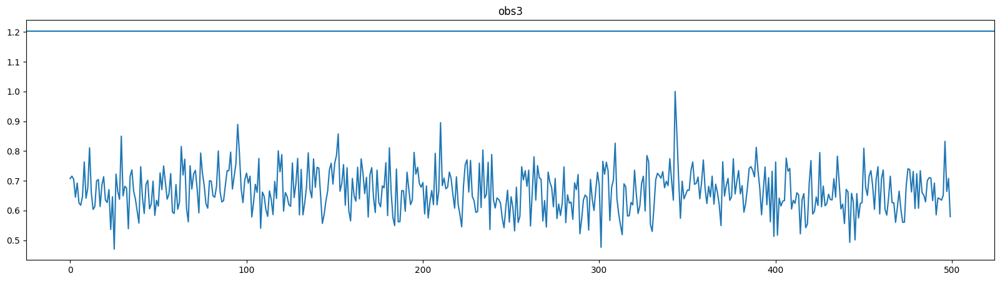

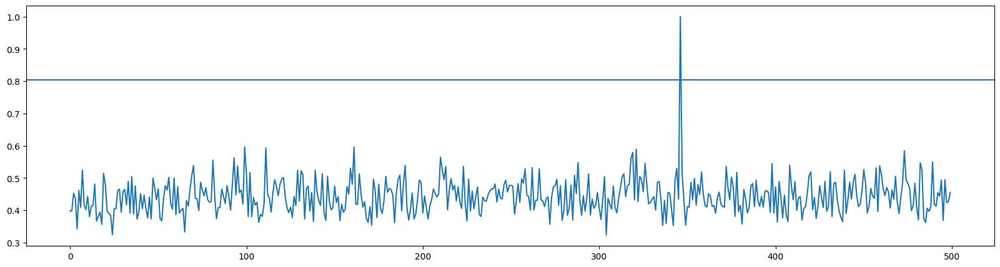

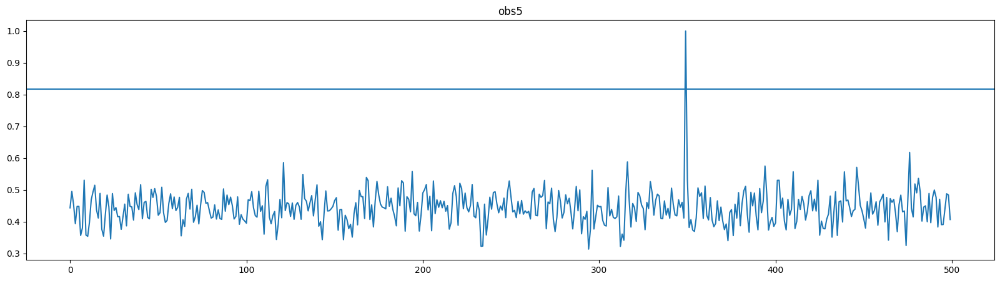

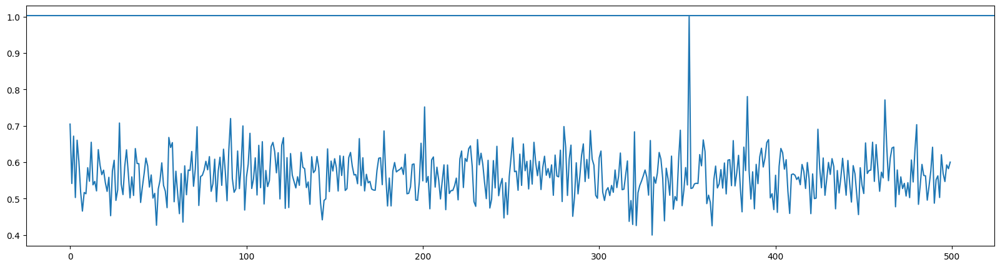

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7617.384786251932
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25619500 25620000


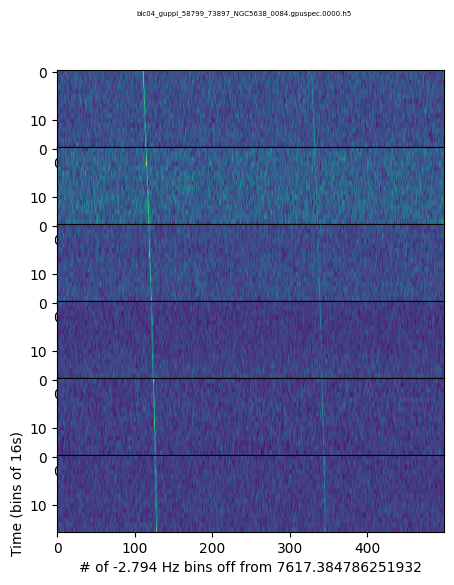

broadband False


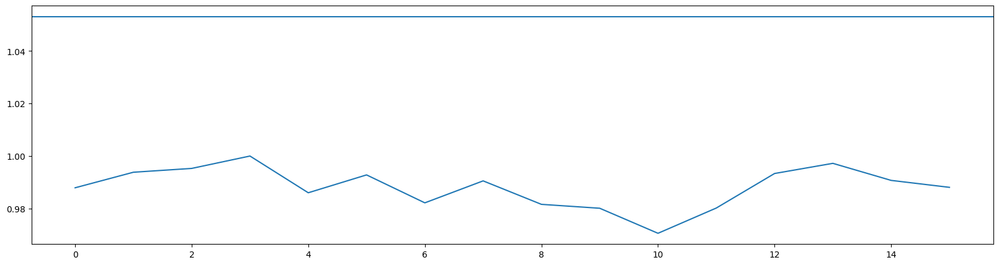

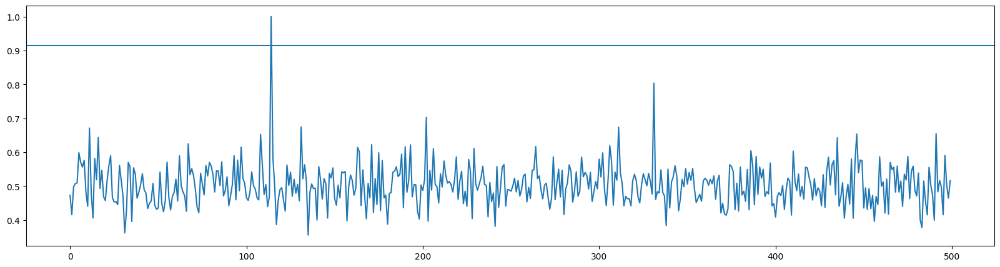

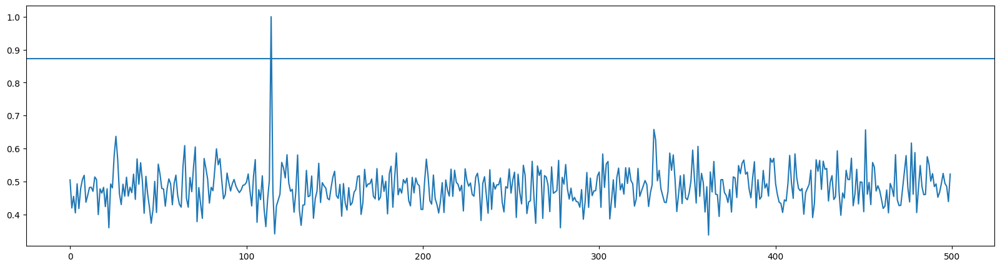

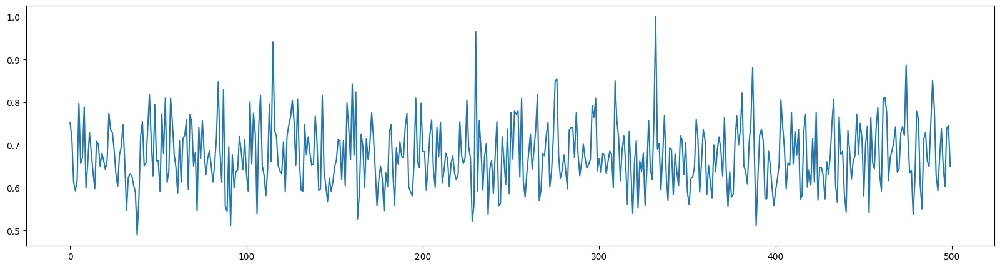

#: 1


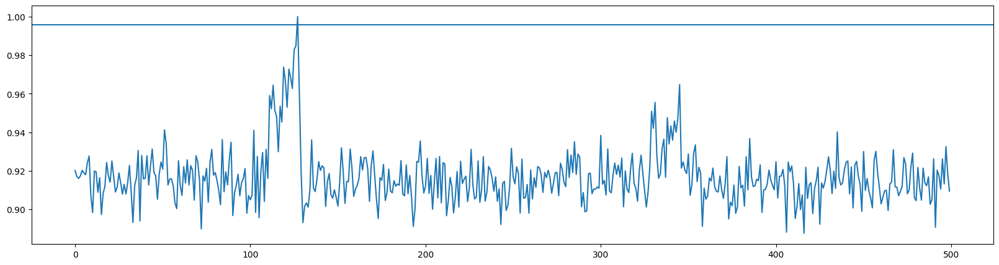

Checking Drift
[127] [114]
16 16
[[0.6200463  0.5897608  0.5054354  ... 0.60913944 0.61376184 0.5358263 ]
 [0.70863944 0.6006615  0.52216625 ... 0.6847323  0.55623484 0.58332384]
 [0.47029185 0.6078936  0.4645408  ... 0.5447043  0.54417783 0.51977694]
 ...
 [0.6486806  0.5447993  0.5062698  ... 0.5694511  0.51224476 0.5714879 ]
 [0.6203289  0.623049   0.5915477  ... 0.55704474 0.5684209  0.5572192 ]
 [0.56893647 0.6005194  0.5846669  ... 0.6352697  0.57031584 0.5712604 ]]
50
[[7.0901359e+10 6.0809368e+10 8.6743343e+10 ... 7.5688305e+10
  7.8554038e+10 1.1844304e+11]
 [9.1640349e+10 8.3967402e+10 7.5622728e+10 ... 6.9881577e+10
  8.3828441e+10 9.8332664e+10]
 [6.8787560e+10 8.2282234e+10 6.9946237e+10 ... 7.5371553e+10
  8.7994065e+10 8.1905877e+10]
 ...
 [7.8908432e+10 8.4099375e+10 6.8355342e+10 ... 7.6683264e+10
  8.7847772e+10 9.2584624e+10]
 [8.1135583e+10 6.4698872e+10 8.9275310e+10 ... 7.9720612e+10
  7.7247078e+10 8.5047828e+10]
 [8.2050540e+10 7.6861661e+10 7.3863168e+10 ... 7.

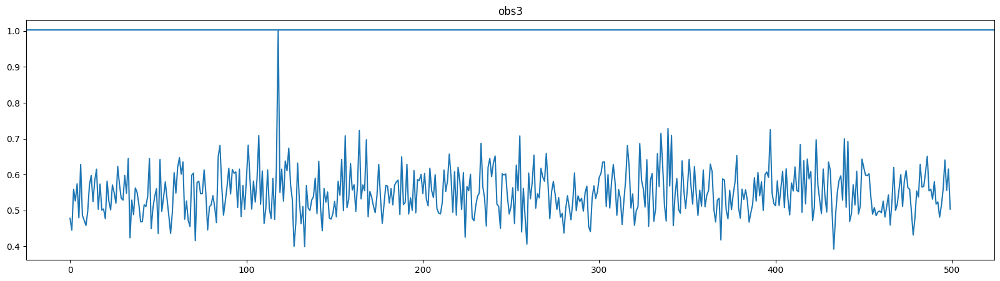

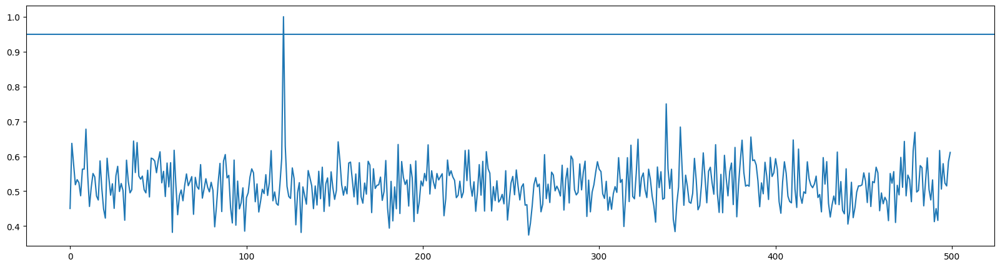

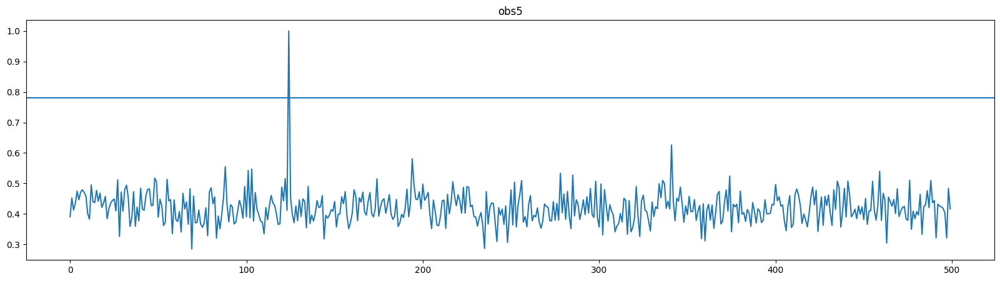

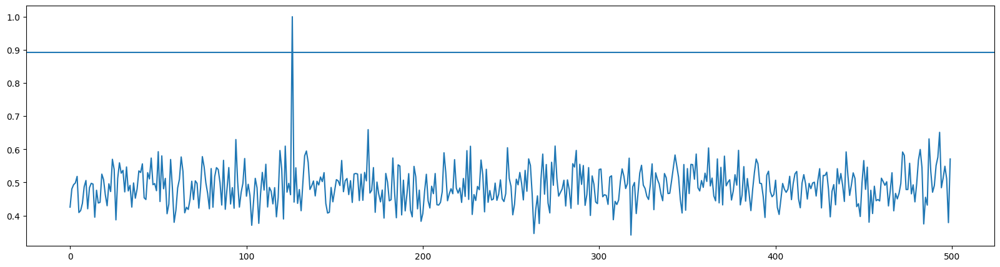

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7617.173841688782
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25695000 25695500


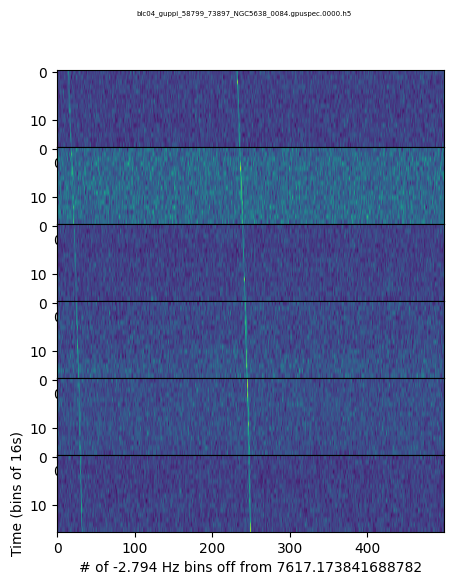

broadband False


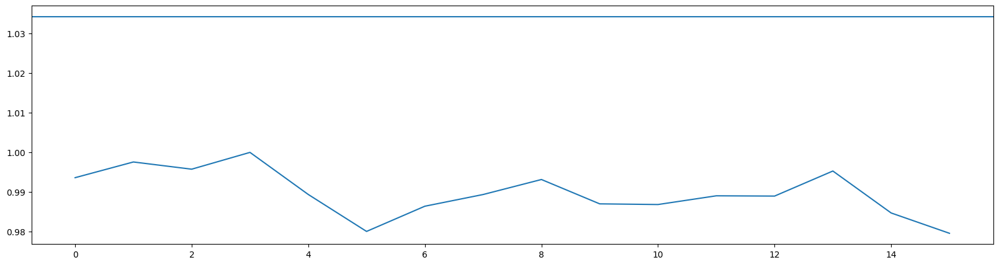

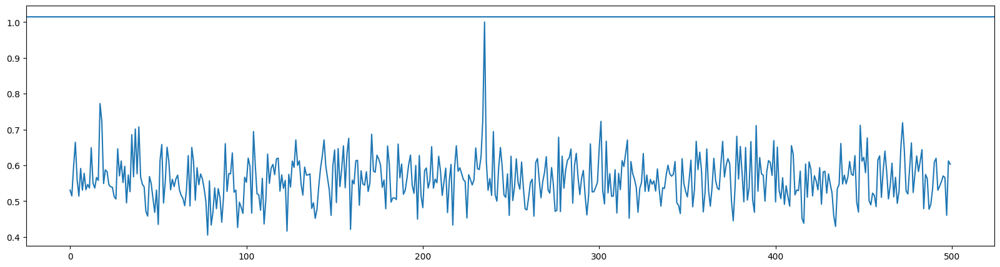

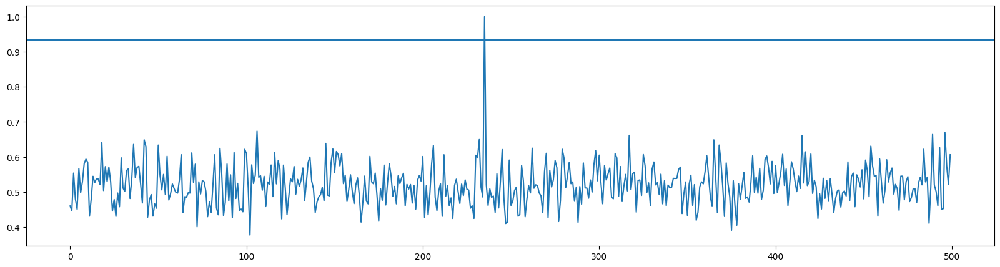

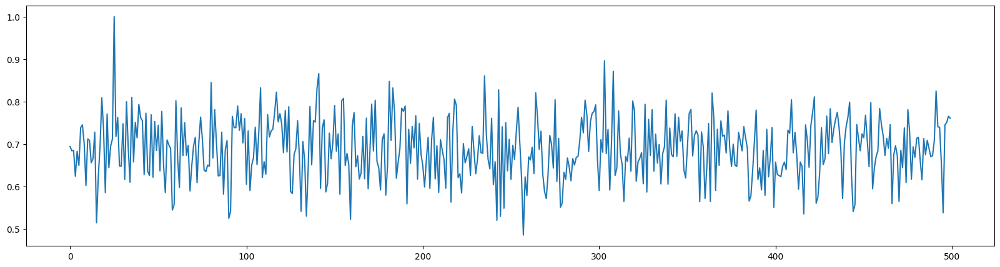

#: 0


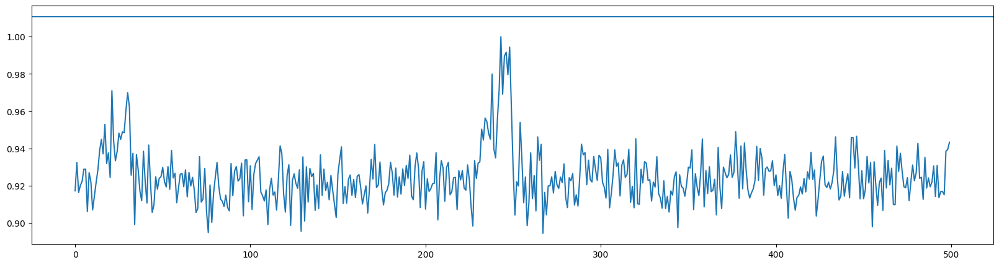

Checking Drift
16 16
[[0.5652142  0.5570637  0.55785567 ... 0.6112837  0.6233099  0.61963356]
 [0.58185256 0.6180045  0.58573633 ... 0.6085551  0.45244548 0.6280479 ]
 [0.6853357  0.6176736  0.71622455 ... 0.62859106 0.60431707 0.54750746]
 ...
 [0.5119748  0.64115137 0.6391485  ... 0.6017211  0.56663865 0.6007924 ]
 [0.6206434  0.5541569  0.61235654 ... 0.62637633 0.56985754 0.6013288 ]
 [0.55315953 0.5905241  0.4377621  ... 0.70065045 0.53742474 0.48826003]]
50
[[7.2238064e+10 8.2552488e+10 7.6468265e+10 ... 7.7369197e+10
  9.1253899e+10 8.1852711e+10]
 [7.5503493e+10 8.4441645e+10 8.0617497e+10 ... 7.6043731e+10
  7.4187579e+10 8.2383995e+10]
 [8.5551219e+10 7.6642828e+10 7.5078500e+10 ... 7.5140137e+10
  8.3402572e+10 8.6611763e+10]
 ...
 [6.9098627e+10 6.4153141e+10 7.4484842e+10 ... 7.5282014e+10
  7.9253185e+10 9.3658833e+10]
 [7.2830722e+10 7.9622472e+10 6.9550842e+10 ... 8.0748782e+10
  8.3981984e+10 9.1254735e+10]
 [6.7086963e+10 7.9122113e+10 8.1638138e+10 ... 7.0565601e+10


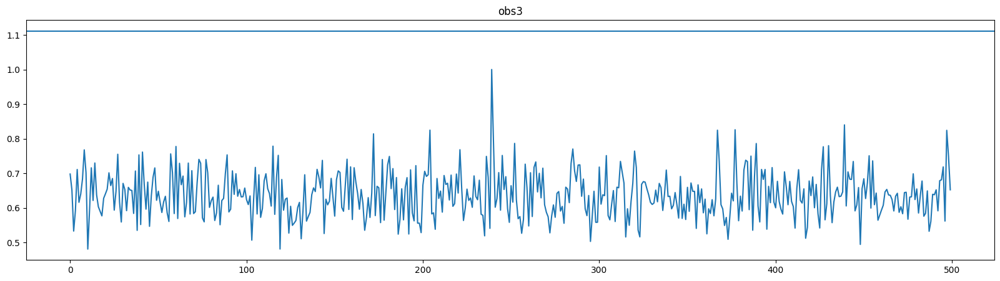

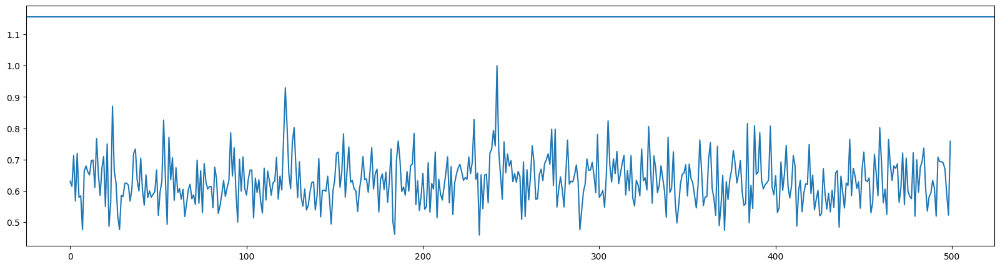

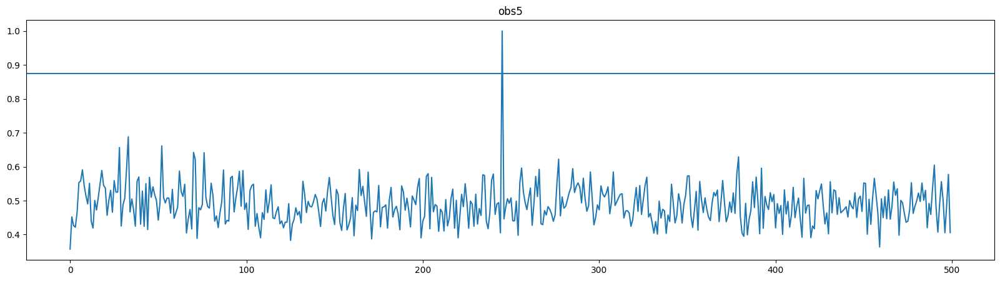

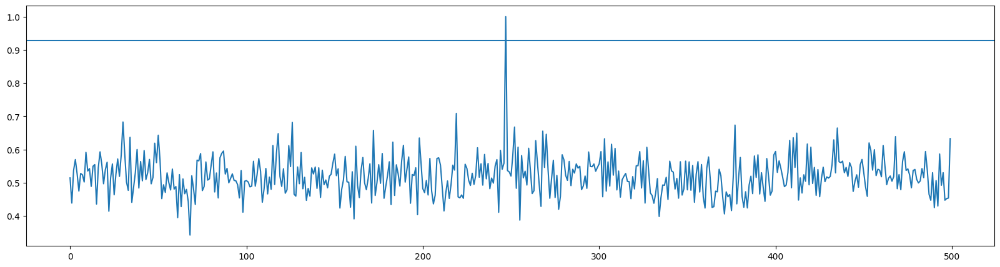

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7617.120756302029
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25714000 25714500


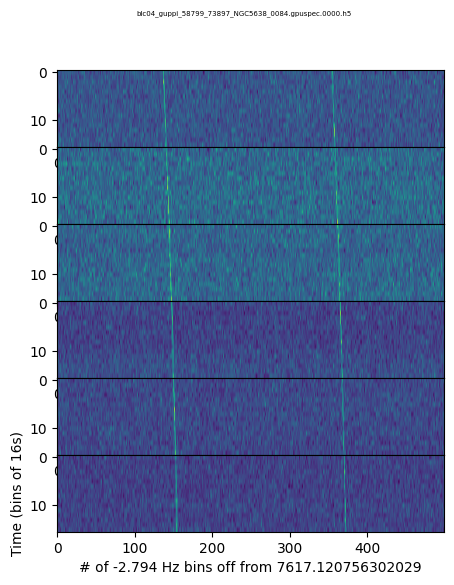

broadband False


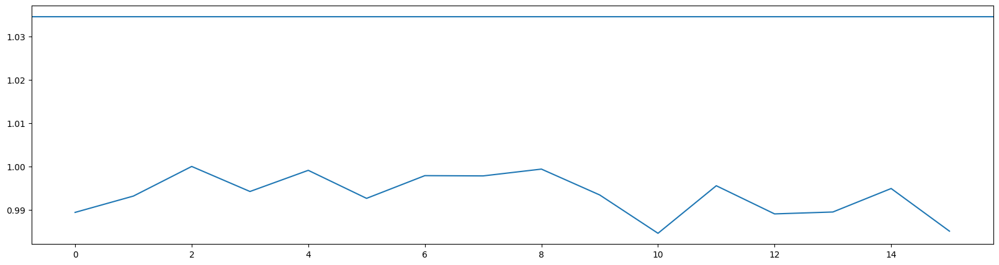

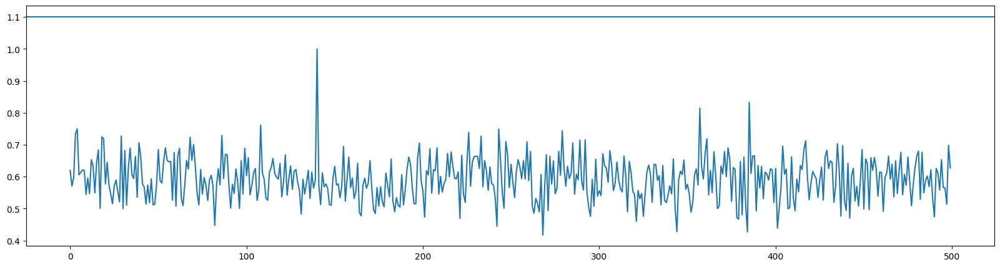

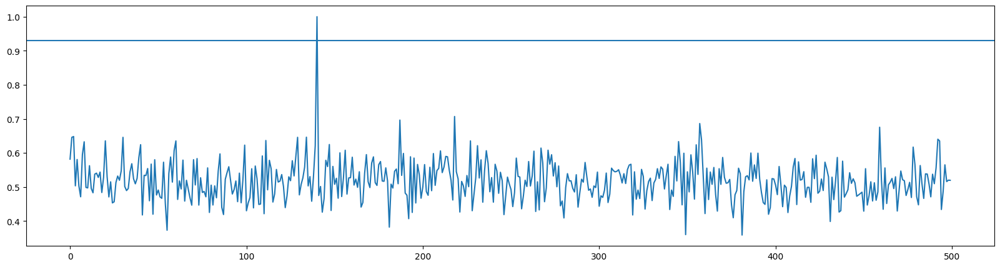

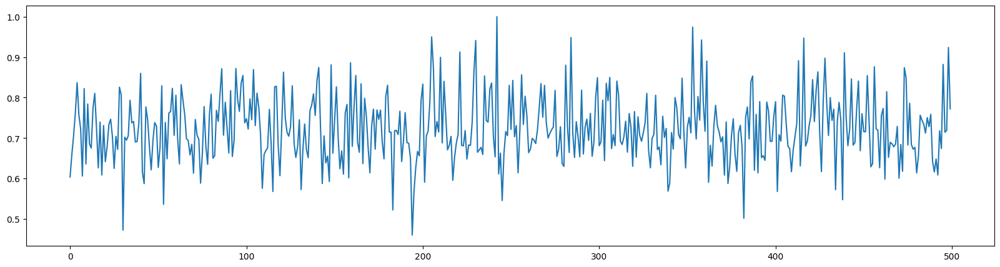

#: 0


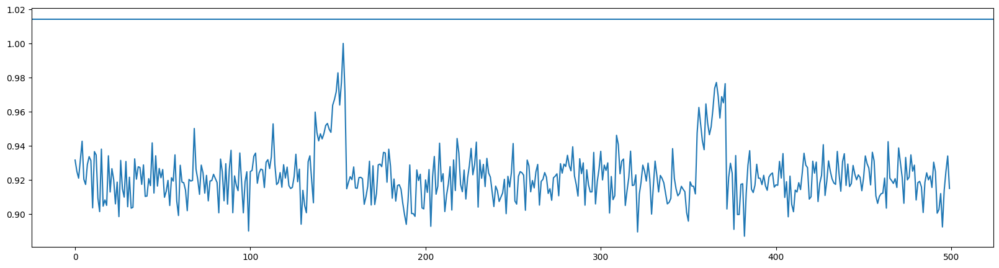

Checking Drift
16 16
[[0.47935635 0.52326477 0.5604544  ... 0.5708969  0.7334922  0.6130513 ]
 [0.5975155  0.52421165 0.6241034  ... 0.4708048  0.6086769  0.5488475 ]
 [0.5659091  0.7339105  0.5165251  ... 0.534747   0.52319723 0.5019594 ]
 ...
 [0.43166336 0.5035668  0.57545286 ... 0.7273516  0.5477423  0.5300452 ]
 [0.6468776  0.4871698  0.7111059  ... 0.53129447 0.5531284  0.62803245]
 [0.618776   0.78578126 0.6810816  ... 0.5502502  0.6281195  0.5917484 ]]
50
[[8.49398661e+10 8.88406344e+10 1.17196325e+11 ... 7.70893169e+10
  7.13283830e+10 7.15129324e+10]
 [8.19748454e+10 6.95780065e+10 8.12052644e+10 ... 9.58974607e+10
  7.78601513e+10 6.65096602e+10]
 [5.62932449e+10 6.97673155e+10 7.58540042e+10 ... 8.48404562e+10
  9.39107123e+10 6.24482918e+10]
 ...
 [9.18404956e+10 1.08178653e+11 9.07103519e+10 ... 6.88181576e+10
  7.89101609e+10 7.87947192e+10]
 [7.43474053e+10 8.10259497e+10 6.95515546e+10 ... 7.59234478e+10
  9.14991350e+10 8.67150152e+10]
 [7.46759291e+10 8.21227602e+10 

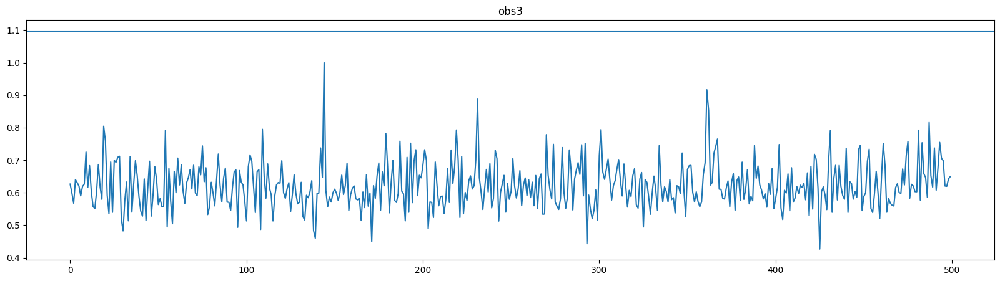

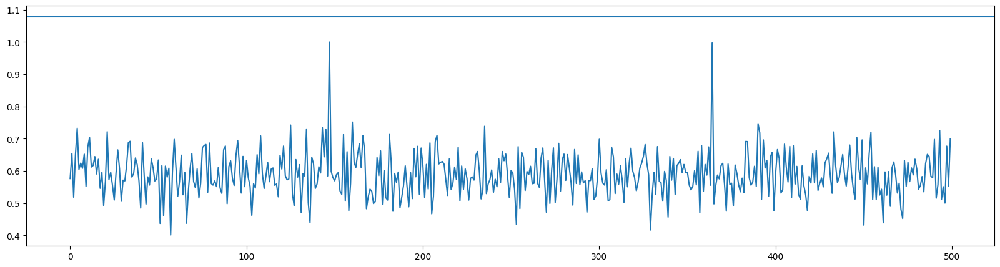

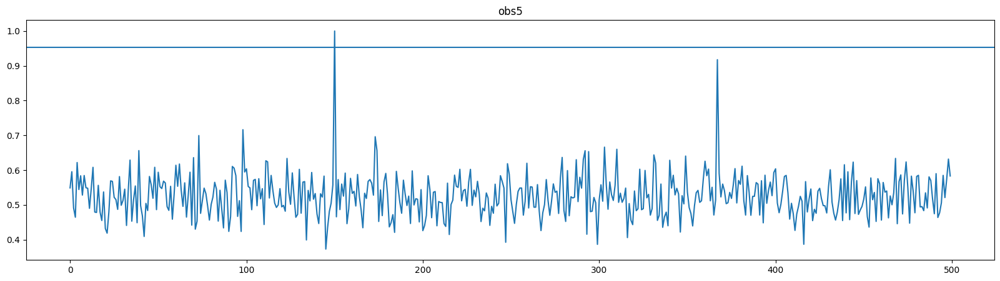

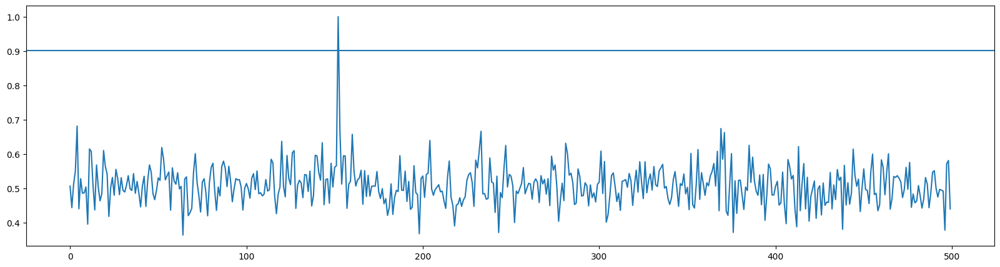

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7617.105389479548
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25719500 25720000


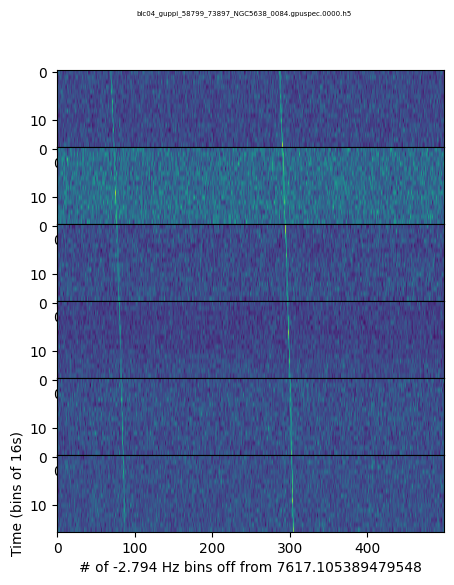

broadband False


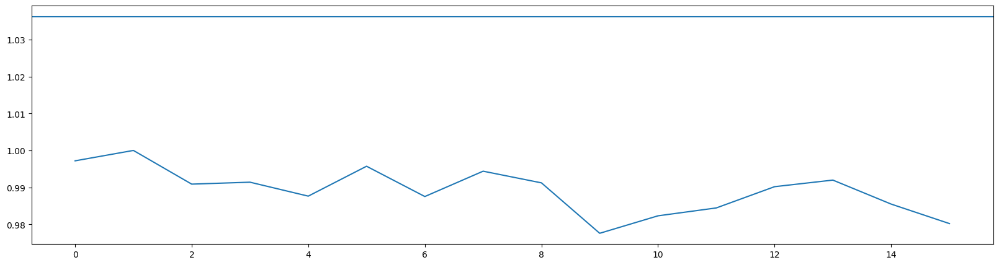

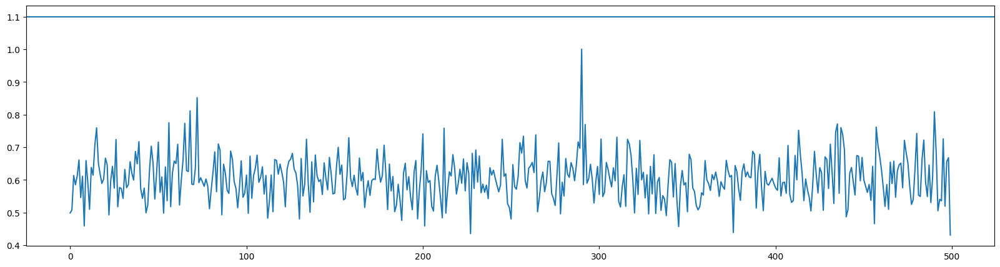

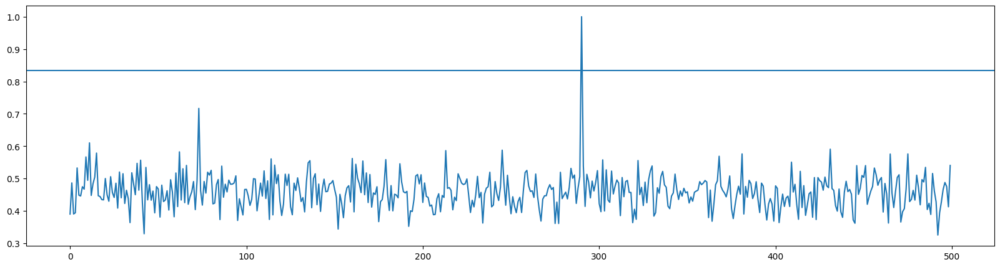

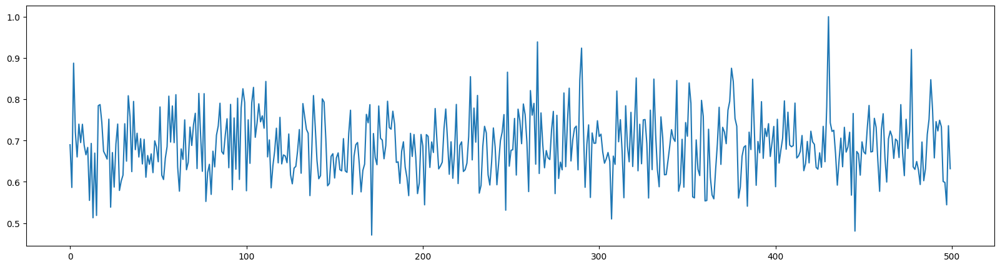

#: 0


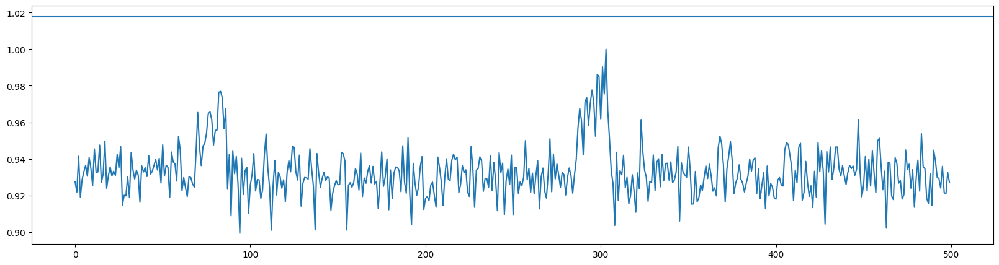

Checking Drift
16 16
[[0.5920517  0.50330245 0.76176363 ... 0.46722043 0.63168555 0.5423467 ]
 [0.53932637 0.50536746 0.6538443  ... 0.67019254 0.6071179  0.62608206]
 [0.53077006 0.6616109  0.65870947 ... 0.5940646  0.57254004 0.52405405]
 ...
 [0.5772814  0.5618355  0.61674905 ... 0.5332034  0.61267775 0.5377805 ]
 [0.6732953  0.6468717  0.64355886 ... 0.5277055  0.5269756  0.5716457 ]
 [0.6011376  0.62982255 0.5590218  ... 0.6033799  0.5855497  0.57858235]]
50
[[7.8940275e+10 9.0364494e+10 7.4530431e+10 ... 5.7249272e+10
  6.9462688e+10 7.9546917e+10]
 [8.6779716e+10 8.5886239e+10 8.0975340e+10 ... 8.3274236e+10
  6.9099569e+10 8.7401832e+10]
 [8.7327302e+10 6.9411037e+10 8.2951086e+10 ... 7.8463369e+10
  7.7339795e+10 7.7995827e+10]
 ...
 [7.7260644e+10 6.6648179e+10 7.8006370e+10 ... 7.9514632e+10
  7.6511093e+10 6.4747405e+10]
 [8.4083687e+10 8.2509709e+10 6.9869126e+10 ... 9.5046509e+10
  7.1319503e+10 7.7808820e+10]
 [9.4480499e+10 7.6031836e+10 7.3379906e+10 ... 7.9413862e+10


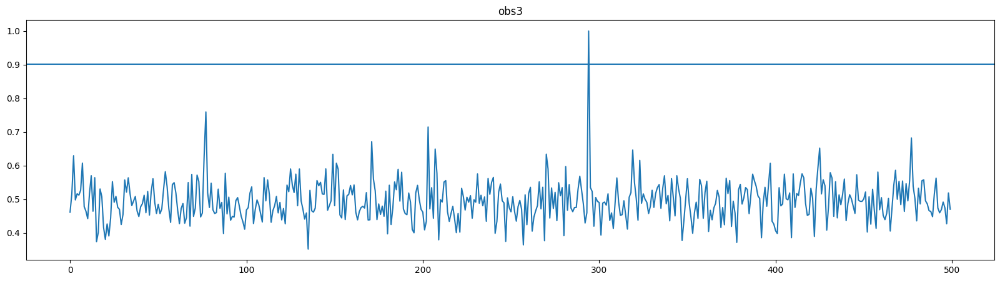

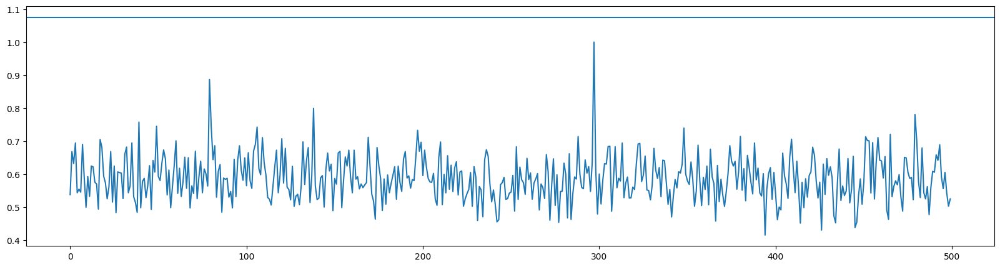

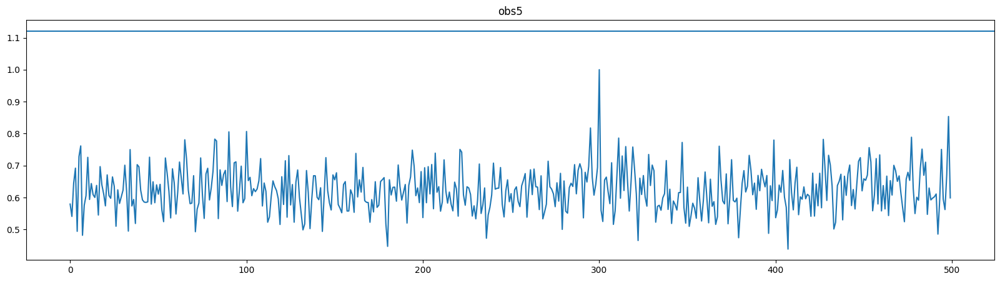

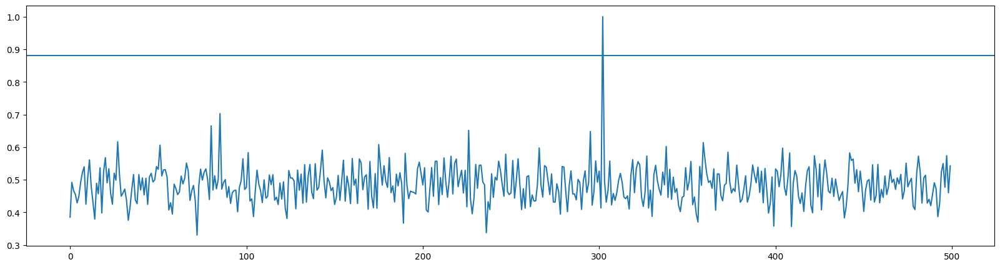

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7616.996424738318
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25758500 25759000


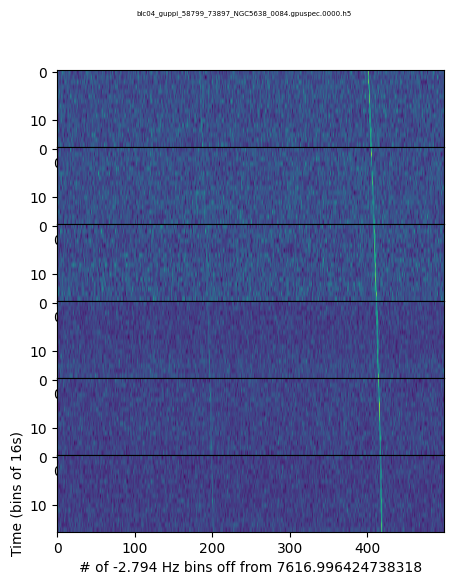

broadband False


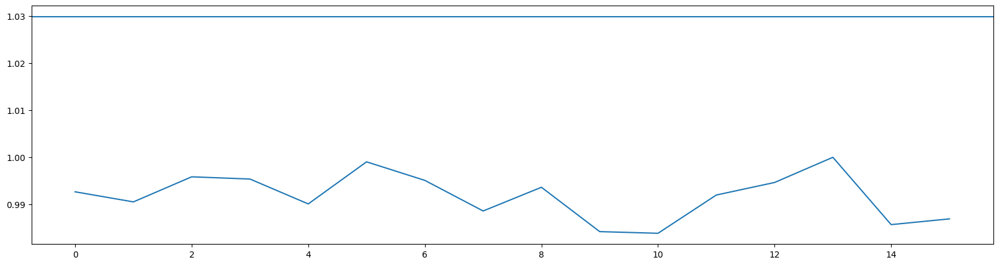

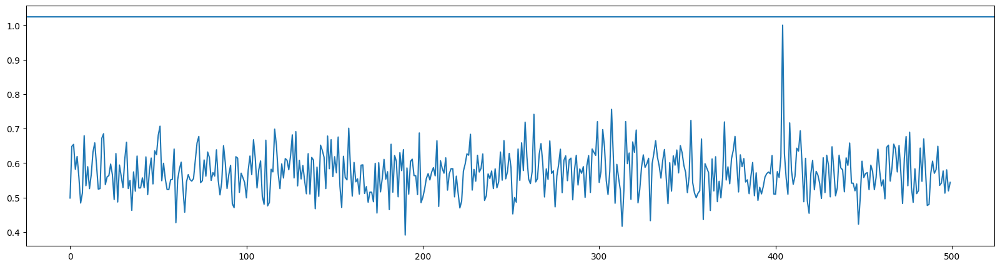

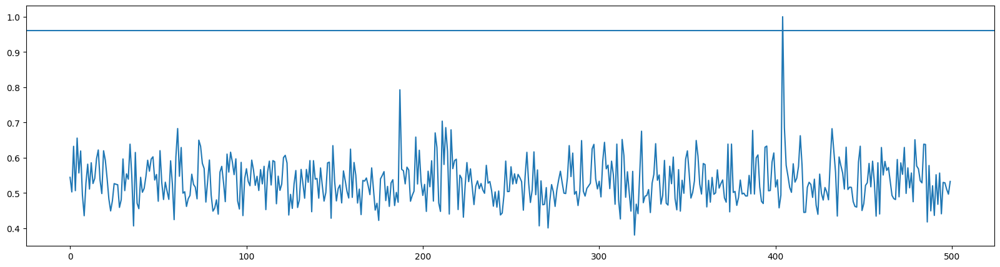

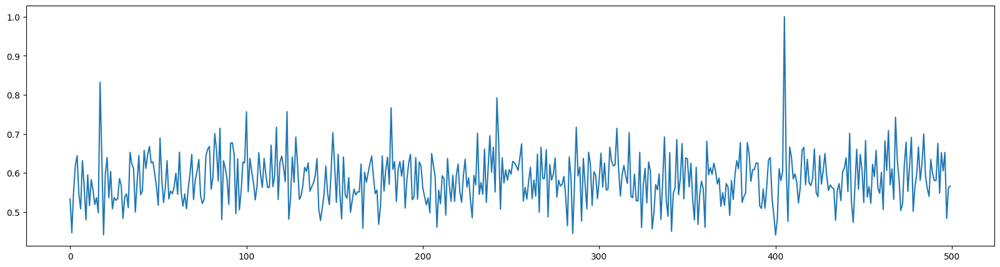

#: 3


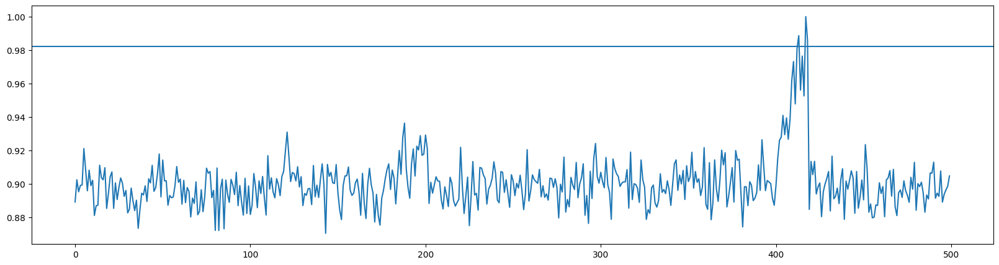

Checking Drift
16 16
[[0.43770248 0.36661437 0.45428318 ... 0.3967722  0.46100178 0.46451244]
 [0.45615256 0.43597075 0.5055866  ... 0.5234821  0.38439614 0.46925852]
 [0.50692654 0.41382602 0.46078148 ... 0.48352852 0.48470291 0.5250943 ]
 ...
 [0.5082694  0.60147476 0.50867325 ... 0.4478873  0.4679352  0.5151279 ]
 [0.4978229  0.48889688 0.49515885 ... 0.4181779  0.5470317  0.45793325]
 [0.5360673  0.41808954 0.49174055 ... 0.48967826 0.44984657 0.45105618]]
50
[[7.5229389e+10 6.5997177e+10 8.7058964e+10 ... 8.8247575e+10
  8.6915531e+10 8.6301663e+10]
 [7.8209114e+10 6.6875879e+10 1.0513368e+11 ... 8.8054309e+10
  9.2563087e+10 7.2147173e+10]
 [7.7949354e+10 8.9923207e+10 8.7230693e+10 ... 7.5782447e+10
  8.7344587e+10 8.0464699e+10]
 ...
 [9.2341723e+10 7.9083463e+10 9.0436796e+10 ... 8.3418038e+10
  6.8452024e+10 1.0619625e+11]
 [8.4148142e+10 8.4594098e+10 8.0283820e+10 ... 7.6246663e+10
  7.4402087e+10 7.3361629e+10]
 [7.6151652e+10 8.2708898e+10 8.7356965e+10 ... 7.9551398e+10


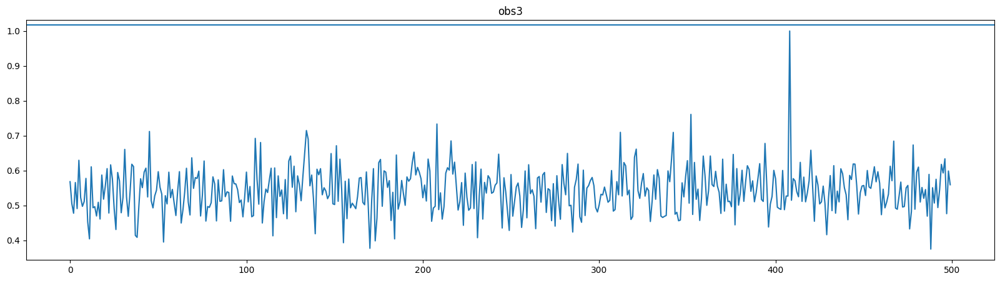

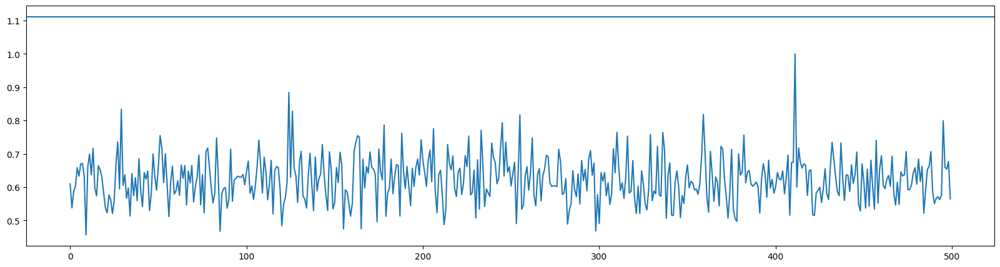

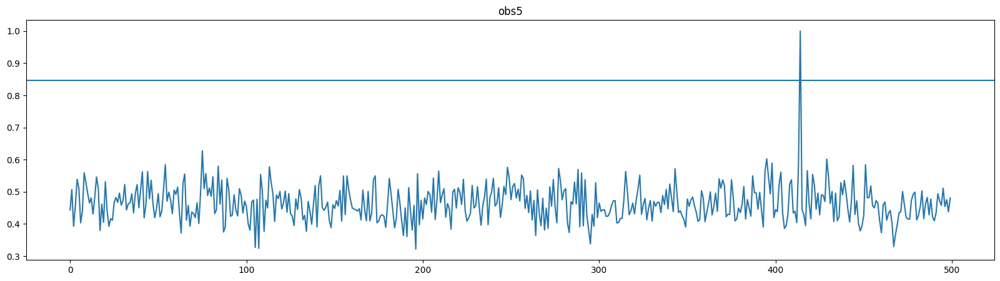

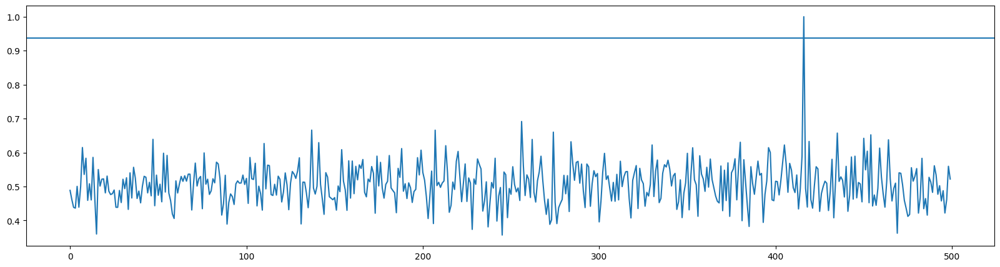

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7616.830183658749
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25818000 25818500


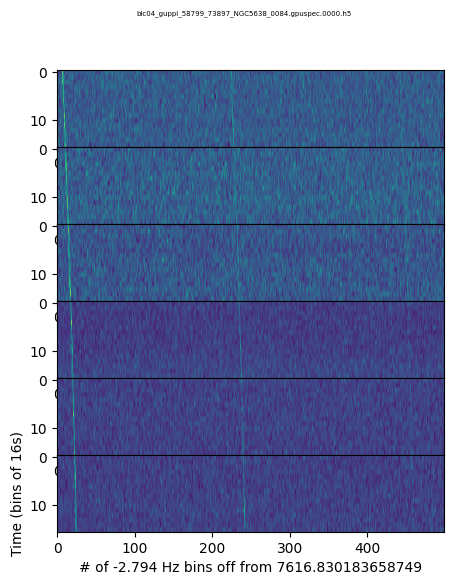

broadband False


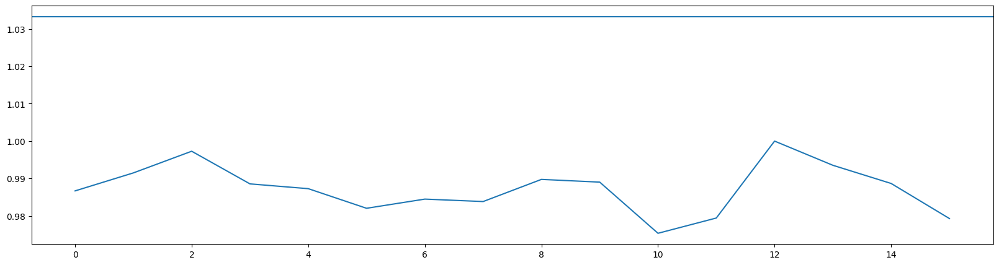

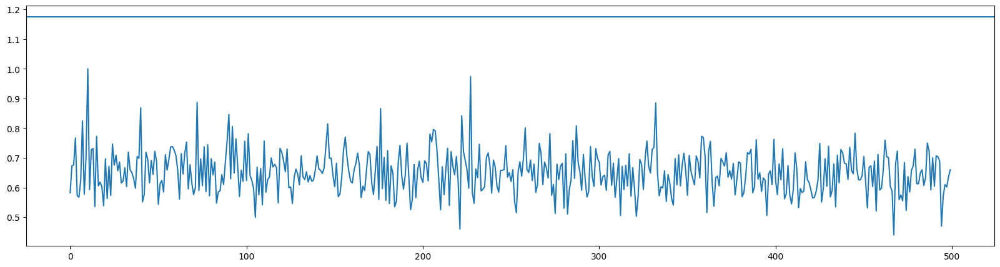

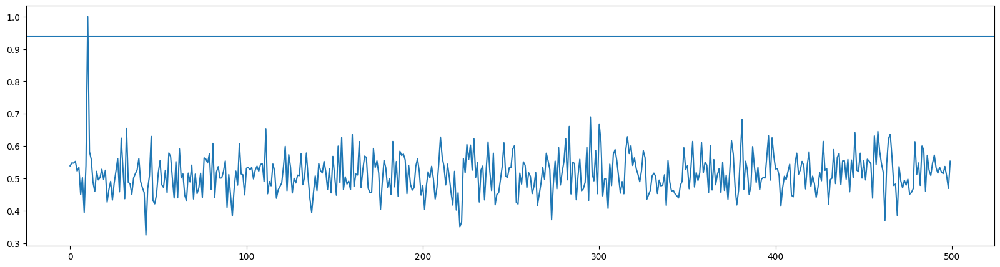

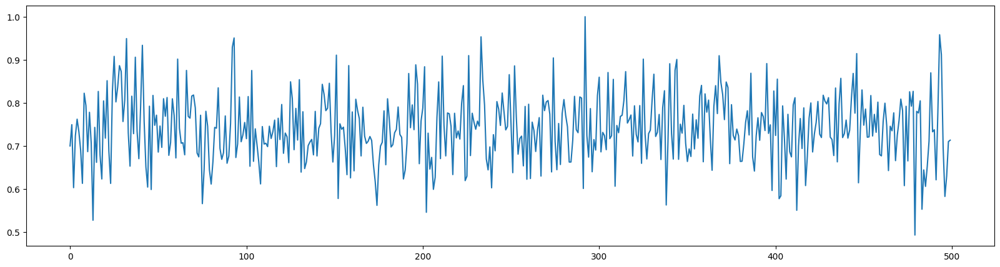

#: 0


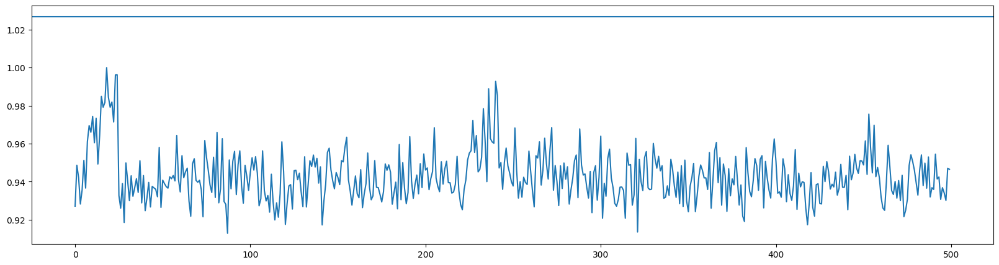

Checking Drift
16 16
[[0.5131683  0.5493775  0.44202483 ... 0.46194446 0.5205863  0.52294564]
 [0.51238084 0.7657176  0.5115078  ... 0.5993251  0.6578402  0.6189594 ]
 [0.60768884 0.6125011  0.45455098 ... 0.57282764 0.6351223  0.504872  ]
 ...
 [0.5118256  0.6101924  0.6203252  ... 0.56896245 0.6007463  0.4790995 ]
 [0.5972776  0.45124522 0.5441396  ... 0.56139565 0.64294446 0.639962  ]
 [0.57614374 0.5429055  0.59878564 ... 0.54205525 0.51099646 0.60202074]]
50
[[8.3092660e+10 8.1166066e+10 7.7012148e+10 ... 9.0326188e+10
  7.3618399e+10 7.4246308e+10]
 [8.4314235e+10 8.9317917e+10 8.2452382e+10 ... 7.9081054e+10
  6.7556221e+10 9.0578657e+10]
 [7.9083610e+10 8.4990517e+10 7.8172578e+10 ... 9.6677724e+10
  8.8810234e+10 9.5313854e+10]
 ...
 [8.5295743e+10 8.4647428e+10 9.2574138e+10 ... 7.8033928e+10
  7.2349401e+10 7.7999907e+10]
 [7.6835897e+10 7.7859537e+10 8.4020797e+10 ... 8.8969617e+10
  7.0257639e+10 8.5654905e+10]
 [7.8578893e+10 7.3694577e+10 9.8288345e+10 ... 8.3740443e+10


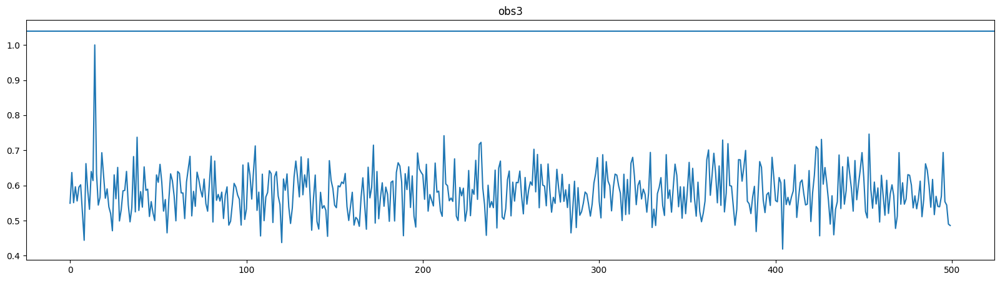

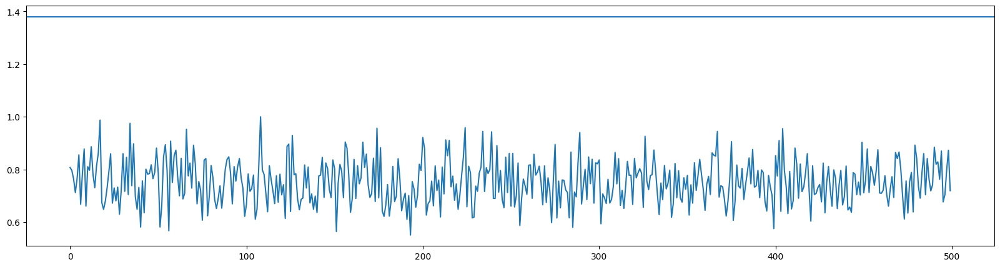

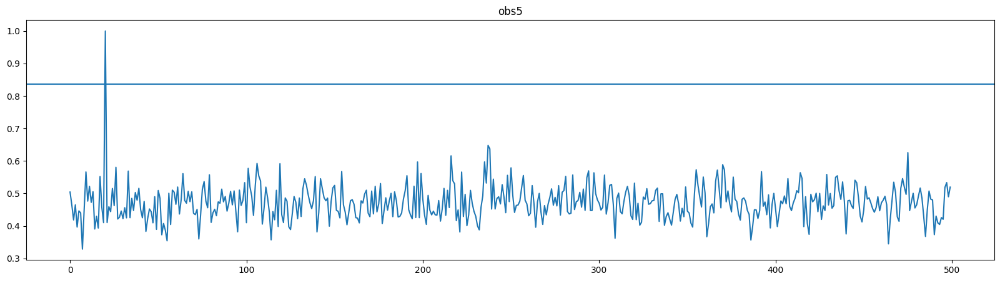

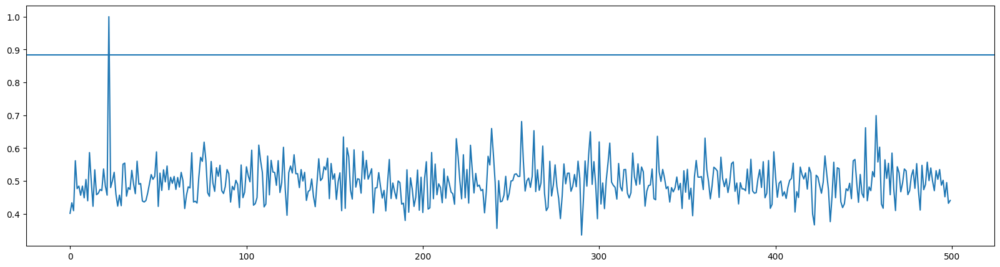

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7616.754746530205
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25845000 25845500


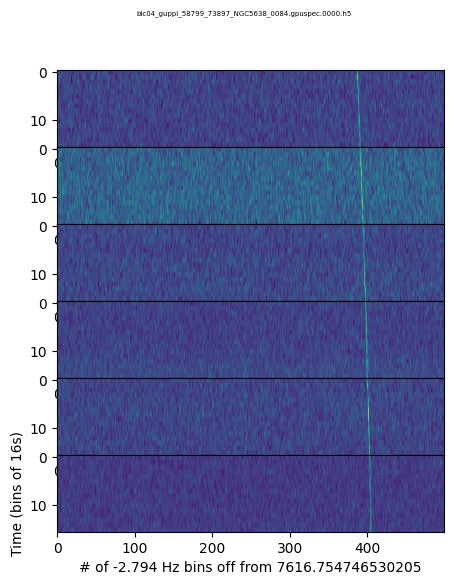

broadband False


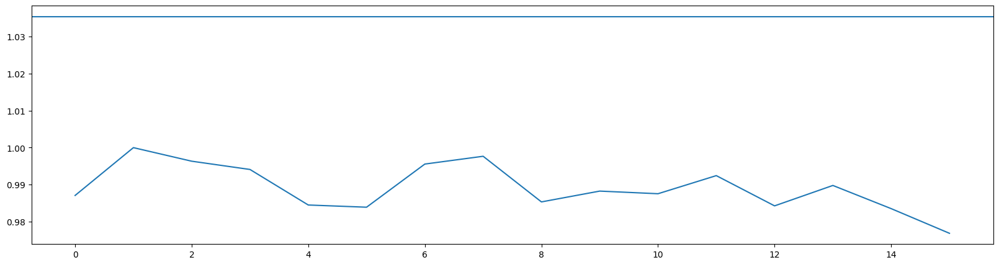

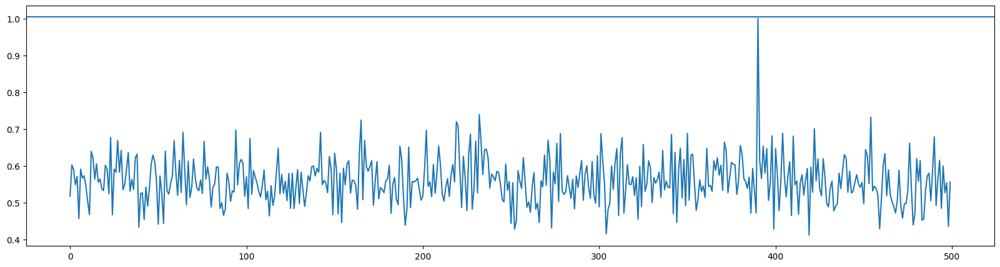

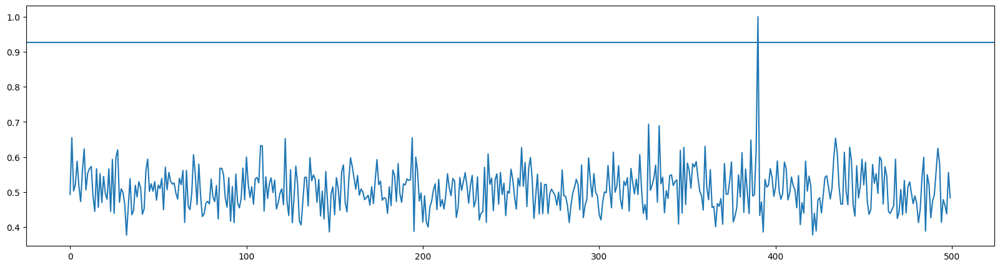

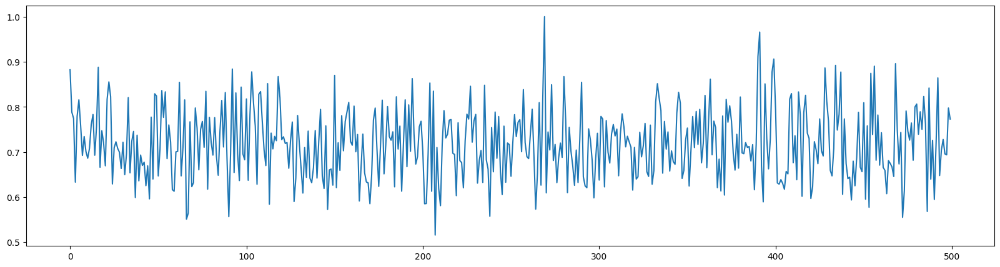

#: 0


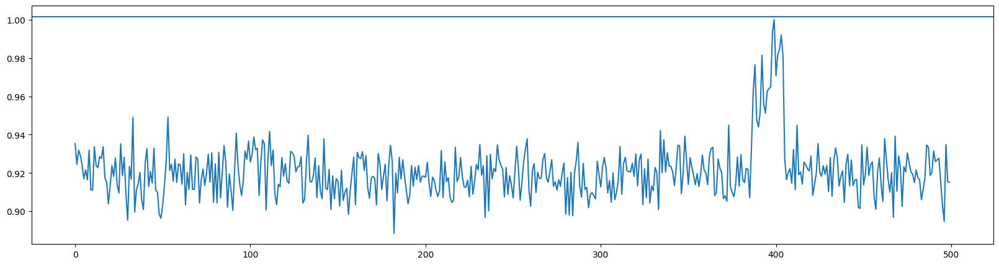

Checking Drift
16 16
[[0.688101   0.6148335  0.60393816 ... 0.5410614  0.6219782  0.60290414]
 [0.50619894 0.5359529  0.54279894 ... 0.6468702  0.46009192 0.60098046]
 [0.6040919  0.6028047  0.64622015 ... 0.5820902  0.5102738  0.45705533]
 ...
 [0.5713036  0.49878186 0.64820266 ... 0.5781574  0.533405   0.5958975 ]
 [0.5372859  0.49450234 0.47734112 ... 0.47447988 0.70709795 0.5811367 ]
 [0.65651107 0.5970467  0.49196273 ... 0.70960486 0.5534767  0.49428067]]
50
[[7.9428207e+10 7.9353225e+10 9.0093412e+10 ... 6.0533105e+10
  7.8174978e+10 7.7821846e+10]
 [7.5016012e+10 7.8241104e+10 8.5543420e+10 ... 9.6382689e+10
  7.3069822e+10 7.8889017e+10]
 [8.8500593e+10 7.5058373e+10 8.1683374e+10 ... 8.9793192e+10
  8.6886179e+10 8.4820681e+10]
 ...
 [9.4525309e+10 6.9204730e+10 8.2092278e+10 ... 8.3183346e+10
  8.2220417e+10 8.0315621e+10]
 [9.6892232e+10 7.4879975e+10 9.2666159e+10 ... 6.6935648e+10
  9.8024899e+10 8.1195401e+10]
 [8.4176585e+10 8.1579885e+10 8.4615389e+10 ... 9.5959138e+10


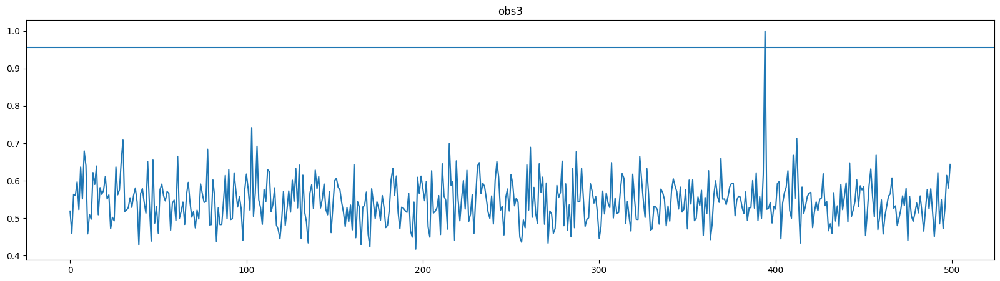

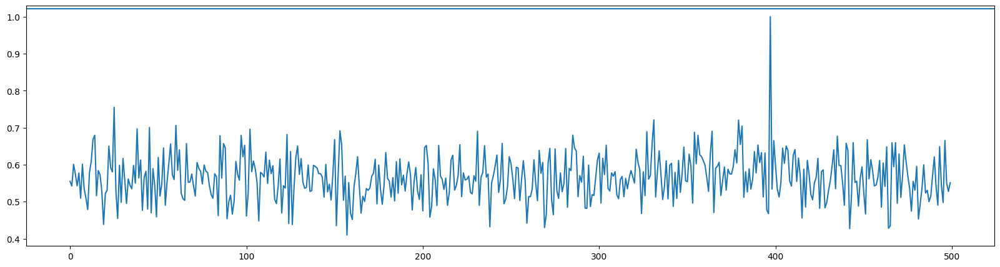

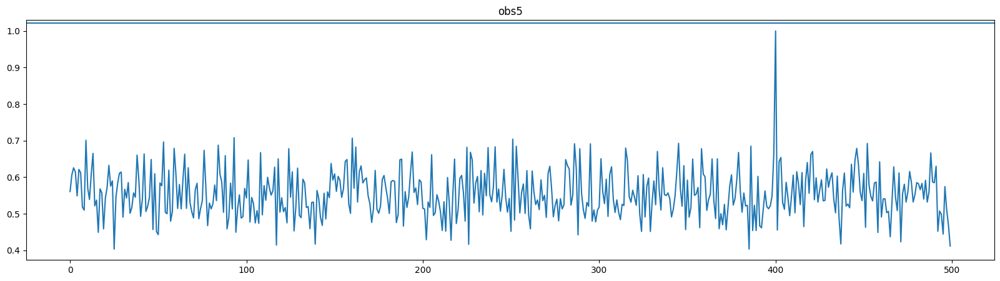

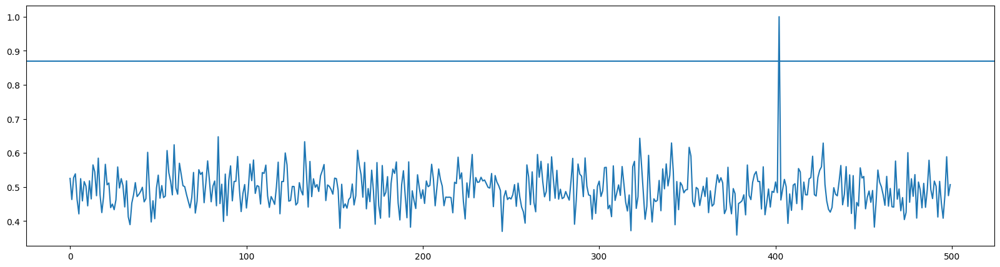

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc04_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7616.696073208004
hf <HDF5 file "blc04_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7688.9648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7595.2148423530 src_raj 14.4945400000 src_raj_degs 217.4181000000 src_dej 3.2335000000 target NGC5638
25866000 25866500


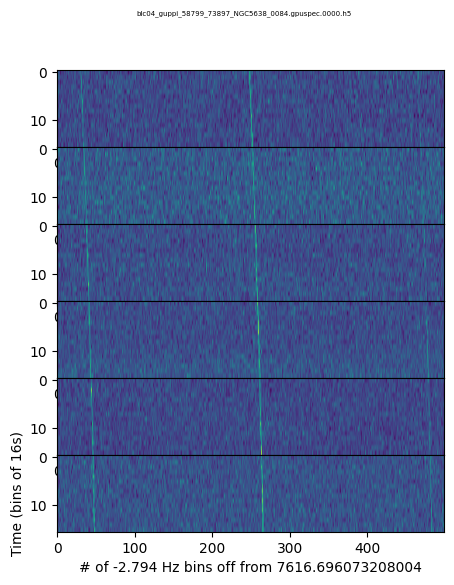

broadband False


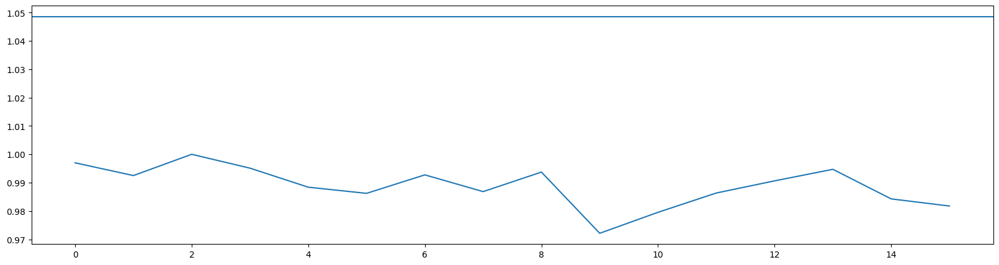

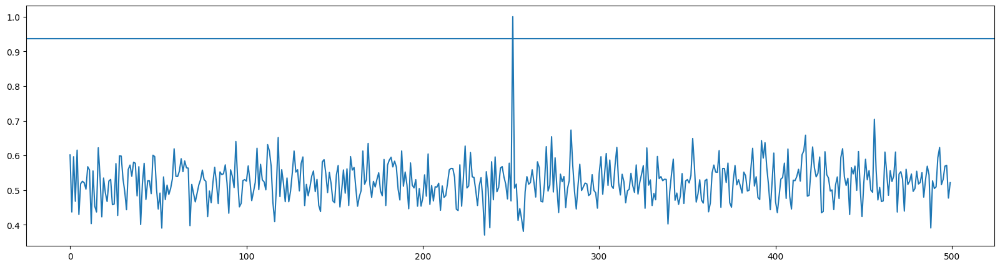

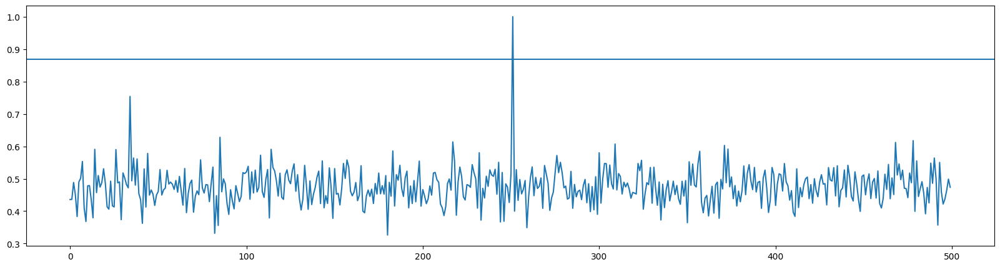

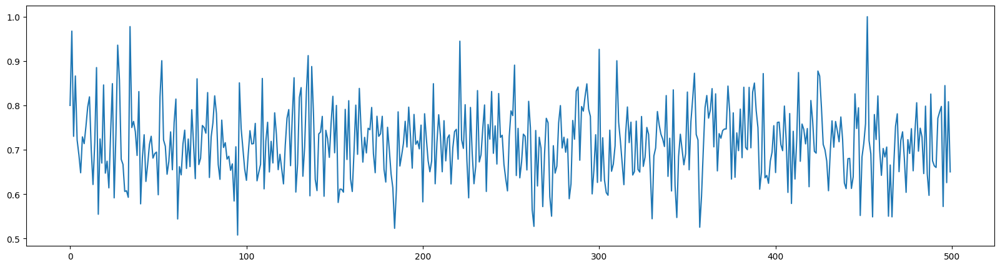

#: 0


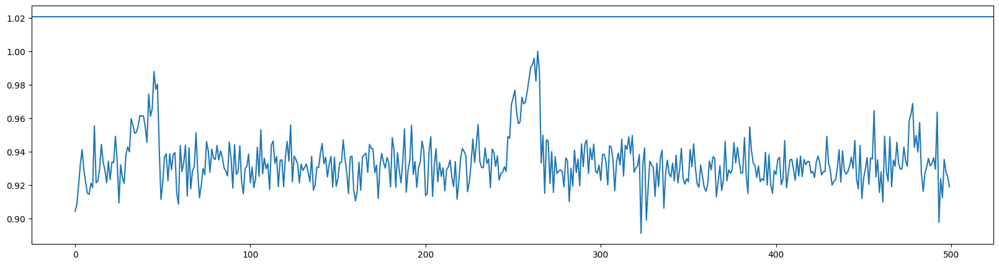

Checking Drift
16 16
[[0.59899384 0.7243449  0.5468538  ... 0.46871892 0.6052501  0.48690796]
 [0.5647247  0.51716006 0.601562   ... 0.5529502  0.6320196  0.5167203 ]
 [0.436426   0.45274854 0.5484626  ... 0.6030775  0.46339273 0.5874038 ]
 ...
 [0.5923148  0.5732955  0.5723946  ... 0.4690287  0.5351081  0.5056402 ]
 [0.5640502  0.64377564 0.53798497 ... 0.57431597 0.55801237 0.58079255]
 [0.5566323  0.5230653  0.57053155 ... 0.6337237  0.4846934  0.49475366]]
50
[[8.9613418e+10 8.1638351e+10 6.6724458e+10 ... 9.0891575e+10
  8.7436599e+10 7.8467932e+10]
 [8.5583340e+10 8.6803456e+10 6.2122648e+10 ... 1.0660333e+11
  7.4270458e+10 7.3235235e+10]
 [8.9778225e+10 6.5431392e+10 7.2900002e+10 ... 7.9846670e+10
  7.3513198e+10 6.6997666e+10]
 ...
 [8.2712437e+10 7.3964356e+10 7.1304061e+10 ... 8.6471885e+10
  7.7664608e+10 9.5153562e+10]
 [7.1152714e+10 9.7157505e+10 8.1926799e+10 ... 8.0440664e+10
  8.4108984e+10 8.5961802e+10]
 [8.3219489e+10 7.3593676e+10 8.3142689e+10 ... 6.8799996e+10


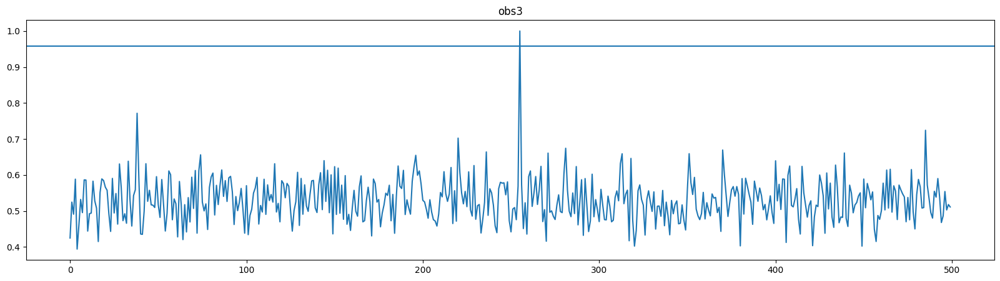

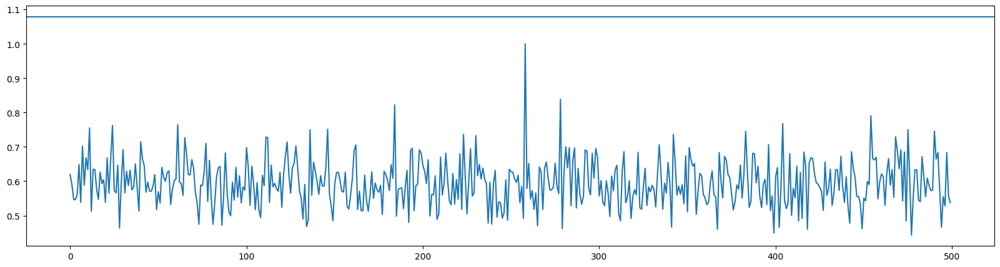

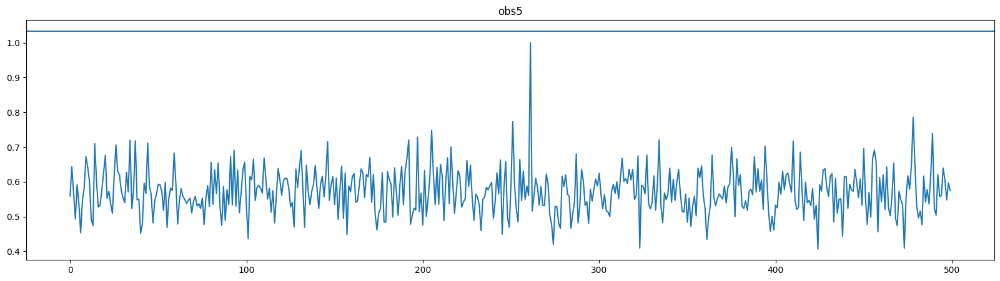

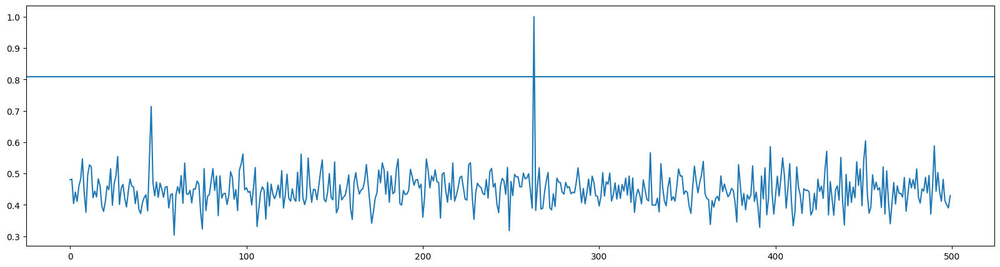

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc05_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7439.374497625977
hf <HDF5 file "blc05_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7501.4648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7407.7148423530 src_raj 14.4945466667 src_raj_degs 217.4182000000 src_dej 3.2333000000 target NGC5638
22223000 22223500


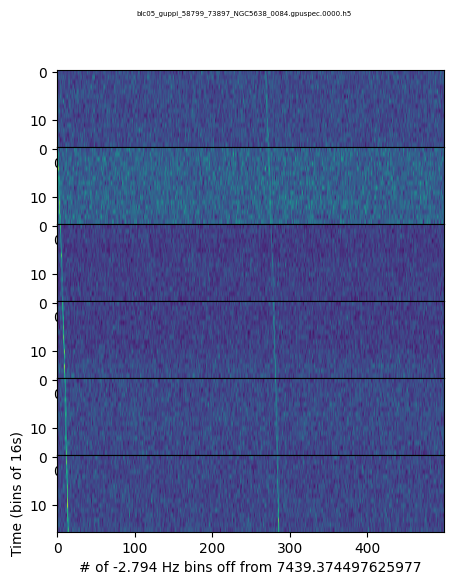

broadband False


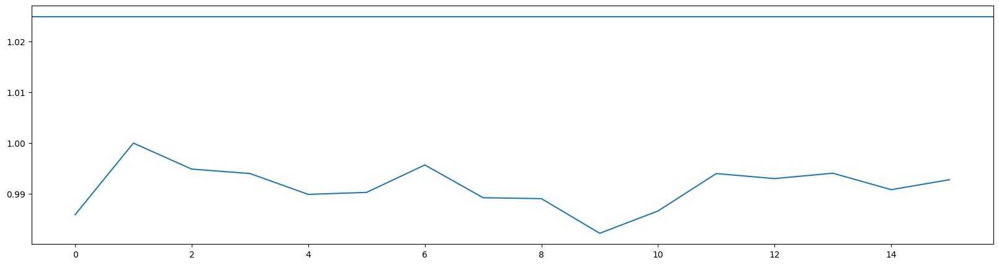

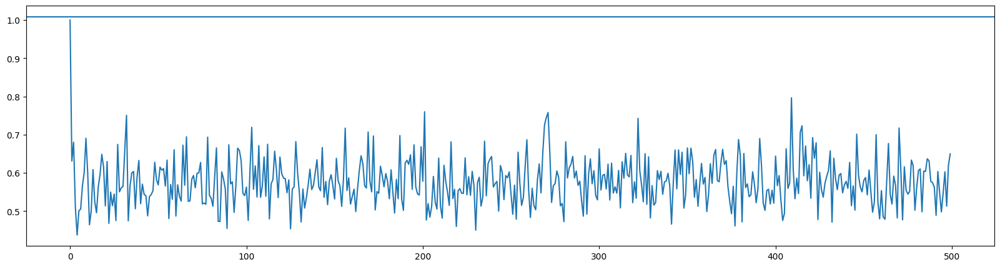

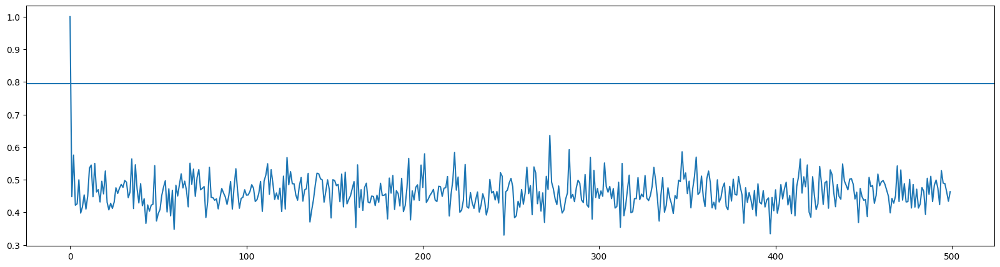

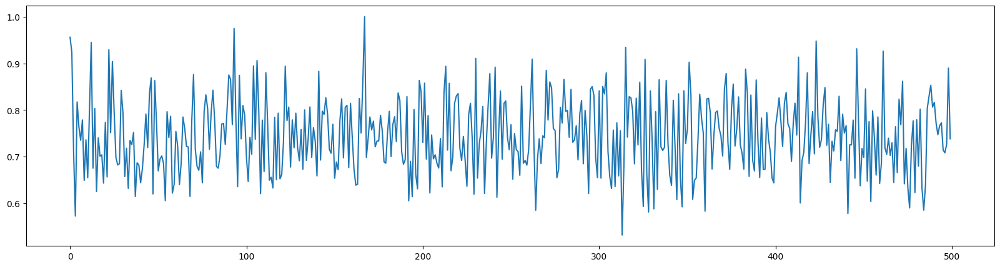

#: 0


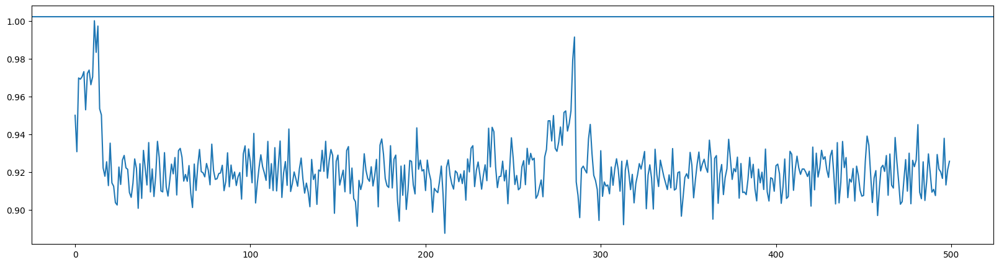

Checking Drift
16 16
[[0.70086807 0.67714435 0.5215164  ... 0.5329574  0.65236336 0.5413608 ]
 [0.6985346  0.7626886  0.5433141  ... 0.5025715  0.56094146 0.5582071 ]
 [0.66130143 0.80005985 0.47146204 ... 0.66807604 0.48214242 0.53746825]
 ...
 [0.48354626 0.60347354 0.5956469  ... 0.53408283 0.574843   0.5026467 ]
 [0.6215282  0.48715472 0.51943666 ... 0.5501279  0.58197993 0.52158165]
 [0.5262266  0.5673466  0.59704787 ... 0.50682425 0.497846   0.5286999 ]]
50
[[4.1731936e+10 4.6415499e+10 4.6727885e+10 ... 4.3139437e+10
  5.1334586e+10 4.4053774e+10]
 [4.0613323e+10 4.5869646e+10 5.0319204e+10 ... 4.4981551e+10
  3.9358079e+10 4.3419337e+10]
 [4.8544371e+10 4.4444824e+10 4.0508273e+10 ... 4.8093667e+10
  4.7899054e+10 5.2994310e+10]
 ...
 [5.0623410e+10 4.1128632e+10 4.0571711e+10 ... 5.0118365e+10
  4.6923219e+10 4.1088979e+10]
 [3.7784437e+10 4.6171288e+10 5.1131281e+10 ... 6.8298801e+10
  4.2425823e+10 3.7977985e+10]
 [5.0401120e+10 5.0456076e+10 5.1867263e+10 ... 7.2761491e+10


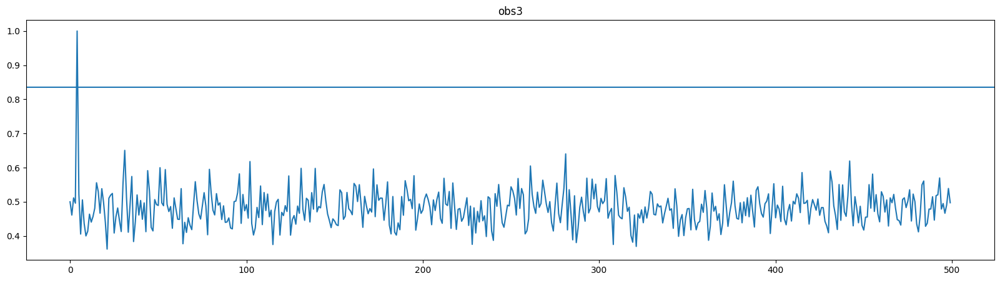

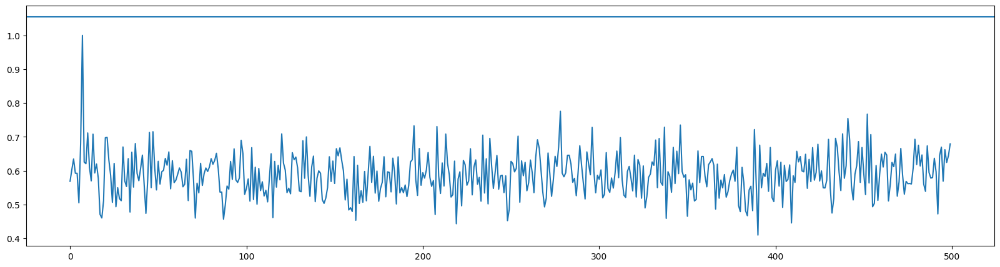

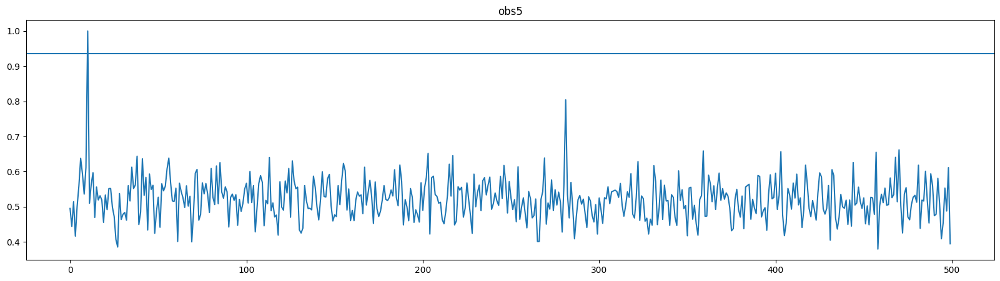

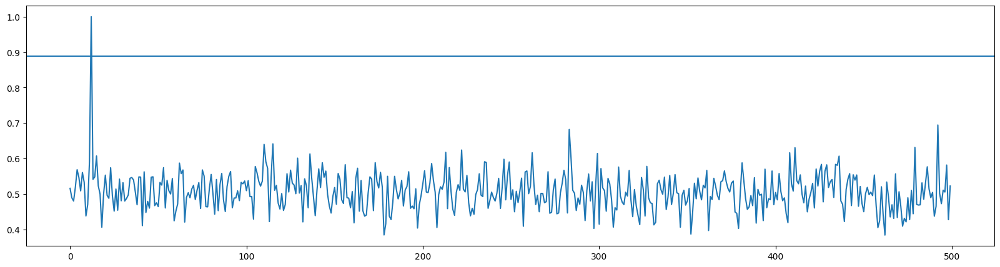

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc05_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7439.262738917023
hf <HDF5 file "blc05_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7501.4648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7407.7148423530 src_raj 14.4945466667 src_raj_degs 217.4182000000 src_dej 3.2333000000 target NGC5638
22263000 22263500


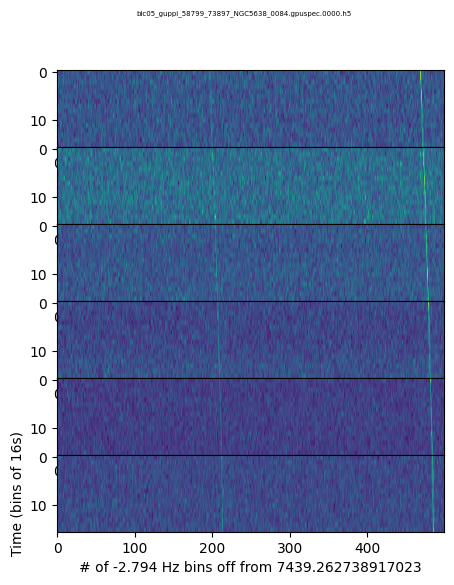

broadband False


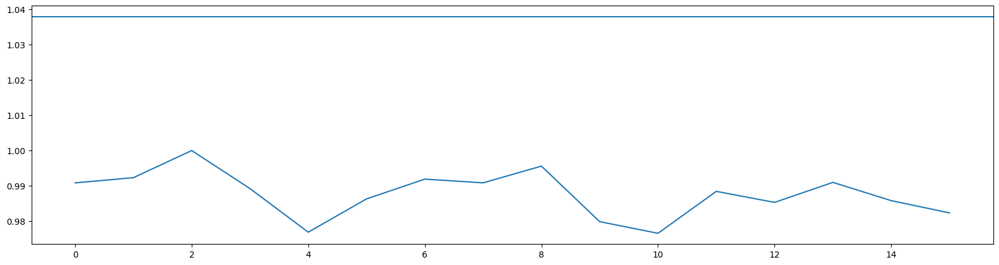

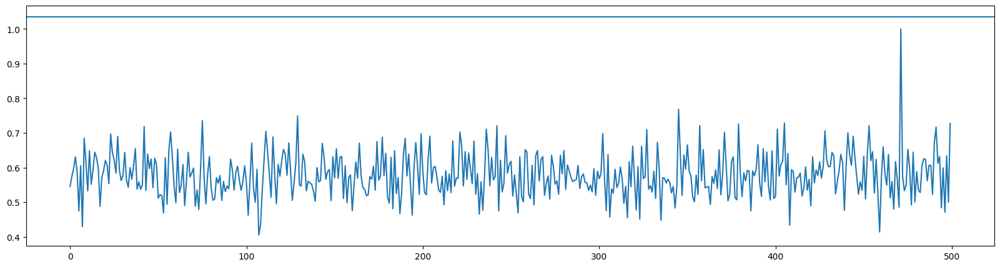

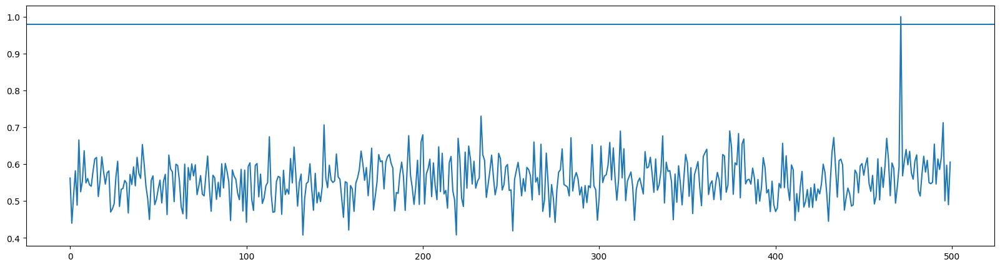

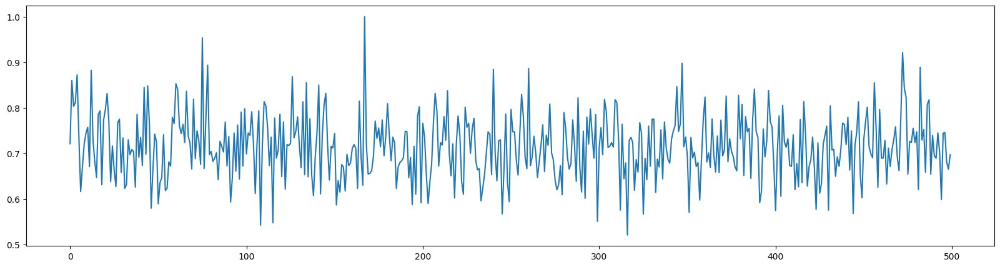

#: 1


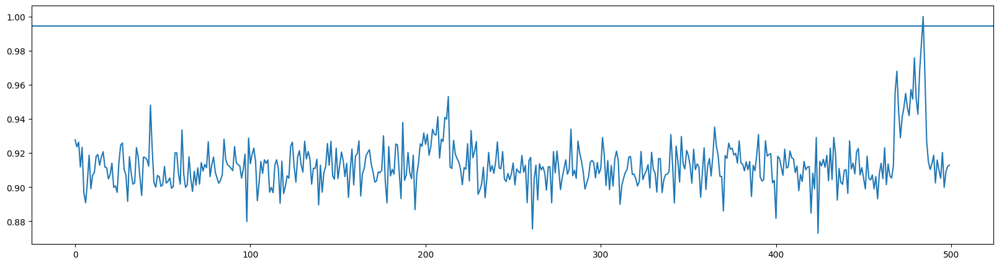

Checking Drift
16 16
[[0.5909575  0.7047382  0.6581154  ... 0.5576124  0.54508626 0.5709041 ]
 [0.66151947 0.5391126  0.6663983  ... 0.62671906 0.581338   0.68112975]
 [0.5584437  0.6035221  0.61629045 ... 0.7060024  0.5560673  0.52596116]
 ...
 [0.485567   0.5125616  0.5428776  ... 0.5811754  0.5606636  0.6271782 ]
 [0.6872555  0.6226255  0.65739655 ... 0.5554191  0.5886434  0.616847  ]
 [0.6516774  0.57041574 0.55014426 ... 0.5777181  0.51487195 0.7200978 ]]
50
[[4.5446029e+10 4.1874072e+10 4.5105750e+10 ... 5.2435476e+10
  4.8352965e+10 4.6961078e+10]
 [5.4000026e+10 3.8264320e+10 4.8980484e+10 ... 4.8288481e+10
  4.6667928e+10 4.0468140e+10]
 [4.4596122e+10 4.8914792e+10 4.9672647e+10 ... 4.9849139e+10
  4.2763387e+10 3.7330838e+10]
 ...
 [4.6981009e+10 5.2093608e+10 4.9572831e+10 ... 4.1462182e+10
  4.7558214e+10 4.5602898e+10]
 [3.8389031e+10 4.6949863e+10 4.7269650e+10 ... 5.0111017e+10
  4.0177390e+10 5.1863544e+10]
 [5.3458362e+10 5.0013692e+10 4.7398650e+10 ... 4.3882795e+10


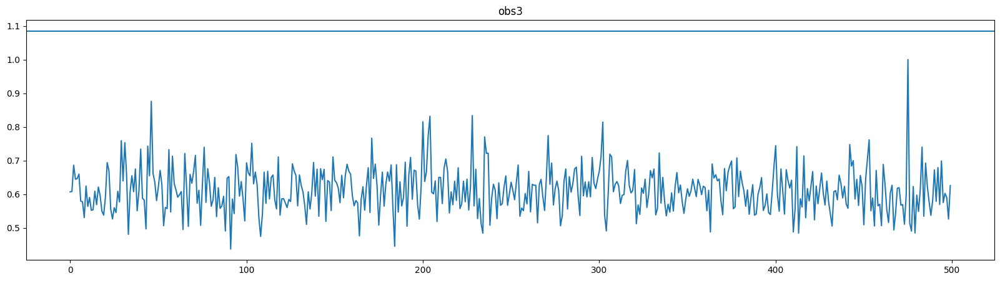

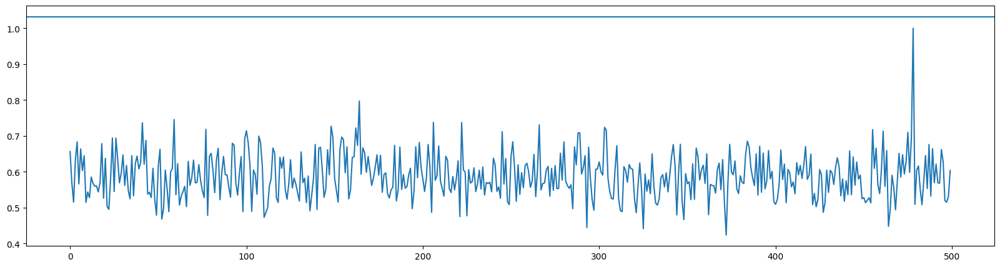

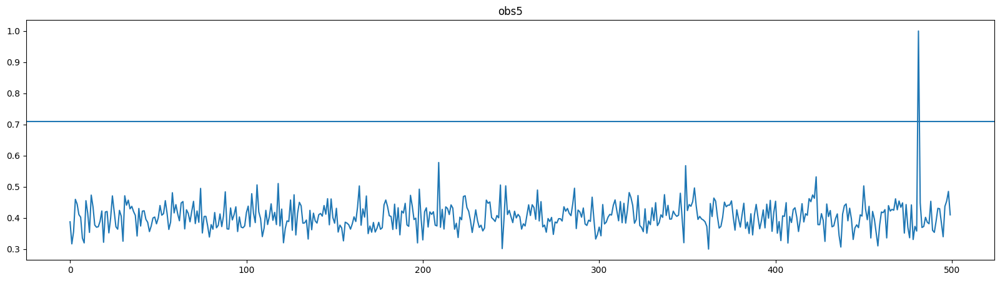

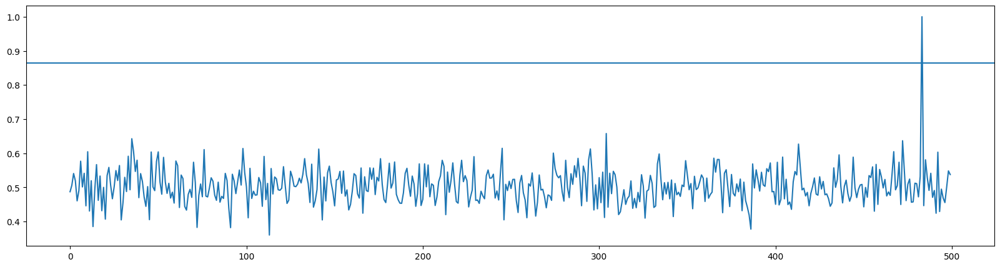

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc05_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7438.733282033354
hf <HDF5 file "blc05_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7501.4648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7407.7148423530 src_raj 14.4945466667 src_raj_degs 217.4182000000 src_dej 3.2333000000 target NGC5638
22452500 22453000


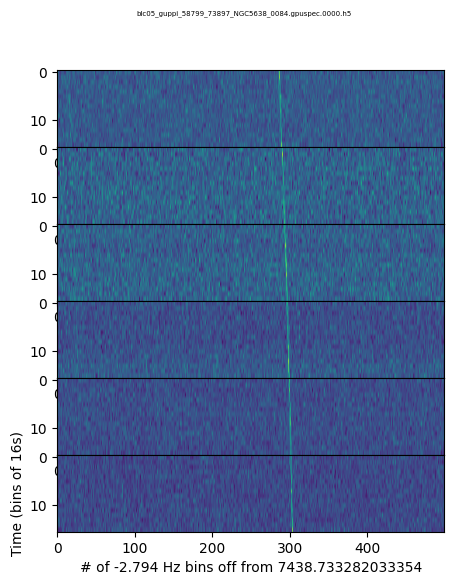

broadband False


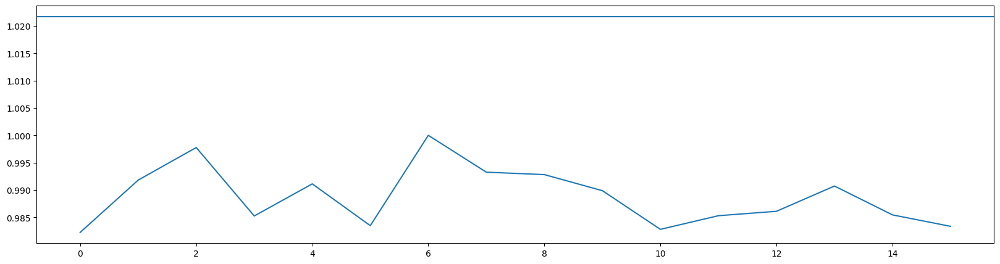

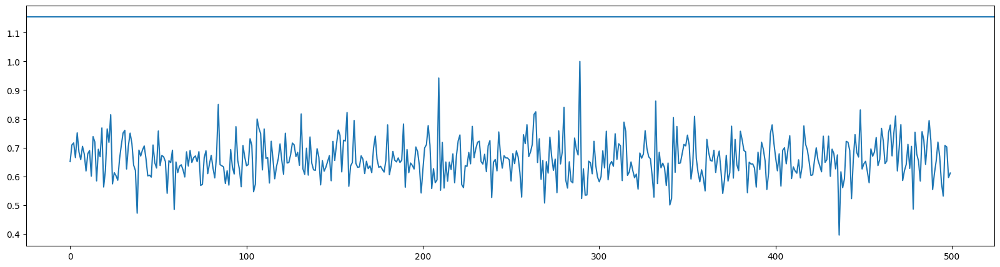

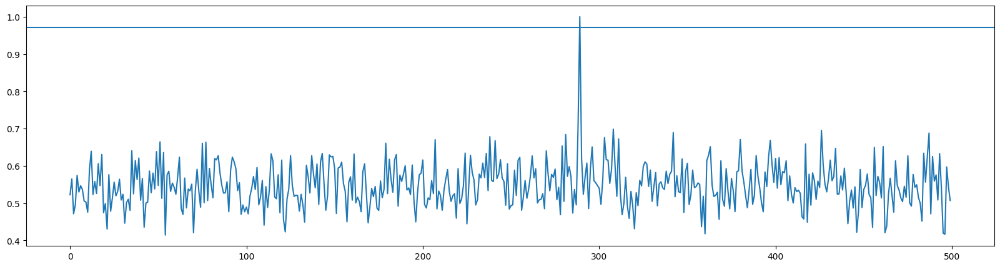

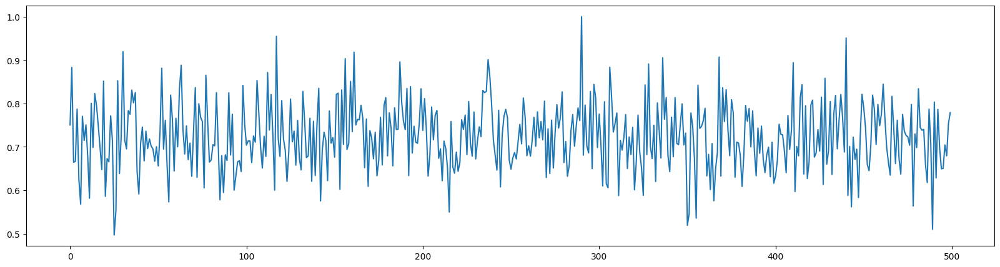

#: 0


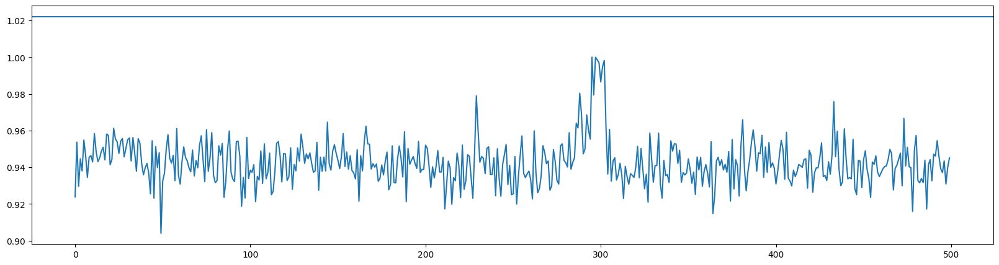

Checking Drift
16 16
[[0.6081326  0.7155257  0.53839403 ... 0.5505064  0.6104316  0.631077  ]
 [0.5729317  0.5616314  0.57354516 ... 0.5449675  0.55320764 0.61994225]
 [0.561161   0.6368052  0.67478245 ... 0.5890476  0.6387876  0.60268134]
 ...
 [0.53436637 0.629381   0.6487744  ... 0.5156474  0.68133825 0.5719526 ]
 [0.7781211  0.5749924  0.61066157 ... 0.6166755  0.5214988  0.58828604]
 [0.59451014 0.55801463 0.5518395  ... 0.62089247 0.5887211  0.7990938 ]]
50
[[4.6323745e+10 4.9352606e+10 4.2574320e+10 ... 4.9509159e+10
  4.2470175e+10 4.5069976e+10]
 [4.5694816e+10 4.6675087e+10 4.7923749e+10 ... 4.7610114e+10
  5.0893312e+10 4.4377809e+10]
 [4.2207093e+10 4.3192156e+10 4.7365837e+10 ... 5.3035770e+10
  4.5042446e+10 4.3013018e+10]
 ...
 [4.7181967e+10 4.7842390e+10 5.1919860e+10 ... 4.2304217e+10
  4.9268007e+10 4.3399934e+10]
 [3.5408183e+10 5.0593903e+10 4.5679227e+10 ... 3.7876888e+10
  4.1688609e+10 4.2533200e+10]
 [4.7065354e+10 4.4610445e+10 4.4584989e+10 ... 4.5966180e+10


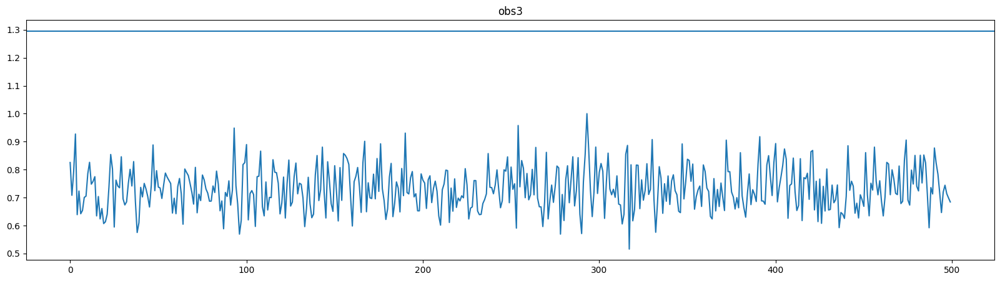

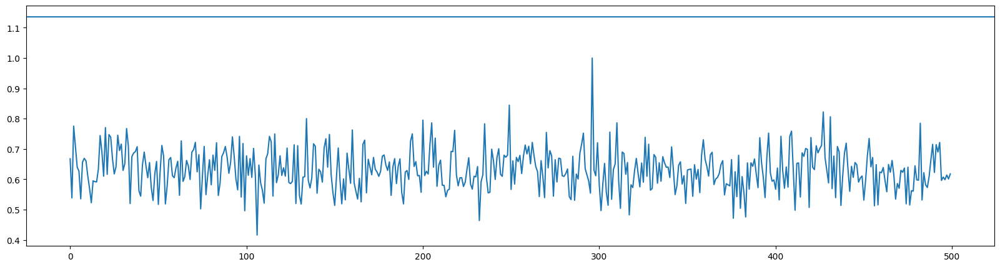

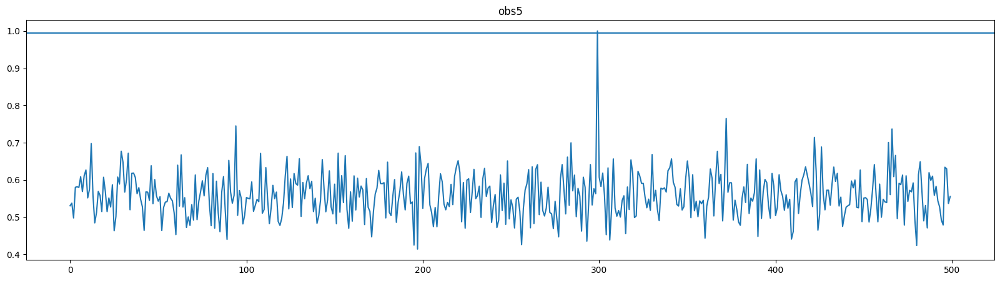

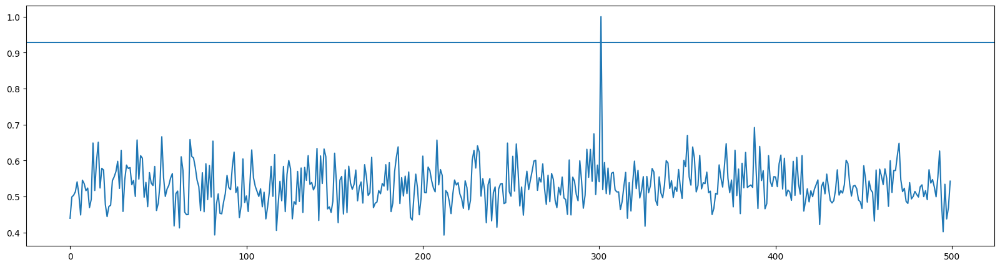

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc05_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7437.1393234469
hf <HDF5 file "blc05_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7501.4648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7407.7148423530 src_raj 14.4945466667 src_raj_degs 217.4182000000 src_dej 3.2333000000 target NGC5638
23023000 23023500


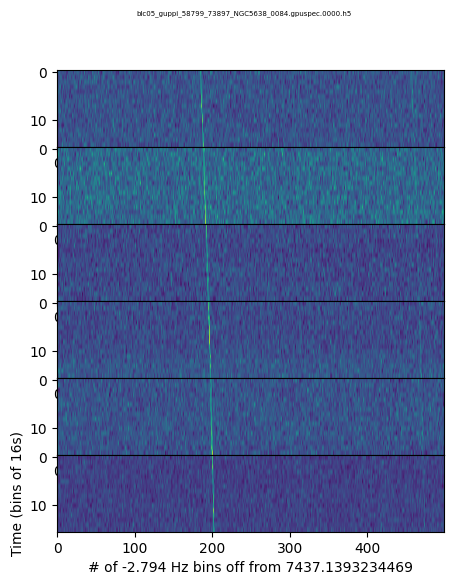

broadband False


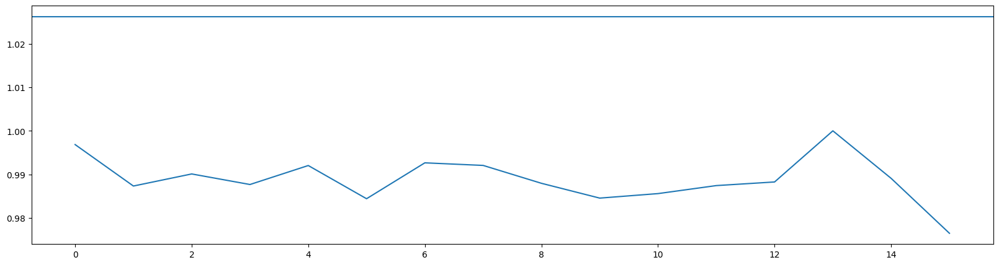

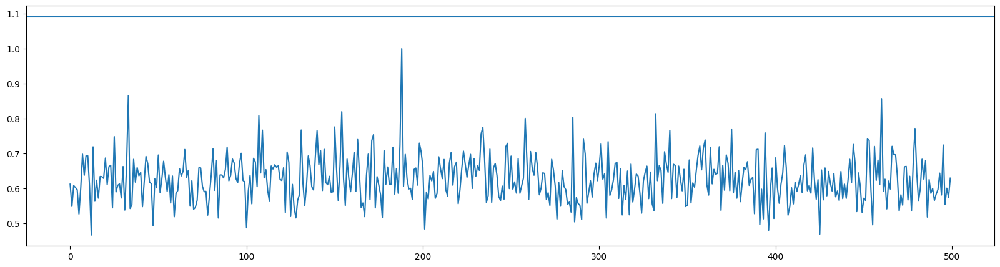

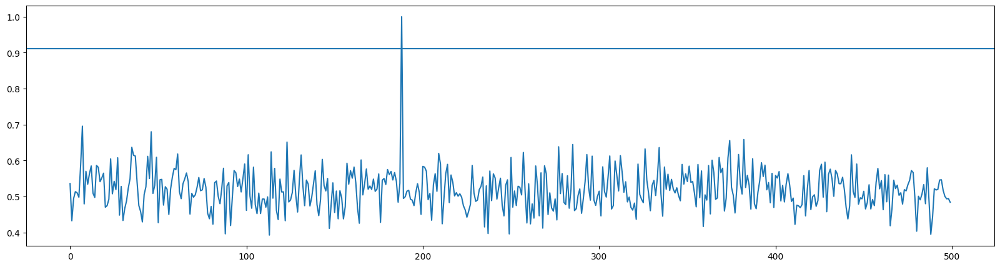

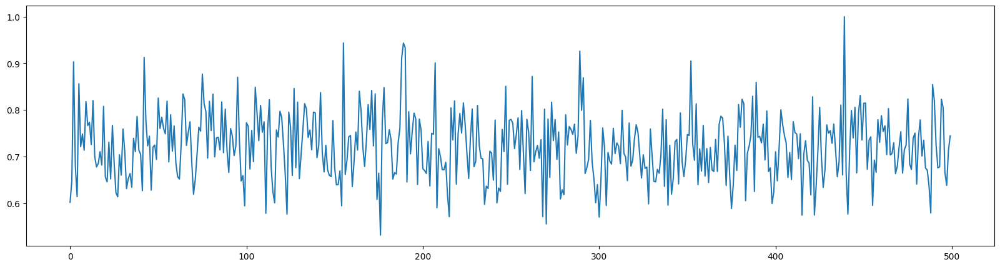

#: 0


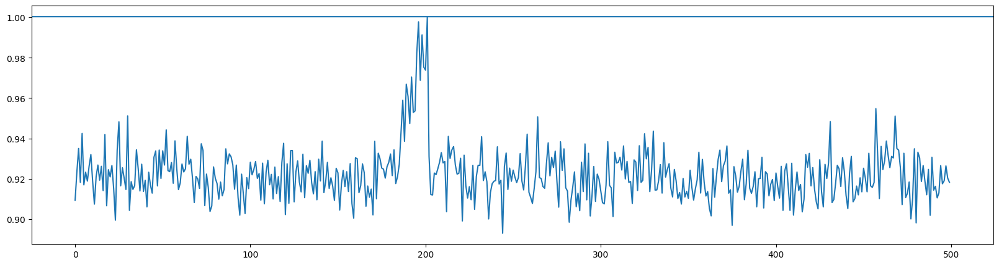

Checking Drift
16 16
[[0.50006884 0.53826326 0.750527   ... 0.5302298  0.5924723  0.61860484]
 [0.54579407 0.66896915 0.7396967  ... 0.62501925 0.5691984  0.59123456]
 [0.7097295  0.56230736 0.630317   ... 0.5181014  0.59048516 0.60960054]
 ...
 [0.5966147  0.73870844 0.667253   ... 0.7649653  0.6479949  0.6336041 ]
 [0.60154194 0.6242025  0.63488877 ... 0.58354336 0.6862615  0.63338935]
 [0.6376672  0.6291314  0.61745673 ... 0.6632639  0.51294726 0.47222856]]
50
[[2.9208064e+10 2.4261335e+10 2.6220667e+10 ... 3.1065786e+10
  2.6110665e+10 2.6253857e+10]
 [2.6627432e+10 2.9742311e+10 2.8775471e+10 ... 3.2187597e+10
  2.3372288e+10 3.3758439e+10]
 [3.0182357e+10 3.0828190e+10 3.1096396e+10 ... 2.9324829e+10
  2.8466897e+10 2.6638729e+10]
 ...
 [2.3510862e+10 2.9847491e+10 3.1206881e+10 ... 2.8308296e+10
  3.0831845e+10 2.7034386e+10]
 [2.6267027e+10 2.8020550e+10 2.9337266e+10 ... 2.9990279e+10
  2.9037144e+10 3.2976894e+10]
 [2.4506397e+10 2.6753284e+10 2.6248688e+10 ... 2.6865029e+10


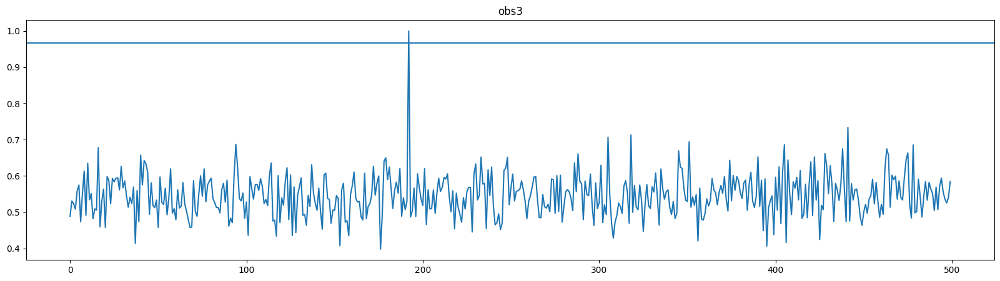

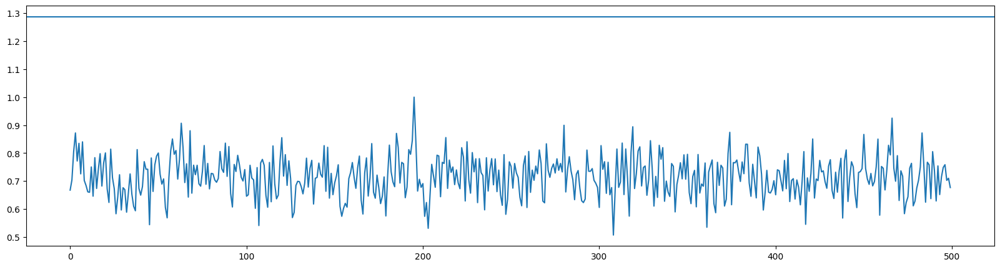

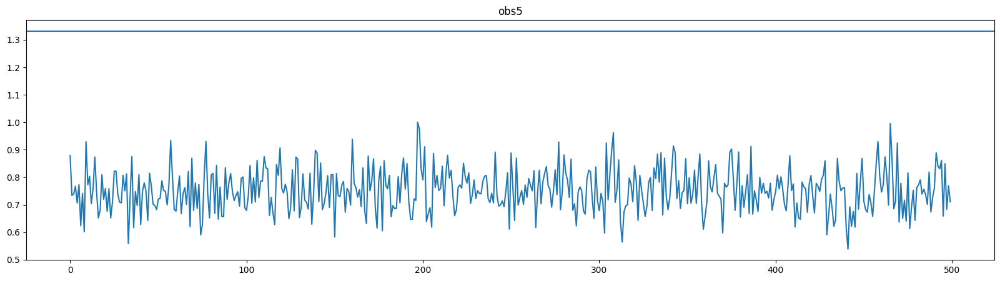

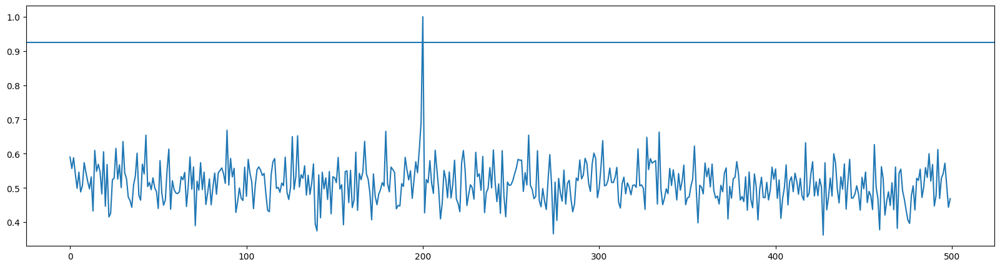

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc05_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7437.136529479176
hf <HDF5 file "blc05_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7501.4648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7407.7148423530 src_raj 14.4945466667 src_raj_degs 217.4182000000 src_dej 3.2333000000 target NGC5638
23024000 23024500


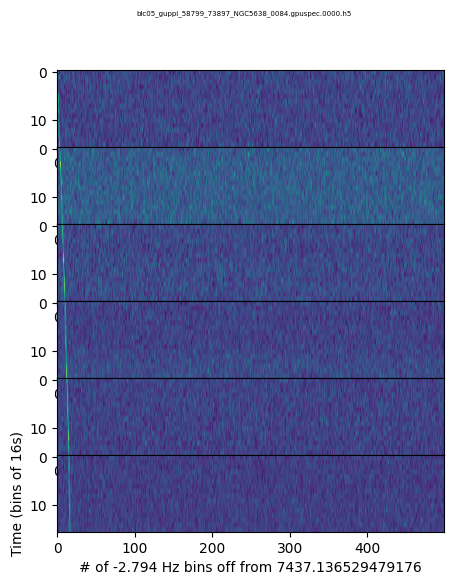

broadband False


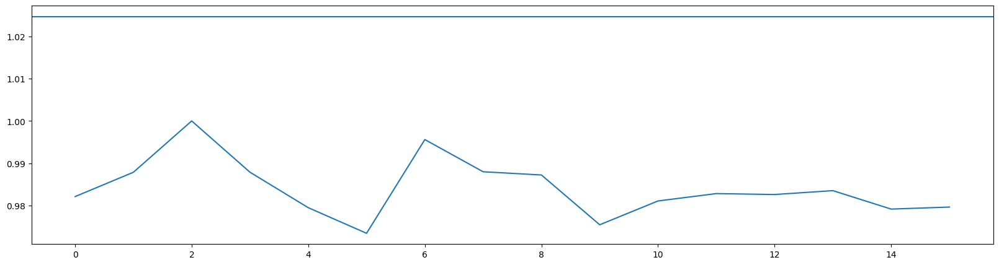

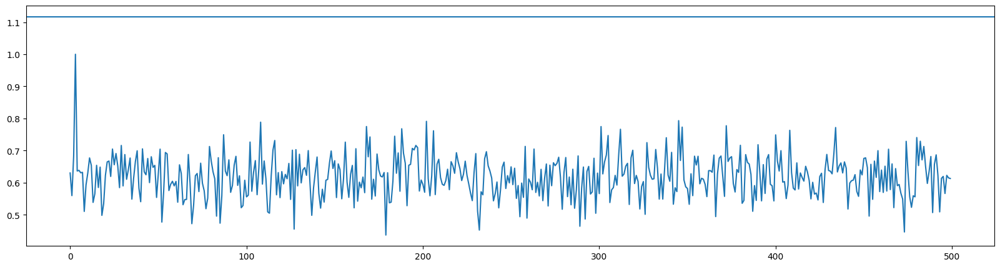

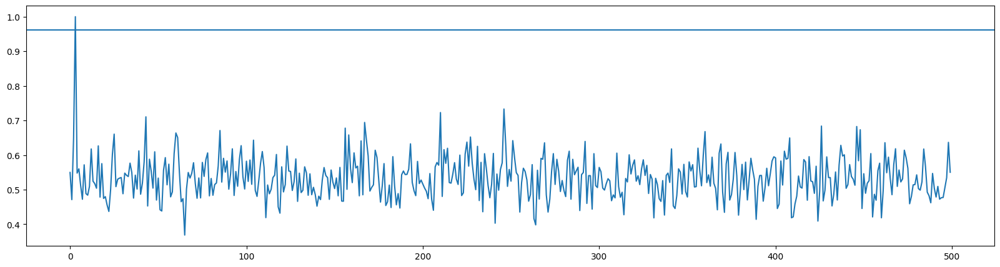

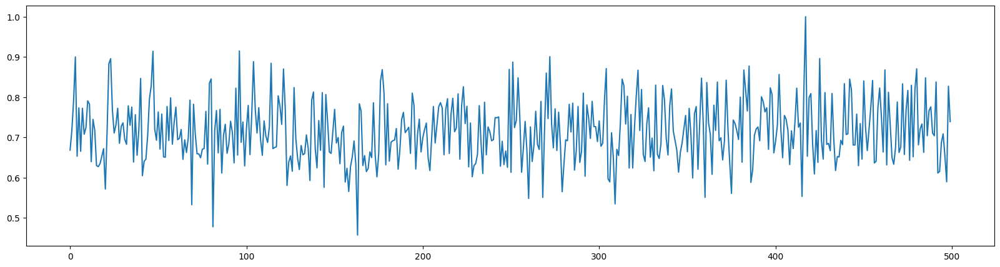

#: 0


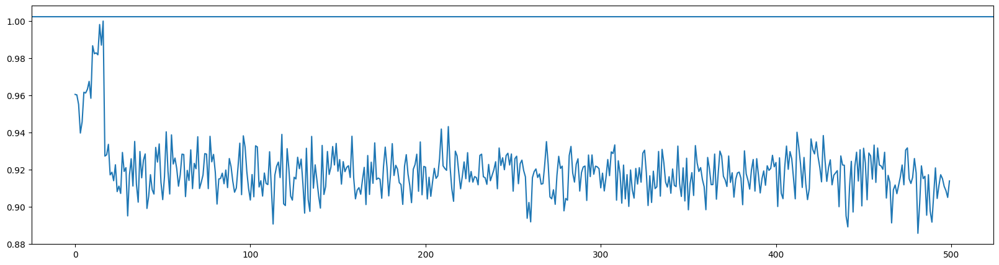

Checking Drift
16 16
[[0.47668278 0.511133   0.5642631  ... 0.42055696 0.5900742  0.5272529 ]
 [0.608838   0.43870535 0.44749093 ... 0.56252295 0.55353993 0.4508117 ]
 [0.52852    0.52044797 0.5309691  ... 0.51362497 0.43892822 0.47035566]
 ...
 [0.41330218 0.5168663  0.5401973  ... 0.45617566 0.58581    0.50188565]
 [0.4985687  0.5120309  0.48228884 ... 0.53366935 0.54354775 0.4205423 ]
 [0.53365874 0.49003202 0.4594994  ... 0.567329   0.50753134 0.42347142]]
50
[[2.5108074e+10 2.6413269e+10 2.9089796e+10 ... 3.1731352e+10
  2.7732787e+10 3.2886946e+10]
 [2.9681201e+10 3.1135101e+10 2.2895890e+10 ... 3.9188234e+10
  2.6935501e+10 3.1169821e+10]
 [2.4281092e+10 2.2555107e+10 3.7073408e+10 ... 5.0641965e+10
  3.1232866e+10 2.8188590e+10]
 ...
 [2.4539263e+10 2.5637190e+10 2.8259725e+10 ... 3.4255602e+10
  1.9179700e+10 4.7944241e+10]
 [2.8468693e+10 2.5495374e+10 2.9721010e+10 ... 3.3234117e+10
  2.4796111e+10 4.1371054e+10]
 [3.4117163e+10 2.9603564e+10 2.6143465e+10 ... 2.4474575e+10


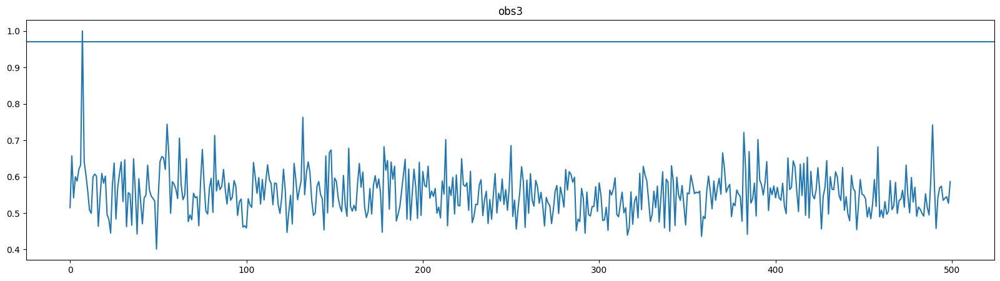

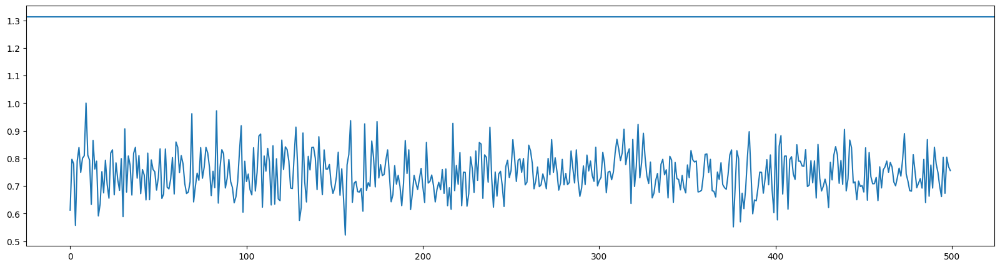

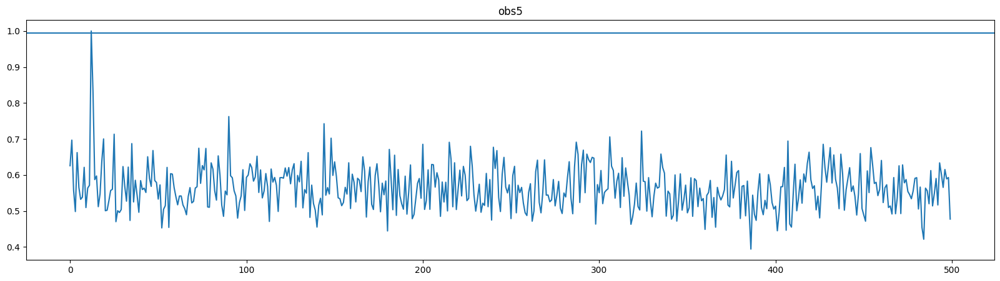

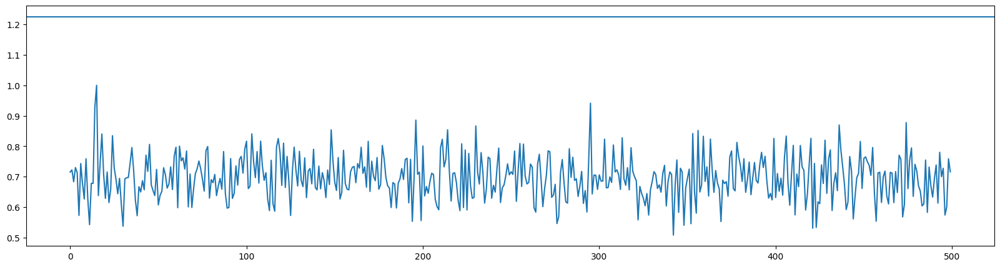

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC5638/blc05_guppi_58799_73897_NGC5638_0084.gpuspec.0000.h5
freq 7316.519545856863
hf <HDF5 file "blc05_guppi_58799_74212_HIP70782_0085.gpuspec.0000.h5" (mode r)>
tstart 58799.855289 fch1 7501.4648423530 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 7407.7148423530 src_raj 14.4945466667 src_raj_degs 217.4182000000 src_dej 3.2333000000 target NGC5638
66194500 66195000


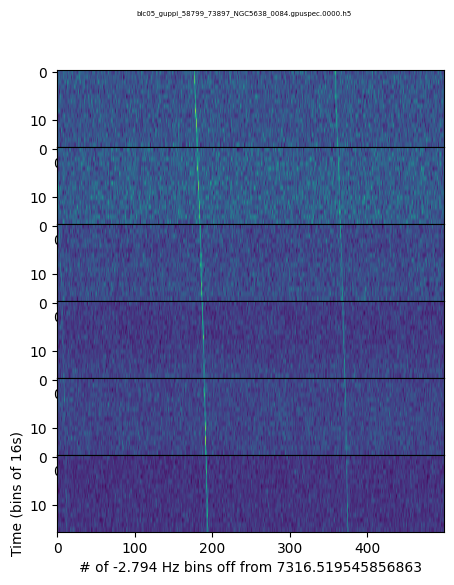

broadband False


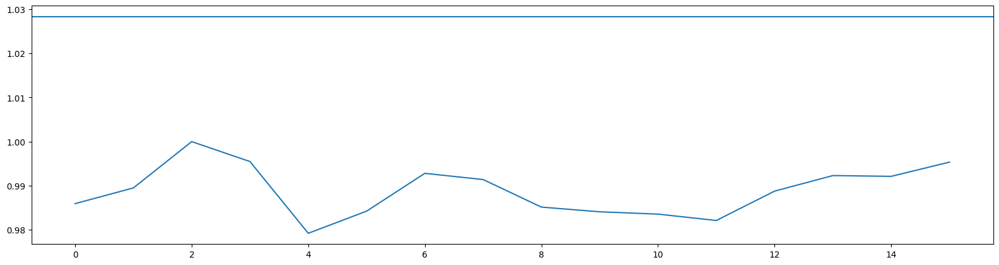

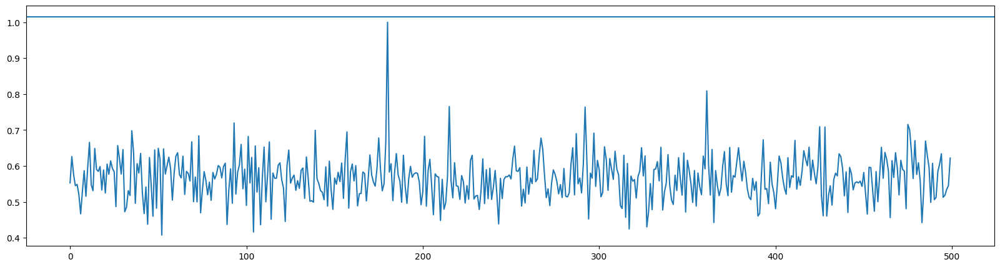

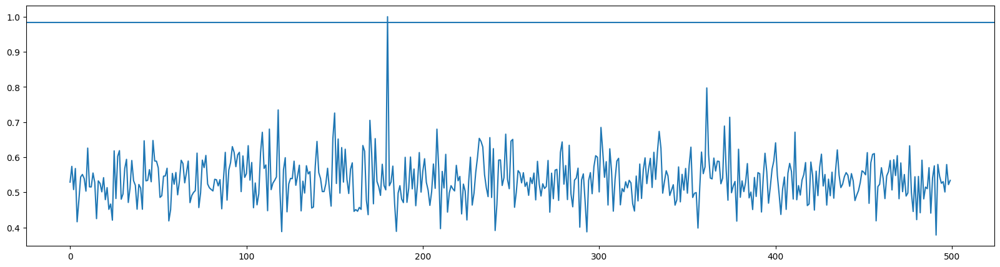

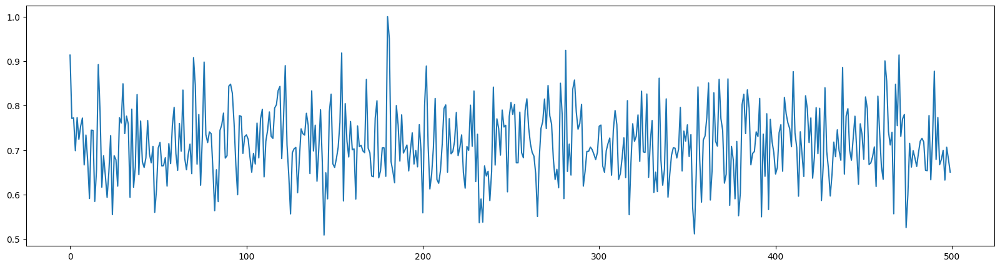

#: 1


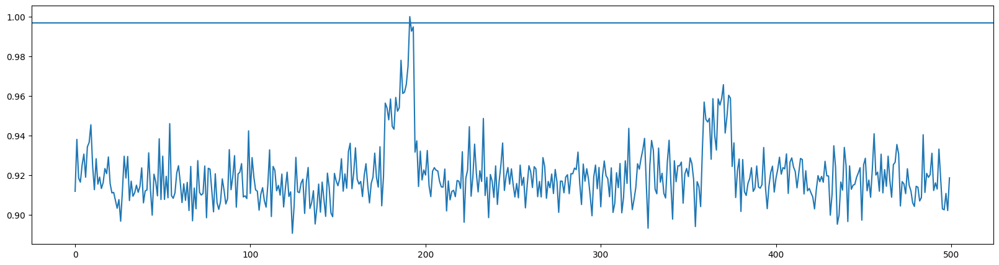

Checking Drift
16 16
[[0.6985006  0.5895506  0.5904808  ... 0.5401232  0.51945543 0.4972283 ]
 [0.64392394 0.5287974  0.51557213 ... 0.41926885 0.61126316 0.59750503]
 [0.4965697  0.48694196 0.49516666 ... 0.48561648 0.63745254 0.58516353]
 ...
 [0.5439659  0.537707   0.5830024  ... 0.61612904 0.5339325  0.6256067 ]
 [0.4831862  0.45705983 0.6762724  ... 0.50885123 0.5963331  0.43502253]
 [0.56829244 0.4997455  0.5305256  ... 0.49425194 0.4946415  0.6331064 ]]
50
[[2.2815977e+10 2.3351871e+10 2.4733227e+10 ... 2.5966954e+10
  2.4196788e+10 2.9220239e+10]
 [2.4800311e+10 2.4558309e+10 2.0047573e+10 ... 2.5437217e+10
  2.2422249e+10 2.4069186e+10]
 [2.5500750e+10 2.6069541e+10 2.9767891e+10 ... 2.4131422e+10
  3.3373573e+10 2.5772974e+10]
 ...
 [2.3280822e+10 2.5408762e+10 2.5827396e+10 ... 2.5545933e+10
  2.7657980e+10 2.2906876e+10]
 [2.5767281e+10 2.1463886e+10 2.6799110e+10 ... 2.3115297e+10
  2.4600517e+10 2.4213350e+10]
 [2.1515872e+10 2.8772841e+10 2.3007937e+10 ... 2.7117509e+10


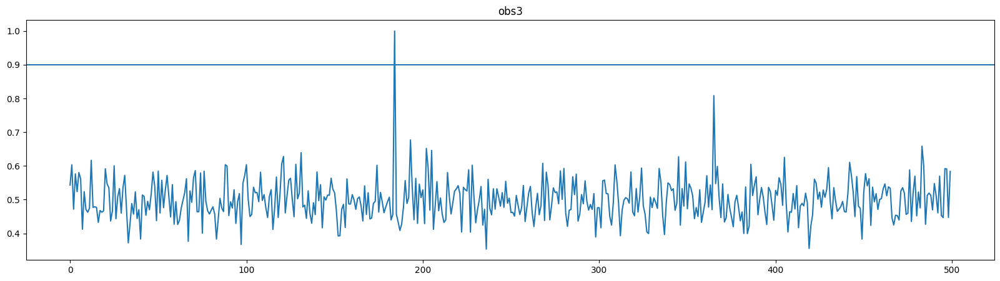

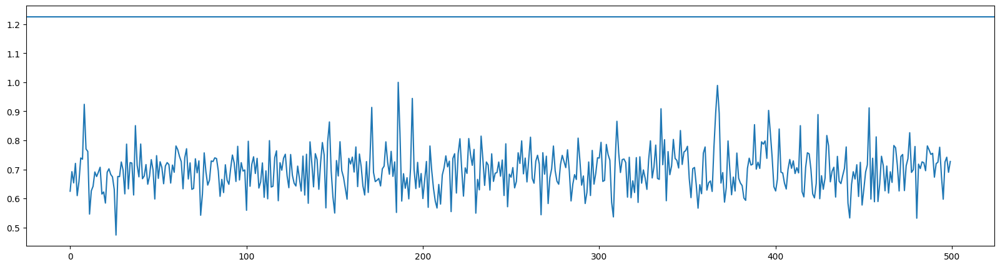

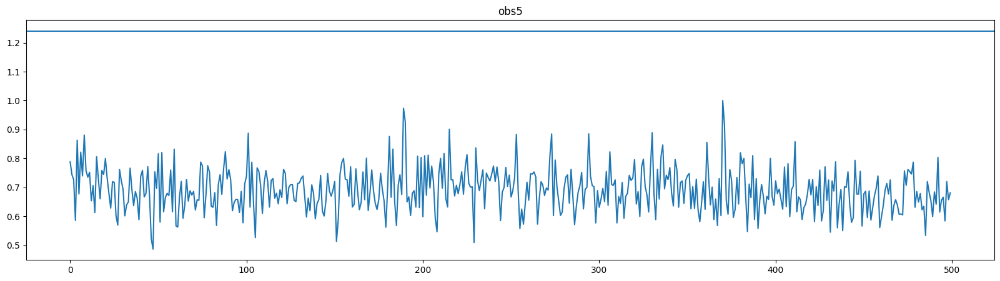

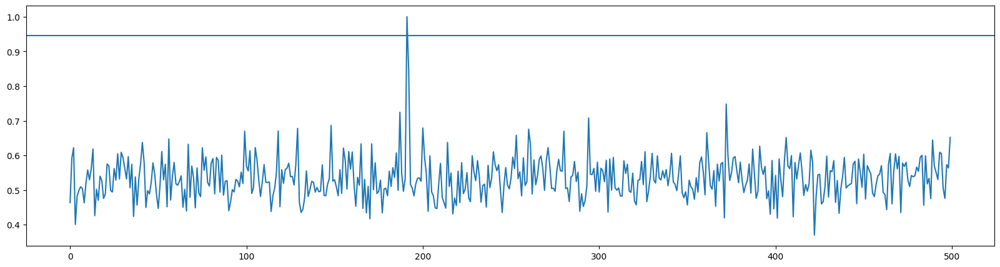

SCORE: 5
/datax/scratch/calebp/seticore_testing/cband/8off10on/NGC596/blc34_guppi_59419_26739_NGC596_0124.rawspec.0000.h5
freq 4202.433843165636
hf <HDF5 file "blc34_guppi_59419_27061_HIP6984_0125.rawspec.0000.h5" (mode r)>
tstart 59419.309479 fch1 4313.9648437500 foff -0.000002793967723846435546875000 nchans 67108864 cfreq 4220.2148437500 src_raj 1.5477947222 src_raj_degs 23.2169208333 src_dej -7.6459488889 target NGC596
39918500 39919000


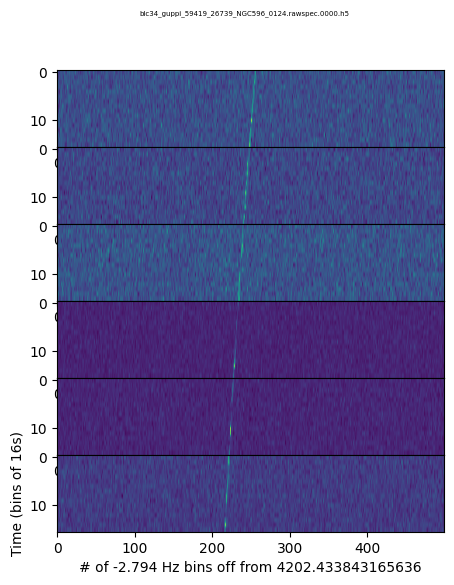

broadband False


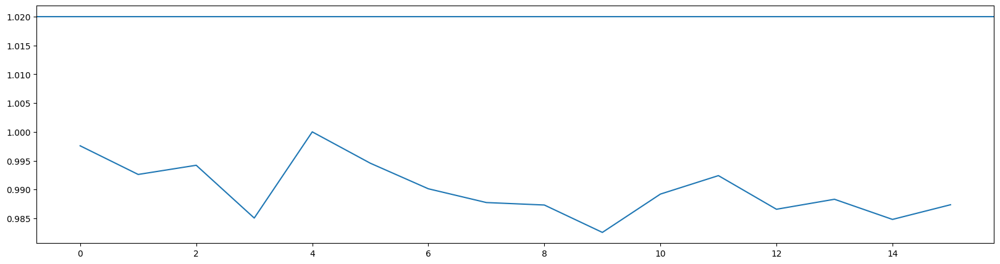

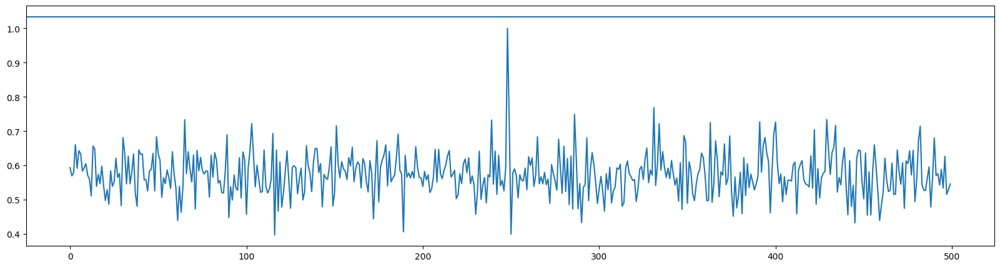

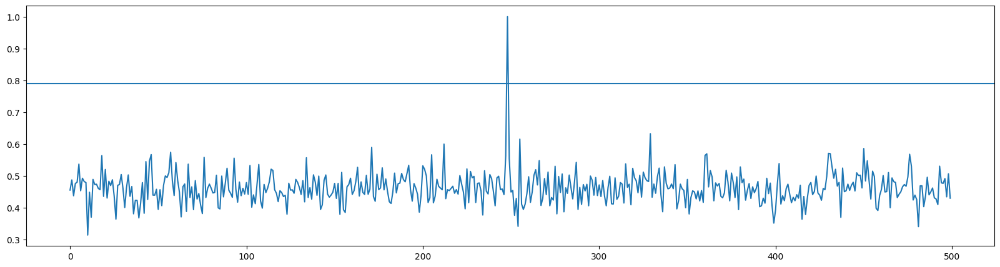

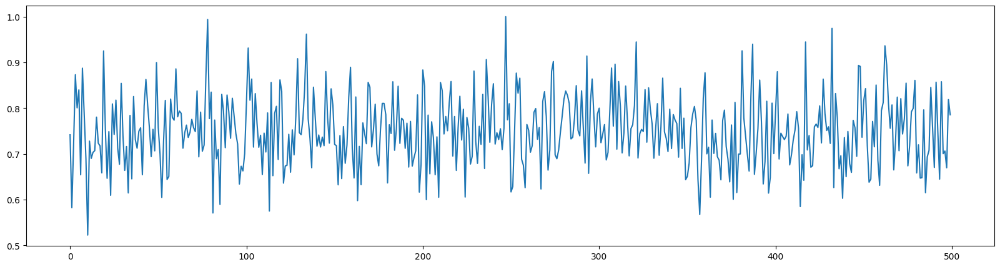

#: 0


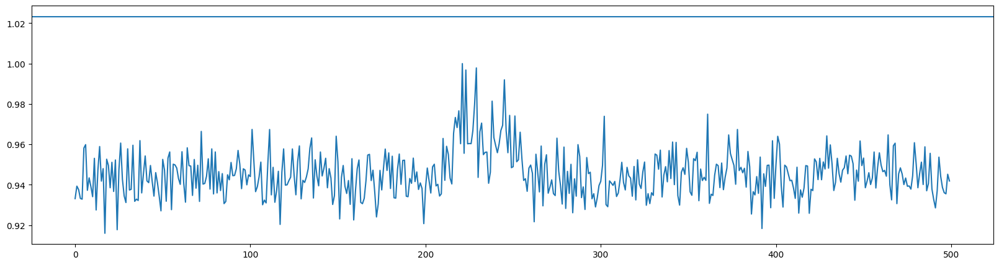

Checking Drift
16 16
[[0.4446137  0.34914094 0.4313747  ... 0.4013897  0.49067375 0.47079077]
 [0.41254976 0.4716012  0.40994692 ... 0.4358448  0.43024814 0.49883306]
 [0.4221086  0.41506714 0.43541077 ... 0.5009626  0.4746507  0.4419226 ]
 ...
 [0.43879494 0.43972036 0.40235108 ... 0.44695196 0.44415367 0.48374867]
 [0.41148883 0.46487623 0.4791953  ... 0.4429655  0.4648319  0.39284945]
 [0.4430183  0.38798305 0.44424197 ... 0.44616526 0.4013957  0.48252198]]
50
[[1293246.1 1365753.4 1340727.6 ... 1349320.  1383933.9 1308725.2]
 [1273557.8 1561026.6 1532238.4 ... 1385386.1 1397338.5 1565436.8]
 [1247024.5 1246716.9 1405727.5 ... 1234813.2 1389577.9 1283724.1]
 ...
 [1374048.2 1231926.8 1198237.  ... 1262090.5 1430235.4 1219604.9]
 [1315591.6 1346092.  1385855.5 ... 1312459.1 1253074.5 1425220.4]
 [1292013.  1263558.1 1625494.8 ... 1377799.6 1285843.9 1300861.8]]
max corr 0.16155555225375773
False True False True


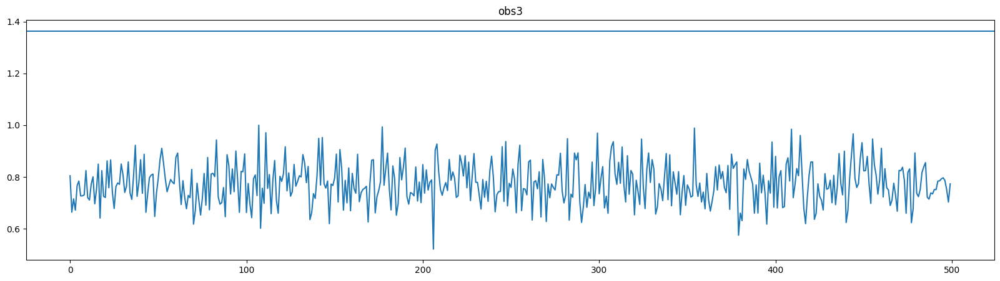

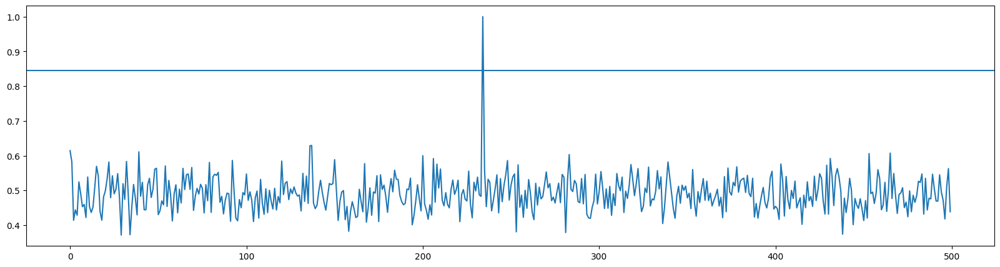

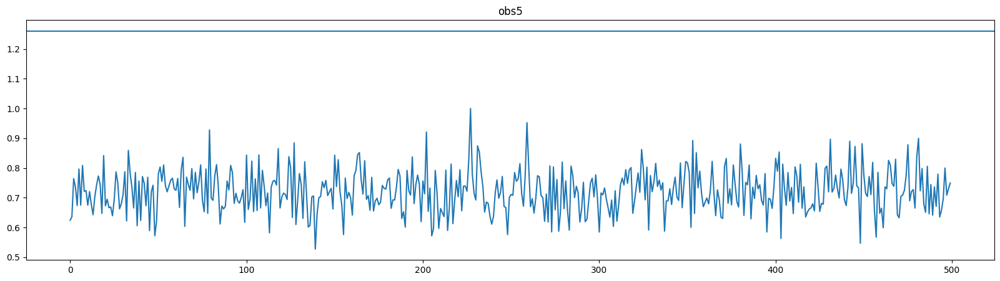

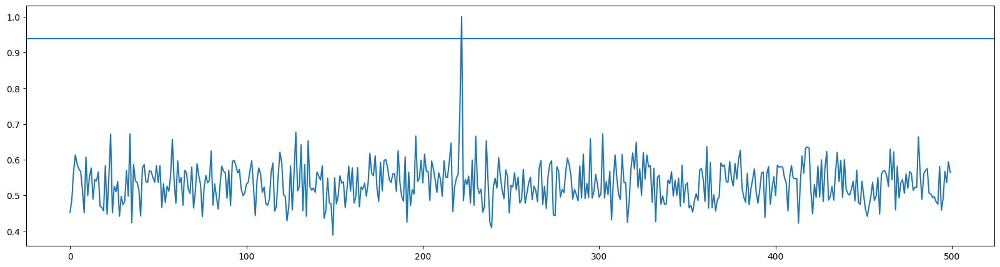

In [11]:
for i in range(0,30):
    print("SCORE:",candidates["Score"][i])
    print(candidates["Primary File"][i])
    plot_csv_candidate(i)

In [22]:
path = '/datax/scratch/calebp/images/example.drawio.png'
def load_signal(path):
    img_path = path
    img = cv2.imread(img_path, 0)
    img = img/255
    resized = cv2.resize(img, (500, 16))
    plt.imshow(resized,aspect='auto')
    resized = np.array([abs(i-1) for i in resized])
    return resized

def inject_signal(obs,signal):
    obs = obs/np.max(obs)
    fake = obs+signal
    return fake
